In [262]:
println("Hello super people: V7 here!")

#NOTES
#YELLOW = -1, BLUE = 1, EMPTY = 0

Hello super people: V7 here!


In [263]:
using Random, Plots, Statistics, Combinatorics, LaTeXStrings, CSV, DataFrames, StatsBase, LaTeXStrings
using Colors


In [264]:
GUIDEFONTSIZE = 16
TITLEFONTSIZE = 18
TICKFONTSIZE = 12

12

In [265]:
PLOT_DIR = "FigsV7/"

try 
    mkdir(PLOT_DIR)
catch
    println("already FigsV7 dir exists")
end
try 
    mkdir("FigsV7/simulationSnapShots1/")
catch
    println("already FigsV7/simulationSnapShots1/ dir exists")
end
try 
    mkdir("FigsV7/simulationSnapShots2/")
catch
    println("already FigsV7/simulationSnapShots2/ dir exists")
end
try 
    mkdir("FigsV7/simulationSnapShots3/")
catch
    println("already FigsV7/simulationSnapShots3/ dir exists")
end
try 
    mkdir("FigsV7/simulationSnapShots4/")
catch
    println("already FigsV7/simulationSnapShots4/ dir exists")
end
try 
    mkdir("FigsV7/simulationSnapShots5/")
catch
    println("already FigsV7/simulationSnapShots5/ dir exists")
end
try 
    mkdir("FigsV7/simulationSnapShots6/")
catch
    println("already FigsV7/simulationSnapShots6/ dir exists")
end
try 
    mkdir("FigsV7/simulationSnapShots7/")
catch
    println("already FigsV7/simulationSnapShots7/ dir exists")
end
try 
    mkdir("FigsV7/simulationSnapShots8/")
catch
    println("already FigsV7/simulationSnapShots8/ dir exists")
end

already FigsV7 dir exists
already FigsV7/simulationSnapShots1/ dir exists
already FigsV7/simulationSnapShots2/ dir exists
already FigsV7/simulationSnapShots3/ dir exists
already FigsV7/simulationSnapShots4/ dir exists
already FigsV7/simulationSnapShots5/ dir exists
already FigsV7/simulationSnapShots6/ dir exists
already FigsV7/simulationSnapShots7/ dir exists
already FigsV7/simulationSnapShots8/ dir exists


In [417]:
#define the grid
#schelling used originally 13x13 grid
GRID_SIZE = 13
CELL_COUNT = GRID_SIZE^2
#PP is related to the proportion of GRID_SIZE to assign each agent type count as a population proportion
PP = 5

#agent population numbers on the grid
YELLOW_COUNT = Int(round(CELL_COUNT * PP/(GRID_SIZE-1)))
BLUE_COUNT = Int(round(CELL_COUNT * PP/(GRID_SIZE-1)))
EMPTY_COUNT = CELL_COUNT - YELLOW_COUNT - BLUE_COUNT

#for positions in the grid how many are needed for homogeneity satisfaction
THRESHOLD_SAME = 4
THRESHOLD_EDGE = 3
THRESHOLD_CORNER = 2

#simulation iterations
MM = 10#number of simulations (independent initializations from start to TT)
TT = 40#number of time points in simulation (how many moves for each MM)

#for the lattice heatmaps to show the grid cell indices
GRID_STEP = floor( GRID_SIZE / 15 ) + 1  #

#THE COLOR CHOICES FOR THE AGENTS (-1,0,+1)
COLOR_GRADIENT = ColorGradient([:orange,:white,:blue])

#the maximum value of the spatial residential satisfaction
R_MAX = YELLOW_COUNT + BLUE_COUNT

#sample number for the distributions of omega etc
NUM_RAND_SAMPLES = 1000

#sample number for the uniform finance case that is more time consuming
UNIFORM_SAMPLE_NUM = 20

#sample number for the uniform finance case on the 2D which is time consuming
UNIFORM_SAMPLE_NUM_2D = 100

#bracket distance to be considered homogeneous for income assignment similarity in locality
BRACKET_RADIUS = 4

#important to scale the entropy plots to be visible without much alterations
scale = 10e16

#percentage of income to spread to each surrounding cell resident upon movement of cell
SPREAD_PERCENT = 0.02

#Uniform income allocation chunk size
UNIFORM_ALLOCATION_CHUNK_SIZE = 1000

#threshold to move regardless
moveRegardlessPROB = 0.0

#threshold for the satisfied to move
satisfiedMovePROB = 0.1

0.1

In [267]:
#The total income some for each group of residents
TOTAL_INCOME_GROUP = -1

-1

In [268]:
#plot index tracker for the order
PLOT_NUM = 0
PLOT_START_STR = "fig"
PLOT_END_STR = ".png"
PLOT_END_STR_PDF = ".pdf"
function newFigNameString()
    global PLOT_NUM
    PLOT_NUM += 1
    return string(PLOT_DIR,PLOT_START_STR,PLOT_NUM,PLOT_END_STR)
end
function newFigNameString_PDF()   
    global PLOT_NUM
    return string(PLOT_DIR,PLOT_START_STR,PLOT_NUM,PLOT_END_STR_PDF)
end

newFigNameString_PDF (generic function with 1 method)

In [269]:
#BOLTZAMANN CONSTANT
K_B = 1.380649*10^-23;

In [270]:
#R ENTROPY / PERMUTATIONS FOR THE SPATIAL ARRANGEMENTS WITHOUT INCOME

#the total number of possible configurations of the grid placements of residents and incomes
CELLS_SPACE_SIZE = multinomial(BigInt(YELLOW_COUNT),BigInt(BLUE_COUNT),BigInt(EMPTY_COUNT));

In [271]:
#S_RI ENTROPY / PERMUTATIONS FOR THE SPATIAL ARRANGEMENTS WITH INCOME
CELLS_SPACE_SIZE_2D = BigInt(-1)
#total number of possible configurations for the 2D grid state dimensions
#2 macrostate variables
function SET_2D_SPATIAL_INCOME_CELL_SPACE(TOTAL_INCOME_GROUP)
    global CELLS_SPACE_SIZE_2D
    spatial = multinomial(BigInt(YELLOW_COUNT),BigInt(BLUE_COUNT),BigInt(EMPTY_COUNT)) 
    
    uniformAllocationTrials = Int(ceil(TOTAL_INCOME_GROUP / UNIFORM_ALLOCATION_CHUNK_SIZE))
    
    incomeYellow = BigInt(YELLOW_COUNT)^(BigInt(uniformAllocationTrials))
    incomeBlue = BigInt(BLUE_COUNT)^(BigInt(uniformAllocationTrials))
    CELLS_SPACE_SIZE_2D = spatial * incomeYellow * incomeBlue
    
end


SET_2D_SPATIAL_INCOME_CELL_SPACE (generic function with 1 method)

In [272]:
#take the dataframe from the wealth data and return an array of wealth for 
#each percentage index; simple data mongering
#THE MEAN OF THE BRACKET IS TAKEN!!! 
function df2wealthArray(dfWealth)
    meansBracket = []
    for i in 1:size(dfWealth)[1]        
        inds = findall(isequal(' '),dfWealth[i,1])        
        money1 = dfWealth[i,1][1:inds[1]-1]
        money2 = dfWealth[i,1][inds[2]+1:end]        
        if(i == size(dfWealth)[1])
            money2 = money1
        end        
        money1 = replace(money1,","=>"")
        money2 = replace(money2,","=>"")
        money1 = parse(Float64,money1)
        money2 = parse(Float64,money2)
        append!(meansBracket,mean([money1,money2]))        
    end
    return meansBracket
end

df2wealthArray (generic function with 1 method)

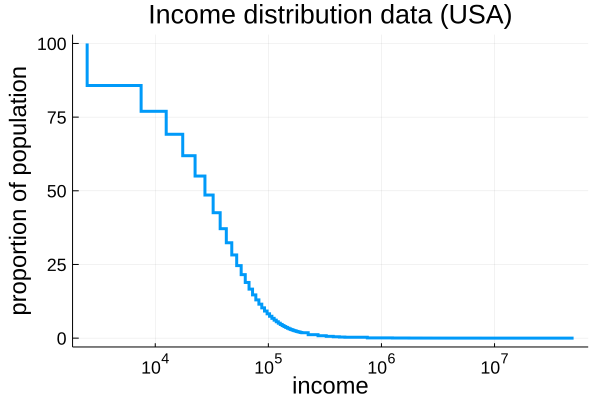

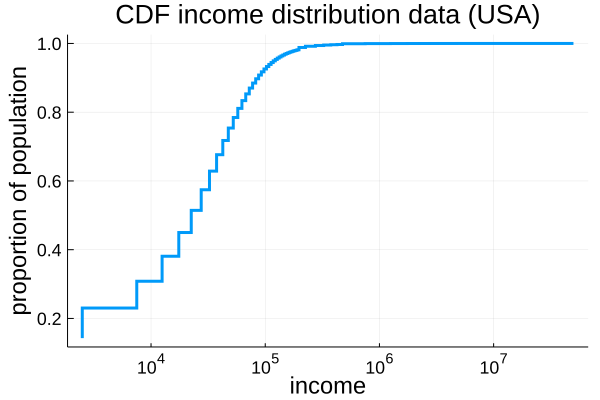

In [273]:
#DATA
#wealth distribution data taken from: https://raw.githubusercontent.com/jkeesh/which-percent/master/data.csv
# It is based on data from the US census as well as the Social Security Administration

#wealth distribution data taken from: https://raw.githubusercontent.com/jkeesh/which-percent/master/data.csv
# It is based on data from the US census as well as the Social Security Administration
csvWealth = CSV.File("wealthDistribution.csv",header=false)
dfWealth = DataFrame(csvWealth);

#Create an array from the datafram for the wealth that is 2 column for percentage of wealth bracket
#THE MEAN OF EACH BRACKET IS TAKEN!!! THERE IS A RANGE FOR EACH BUT WE USE A SINGLE VALUE
percs = dfWealth[:,4] #percentages of the population for that wealth or more
percs =[percs[i][1:end-1] for i in 1:length(percs)] 
percs = [ parse(Float64,percs[i]) for i in 1:length(percs)]

wealthBrackets = df2wealthArray(dfWealth)
#first col is the percentage of the population #second is the wealth of the income for that percentage
percsAndWealth = hcat(percs,wealthBrackets) 

plt = plot(percsAndWealth[:,2],percsAndWealth[:,1],leg=false,line = :steppre,
    linewidth=3,xlabel="income",
    title="Income distribution data (USA)",ytickfont=TICKFONTSIZE,
    ylabel="proportion of population",
    xtickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
xaxis!(:log10)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

#make a CDF of the income
bracketPercs = [percsAndWealth[x,1] - percsAndWealth[x+1,1] for x in 1:(size(percsAndWealth)[1]-1)]
append!(bracketPercs,percsAndWealth[end,1])
cumsumPerc = cumsum(bracketPercs)
cumsumPerc = cumsumPerc ./ 100
percsAndWealthCumSumProb = hcat(cumsumPerc,percsAndWealth[:,2])

plt = plot(percsAndWealthCumSumProb[:,2],percsAndWealthCumSumProb[:,1],leg=false,line = :steppre,
    linewidth=3,xlabel="income",
    title="CDF income distribution data (USA)",ytickfont=TICKFONTSIZE,
    ylabel="proportion of population",
    xtickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
xaxis!(:log10)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

In [274]:
#SAMPLE INCOMES FROM POPULATION BRACKETS
#now sample according to the population a wealth bracket to produce a wealth number from the data
function wealthBracketSample()
    brackets = findall(isequal(true), rand()*100 .<= percsAndWealth[:,1] )
    maxBracketInd = maximum(brackets)
    #println(maxBracketInd)
    return percsAndWealth[maxBracketInd,2]
end
wealthBracketSample()

32499.995

In [275]:
#totalIncomeGroup

In [276]:
#sample incomes for each group of residents
#normalize according to the mean income so that the total sum is consistent
#if slightly off, randomly padd a resident with that diff to stabilize
function getResidentIncomeSamples(totalIncomeGroup)
    wealthSamplesYellow = [wealthBracketSample() for i in 1:YELLOW_COUNT]
    wealthSamplesYellow = wealthSamplesYellow .* ( sum(totalIncomeGroup) / sum(wealthSamplesYellow) )
    wealthSamplesYellow = round.(wealthSamplesYellow)
    diffYellowTotal = (totalIncomeGroup) - sum(wealthSamplesYellow)
    #padd a random resident
    randIndex = rand(1:length(wealthSamplesYellow))
    wealthSamplesYellow[randIndex] += diffYellowTotal
    #diffYellowTotal = (totalIncomeGroup) - sum(wealthSamplesYellow)
    return wealthSamplesYellow
end


getResidentIncomeSamples (generic function with 1 method)

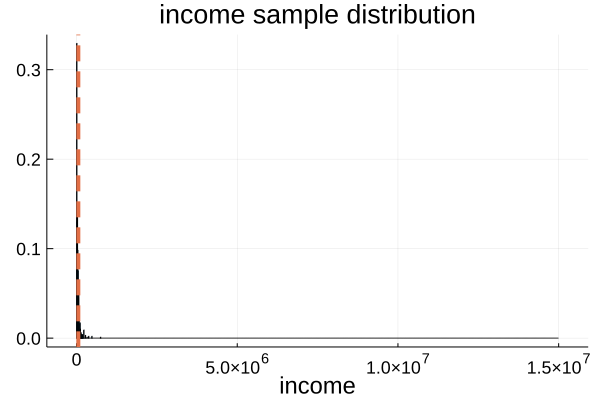

55787.0
3.90509e6


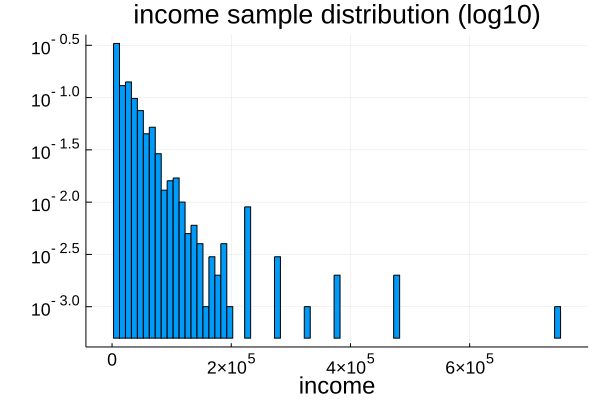

1.4999999995e7
1.4999999995e7


In [277]:
#MEAN INCOME
#we need the mean income for the base expected money per resident
wealthSamples = [wealthBracketSample() for i in 1:NUM_RAND_SAMPLES]
meanIncome = round(mean(wealthSamples)) #MEAN INCOME For each group !!!
println(meanIncome)
TOTAL_INCOME_GROUP = meanIncome * YELLOW_COUNT #regardless of the distribution
println(TOTAL_INCOME_GROUP)
#println("meanIncome=$(meanIncome),"," totalIncomeGroup=$(totalIncomeGroup)")

hist = histogram(wealthSamples,normalize=:probability,
    title="income sample distribution",xlabel="income",leg=false,
    bins=minimum(wealthSamples):10000:maximum(wealthSamples),ytickfont=TICKFONTSIZE,
    xtickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
vline!([mean(wealthSamples)],line=(4,:dash),leg=false)
display(hist)
savefig(hist,newFigNameString())
savefig(hist,newFigNameString_PDF())
println(maximum(wealthSamples))

hist = histogram(wealthSamples,normalize=:probability,yaxis=:log10,
    title="income sample distribution (log10)",xlabel="income",leg=false,
    bins=minimum(wealthSamples):10000:maximum(wealthSamples),ytickfont=TICKFONTSIZE,
    xtickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
vline!([mean(wealthSamples)],line=(4,:dash),leg=false)
display(hist)
savefig(hist,newFigNameString())
savefig(hist,newFigNameString_PDF())
println(maximum(wealthSamples))

In [278]:
#we need to allocate wealth according to the word tuple probability as a 'process'
#the process will individually allocate a single dollar to a resident till the total is accumulated
#returns incomes for all residents, NEEDS TOTAL_INCOME_GROUP to be allocated first  
function randUniformWealthBracketSample()
    incomes = zeros(YELLOW_COUNT)
    #println(TOTAL_INCOME_GROUP)
    # UNIFORM_ALLOCATION_CHUNK_SIZE
    ALLOCATION_STEPS = floor( TOTAL_INCOME_GROUP / UNIFORM_ALLOCATION_CHUNK_SIZE )
    
    for dollars in 1:ALLOCATION_STEPS    #TOTAL_INCOME_GROUP
        indDrop = rand(1:YELLOW_COUNT)
        incomes[indDrop] += UNIFORM_ALLOCATION_CHUNK_SIZE   #1      
    end
    
    indDrop = rand(1:YELLOW_COUNT)
    extraAdd = TOTAL_INCOME_GROUP - (ALLOCATION_STEPS*UNIFORM_ALLOCATION_CHUNK_SIZE)
    incomes[indDrop] += extraAdd
    
    return incomes
end
#randUniformWealthBracketSample()
#TOTAL_INCOME_GROUP

randUniformWealthBracketSample (generic function with 1 method)

In [279]:
#sample the random intializations and investigate 
function make_random_grid()#random initial allocation heatmap viz
    sample_grid = zeros(GRID_SIZE,GRID_SIZE)
    sample_grid[1:YELLOW_COUNT] .= 1
    sample_grid[YELLOW_COUNT+1:YELLOW_COUNT+BLUE_COUNT] .= -1
    shuffle!(sample_grid)
    return sample_grid
end


make_random_grid (generic function with 1 method)

In [280]:
#return the array of those agents around it, returns arrays like [-1,1,0,1]
function cell_surround_array(grid,row,col)
    cell_surrounding = []
    for ii in 0:2
        for jj in 0:2
            if(!( (ii==1 && jj==1) || (row-1+(ii) < 1) ||  (col-1+(jj) < 1) || 
                        (row-1+(ii) > GRID_SIZE) || (col-1+(jj) > GRID_SIZE) ))
                append!(cell_surrounding,grid[row-1+(ii),(col-1)+(jj)])
            end
        end
    end
    return cell_surrounding
end



cell_surround_array (generic function with 1 method)

In [281]:
#Return the value of the binary satisfaction [0,1] for the array neighborhood in the grid
function thresholdFN(cellSurroundArray,cellType,row,col)
    homogeneity = length(findall(cellType .== cellSurroundArray))
    #println(homogeneity)
    if(cellType != 0)
        if(!(row == 1 || row == GRID_SIZE || col == 1 || col == GRID_SIZE))#general inner body
            return homogeneity >= THRESHOLD_SAME ? 1 : 0
        elseif((row==GRID_SIZE && col==GRID_SIZE))#bottom right corner
            return homogeneity >= THRESHOLD_CORNER ? 1 : 0    
        elseif((row==1 && col==1))#top left corner
            return homogeneity >= THRESHOLD_CORNER ? 1 : 0
        elseif((row==1 && col==GRID_SIZE))#top right corner
            return homogeneity >= THRESHOLD_CORNER ? 1 : 0
        elseif((row==GRID_SIZE && col==1))#bottom left corner
            return homogeneity >= THRESHOLD_CORNER ? 1 : 0
        elseif((row==1 && (col < GRID_SIZE && col > 1) ))#top edge
            return homogeneity >= THRESHOLD_EDGE ? 1 : 0
        elseif( (row > 1 && row < GRID_SIZE) && (col == 1) )#left edge
            return homogeneity >= THRESHOLD_EDGE ? 1 : 0
        elseif( (row > 1 && row < GRID_SIZE) && (col == GRID_SIZE) )#right edge
            return homogeneity >= THRESHOLD_EDGE ? 1 : 0
        elseif( (row == GRID_SIZE) && (col > 1 && col < GRID_SIZE) )#bottom edge
            return homogeneity >= THRESHOLD_EDGE ? 1 : 0
        end
    else
        return 0
    end
end

#same as thresholdFN but does not need to have the cellType passed to it
function is_cell_satisfied(grid,row,col)
    cellSurroundArray = cell_surround_array(grid,row,col)
    #println(cellSurroundArray)
    cellType = grid[row,col]    
    homogeneity = length(findall(cellType .== cellSurroundArray))
    if(cellType != 0)
        if(!(row == 1 || row == GRID_SIZE || col == 1 || col == GRID_SIZE))#general inner body
            return homogeneity >= THRESHOLD_SAME ? 1 : 0
        elseif((row==GRID_SIZE && col==GRID_SIZE))#bottom right corner
            return homogeneity >= THRESHOLD_CORNER ? 1 : 0    
        elseif((row==1 && col==1))#top left corner
            return homogeneity >= THRESHOLD_CORNER ? 1 : 0
        elseif((row==1 && col==GRID_SIZE))#top right corner
            return homogeneity >= THRESHOLD_CORNER ? 1 : 0
        elseif((row==GRID_SIZE && col==1))#bottom left corner
            return homogeneity >= THRESHOLD_CORNER ? 1 : 0
        elseif((row==1 && (col < GRID_SIZE && col > 1) ))#top edge
            return homogeneity >= THRESHOLD_EDGE ? 1 : 0
        elseif( (row > 1 && row < GRID_SIZE) && (col == 1) )#left edge
            return homogeneity >= THRESHOLD_EDGE ? 1 : 0
        elseif( (row > 1 && row < GRID_SIZE) && (col == GRID_SIZE) )#right edge
            return homogeneity >= THRESHOLD_EDGE ? 1 : 0
        elseif( (row == GRID_SIZE) && (col > 1 && col < GRID_SIZE) )#bottom edge
            return homogeneity >= THRESHOLD_EDGE ? 1 : 0
        end
    else
        return 0
    end
end 

#testing for if a cell would be satisfied if it were placed there
function would_cell_be_satisfied(grid,row,col,cellType)
    cellSurroundArray = cell_surround_array(grid,row,col)    
    #println(cellSurroundArray)
    homogeneity = length(findall(cellType .== cellSurroundArray))    
    #println(homogeneity)
    if(cellType != 0)
        if(!(row == 1 || row == GRID_SIZE || col == 1 || col == GRID_SIZE))#general inner body
            return homogeneity >= THRESHOLD_SAME ? 1 : 0
        elseif((row==GRID_SIZE && col==GRID_SIZE))#bottom right corner
            return homogeneity >= THRESHOLD_CORNER ? 1 : 0    
        elseif((row==1 && col==1))#top left corner
            return homogeneity >= THRESHOLD_CORNER ? 1 : 0
        elseif((row==1 && col==GRID_SIZE))#top right corner
            return homogeneity >= THRESHOLD_CORNER ? 1 : 0
        elseif((row==GRID_SIZE && col==1))#bottom left corner
            return homogeneity >= THRESHOLD_CORNER ? 1 : 0
        elseif((row==1 && (col < GRID_SIZE && col > 1) ))#top edge
            return homogeneity >= THRESHOLD_EDGE ? 1 : 0
        elseif( (row > 1 && row < GRID_SIZE) && (col == 1) )#left edge
            return homogeneity >= THRESHOLD_EDGE ? 1 : 0
        elseif( (row > 1 && row < GRID_SIZE) && (col == GRID_SIZE) )#right edge
            return homogeneity >= THRESHOLD_EDGE ? 1 : 0
        elseif( (row == GRID_SIZE) && (col > 1 && col < GRID_SIZE) )#bottom edge
            return homogeneity >= THRESHOLD_EDGE ? 1 : 0
        end
    else
        return 0
    end
end 


would_cell_be_satisfied (generic function with 1 method)

In [282]:
#Search for an unsatisfied iteratively in all the cells through a shuffled list
#find all empty cells
#shuffle the list of the empty cells
#see if the cell would_cell_be_satisfied in any of the cells in sequence
#no, move on to the next cell
#if yes, change the original cell position to empty and make the new cell the cell type
#loop till all non-empty cells are tested
#PASS GRID TO RETURN MOVED GRID
function move_cells_for_satisfaction(grid)    
    newGrid = deepcopy(grid)
    nonZeroCells = findall(grid .!= 0)
    nonZeroCells2 = shuffle(nonZeroCells)
    nonZeroCells3 = deepcopy(nonZeroCells2)
    satisfiedNonZeroCells = [is_cell_satisfied(newGrid,nzc[1],nzc[2]) for nzc in nonZeroCells2]       
    satisfiedInds = findall(satisfiedNonZeroCells .== 1)
    deleteat!(nonZeroCells2,satisfiedInds)       
           
    for nzc in nonZeroCells2        
        isCellSatisfied = is_cell_satisfied(newGrid,nzc[1],nzc[2])        
        if( isCellSatisfied != 1 )          
            emptyCells = findall(newGrid .== 0)
            emptyCells2 = shuffle(emptyCells)
            #find an empty cell nzc could move to
            moved = false
            for ec in emptyCells2                
                wouldCellBeSatisfied = would_cell_be_satisfied(newGrid,ec[1],ec[2],newGrid[nzc[1],nzc[2]] )
                if(wouldCellBeSatisfied == 1  || (rand() <= moveRegardlessPROB))   
                    newGrid[ec[1],ec[2]] = newGrid[nzc[1],nzc[2]]
                    newGrid[nzc[1],nzc[2]] = 0  
                    #no longer try to move it
                    moved = true
                    break
                end                
            end  
        end 
    end 
    #now give a chance for the satisfied to randomly move to a random position 
    
    satisfiedInds2 = findall(satisfiedNonZeroCells .== 0)
    deleteat!(nonZeroCells3,satisfiedInds2)
    
    for nzc in nonZeroCells3        
        isCellSatisfied = is_cell_satisfied(newGrid,nzc[1],nzc[2])        
        if( isCellSatisfied == 1 )          
            emptyCells = findall(newGrid .== 0)
            emptyCells2 = shuffle(emptyCells)
            #find an empty cell nzc could move to 
            
            for ec in emptyCells2                
                wouldCellBeSatisfied = would_cell_be_satisfied(newGrid,ec[1],ec[2],newGrid[nzc[1],nzc[2]] )
                if(wouldCellBeSatisfied == 1  || (rand() <= satisfiedMovePROB))   
                    newGrid[ec[1],ec[2]] = newGrid[nzc[1],nzc[2]]
                    newGrid[nzc[1],nzc[2]] = 0  
                    #no longer try to move it
                    
                    break
                end                
            end  
        end 
    end 
    
    return newGrid
end

move_cells_for_satisfaction (generic function with 1 method)

In [283]:
#wealth no dynamics just moves the cells around randomly and continuously
#at each iteration check the financial cell deviation, and at each move ...
function move_cells_for_wealth_NoDynamics(gridOrig)    
    grid = deepcopy(gridOrig)     
    nonZeroCells = findall(grid[:,:,1] .!= 0)
    nonZeroCells2 = shuffle(nonZeroCells)     
    for nzc in nonZeroCells2 
        emptyCells = findall(grid[:,:,1] .== 0)
        emptyCells2 = shuffle(emptyCells)
        ec = emptyCells2[1]
        grid[ec[1],ec[2],1] = grid[nzc[1],nzc[2],1]
        grid[nzc[1],nzc[2],1] = 0   
        #reallocate the financial variable as well
        grid[ec[1],ec[2],2] = grid[nzc[1],nzc[2],2]
        grid[nzc[1],nzc[2],2] = 0 
        #radiate the finance randomly on the surroundings
        #grid = cell_surround_radiate_financialRandomUniform!(grid,ec[1],ec[2])                    
    end 
    return grid
end

move_cells_for_wealth_NoDynamics (generic function with 1 method)

In [284]:
#MOVE THE CELLS ACCORDING TO SCHELLING DYNAMICS AND CARRY THE INCOME VARIABLE
function move_cells_for_SchellingDynamics_NoWealthDynamics(grid)    
    newGrid = deepcopy(grid)
    nonZeroCells = findall(newGrid[:,:,1] .!= 0)
    nonZeroCells2 = shuffle(nonZeroCells)

    nonZeroCells3 = deepcopy(nonZeroCells2)

    satisfiedNonZeroCells = [is_cell_satisfied(newGrid[:,:,1],nzc[1],nzc[2]) for nzc in nonZeroCells2] 
    satisfiedInds = findall(satisfiedNonZeroCells .== 1)
    deleteat!(nonZeroCells2,satisfiedInds) 

    for nzc in nonZeroCells2
        isCellSatisfied = is_cell_satisfied(newGrid[:,:,1],nzc[1],nzc[2]) 
        if(isCellSatisfied != 1)
            emptyCells = findall(newGrid[:,:,1] .== 0)
            emptyCells2 = shuffle(emptyCells)
            #find an empty cell nzc could move to
            moved = false
            for ec in emptyCells2 
                wouldCellBeSatisfied = would_cell_be_satisfied(newGrid[:,:,1],ec[1],ec[2],newGrid[nzc[1],nzc[2],1])
                if(wouldCellBeSatisfied == 1 || (rand() <= moveRegardlessPROB )) 
                    #move the label on the spatial (swap with the empty cell label)
                    newGrid[ec[1],ec[2],1] = newGrid[nzc[1],nzc[2],1]
                    newGrid[nzc[1],nzc[2],1] = 0  
                    #move the income data with that of the cell
                    newGrid[ec[1],ec[2],2] = newGrid[nzc[1],nzc[2],2]
                    newGrid[nzc[1],nzc[2],2] = 0  
                    #no longer try to move it
                    moved = true
                    break
                end 
            end  
        end 
    end #XXX    

    satisfiedInds2 = findall(satisfiedNonZeroCells .== 0)
    deleteat!(nonZeroCells3,satisfiedInds2)

    for nzc in nonZeroCells3        
        isCellSatisfied = is_cell_satisfied(newGrid[:,:,1],nzc[1],nzc[2])        
        if( isCellSatisfied == 1 )          
            emptyCells = findall(newGrid .== 0)
            emptyCells2 = shuffle(emptyCells)
            #find an empty cell nzc could move to 

            for ec in emptyCells2                
                wouldCellBeSatisfied = would_cell_be_satisfied(newGrid[:,:,1],ec[1],ec[2],newGrid[nzc[1],nzc[2],1] )
                if(wouldCellBeSatisfied == 1  || (rand() <= satisfiedMovePROB))   
                    newGrid[ec[1],ec[2],1] = newGrid[nzc[1],nzc[2],1]
                    newGrid[nzc[1],nzc[2],1] = 0  
                    #move the income data with that of the cell
                    newGrid[ec[1],ec[2],2] = newGrid[nzc[1],nzc[2],2]
                    newGrid[nzc[1],nzc[2],2] = 0  
                    
                    #no longer try to move it

                    break
                end                
            end  
        end 
    end 

    
    return newGrid
end

move_cells_for_SchellingDynamics_NoWealthDynamics (generic function with 1 method)

In [285]:
randUniformWealthBracketSample()

70-element Array{Float64,1}:
 52000.0
 59000.0
 44000.0
 47000.0
 55000.0
 45000.0
 39000.0
 53000.0
 52000.0
 50000.0
 66000.0
 56000.0
 60000.0
     ⋮
 52000.0
 56000.0
 69000.0
 45000.0
 48000.0
 61000.0
 59000.0
 42000.0
 41000.0
 48000.0
 58000.0
 65000.0

In [286]:
#Makes a finance income grid that has the resident types uniformly placed and 
#the income uniformly drawn from the total
function make_uniform_sampled_finance_grid()    
    empty_grid = zeros(GRID_SIZE,GRID_SIZE,2)
    shiftsTmp = GRID_SIZE^2;
    
    #set the agent occupations in the lattice
    empty_grid[1:YELLOW_COUNT] .= 1
    empty_grid[YELLOW_COUNT+1:YELLOW_COUNT+BLUE_COUNT] .= -1
    #set the financial values for the agents
    empty_grid[1+shiftsTmp:YELLOW_COUNT+shiftsTmp] .= randUniformWealthBracketSample()
    empty_grid[YELLOW_COUNT+1+shiftsTmp:YELLOW_COUNT+BLUE_COUNT+shiftsTmp] .= randUniformWealthBracketSample()
    
    indShuffle = shuffle(1:GRID_SIZE^2)
    indShuffleShift = indShuffle .+ GRID_SIZE^2
    empty_grid[1:GRID_SIZE^2] = empty_grid[indShuffle]
    empty_grid[1 .+ GRID_SIZE^2 : GRID_SIZE^2 .+ GRID_SIZE^2 ] = empty_grid[indShuffleShift]
    return empty_grid
end
make_uniform_sampled_finance_grid()  

13×13×2 Array{Float64,3}:
[:, :, 1] =
 -1.0   0.0   0.0  -1.0  -1.0   0.0  -1.0   1.0   1.0  -1.0  -1.0   0.0   1.0
  1.0  -1.0  -1.0   0.0   0.0  -1.0   0.0   1.0  -1.0   1.0   0.0  -1.0   0.0
 -1.0   1.0   1.0   0.0   0.0  -1.0  -1.0   1.0   1.0   1.0  -1.0  -1.0   1.0
 -1.0  -1.0   1.0   0.0   1.0  -1.0  -1.0   1.0  -1.0  -1.0  -1.0  -1.0   0.0
  1.0  -1.0   0.0   1.0   1.0   1.0   0.0  -1.0   0.0   0.0   0.0   1.0   1.0
 -1.0  -1.0   0.0   0.0   0.0   1.0   1.0  -1.0   1.0   1.0   1.0   1.0  -1.0
  1.0  -1.0   1.0   1.0  -1.0   1.0   1.0  -1.0  -1.0   0.0   1.0   1.0  -1.0
 -1.0   0.0   1.0   0.0  -1.0  -1.0   1.0  -1.0   1.0   1.0  -1.0   1.0   0.0
  0.0   1.0  -1.0   1.0  -1.0   1.0  -1.0  -1.0   1.0   1.0   1.0   1.0   1.0
  0.0   1.0   1.0   1.0   1.0   1.0  -1.0   1.0   1.0   1.0  -1.0   1.0  -1.0
  1.0  -1.0  -1.0   1.0  -1.0   1.0  -1.0  -1.0   1.0  -1.0   1.0  -1.0  -1.0
 -1.0  -1.0   1.0  -1.0  -1.0  -1.0  -1.0   0.0  -1.0  -1.0  -1.0   1.0  -1.0
  1.0   1.0   1.0  -1.0   

In [287]:
#sample incomes according to real data distribution and spatial arrangements of residents
function make_random_finance_grid()    
    empty_grid = zeros(GRID_SIZE,GRID_SIZE,2)
    shiftsTmp = GRID_SIZE^2;
    #each group get the same total but slightly different distribution
    wealthSamplesYellow = getResidentIncomeSamples(TOTAL_INCOME_GROUP)
    wealthSamplesBlue = getResidentIncomeSamples(TOTAL_INCOME_GROUP)    
        
    #set the agent occupations in the lattice
    empty_grid[1:YELLOW_COUNT] .= 1
    empty_grid[YELLOW_COUNT+1:YELLOW_COUNT+BLUE_COUNT] .= -1
    #set the financial values for the agents
    empty_grid[1+shiftsTmp:YELLOW_COUNT+shiftsTmp] .= wealthSamplesYellow
    empty_grid[YELLOW_COUNT+1+shiftsTmp:YELLOW_COUNT+BLUE_COUNT+shiftsTmp] .= wealthSamplesBlue
    
    indShuffle = shuffle(1:GRID_SIZE^2)
    indShuffleShift = indShuffle .+ GRID_SIZE^2
    empty_grid[1:GRID_SIZE^2] = empty_grid[indShuffle]
    empty_grid[1 .+ GRID_SIZE^2 : GRID_SIZE^2 .+ GRID_SIZE^2 ] = empty_grid[indShuffleShift]
    
    return empty_grid
end
make_random_finance_grid()  
TOTAL_INCOME_GROUP

3.90509e6

In [288]:
#get the financial surroundings
#pass the grid and provide the cell to get the surrounding finance or type array
function cell_surround_arrayTMP_financial(gridFull,row,col,third)
    grid = gridFull[:,:,third]
    cell_surrounding = []
    for ii in 0:2
        for jj in 0:2
            if(!(  (ii==1 && jj==1) || (row-1+(ii) < 1) ||  (col-1+(jj) < 1) || 
                        (row-1+(ii) > GRID_SIZE) || (col-1+(jj) > GRID_SIZE)   ))
                append!(cell_surrounding,grid[row-1+(ii),(col-1)+(jj)])
            end
        end
    end
    
    return cell_surrounding
end

function cell_surround_array_grid(gridFull,row,col,third)
    grid = gridFull[:,:,third]
    cell_surrounding = []
    for ii in 0:2
        for jj in 0:2
            if(!(  (ii==1 && jj==1) || (row-1+(ii) < 1) ||  (col-1+(jj) < 1) || 
                        (row-1+(ii) > GRID_SIZE) || (col-1+(jj) > GRID_SIZE)   ))
                append!(cell_surrounding,grid[row-1+(ii),(col-1)+(jj)])
            end
        end
    end
    return cell_surrounding
end

cell_surround_array_grid (generic function with 1 method)

In [289]:
#!!!NEW!!! we look at the income brackets for the current cell and the 
#surrounding cells and find
#the equality of the income bracket homophily labels
#same as thresholdFN but does not need to have the cellType passed to it

function is_cell_satisfied_Income(homogeneity,row,col)    

    if(!(row == 1 || row == GRID_SIZE || col == 1 || col == GRID_SIZE))#general inner body
        return homogeneity >= THRESHOLD_SAME ? 1 : 0
    elseif((row==GRID_SIZE && col==GRID_SIZE))#bottom right corner
        return homogeneity >= THRESHOLD_CORNER ? 1 : 0    
    elseif((row==1 && col==1))#top left corner
        return homogeneity >= THRESHOLD_CORNER ? 1 : 0
    elseif((row==1 && col==GRID_SIZE))#top right corner
        return homogeneity >= THRESHOLD_CORNER ? 1 : 0
    elseif((row==GRID_SIZE && col==1))#bottom left corner
        return homogeneity >= THRESHOLD_CORNER ? 1 : 0
    elseif((row==1 && (col < GRID_SIZE && col > 1) ))#top edge
        return homogeneity >= THRESHOLD_EDGE ? 1 : 0
    elseif( (row > 1 && row < GRID_SIZE) && (col == 1) )#left edge
        return homogeneity >= THRESHOLD_EDGE ? 1 : 0
    elseif( (row > 1 && row < GRID_SIZE) && (col == GRID_SIZE) )#right edge
        return homogeneity >= THRESHOLD_EDGE ? 1 : 0
    elseif( (row == GRID_SIZE) && (col > 1 && col < GRID_SIZE) )#bottom edge
        return homogeneity >= THRESHOLD_EDGE ? 1 : 0
    end

end 

function bracketInd(cellIncome)        
    bracketAbove = -1
    if(cellIncome .>= wealthBrackets[end])        
        bracketAbove = length(wealthBrackets)        
    elseif(cellIncome <= wealthBrackets[1])
        bracketAbove = 1        
    else        
        bracketAbove = findfirst(cellIncome .< wealthBrackets) - 1      
    end
    return bracketAbove
end

#returns zero or one if the cell at row/col is homogeneous in terms of income 
#surrounding from the neighbors
function financial_cell_deviation(gridFull,row,col)
    cellFinance = gridFull[row,col,2]
    cellSurroundArray = cell_surround_arrayTMP_financial(gridFull,row,col,2)
    if(gridFull[row,col,1] == 0)
        return 0
    end       
    bracketSurroundArray = []
    #deviation = mad(cellSurroundArray,center=cellFinance,normalize=false)
    #find the wealth bracket number for the surroundings
    for ind in 1:length(cellSurroundArray)
        if(cellSurroundArray[ind] != 0) 
         
            append!(bracketSurroundArray,bracketInd(cellSurroundArray[ind]))
        end
    end
    #find the wealth bracket number for the center cell    
    centerBracket = bracketInd(cellFinance)
    #find the total equal
    
    diffsBrackets = abs.(centerBracket .- bracketSurroundArray)
    #println(diffsBrackets)
    bracketOverlaps = length(findall(diffsBrackets .<= BRACKET_RADIUS))
    #println(bracketOverlaps)
    #bracketOverlaps = length(findall(centerBracket .== bracketSurroundArray))
    
    
    #find if that suffices for the position         
    boolIncomeSatisfied = is_cell_satisfied_Income(bracketOverlaps,row,col)   
    return boolIncomeSatisfied
end

println(financial_cell_deviation(make_random_finance_grid(),5,5))


0


In [290]:
#find the total deviation for the cell incomes using the MAD
#find all the financial deviations accross all the cells and aggregate
#no longer uses the MAD, and uses the income bracket radius instead
function financial_grid_deviation(gridFull)
    cell_deviation = []
    for row in 1:GRID_SIZE
        for col in 1:GRID_SIZE            
            moneyDeviation = financial_cell_deviation(gridFull,row,col)
            append!(cell_deviation,moneyDeviation)            
        end
    end    
    return sum(cell_deviation)        
end
#test 10 random grids and find their total satisfactions
#[println( financial_grid_deviation(make_random_finance_grid()) ) for i in 1:10];

In [291]:
#--------------
#update the wealth of the cell surroundings
#RESIDENTIAL REDISTRIBUTION DYNAMICS!!!
#use < function cell_surround_radiate_financialRandomUniformNew(grid,row,col) >
function cell_surround_array_financial_UpdateNew2(gridFull,row,col,third,incrementAr)    
    ind = 1
    for ii in 0:2
        for jj in 0:2
            if(!(  (ii==1 && jj==1) || (row-1+(ii) < 1) ||  (col-1+(jj) < 1) || 
                        (row-1+(ii) > GRID_SIZE) || (col-1+(jj) > GRID_SIZE)   ))
                if( abs(gridFull[row-1+(ii),(col-1)+(jj),1]) == 1)
                    gridFull[row-1+(ii),(col-1)+(jj),third] += incrementAr[ind]
                    ind += 1
                end
            end
        end
    end   
    return gridFull
end

function cell_surround_radiate_financialRandomUniformNew2(grid,row,col)
    if( grid[row,col,1] == 0 )
        return
    end
    #cell_surrounding = cell_surround_array_grid(grid,row,col,1)    
    cell_surrounding = cell_surround_arrayTMP_financial(grid,row,col,1) 
    
    neighborNum = Int(sum(abs.(cell_surrounding)))    
    if(neighborNum > 0)
    #newWealth = round.(  grid[row,col,2] * (1-0.01*neighborNum)  )
    newWealth = round.(grid[row,col,2] * (1 - SPREAD_PERCENT*neighborNum))#rand()) #random percentage of number of dollars off the wealth
    radiate = round.(grid[row,col,2] - newWealth) #how much is radiated on the surrounding residents        
        
    #!!!KEY TO THE DYNAMICS!!! THIS IS EFFECTIVELY THE REDISTRIBUTION MODEL!!!!<<<<
    rTmp = ones(neighborNum)#rand(neighborNum) 
    rTmpNorm = rTmp ./ sum(rTmp) 
    radiateDist = Int.(round.(radiate .* rTmpNorm))
    
    #residual = sum(radiateDist) - radiate
    #radiateDist[rand(1:neighborNum)] += residual    
    
    grid = cell_surround_array_financial_UpdateNew2(grid,row,col,2,radiateDist)    
    grid[row,col,2] = Int(newWealth) 
    end
    return grid
end

#RANDOM MOVEMENT NO SHELLING, ONLY WEALTH RADIATION DYNAMICS
function move_cells_for_wealth_DynamicsOnly(grid)        
    nonZeroCells = findall(grid[:,:,1] .!= 0)
    nonZeroCells2 = shuffle(nonZeroCells)            
    for nzc in nonZeroCells2 
        emptyCells = findall(grid[:,:,1] .== 0)
        emptyCells2 = shuffle(emptyCells)
        ec = emptyCells2[1]
       
        grid[ec[1],ec[2],1] = grid[nzc[1],nzc[2],1]
        grid[nzc[1],nzc[2],1] = 0                        
        grid[ec[1],ec[2],2] = grid[nzc[1],nzc[2],2]
        grid[nzc[1],nzc[2],2] = 0 
        
        #RADIATE THE FINANCE randomly on the surroundings of the 'ec' which was empty but now nzc (nonzero)                
        grid = cell_surround_radiate_financialRandomUniformNew2(grid,ec[1],ec[2])                 
    end          
    return grid
end

move_cells_for_wealth_DynamicsOnly (generic function with 1 method)

In [292]:
#MOVE THE CELLS ACCORDING TO SCHELLING DYNAMICS AND RADIATE THE INCOME VARIABLE
function move_cells_for_SchellingDynamics_AND_WealthDynamics(grid)    
    newGrid = deepcopy(grid)
    nonZeroCells = findall(newGrid[:,:,1] .!= 0)
    nonZeroCells2 = shuffle(nonZeroCells)
    
    nonZeroCells3 = deepcopy(nonZeroCells2)

    satisfiedNonZeroCells = [is_cell_satisfied(newGrid[:,:,1],nzc[1],nzc[2]) for nzc in nonZeroCells2] 
    satisfiedInds = findall(satisfiedNonZeroCells .== 1)
    deleteat!(nonZeroCells2,satisfiedInds) 

    for nzc in nonZeroCells2
        isCellSatisfied = is_cell_satisfied(newGrid[:,:,1],nzc[1],nzc[2]) 
        if(isCellSatisfied != 1)
            emptyCells = findall(newGrid[:,:,1] .== 0)
            emptyCells2 = shuffle(emptyCells)
            #find an empty cell nzc could move to
            moved = false
            for ec in emptyCells2 
                wouldCellBeSatisfied = would_cell_be_satisfied(newGrid[:,:,1],ec[1],ec[2],newGrid[nzc[1],nzc[2],1])
                if( wouldCellBeSatisfied == 1 || (rand() <= moveRegardlessPROB )) 
                    #move the label on the spatial (swap with the empty cell label)
                    newGrid[ec[1],ec[2],1] = newGrid[nzc[1],nzc[2],1]
                    newGrid[nzc[1],nzc[2],1] = 0  
                    #move the income data with that of the cell
                    newGrid[ec[1],ec[2],2] = newGrid[nzc[1],nzc[2],2]
                    newGrid[nzc[1],nzc[2],2] = 0

                    #RADIATE THE FINANCE randomly on the surroundings of the 'ec' which was empty but now nzc (nonzero)                
                    newGrid = cell_surround_radiate_financialRandomUniformNew2(newGrid,ec[1],ec[2])          

                    #no longer try to move it
                    moved = true
                    break
                end 
            end  
        end 
    end 
    
    
    for nzc in nonZeroCells3        
        isCellSatisfied = is_cell_satisfied(newGrid[:,:,1],nzc[1],nzc[2])        
        if( isCellSatisfied == 1 )          
            emptyCells = findall(newGrid[:,:,1] .== 0)
            emptyCells2 = shuffle(emptyCells)
            #find an empty cell nzc could move to 

            for ec in emptyCells2                
                wouldCellBeSatisfied = would_cell_be_satisfied(newGrid[:,:,1],ec[1],ec[2],newGrid[nzc[1],nzc[2],1] )
                if(wouldCellBeSatisfied == 1  || (rand() <= satisfiedMovePROB))   
                    newGrid[ec[1],ec[2],1] = newGrid[nzc[1],nzc[2],1]
                    newGrid[nzc[1],nzc[2],1] = 0  
                    #move the income data with that of the cell
                    newGrid[ec[1],ec[2],2] = newGrid[nzc[1],nzc[2],2]
                    newGrid[nzc[1],nzc[2],2] = 0
                    
                    #no longer try to move it
                    #RADIATE THE FINANCE randomly on the surroundings of the 'ec' which was empty but now nzc (nonzero)                
                    newGrid = cell_surround_radiate_financialRandomUniformNew2(newGrid,ec[1],ec[2])          

                    break
                end                
            end  
        end 
    end     
    
    return newGrid
end

move_cells_for_SchellingDynamics_AND_WealthDynamics (generic function with 1 method)

In [293]:
#return the entropy value for the spatial arrangement that has R as the macrostate
#sampleOmegaR is the number of states (microstates) expected (sampled) for that 
#macrostate value R
function S_entropy_values_from_R(R)
    return K_B * log(sampleOmegaR[R])       
end

S_entropy_values_from_R (generic function with 1 method)

In [294]:
#ONLY SPATIAL GRID INPUT, #total sum from zero to max
#macrostate spatial (what is the total satisfaction of the residents in the grid)
function grid_satisfaction(grid)
    cell_satisfaction = []
    for row in 1:GRID_SIZE
        for col in 1:GRID_SIZE            
            localAr = cell_surround_array(grid,row,col)  #R2 = R_grid(start_grid)
            tmpBinary = thresholdFN(localAr,grid[row,col],row,col)
            append!(cell_satisfaction,tmpBinary)
        end
    end
    return sum(cell_satisfaction)
end

grid_satisfaction (generic function with 1 method)

In [295]:
#the entropy y ticks need manual setting and this function returns 
#the max and min labels formatted
#was more relevant when the MAD was calculated instead
function entropyYlabels(entropyVals)
    minStr = string(minimum(entropyVals))[1:4] 
    tmp = findfirst( isequal('e') , string(minimum(entropyVals)) )
    tmp2 = string(minimum(entropyVals))[tmp:end]
    labelMin = string(minStr,tmp2)
    maxStr = string(maximum(entropyVals))[1:4] 
    tmp = findfirst( isequal('e') , string(maximum(entropyVals)) )
    tmp2 = string(maximum(entropyVals))[tmp:end]
    labelMax = string(maxStr,tmp2)
    return [labelMin,labelMax]
end


entropyYlabels (generic function with 1 method)

In [296]:
#function for displaying the heatmaps of the agents spatially arranged
#
function gridHeatMap(gridHM,titleStr,axisShow=false)
    if(axisShow == true)
        h = heatmap(gridHM,title=titleStr,
            showaxis=true,xticks=1:GRID_STEP:GRID_SIZE,yticks=1:GRID_STEP:GRID_SIZE,
            yaxis=:flip,aspect_ratio=1.0,xtickfont=10,ytickfont=10,
            framestyle=:box,xlims=(0.5,GRID_SIZE+0.5),legend=nothing,    
            c=COLOR_GRADIENT)
        return h 
    elseif(axisShow == false)
        h = heatmap(gridHM,title=titleStr,
            showaxis=true,xticks=false,yticks=false,
            yaxis=:flip,aspect_ratio=1.0,
            framestyle=:box,xlims=(0.5,GRID_SIZE+0.5),legend=nothing,    
            c=COLOR_GRADIENT)
        return h 
    end
end

gridHeatMap (generic function with 2 methods)

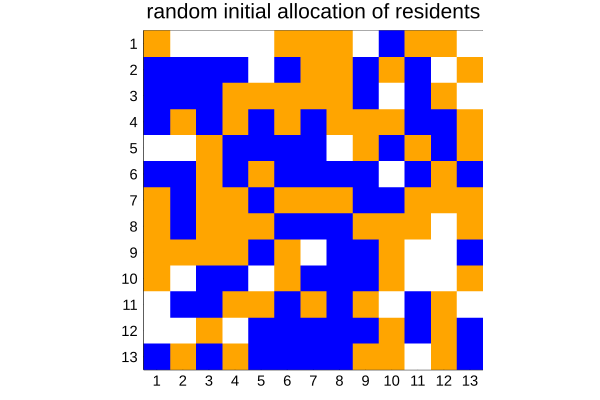

In [297]:
#investigate the random allocation
start_grid = make_random_grid()
title="random initial allocation of residents"
h = gridHeatMap(start_grid,title,true)
display(h)
savefig(h,newFigNameString())
savefig(h,newFigNameString_PDF())

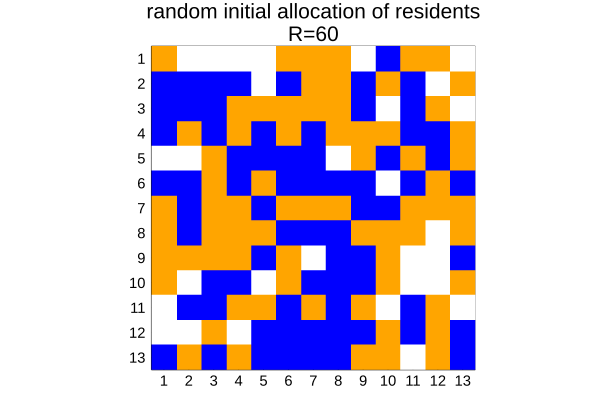

In [298]:
#investigate the random allocation using the same grid as above but
#put the R value in the title
title="random initial allocation of residents \n R=$(grid_satisfaction(start_grid))"
h = gridHeatMap(start_grid,title,true)
display(h)
savefig(h,newFigNameString())
savefig(h,newFigNameString_PDF())

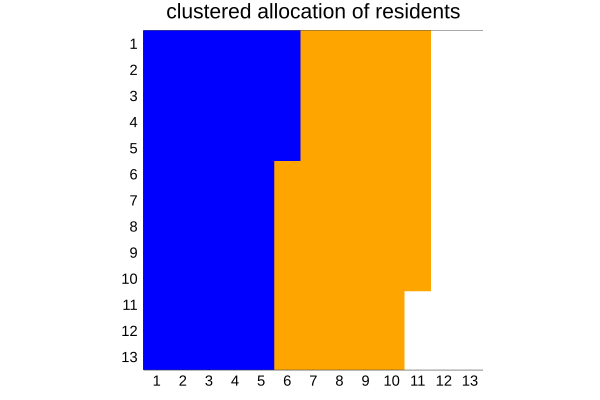

In [299]:
#look at the organized residents on the grid
set_grid = zeros(GRID_SIZE,GRID_SIZE)
set_grid[1:YELLOW_COUNT] .= 1
set_grid[YELLOW_COUNT+1:YELLOW_COUNT+BLUE_COUNT] .= -1

title="clustered allocation of residents"
h = gridHeatMap(set_grid,title,true)
display(h)
savefig(h,newFigNameString())
savefig(h,newFigNameString_PDF())

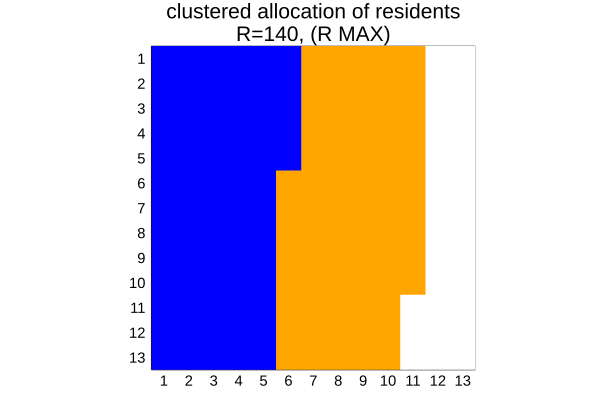

In [300]:

title="clustered allocation of residents \n R=$(grid_satisfaction(set_grid)), (R MAX)"
h = gridHeatMap(set_grid,title,true)
display(h)
savefig(h,newFigNameString())
savefig(h,newFigNameString_PDF())

In [301]:
#after making these FNs set the max satisfaction value
R_MAX = grid_satisfaction(set_grid)
println("set grid satisfaction value MAX = ",R_MAX)

set grid satisfaction value MAX = 140


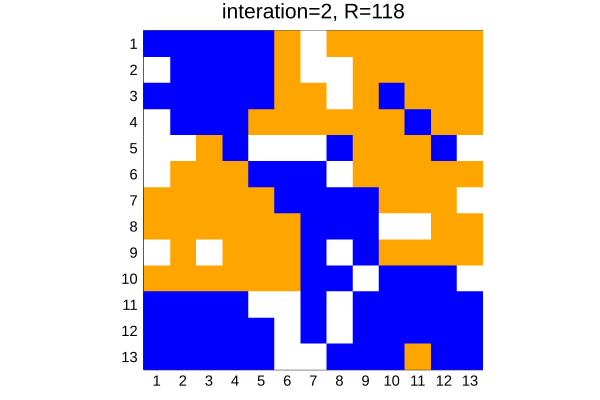

In [302]:
#test the single step of the grid movements 
newGrid = move_cells_for_satisfaction(start_grid)

satisfiedOneGrid = grid_satisfaction(newGrid)
title="interation=2, R=$(satisfiedOneGrid)"
h = gridHeatMap(newGrid,title,true)
display(h)
savefig(h,newFigNameString())
savefig(h,newFigNameString_PDF())

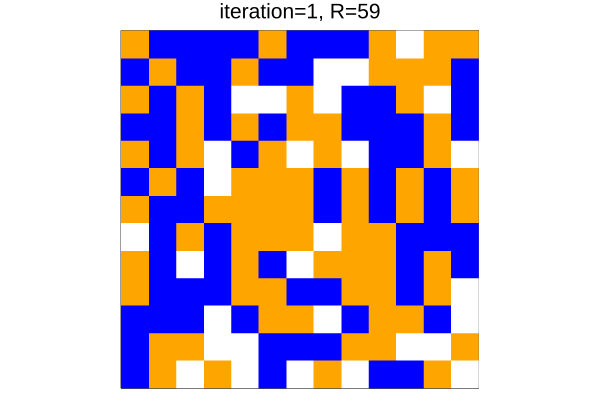

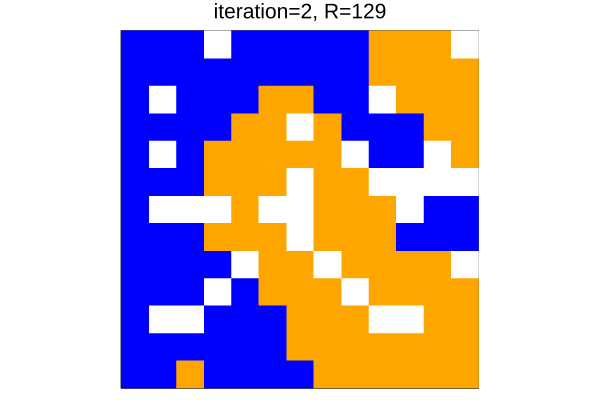

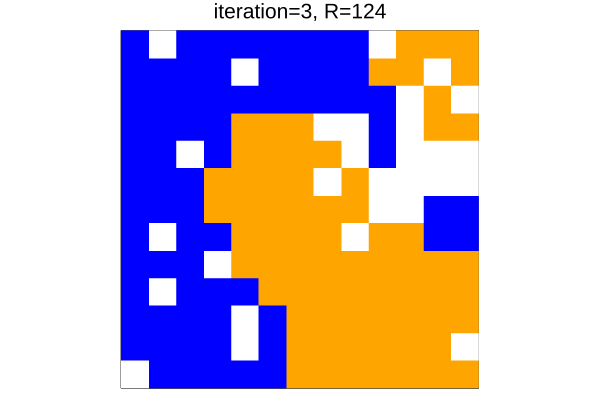

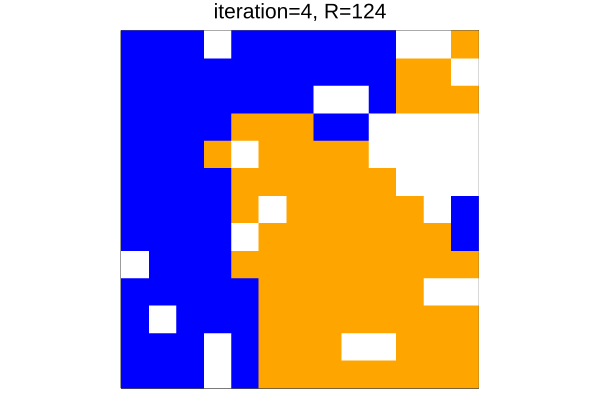

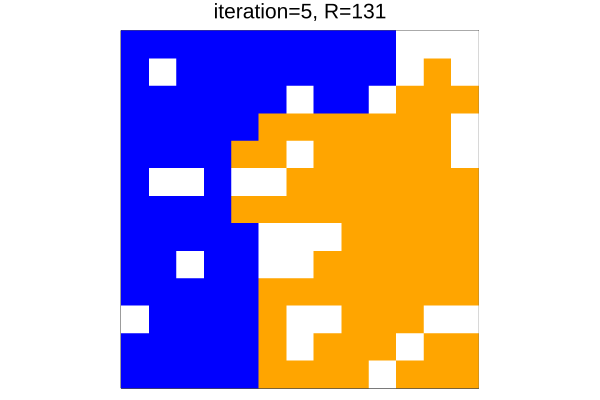

...

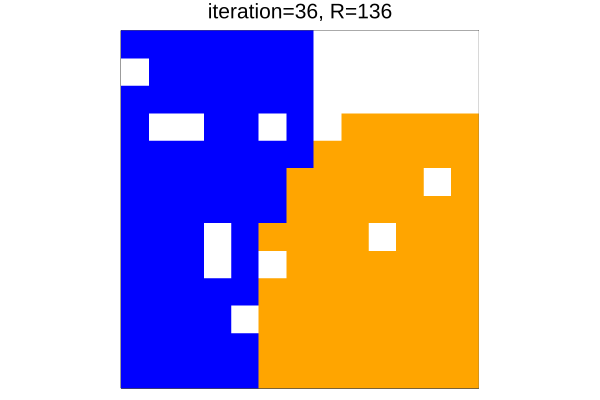

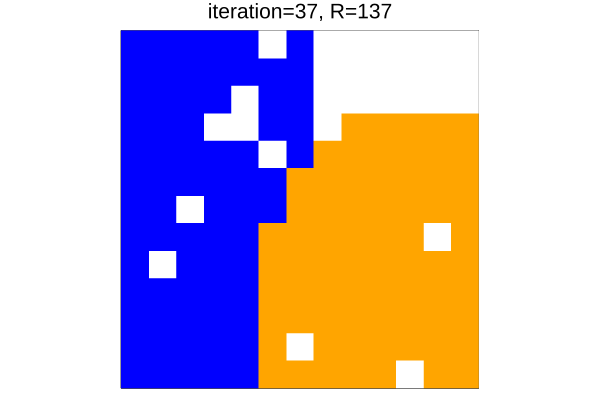

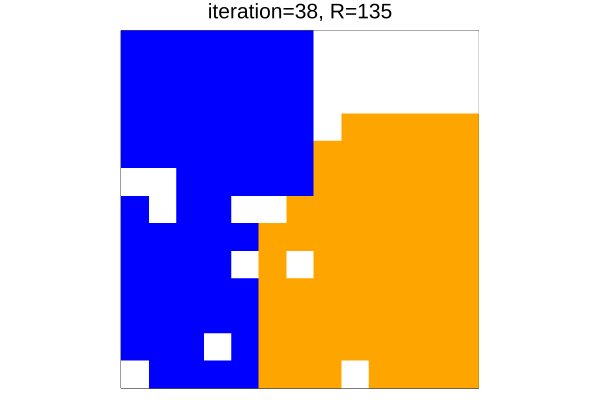

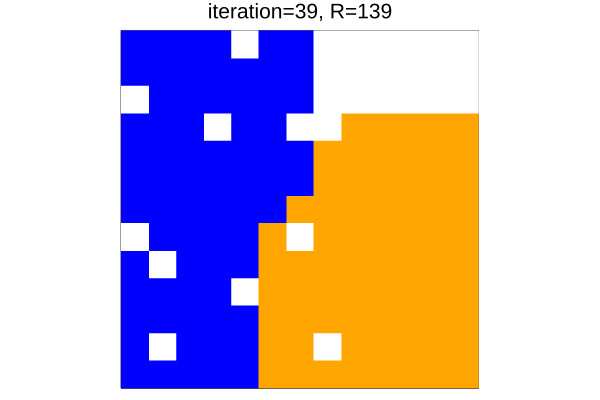

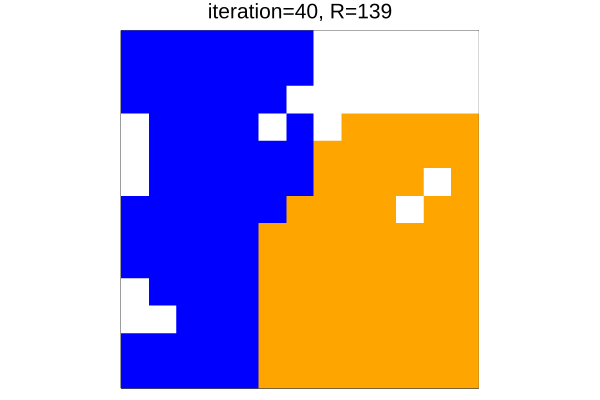

In [303]:
#show the steps of the Schelling Dynamics on the pure spatial
gridDict = Dict()#gets used in later cells
gridDict[1] = make_random_grid()

for tt in 2:TT
gridDict[tt] = move_cells_for_satisfaction(gridDict[tt-1])
end
for tt in 1:TT
    R = grid_satisfaction(gridDict[tt])    
    title="iteration=$(tt), R=$(R)"
    h = gridHeatMap(gridDict[tt],title,false)
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots1/time$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots1/time$(tt).pdf"))
end

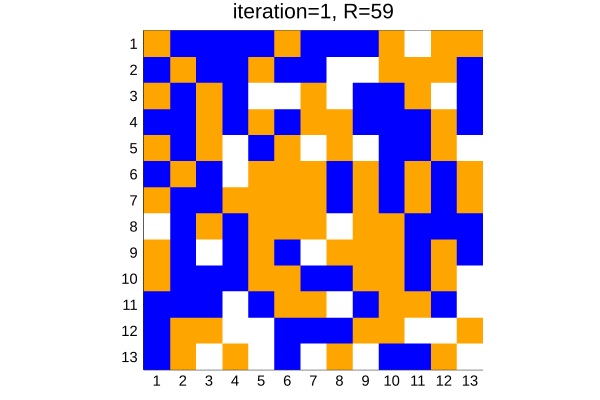

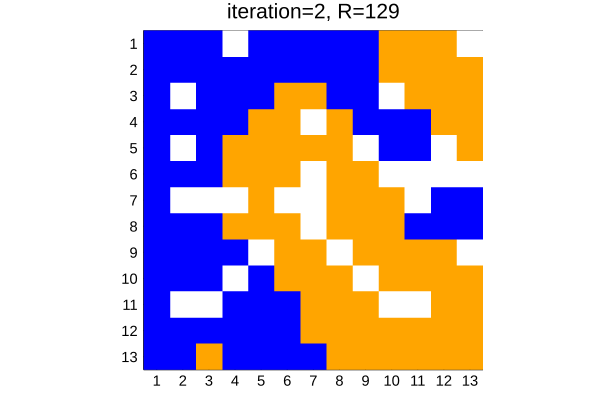

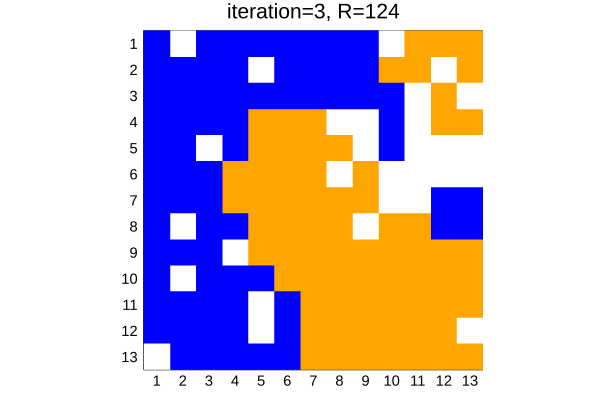

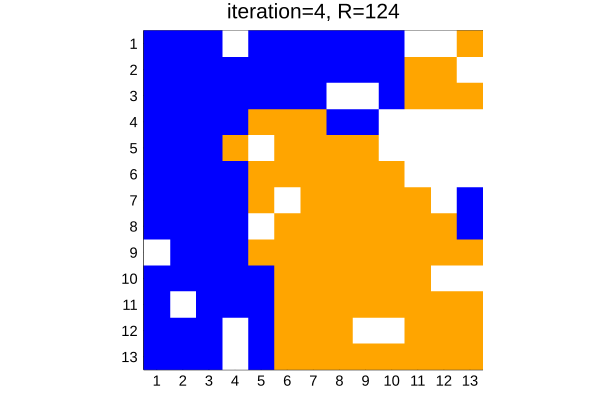

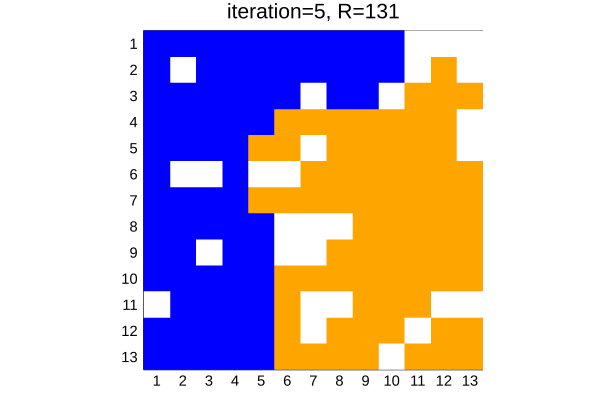

...

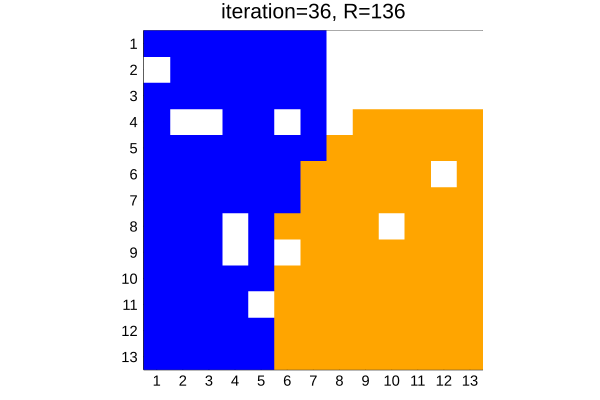

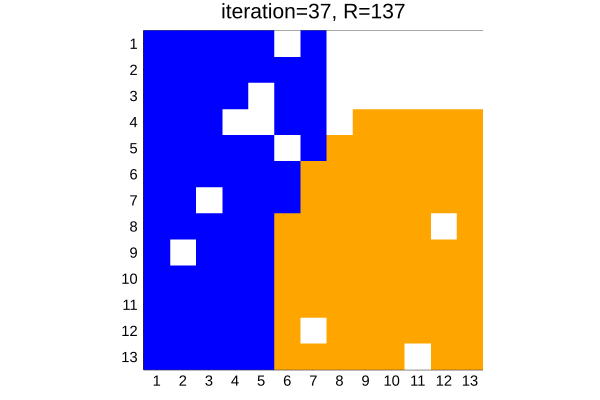

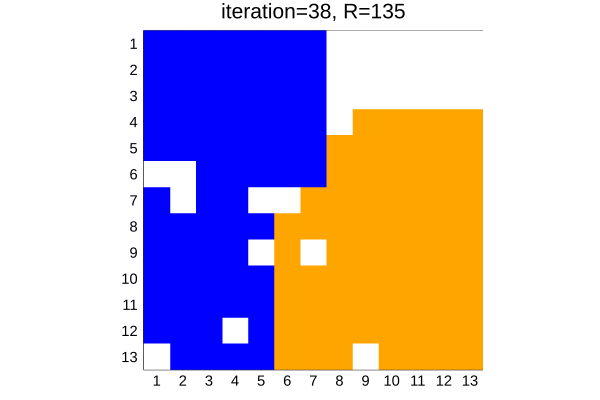

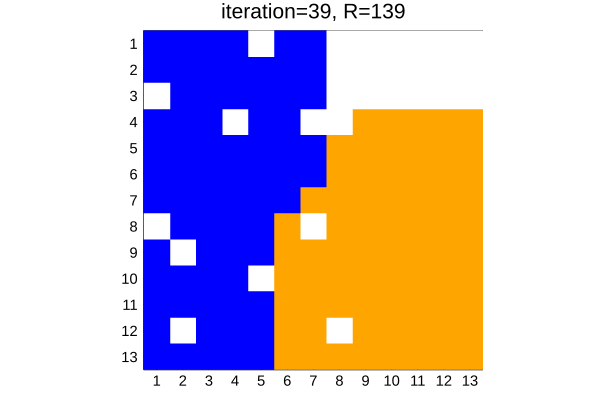

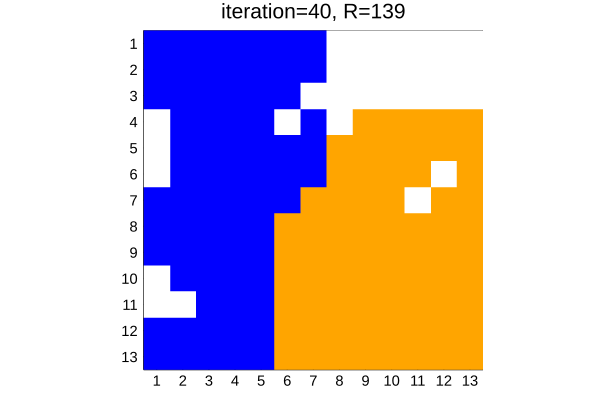

In [304]:
#show the steps of the Schelling Dynamics on the pure spatial
for tt in 1:TT
    R = grid_satisfaction(gridDict[tt])    
    title="iteration=$(tt), R=$(R)"
    h = gridHeatMap(gridDict[tt],title,true)
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots1/timeB$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots1/timeB$(tt).pdf"))
end

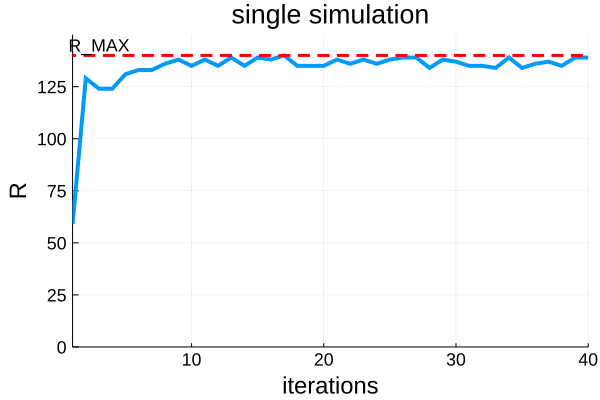

In [305]:
#let's look at this trajectory with only the spatial
traceR = Int[]
for tt in 1:TT    
    append!(traceR,grid_satisfaction(gridDict[tt]))    
end
anns = [(3, 145, text("R_MAX",12,0.1pi))]
plt = plot(traceR,ylim=(0,R_MAX+10),xlim=(1,TT),leg=false,linewidth=4,
    title="single simulation",xlabel="iterations",ylabel="R",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(3,:dash),leg=false,color=:red,anns=anns)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

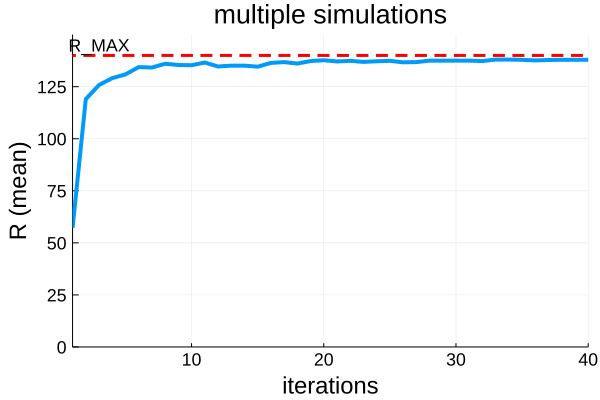

In [306]:
#perform multiple simulations of Schelling and get the mean and std of the R values
#as a trace for the expected value across the iterations
simulationRvals = zeros(TT,MM)
for mm in 1:MM
    newGrid = make_random_grid()
    traceR = []
    append!(traceR,grid_satisfaction(newGrid))#initial time zero point
    for tt in 2:TT
        newGrid = move_cells_for_satisfaction(newGrid)
        append!(traceR,grid_satisfaction(newGrid))
    end
    simulationRvals[:,mm] = traceR[:]

end
#for the error you can also use 'ribbon'    
anns = [(3, 145, text("R_MAX",12,0.1pi))]
plt = plot(mean(simulationRvals,dims=2),xlabel="iterations",
    ylabel="R (mean)",#yerr=std(simulationRvals,dims=2),
    linewidth=4,ylim=(0,R_MAX+10),xlim=(1,TT),
    title="multiple simulations",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(3,:dash),leg=false,color=:red,anns=anns)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

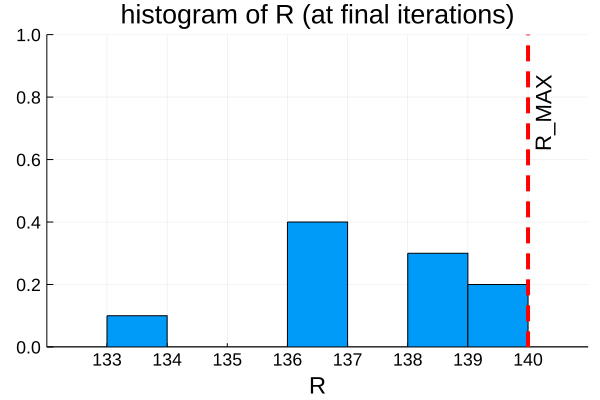

In [307]:
#get the histogram of the final values from the independent simulations
anns = [(R_MAX+0.25, 0.75, text("R_MAX",15,28.5pi))]
pltHist = histogram(simulationRvals[end,:] .- 1,ylim=(0,1.0),
    xlim=(minimum(simulationRvals[end,:])-2,R_MAX+1),
    bins=minimum(simulationRvals[end,:])-2:R_MAX+1,
    xticks = (minimum(simulationRvals[end,:])-2+1:R_MAX+0),
    normalize=:probability,title="histogram of R (at final iterations)",
    xlabel="R",leg=false,
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
vline!([R_MAX],line=(4,:dash),leg=false,color=:red,anns=anns)
display(pltHist)
savefig(pltHist,newFigNameString())
savefig(pltHist,newFigNameString_PDF())

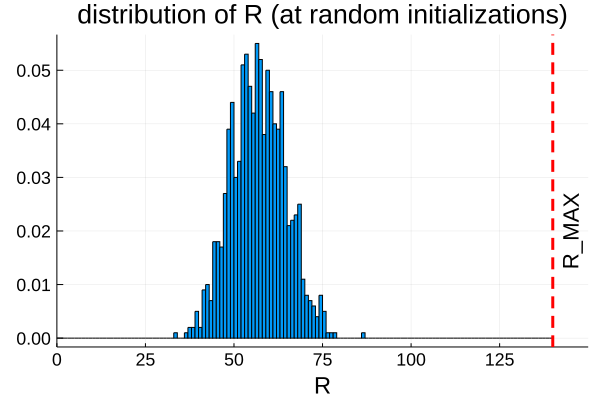

In [308]:
#plot the histogram for the initial grid satisfactions distribution
randomSatisfactions = [grid_satisfaction(make_random_grid()) for x in 1:NUM_RAND_SAMPLES]

anns = [(145, 0.02 , text("R_MAX",15,28.5pi))]
pltHist = histogram(randomSatisfactions,normalize=:probability,bins=0:1:R_MAX,
    xlim=(0,R_MAX+10),title="distribution of R (at random initializations)",
    xlabel="R",xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,
    titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
vline!([R_MAX],line=(3,:dash),leg=false,color=:red,anns=anns)
display(pltHist)
savefig(pltHist,newFigNameString())
savefig(pltHist,newFigNameString_PDF())

In [309]:
#really important steps here:
#we sample the initializations to get a distribution of R, 
#we then get the counts for each R value found from 1 to max to make the
#macrostate distribution of R values

#sample random microstates
randomSatisfactions = [grid_satisfaction(make_random_grid()) for x in 1:NUM_RAND_SAMPLES]
#set the macrostate count array to those random allocations and count for each R value and index
sampleCountsR = [length(findall(randomSatisfactions .== R)) for R in 1:R_MAX]
#can't have zero occurrences so pad the zeros with non-zero account 1
replace!(sampleCountsR,0=>1)

#get the sample probabilities for the R values from initializations via normalization
sampleProbR = sampleCountsR ./ sum(sampleCountsR);

In [310]:
#ENTROPY calculation for the R values; so that the trace of the R values corresponds to 
#permutation, microstate, uncertainty
#now we get the expected number of permutations for each value of R 
#number of microstates for each macrostate value R 

#!!!! R index for the number (distribution) of the R to number of microstates
sampleOmegaR = sampleProbR .* CELLS_SPACE_SIZE;

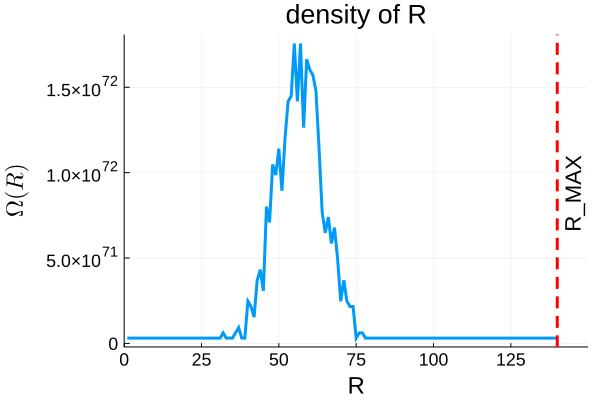

In [311]:
#plot the number of microstates for each macrostate value R
anns = [(145, maximum(sampleOmegaR) / 2, text("R_MAX",15,28.5pi))]

plt = plot(1:R_MAX,sampleOmegaR,xlim=(0,R_MAX+10),
    linewidth=3,title="density of R",
    xlabel="R",ylabel=L"\Omega(R)",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
vline!([R_MAX],line=(3,:dash),leg=false,color=:red,anns=anns)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

In [312]:
#transform the microstate count to 'ENTROPY'
entropyVals = [S_entropy_values_from_R(R) for R in 1:R_MAX];


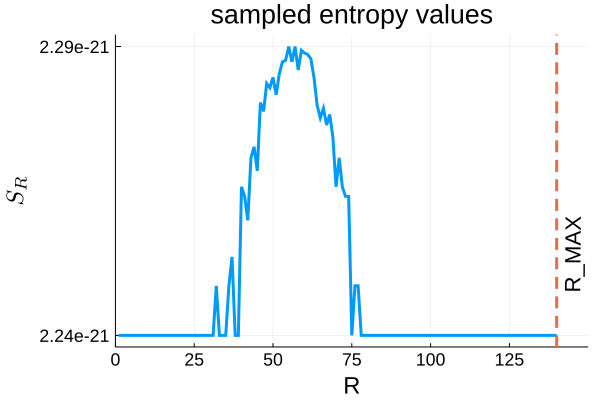

In [313]:
#plot the entropy values for the macrostate values 
eLabels = entropyYlabels(entropyVals)

anns = [(145, (1 + 7*10^-3)*(minimum(entropyVals)) , text("R_MAX",15,28.5pi))]

plt = plot(1:R_MAX,entropyVals,
    yticks=([minimum(entropyVals),maximum(entropyVals)],[eLabels[1],eLabels[2]]),
    xlim=(0,R_MAX+10),ylim=(minimum(entropyVals)*(1-(10^-3)),(1 + 10^-3)*maximum(entropyVals)),
    linewidth=3,title=string("sampled entropy values"),
    xlabel="R",ylabel=L"S_R",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
vline!([R_MAX],line=(3,:dash),leg=false,anns=anns)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

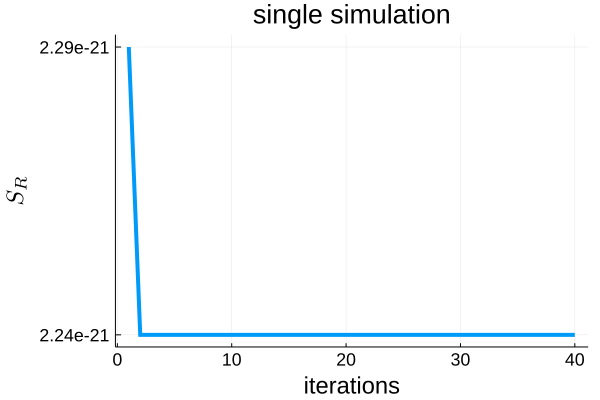

In [314]:
#Single simulation and produce the R and S_R (entropy trace)
newGrid = make_random_grid()
traceR = []
traceS = []
Rtmp = grid_satisfaction(newGrid)
append!(traceR,Rtmp)
append!(traceS,S_entropy_values_from_R(Rtmp))
for tt in 2:TT
    newGrid = move_cells_for_satisfaction(newGrid)
    Rtmp = grid_satisfaction(newGrid)
    append!(traceR,Rtmp)
    append!(traceS,S_entropy_values_from_R(Rtmp))
end

eLabels = entropyYlabels(traceS)

plt = plot(traceS,yticks=([minimum(traceS),maximum(traceS)],[eLabels[1],eLabels[2]]),
    ylims=(minimum(traceS)*(1-(10^-3)),(1 + 10^-3)*maximum(traceS)),
    linewidth=4,title="single simulation",
    xlabel="iterations",leg=false,ylabel=L"S_R",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

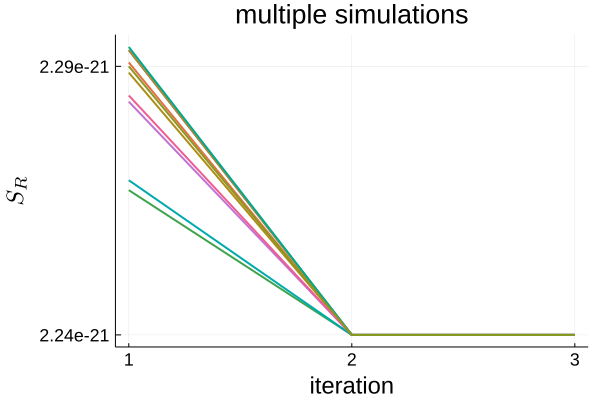

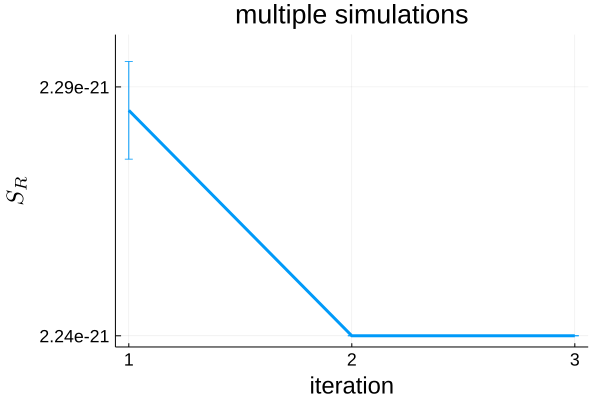

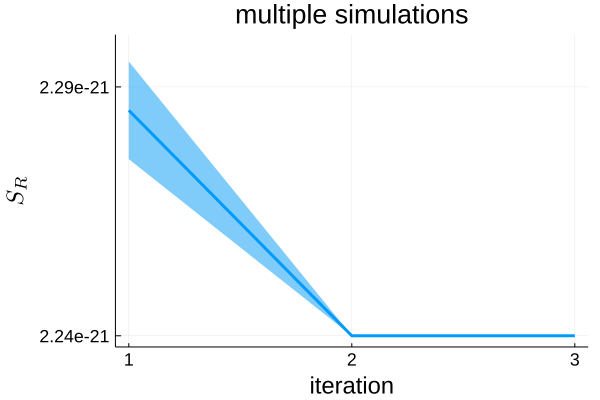

In [315]:
#Now simulate a series of schellings traces and plot the set of traces
simulationSvals = zeros(TT,MM)
for mm in 1:MM
    traceR = Int[]
    traceS = Int[]
    newGrid = make_random_grid()
    traceR = []
    traceS = []
    Rtmp = grid_satisfaction(newGrid)
    append!(traceR,Rtmp)
    append!(traceS,S_entropy_values_from_R(Rtmp))
    for tt in 2:TT
        newGrid = move_cells_for_satisfaction(newGrid)
        Rtmp = grid_satisfaction(newGrid)
        append!(traceR,Rtmp)
        append!(traceS,S_entropy_values_from_R(Rtmp))
    end
    simulationSvals[:,mm] = traceS[:]
end

eLabels = entropyYlabels(traceS)

plt = plot(simulationSvals[1:3,1:end],
    yticks=([minimum(traceS),maximum(traceS)],[eLabels[1],eLabels[2]]),
    ylims=(minimum(simulationSvals)*(1-(10^-3)),(1 + 10^-3)*maximum(simulationSvals)),
    xticks=1:3, linewidth=2,xlabel="iteration",
    title="multiple simulations",
    leg=false,ylabel=L"S_R",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

plt = plot(mean(simulationSvals,dims=2)[1:3],
    yerr=std(simulationSvals,dims=2)[1:3],
    yticks=([minimum(traceS),maximum(traceS)],[eLabels[1],eLabels[2]]),
    ylims=(minimum(simulationSvals)*(1-(10^-3)),(1 + 3*10^-3)*maximum(simulationSvals)),
    xticks=1:3,linewidth=3,xlabel="iteration",ylabel=L"S_R",
    title="multiple simulations",#"S_R for multiple simulations",
    leg=false,ytickfont=TICKFONTSIZE,
    xtickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

plt = plot(mean(simulationSvals,dims=2)[1:3],
    ribbon=std(simulationSvals,dims=2)[1:3],
    yticks=([minimum(traceS),maximum(traceS)],[eLabels[1],eLabels[2]]),
    ylims=(minimum(simulationSvals)*(1-(10^-3)),(1 + 3*10^-3)*maximum(simulationSvals)),
    xticks=1:3,linewidth=3,xlabel="iteration",ylabel=L"S_R",
    title="multiple simulations",#
    leg=false,xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

In [316]:
##################
#FINANCE PART NOW!
##################


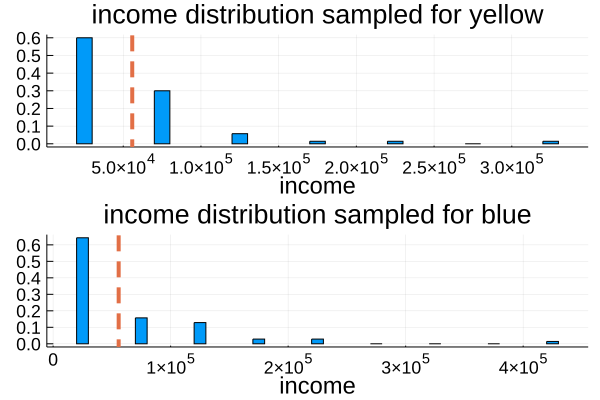

In [317]:
#get income samples that have the same total between groups,
#but different samples from the reference distribution
wealthSamplesYellow = getResidentIncomeSamples(TOTAL_INCOME_GROUP)
wealthSamplesBlue = getResidentIncomeSamples(TOTAL_INCOME_GROUP)    

pltHistYellow = histogram(wealthSamplesYellow,normalize=:probability,
    title="income distribution sampled for yellow",xlabel="income",
    leg=false,ytickfont=TICKFONTSIZE,bar_width=10000,
    xtickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
vline!([mean(wealthSamplesYellow)],line=(4,:dash),leg=false)
pltHistBlue = histogram(wealthSamplesBlue,normalize=:probability,
    title="income distribution sampled for blue",xlabel="income",leg=false,
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE,bar_width=10000)
vline!([mean(wealthSamplesBlue)],line=(4,:dash),leg=false)
plt = plot(pltHistYellow,pltHistBlue,layout=(2,1))
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

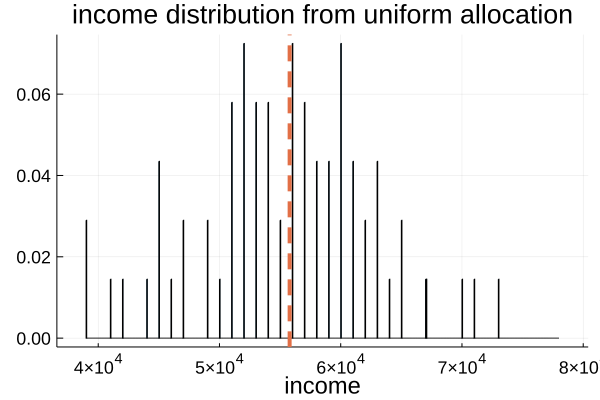

In [318]:
#get the Uniformly allocated incomes for the residents of one type
#uniform allocation for one group type
incomesUniform = randUniformWealthBracketSample()

plt = histogram(incomesUniform,normalize=:probability,
    title="income distribution from uniform allocation",
    xlabel="income",leg=false,
    bins=minimum(incomesUniform):50:maximum(incomesUniform),
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
vline!([mean(incomesUniform)],line=(4,:dash),leg=false)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

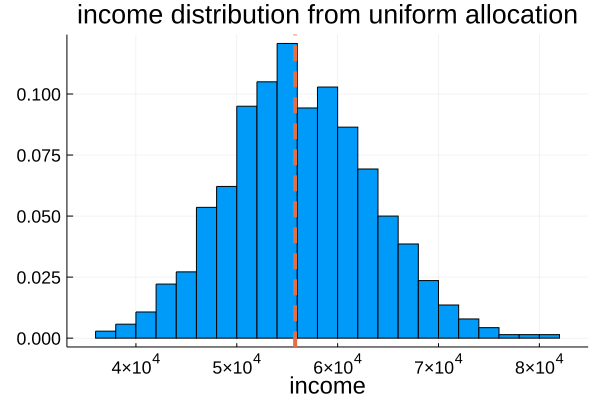

In [319]:
#get the Distribution for multiple iniform income distributed samples

uniformResidentIncomes = [randUniformWealthBracketSample() for x in 1:UNIFORM_SAMPLE_NUM]
uniformResidentIncomesVec = zeros(UNIFORM_SAMPLE_NUM*YELLOW_COUNT)
for i in 1:UNIFORM_SAMPLE_NUM
    uniformResidentIncomesVec[1 + (YELLOW_COUNT*(i-1)): YELLOW_COUNT + (YELLOW_COUNT*(i-1))] = 
        uniformResidentIncomes[i][:]    
end
uniformResidentIncomesMean = mean(uniformResidentIncomesVec)

plt = histogram(uniformResidentIncomesVec,normalize=:probability,
    title="income distribution from uniform allocation",xlabel="income",leg=false,
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
vline!([mean(uniformResidentIncomesVec)],line=(4,:dash),leg=false)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

In [320]:
#generates the grid where the finance is the uniform dollar drop process
gridUniformIncome = make_uniform_sampled_finance_grid();


In [321]:
#spatial and financial data that is from the income distribution
gridDataIncome = make_random_finance_grid();


In [322]:
#get the financial surroundings
#pass the grid and provide the cell to get the surrounding finance or type array
#inspect the financial grid surroundings
for row in 2:5
    for col in 2:5
    if( gridDataIncome[row,col,1] != 0 )
    println("own cell income=",gridDataIncome[row,col,2])
    arrayCellFinance = cell_surround_arrayTMP_financial(gridDataIncome,row,col,2)
    println(arrayCellFinance)
    #print the group label array surrounding
    println("own cell group label=",gridDataIncome[row,col,1])    
    arrayCellType = cell_surround_arrayTMP_financial(gridDataIncome,row,col,1)
    println(arrayCellType)
    #return the homogeneity satisfaction of an income cell randomly chosen
    moneyDeviation = financial_cell_deviation(gridUniformIncome,row,col)
    println(moneyDeviation)
    end
    end
end
println("financial grid deviation full=$(financial_grid_deviation(gridDataIncome))")

own cell income=90716.0
Any[64797.0, 4320.0, 159832.0, 67636.0, 24919.0, 21599.0, 0.0, 38878.0]
own cell group label=1.0
Any[1.0, 1.0, 1.0, -1.0, -1.0, 1.0, 0.0, 1.0]
1
own cell income=24919.0
Any[4320.0, 159832.0, 17799.0, 90716.0, 60516.0, 0.0, 38878.0, 90716.0]
own cell group label=-1.0
Any[1.0, 1.0, -1.0, 1.0, -1.0, 0.0, 1.0, 1.0]
1
own cell income=60516.0
Any[159832.0, 17799.0, 46277.0, 24919.0, 10679.0, 38878.0, 90716.0, 145951.0]
own cell group label=-1.0
Any[1.0, -1.0, -1.0, -1.0, -1.0, 1.0, 1.0, -1.0]
1
own cell income=10679.0
Any[17799.0, 46277.0, 188669.0, 60516.0, 64797.0, 90716.0, 145951.0, 0.0]
own cell group label=-1.0
Any[-1.0, -1.0, -1.0, -1.0, 1.0, 1.0, -1.0, 0.0]
0
own cell income=38878.0
Any[90716.0, 24919.0, 60516.0, 0.0, 90716.0, 107995.0, 142553.0, 82076.0]
own cell group label=1.0
Any[1.0, -1.0, -1.0, 0.0, 1.0, 1.0, 1.0, 1.0]
1
own cell income=90716.0
Any[24919.0, 60516.0, 10679.0, 38878.0, 145951.0, 142553.0, 82076.0, 0.0]
own cell group label=1.0
Any[-1.0, -1.

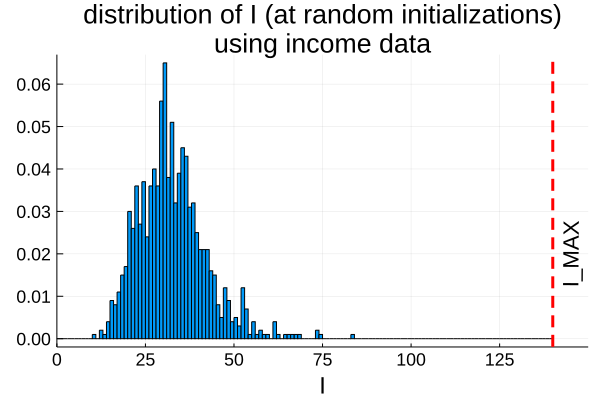

In [323]:
#MAD deviations using the data from incomes 
randomIncomeDataDeviations = [financial_grid_deviation(make_random_finance_grid()) for x in 1:NUM_RAND_SAMPLES]
meanRealSampleIncomeDeviations = mean(randomIncomeDataDeviations)

anns = [(145, 0.02 , text("I_MAX",15,28.5pi))]
plt = histogram(randomIncomeDataDeviations,normalize=:probability,
    title="distribution of I (at random initializations) \n using income data",
    xlabel="I",leg=false,
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,
    titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE,
    xlim=(0,R_MAX+10),
    bins=0:1:R_MAX)
#vline!([mean(randomIncomeDataDeviations)],line=(4,:dash),leg=false)
vline!([R_MAX],line=(3,:dash),leg=false,color=:red,anns=anns)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

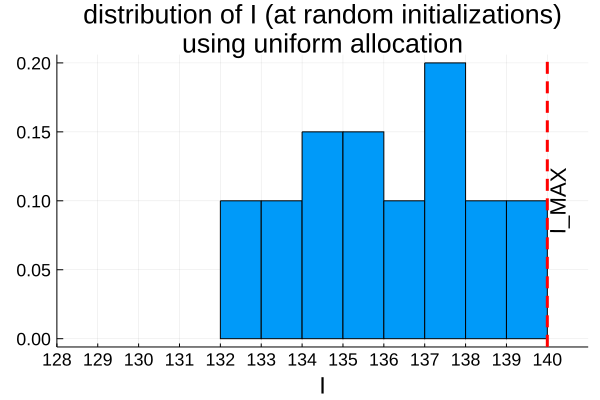

In [324]:
#!!!
#financial deviations using the data from incomes 
randomUniformDataDeviations = [financial_grid_deviation(make_uniform_sampled_finance_grid()) for x in 1:UNIFORM_SAMPLE_NUM]#NUM_RAND_SAMPLES]
meanUniformSampleIncomeDeviations = mean(randomUniformDataDeviations)

anns = [(140.25, 0.1 , text("I_MAX",15,28.5pi))]
plt = histogram(randomUniformDataDeviations,normalize=:probability,
    title="distribution of I (at random initializations) \n using uniform allocation",
    xlabel="I",leg=false,bar_width=1,
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE,bins=minimum(randomUniformDataDeviations):1:R_MAX,
    xlim=(minimum(randomUniformDataDeviations)-4,R_MAX+1),
    xticks=minimum(randomUniformDataDeviations)-4:R_MAX)
    
#vline!([mean(randomUniformDataDeviations)],line=(4,:dash),leg=false)
vline!([R_MAX],line=(3,:dash),leg=false,color=:red,anns=anns)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

In [325]:
######################!!!!!!!!
#NOW BOTH MACROSTATE VARIABLES 
######################!!!!!!!!

In [326]:
#SAMPLES SPACE OF THE 2D MODEL, 
#permutation number for the spatial and the income resident state
#total number of microstates across all macrostates
SET_2D_SPATIAL_INCOME_CELL_SPACE(TOTAL_INCOME_GROUP); # sets: CELLS_SPACE_SIZE_2D

In [327]:
#CELLS_SPACE_SIZE_2D

In [328]:
make_random_finance_grid() 

13×13×2 Array{Float64,3}:
[:, :, 1] =
  0.0  -1.0   0.0  -1.0  -1.0   1.0  -1.0   0.0   1.0   1.0   1.0   1.0   1.0
  1.0  -1.0  -1.0   1.0   0.0   0.0   0.0  -1.0   1.0   1.0  -1.0   1.0   1.0
  0.0  -1.0  -1.0  -1.0   1.0   1.0   1.0   1.0  -1.0  -1.0   1.0   0.0  -1.0
 -1.0   0.0  -1.0   1.0  -1.0   1.0   1.0   1.0  -1.0   0.0  -1.0   1.0  -1.0
  1.0  -1.0  -1.0   1.0  -1.0  -1.0   1.0   1.0  -1.0  -1.0  -1.0  -1.0   1.0
 -1.0   0.0   1.0  -1.0   1.0   1.0   0.0  -1.0   1.0   0.0   1.0   1.0   0.0
 -1.0   0.0  -1.0  -1.0   1.0   0.0   0.0  -1.0  -1.0   0.0   1.0   1.0  -1.0
  1.0   1.0  -1.0   0.0  -1.0  -1.0   1.0  -1.0  -1.0   0.0   1.0   0.0   1.0
 -1.0  -1.0  -1.0   1.0   1.0   1.0   0.0   1.0  -1.0   0.0   1.0   1.0  -1.0
  1.0  -1.0  -1.0  -1.0   1.0   1.0   0.0   1.0   1.0   1.0  -1.0   1.0  -1.0
 -1.0   1.0  -1.0  -1.0   1.0  -1.0   1.0  -1.0  -1.0   1.0  -1.0   0.0  -1.0
  1.0   0.0  -1.0   0.0  -1.0  -1.0   1.0   1.0   1.0   1.0   1.0   1.0  -1.0
  1.0   0.0   1.0  -1.0  -

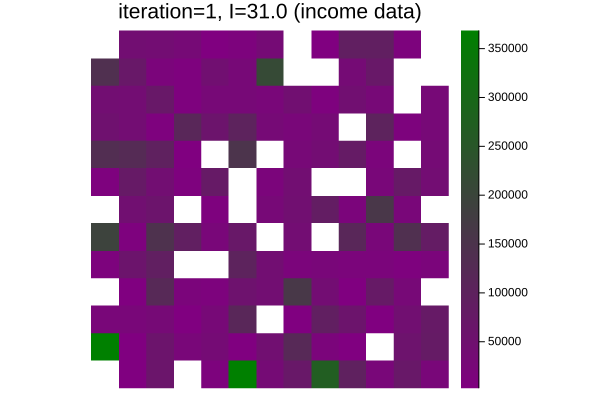

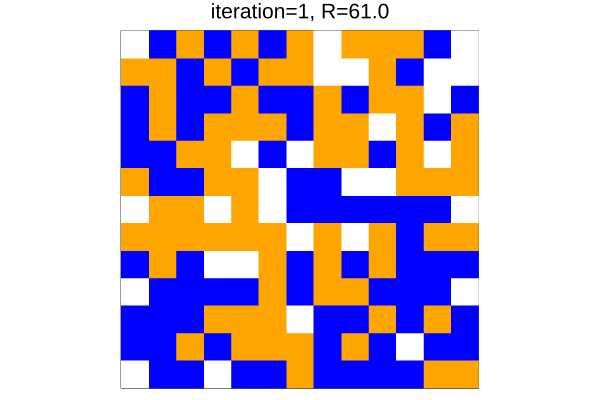

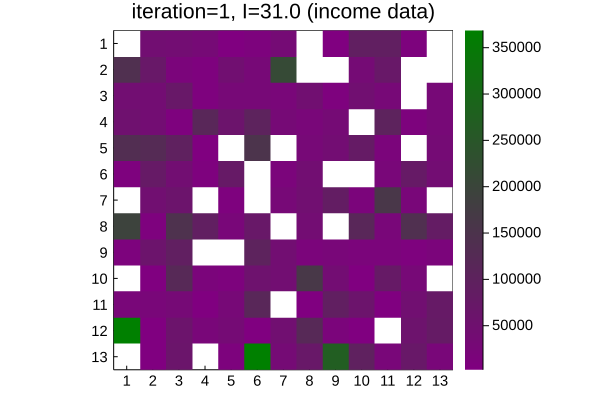

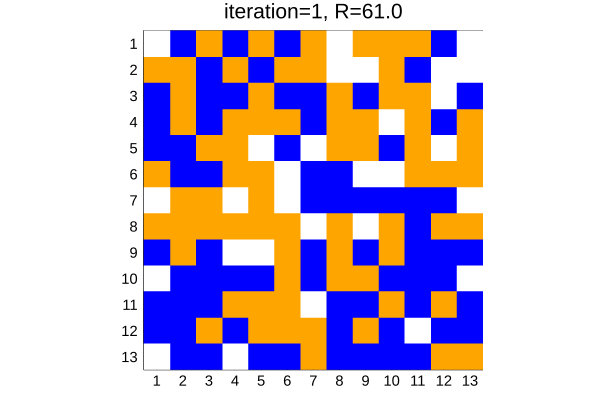

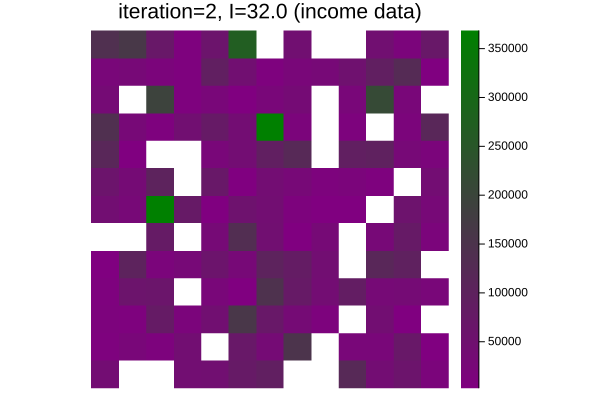

...

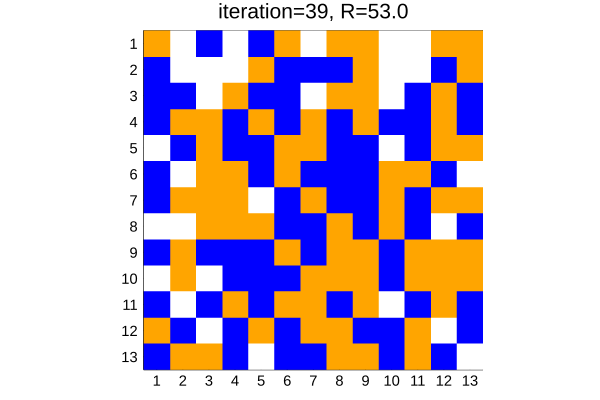

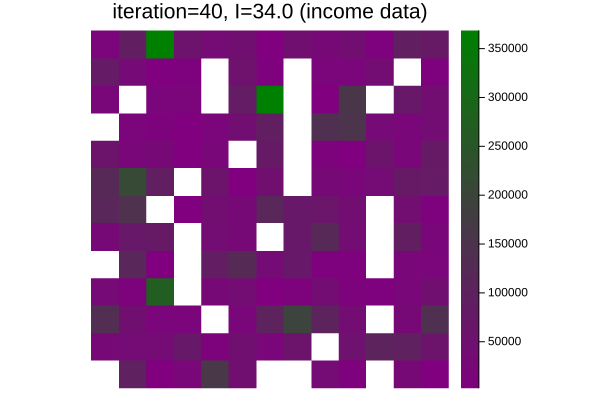

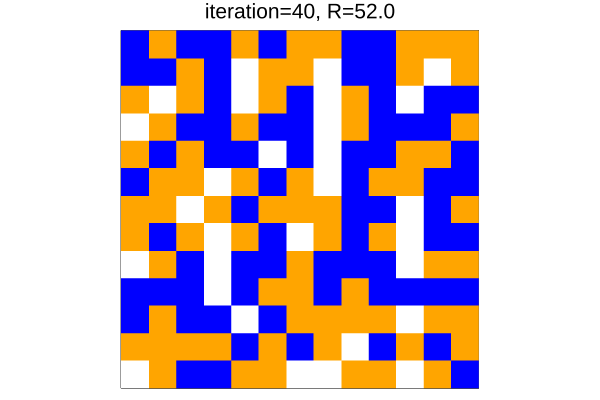

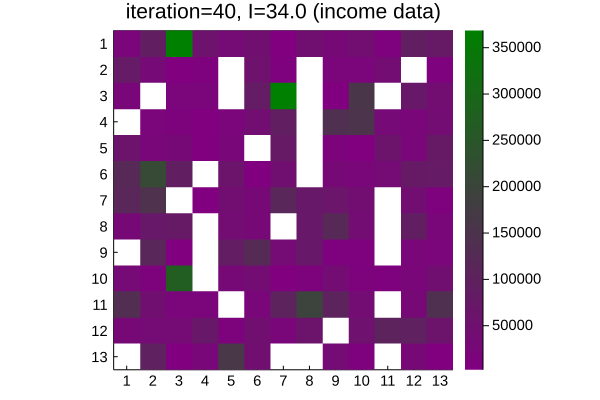

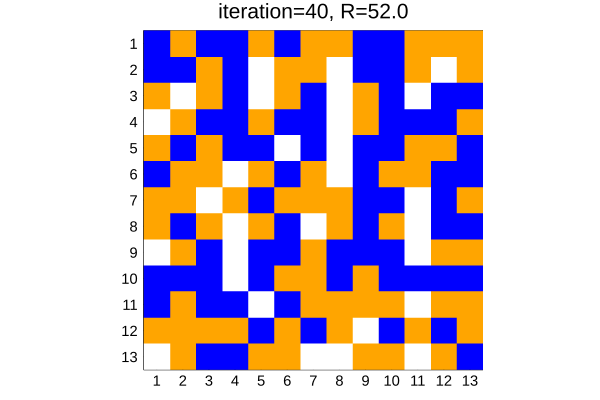

In [329]:
#simulate only label movements with no income dynamics
#and track both the macrostates variables 
#REAL INCOME DATA
traceR_real_single = zeros(TT)
traceI_real_single = zeros(TT)
moneyGrid = make_random_finance_grid() 
trace2D = [] #stores the tuples of the trace 2D coordinates
for tt in 1:TT
    if(tt==1)
        #make_random_finance_grid()  
        moneyGrid = make_random_finance_grid()  
    else
        #now make the cells 'move' but not change their income
        moneyGrid =  move_cells_for_wealth_NoDynamics(moneyGrid) 
    end
    #get the homogeneity satisfaction for the spatial arrangements
    traceR_real_single[tt] = grid_satisfaction(moneyGrid[:,:,1])
    #get the financial component of the grid's homogeneity satisfaction 
    traceI_real_single[tt] = financial_grid_deviation(moneyGrid)
    
    if(tt==1)
        trace2D = (traceR_real_single[tt],traceI_real_single[tt])
    else
        trace2D = vcat(trace2D,[(traceR_real_single[tt],traceI_real_single[tt])])
    end  
    
    gridTmp = deepcopy(moneyGrid[:,:,2])
    inds = findall(gridTmp .== 0)    
    gridTmp[inds] .= NaN #so the values do not affect the scale of the legend
    h = heatmap(gridTmp,
        title="iteration=$(tt), I=$(round(traceI_real_single[tt],digits=2)) (income data)",
        showaxis=false,xticks=false,yticks=false,yaxis=:flip,aspect_ratio=1.0,
        framestyle=:box,xlims=(0.5,GRID_SIZE+0.5),legend=true,
        c=ColorGradient([:purple,:green]))    
   
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots2/I_time$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots2/I_time$(tt).pdf"))
    
    h = gridHeatMap(moneyGrid[:,:,1],"iteration=$(tt), R=$(traceR_real_single[tt])",
        false)
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots2/R_time$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots2/R_time$(tt).pdf"))
    
    #now put the x and y ticks on the cell positions for the sake of it
    h = heatmap(gridTmp,
        title="iteration=$(tt), I=$(round(traceI_real_single[tt],digits=2)) (income data)",
        showaxis=true,xticks=1:GRID_STEP:GRID_SIZE,yticks=1:GRID_STEP:GRID_SIZE,
        yaxis=:flip,aspect_ratio=1.0,xtickfont=10,ytickfont=10,
        framestyle=:box,xlims=(0.5,GRID_SIZE+0.5),legend=true, grid=false,   
        c=ColorGradient([:purple,:green])) 
    
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots2/I_timeB$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots2/I_timeB$(tt).pdf"))
    
    h = gridHeatMap(moneyGrid[:,:,1],"iteration=$(tt), R=$(traceR_real_single[tt])",
        true)
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots2/R_timeB$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots2/R_timeB$(tt).pdf"))
end


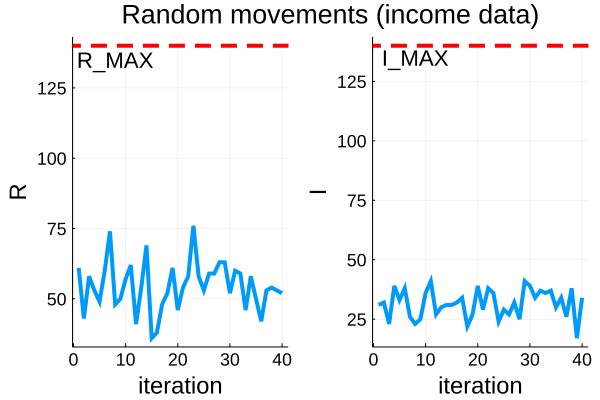

32.055
55787.0


GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT


In [330]:
#plot the trces for both the spatial and the INCOME DATA

plt1 = plot(traceR_real_single,linewidth=4,#title="random moves",
    xlabel="iteration",leg=false,ylabel="R",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 135 , text("R_MAX",15))

p2 = plot(traceI_real_single,linewidth=4,#title="random moves",
    xlabel="iteration",
    leg=false,ylabel="I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 135 , text("I_MAX",15))

#pboth = plot(plt1,p2)
title = plot(title = "Random movements (income data)", grid = false,titlefont=TITLEFONTSIZE,
    showaxis = false, bottom_margin = -50Plots.px)
pboth = plot(title, plt1, p2, layout = @layout([A{0.05h}; [B C]]))
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())
println(meanRealSampleIncomeDeviations)
println(uniformResidentIncomesMean)

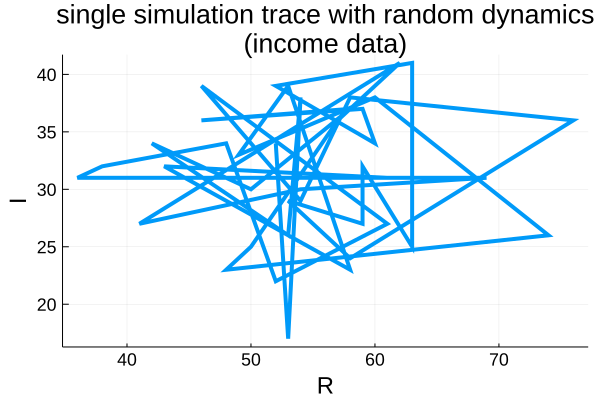

In [331]:
#plot the trajectory of the 2D for REAL DATA INCOME
#random movements and income dynamics
plt = plot(traceR_real_single,traceI_real_single,line=:path,
    linewidth=4,title="single simulation trace with random dynamics \n (income data)",
    xlabel="R",leg=false,ylabel="I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

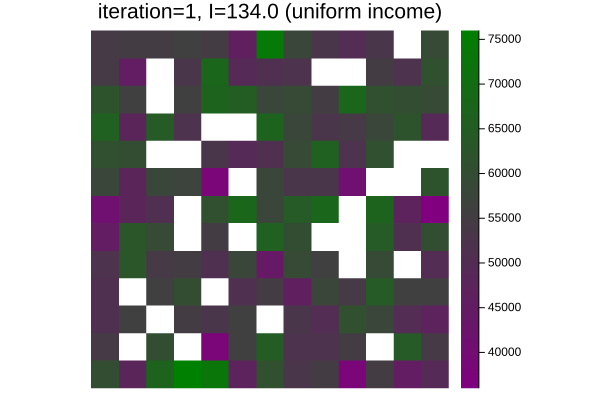

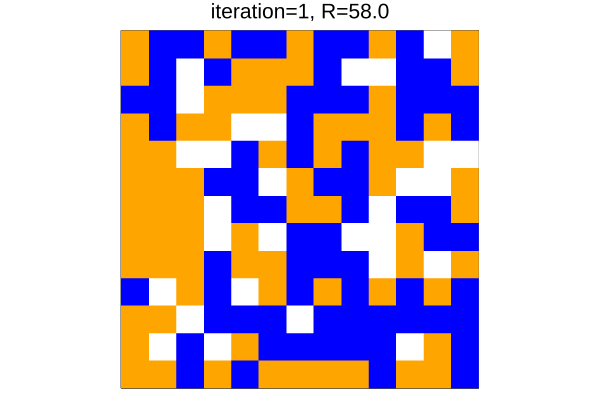

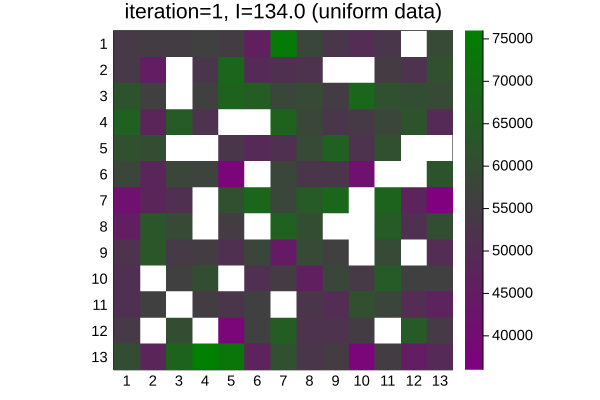

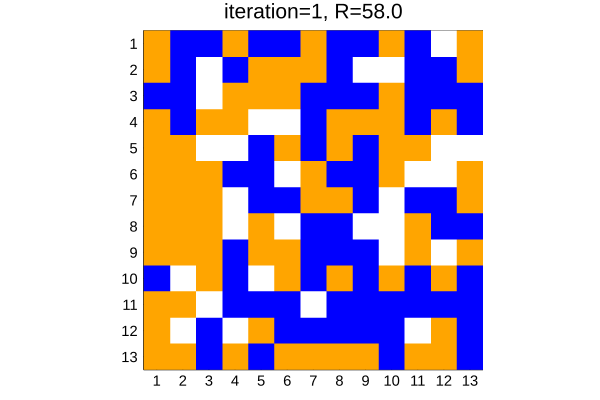

1


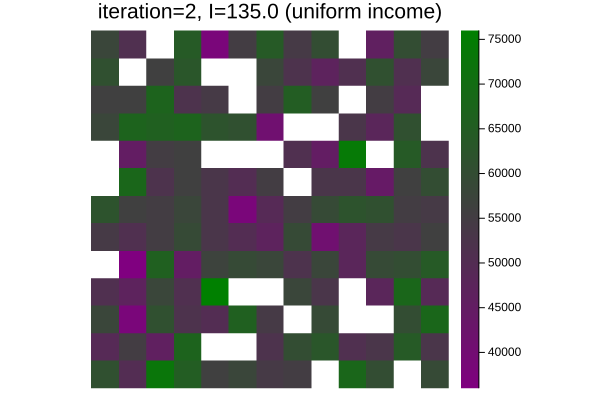

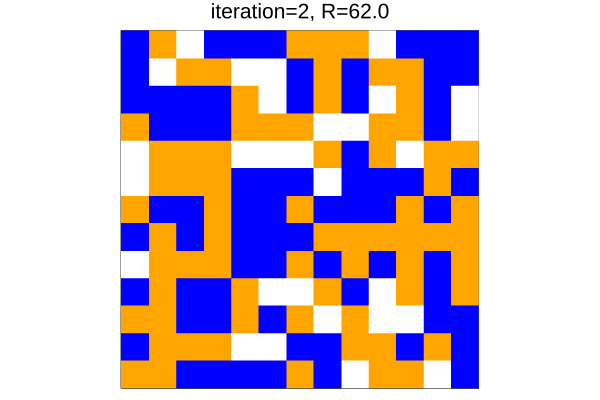

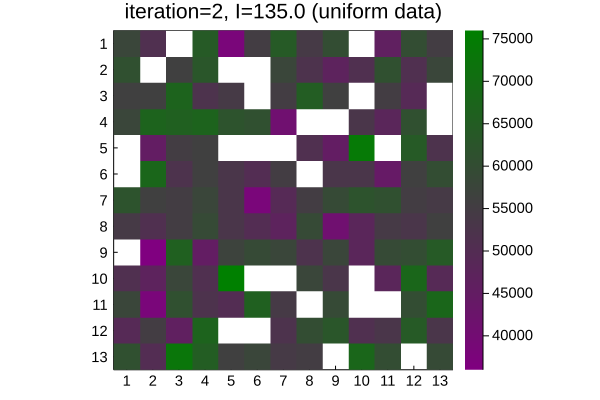

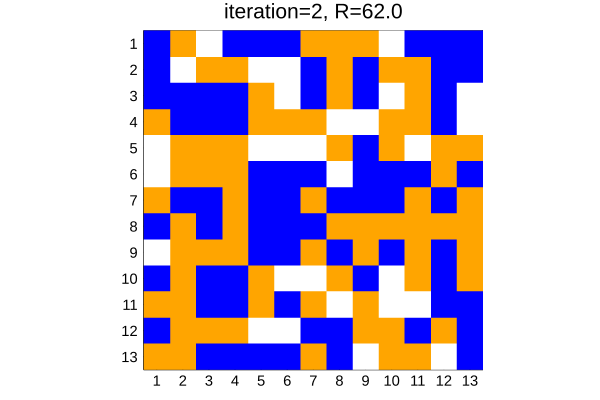

2


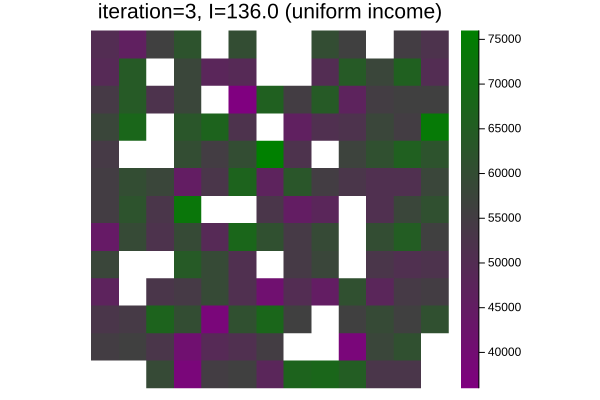

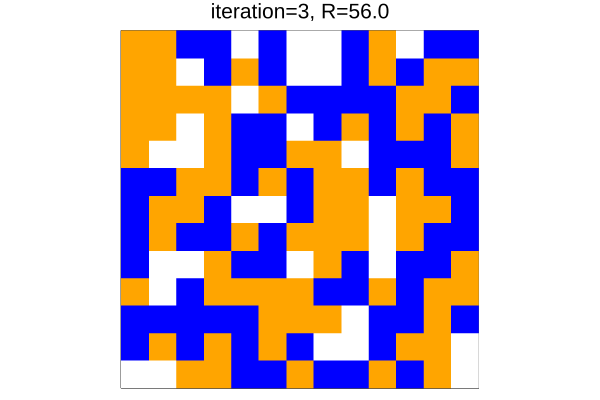

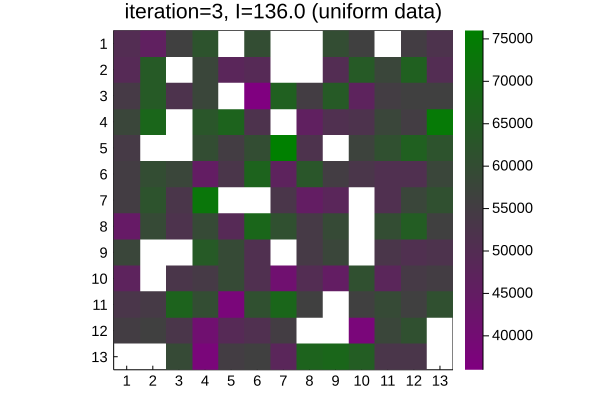

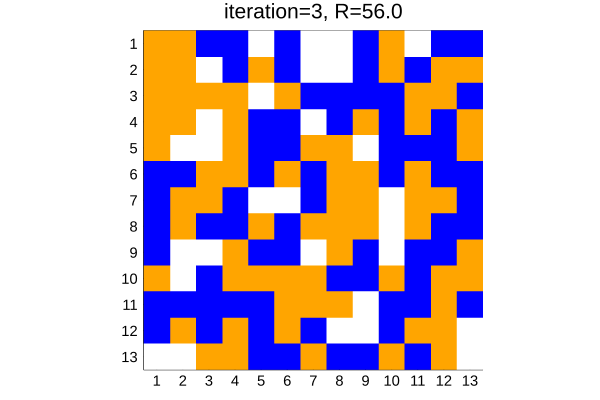

3


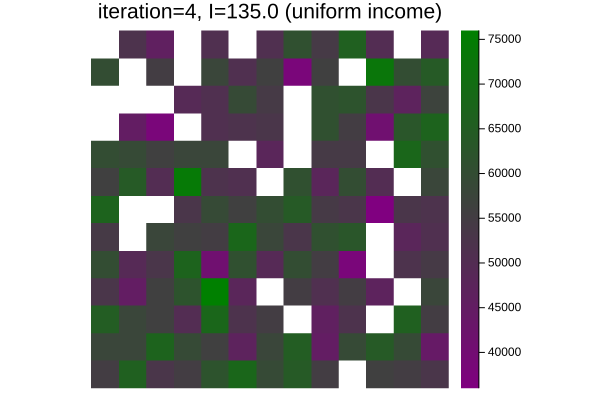

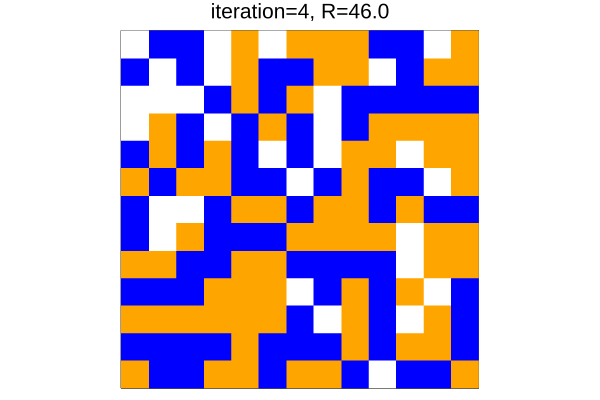

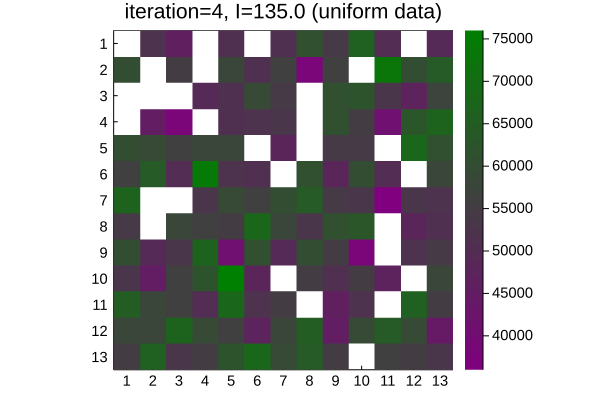

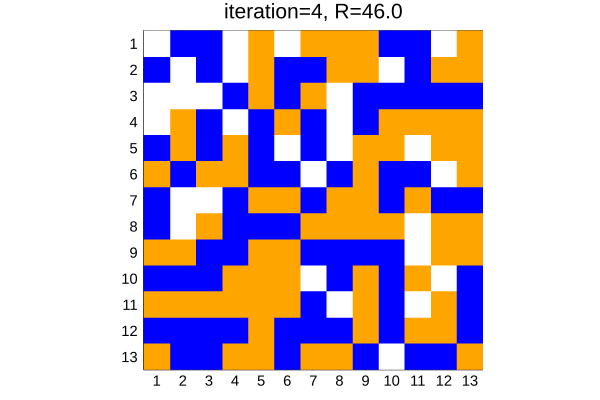

4


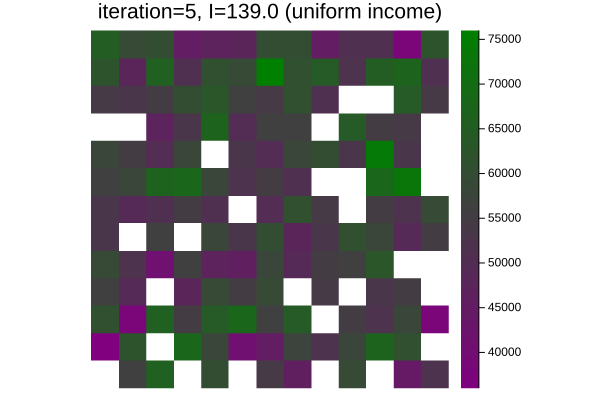

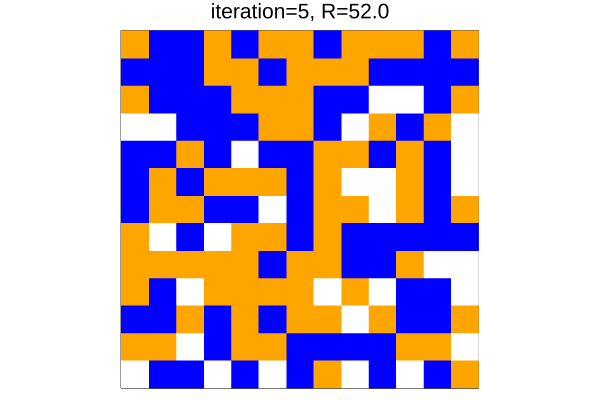

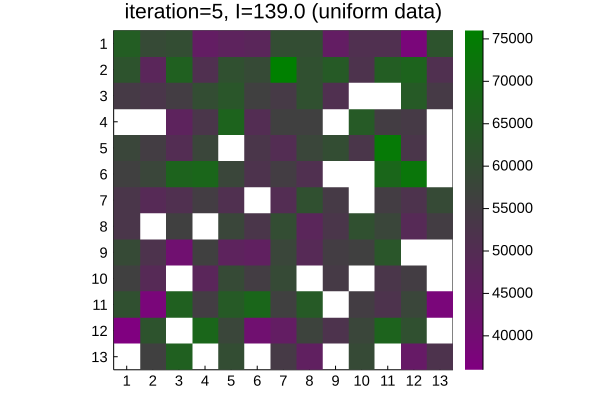

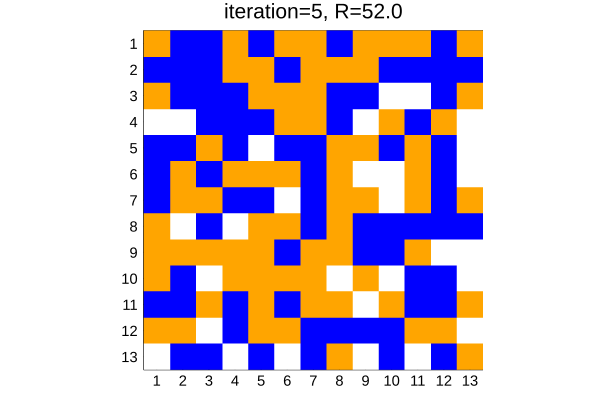

5


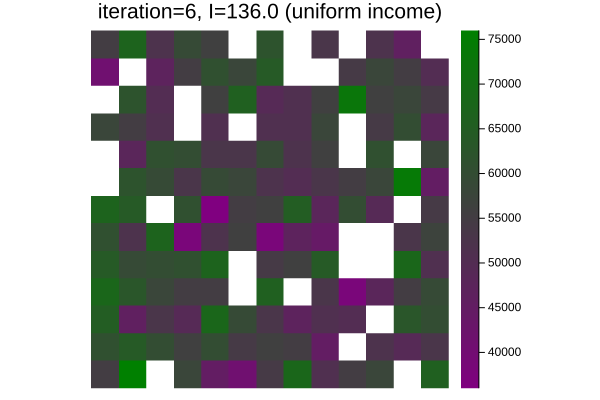

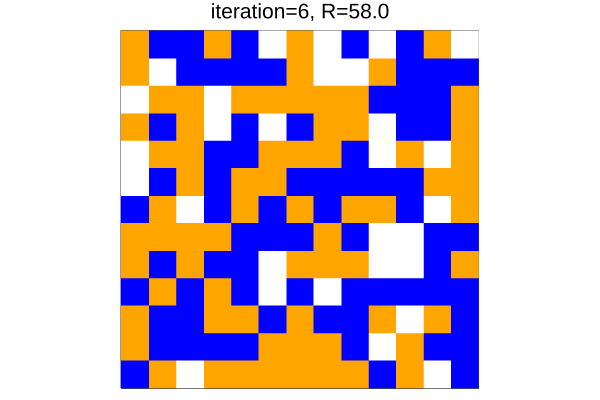

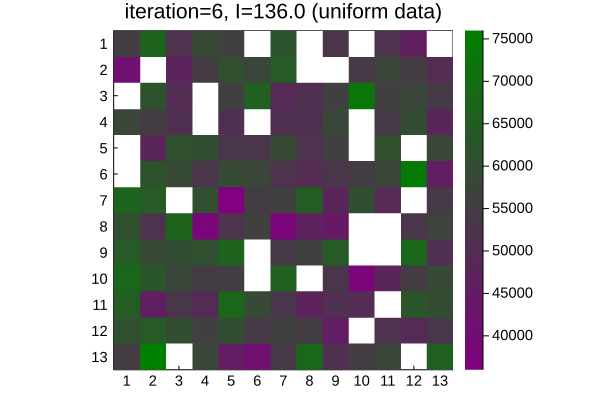

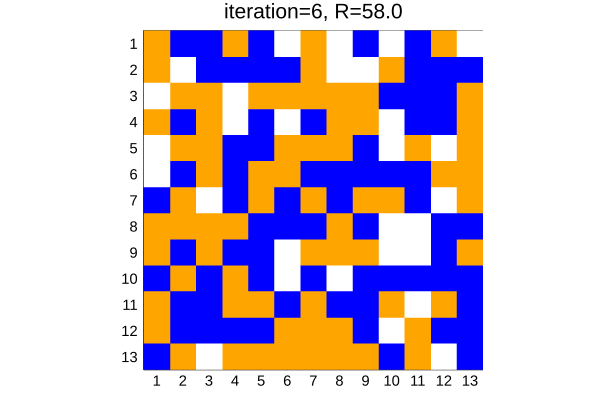

6


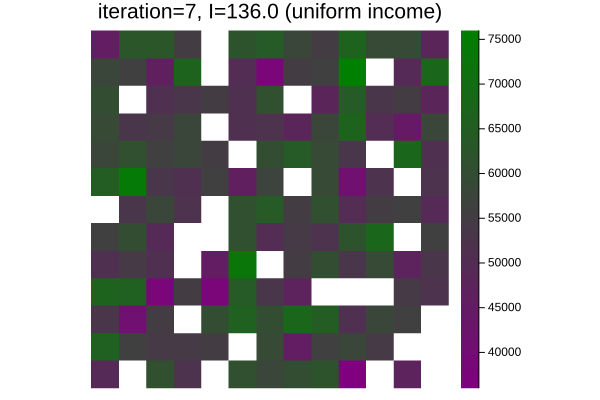

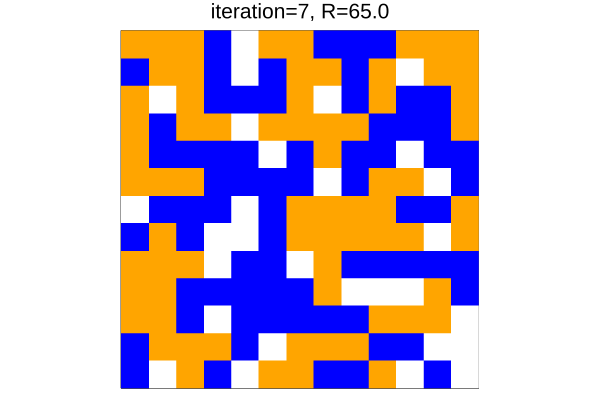

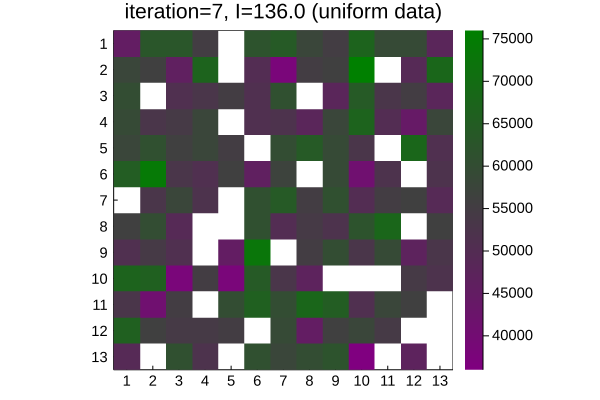

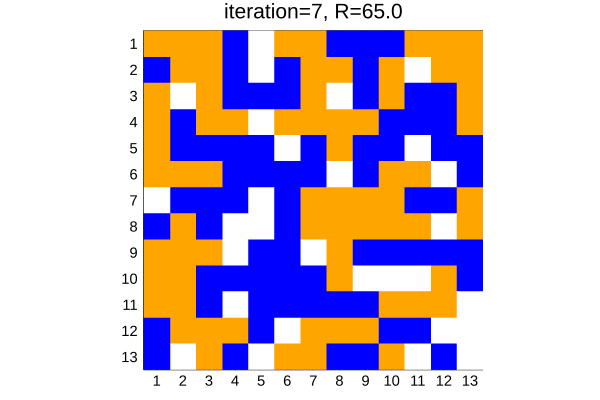

7


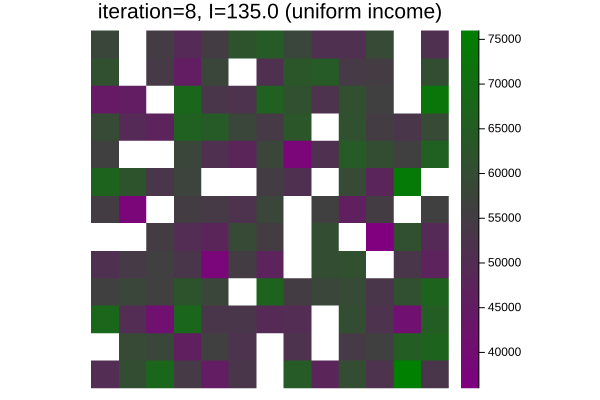

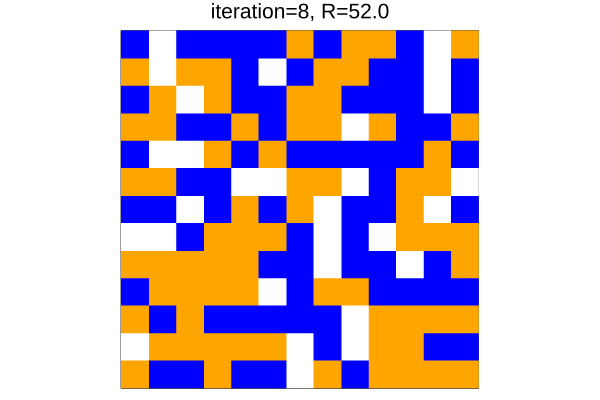

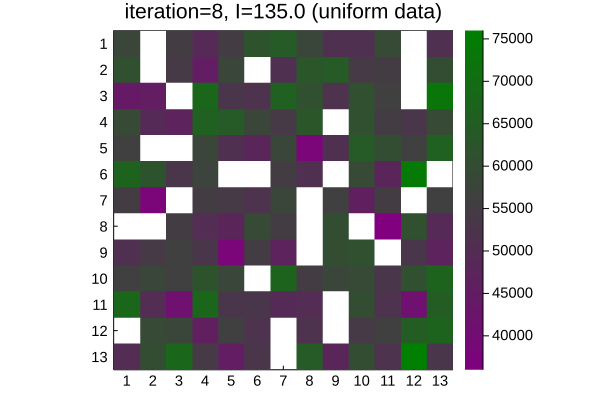

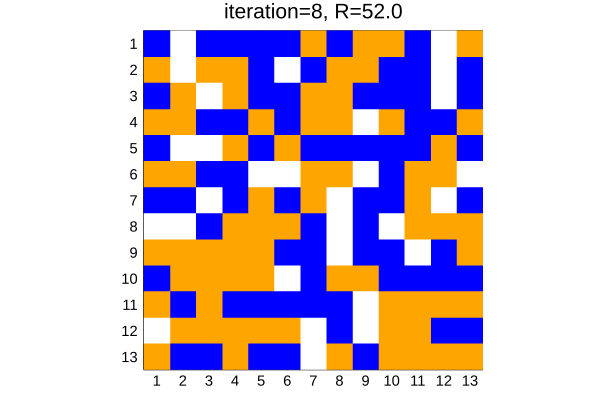

8


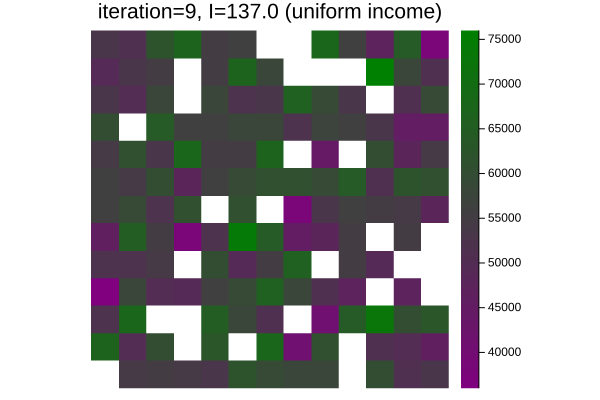

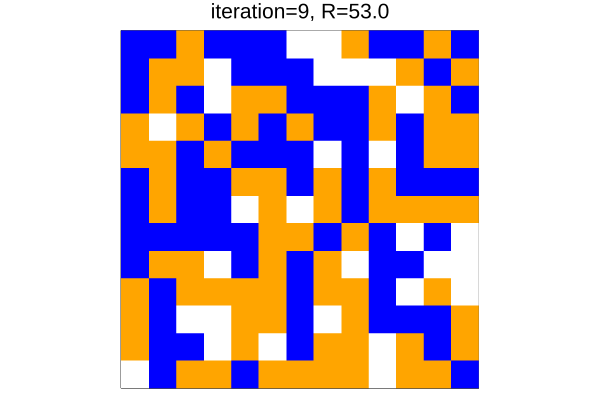

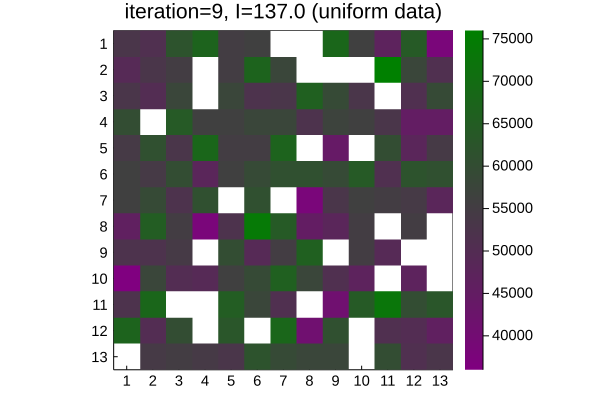

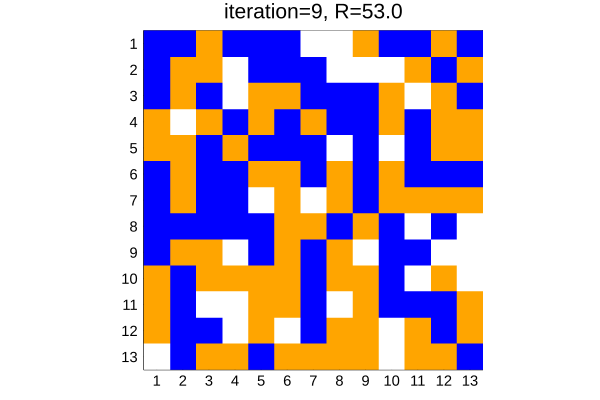

9


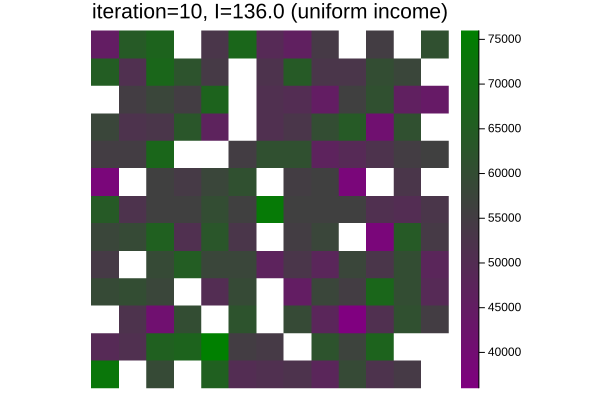

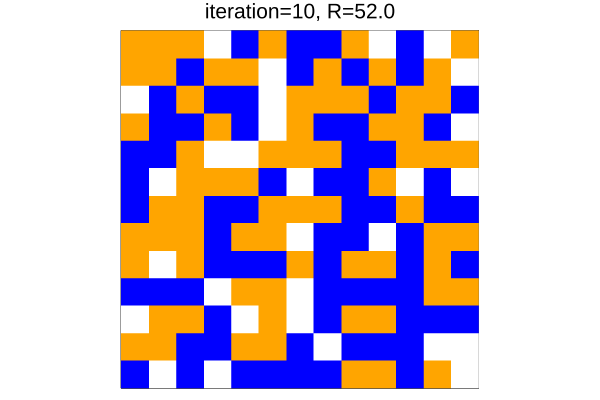

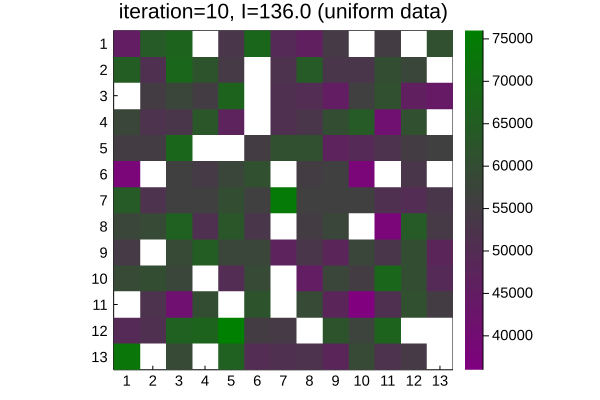

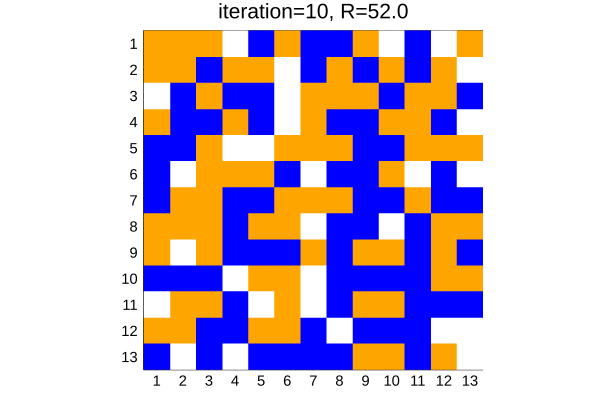

10


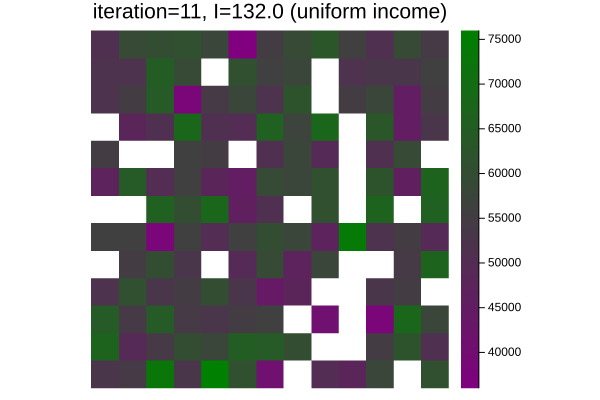

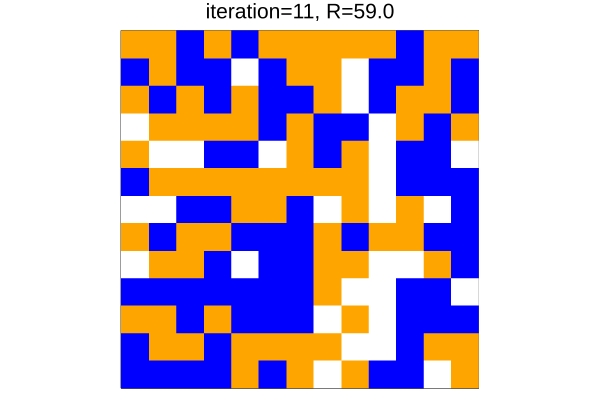

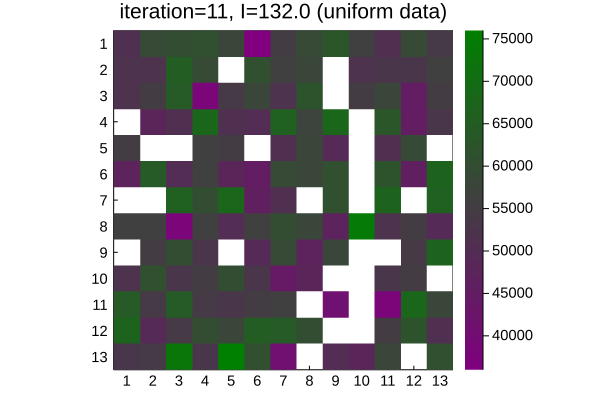

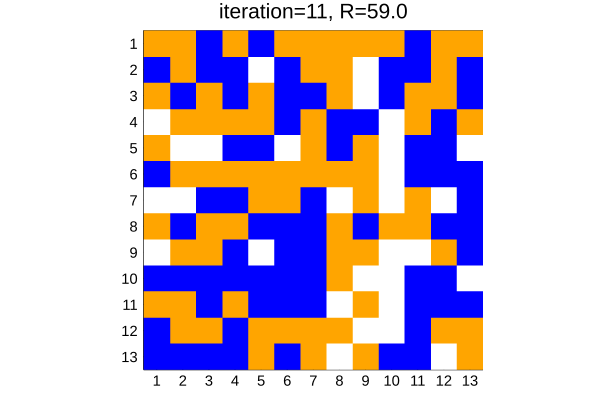

11


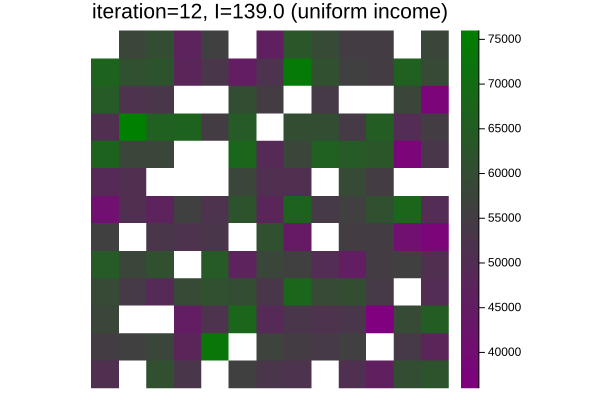

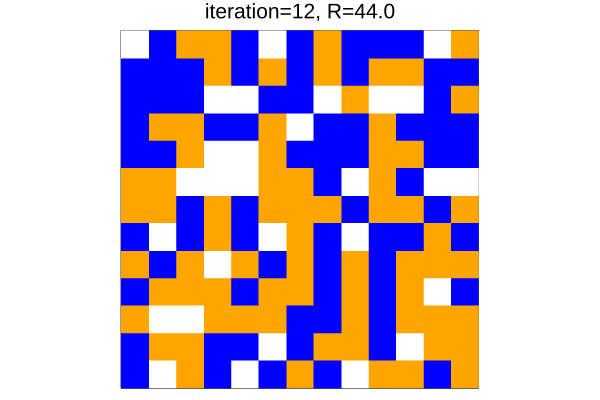

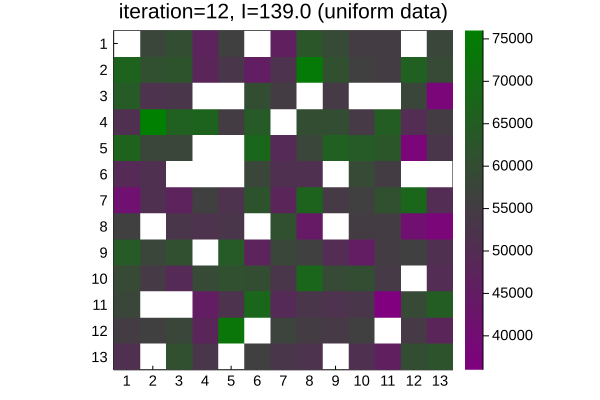

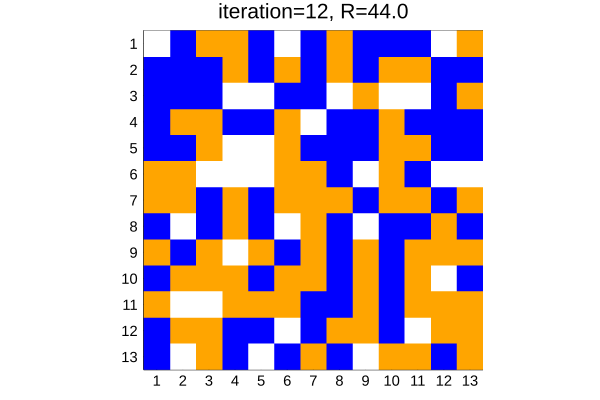

12


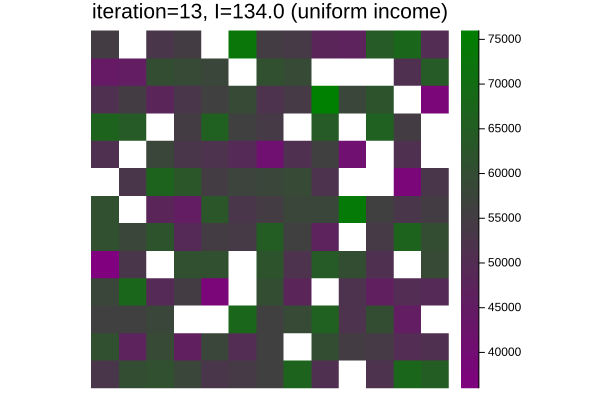

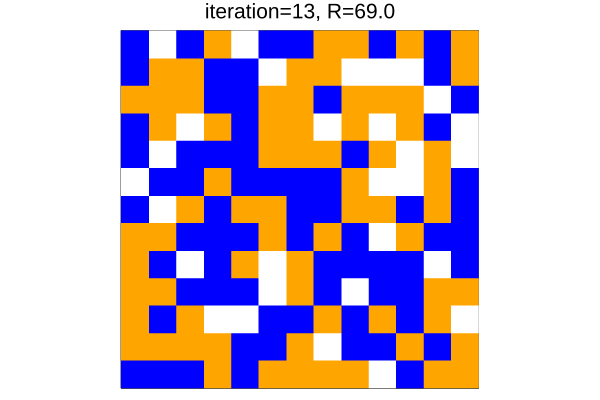

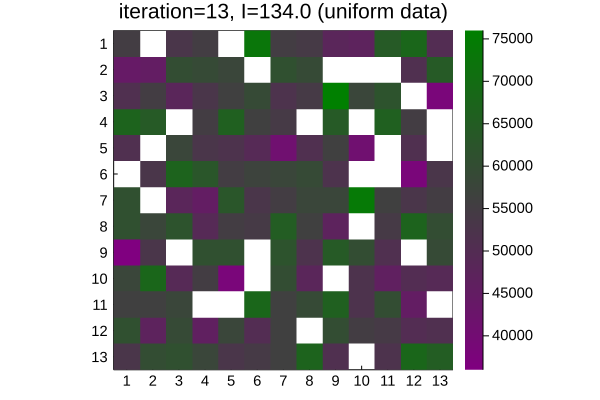

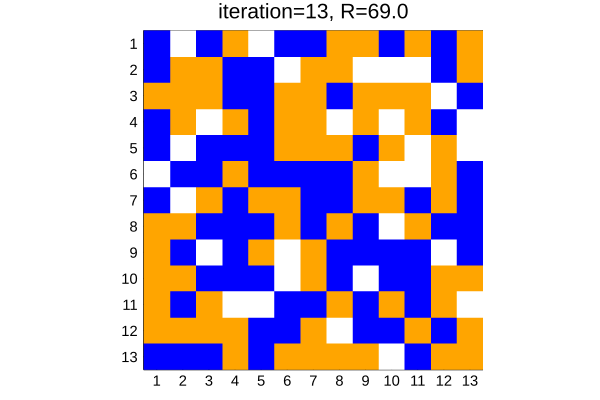

13


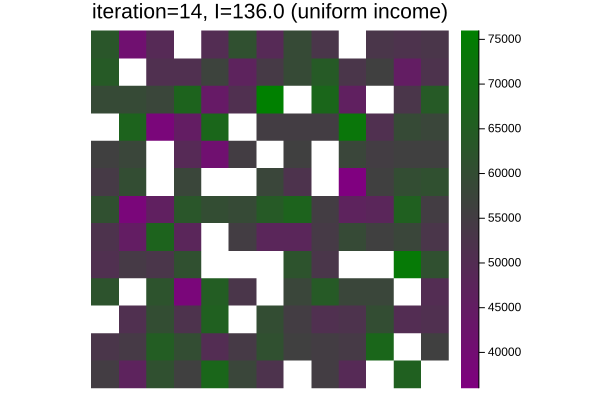

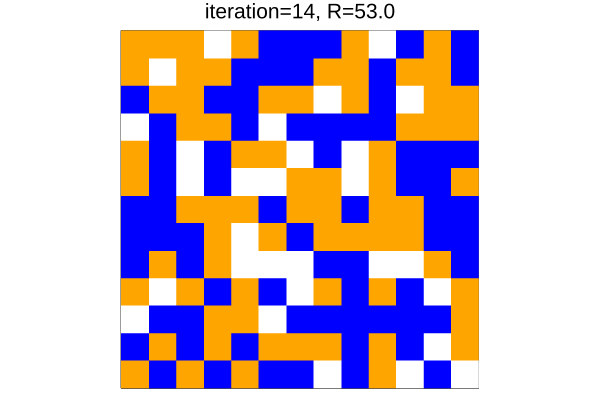

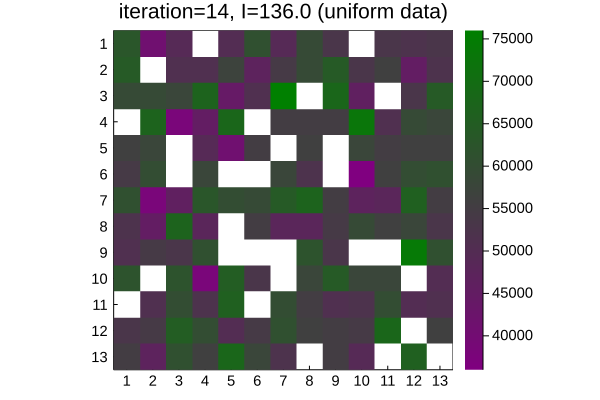

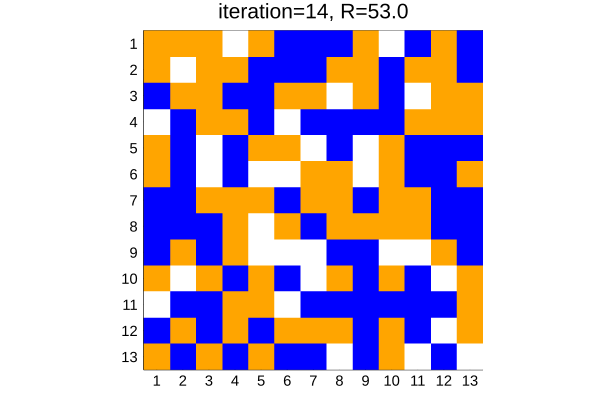

14


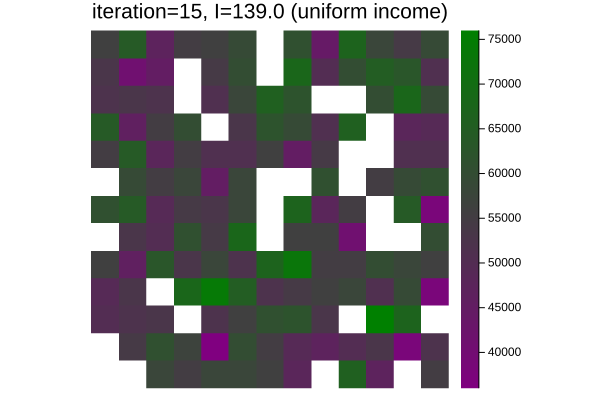

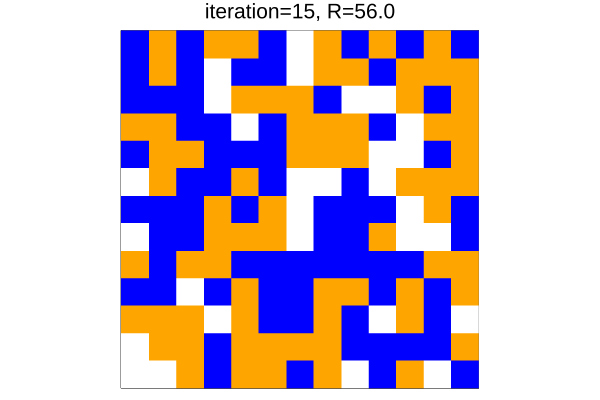

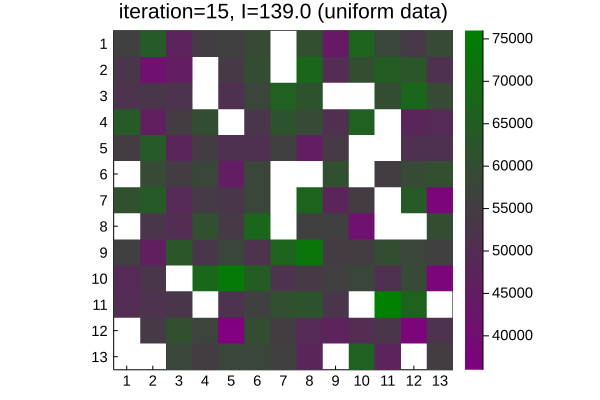

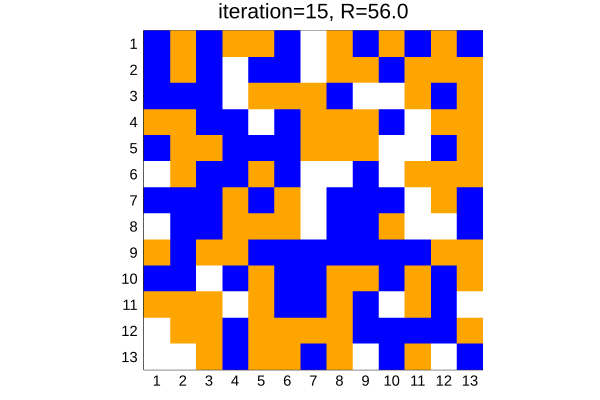

15


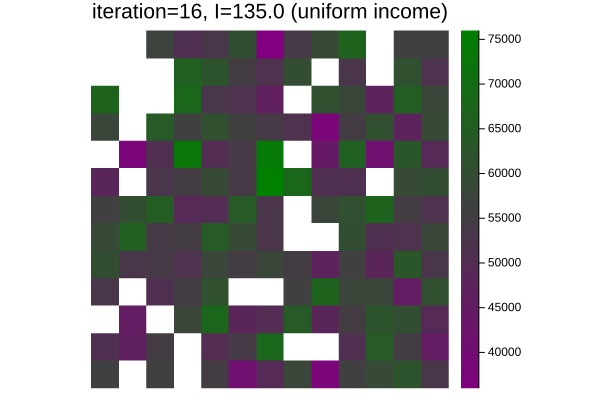

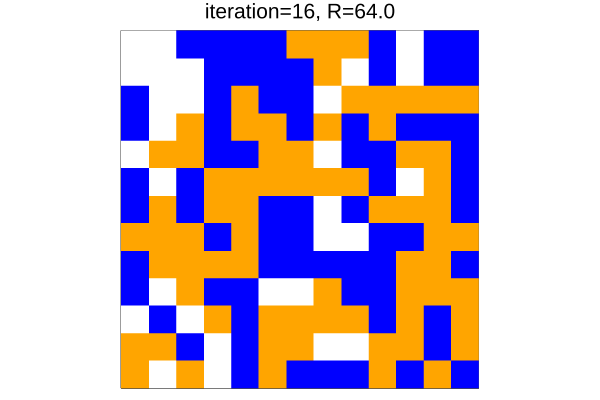

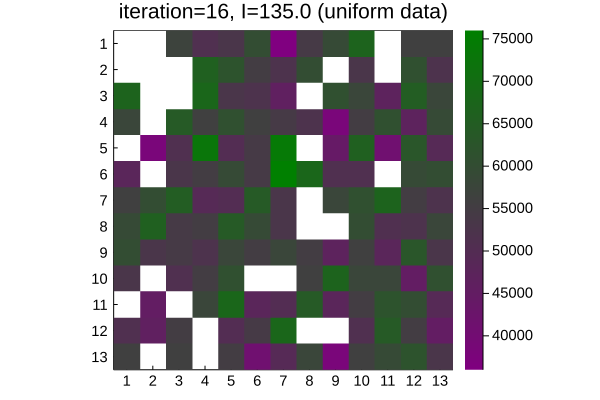

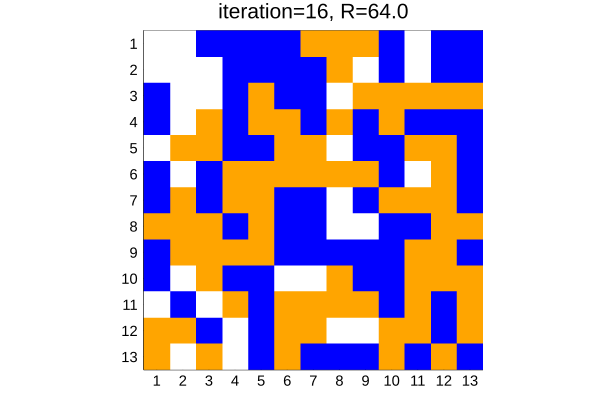

16


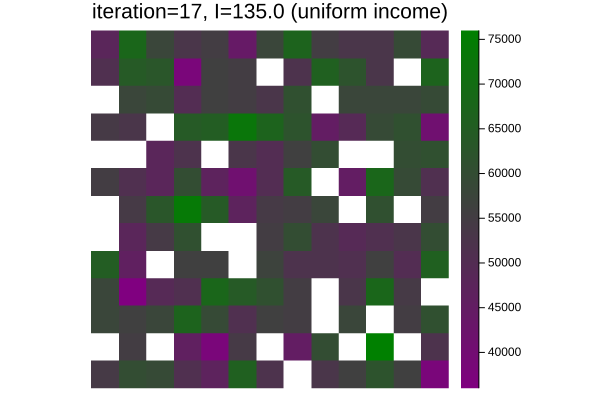

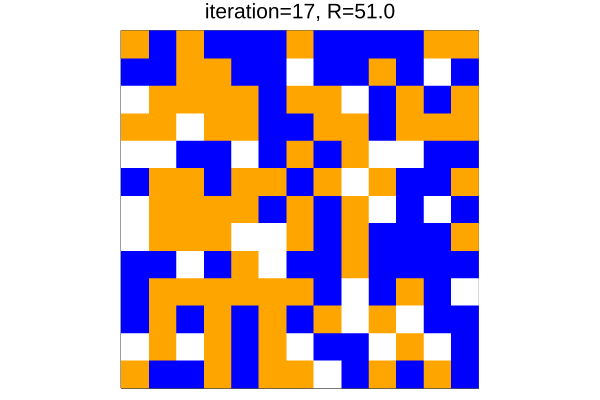

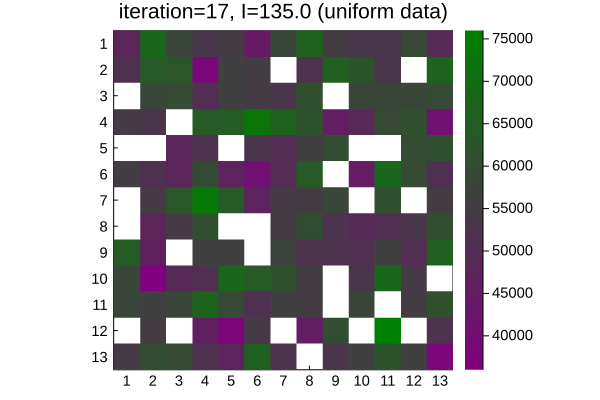

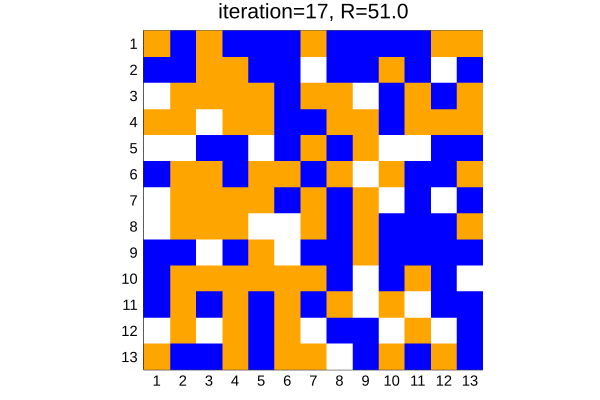

17


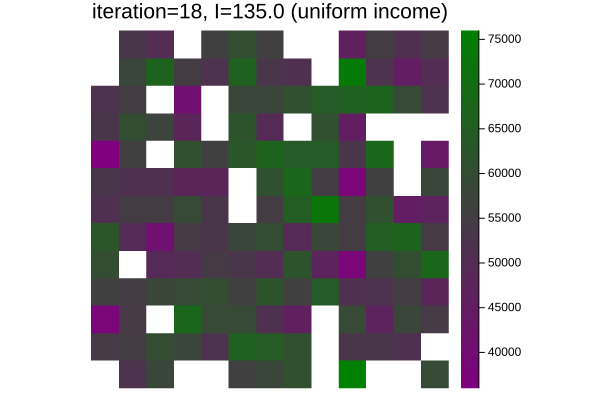

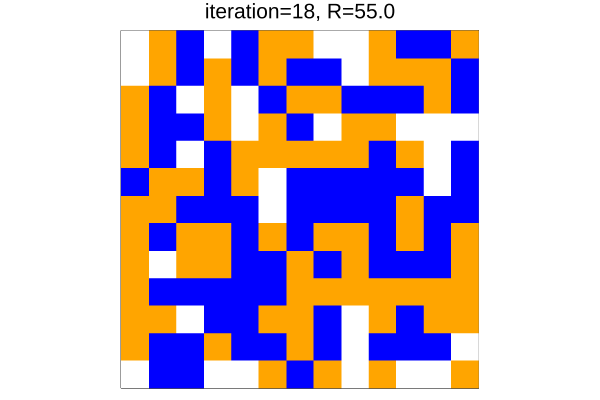

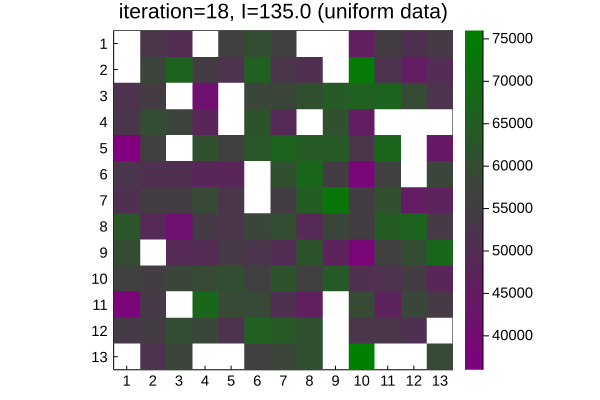

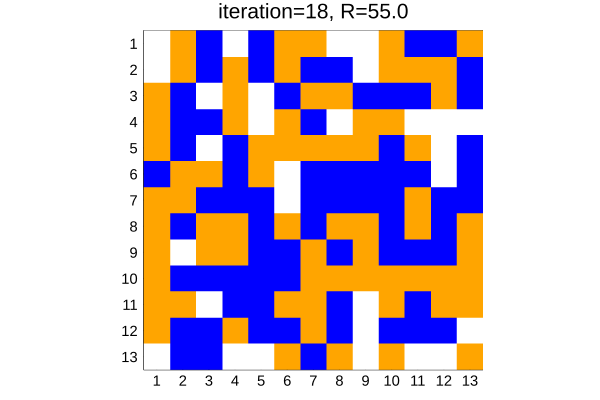

18


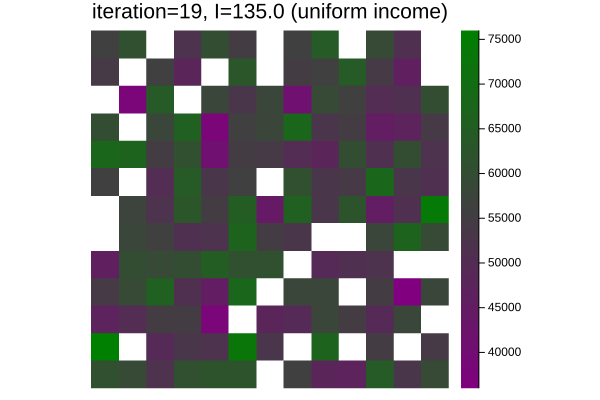

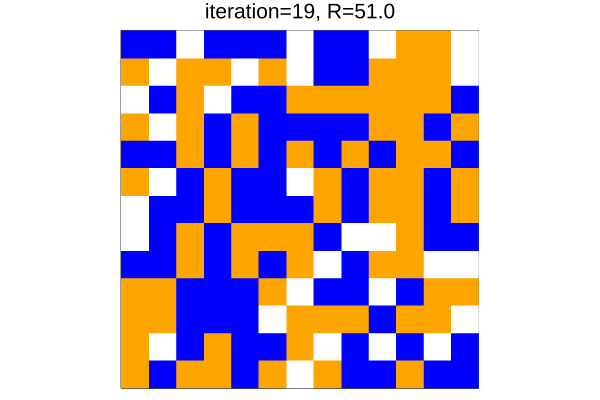

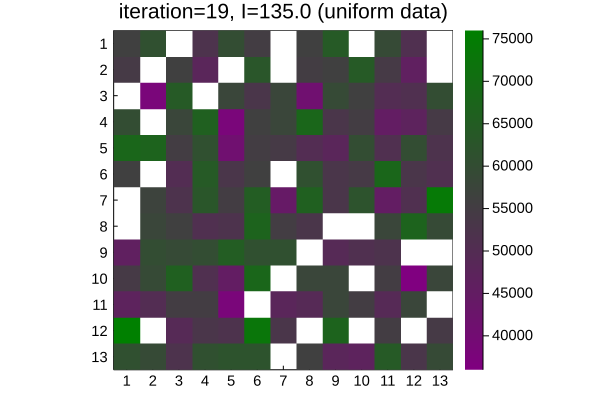

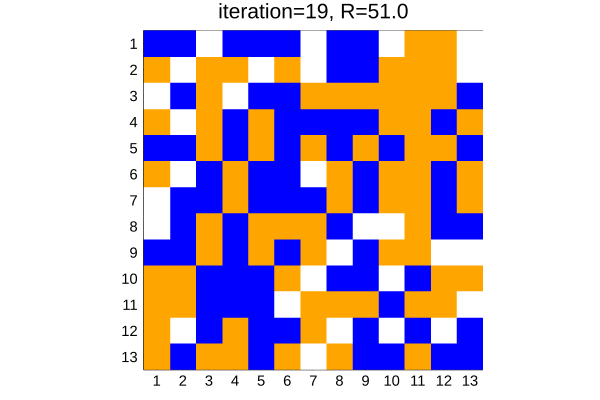

19


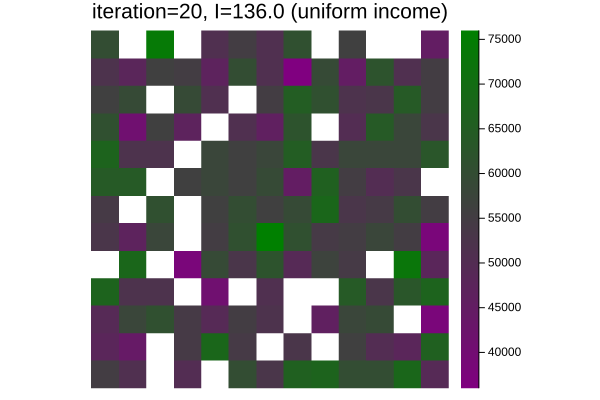

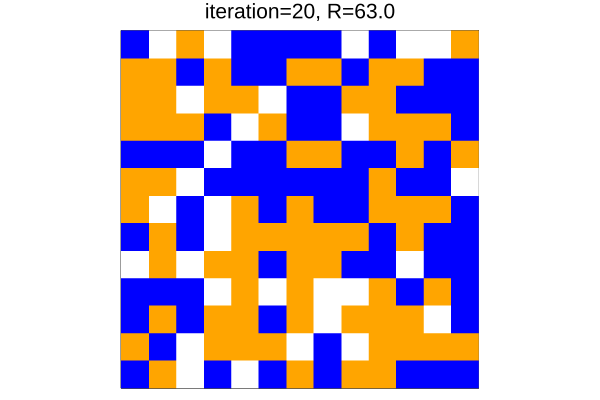

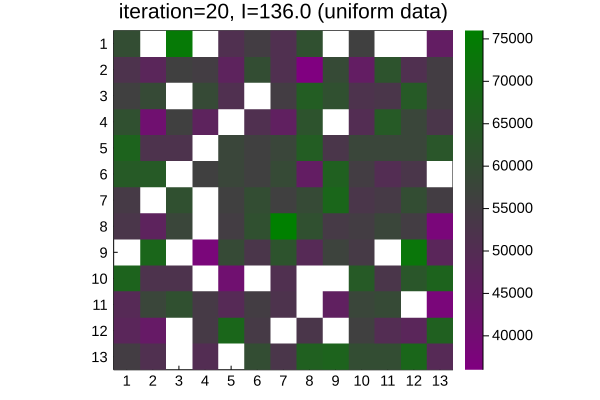

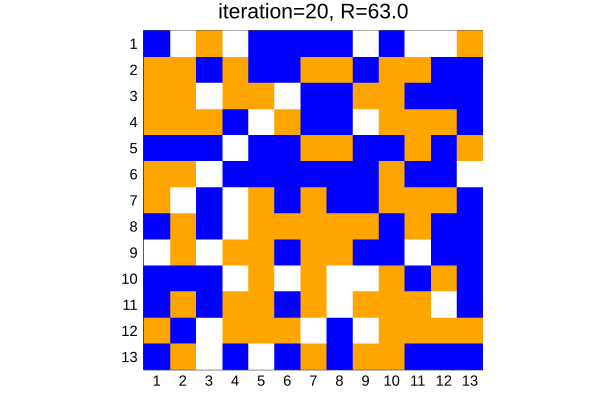

20


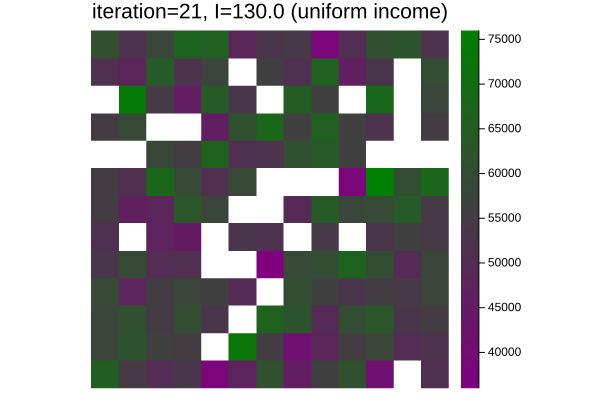

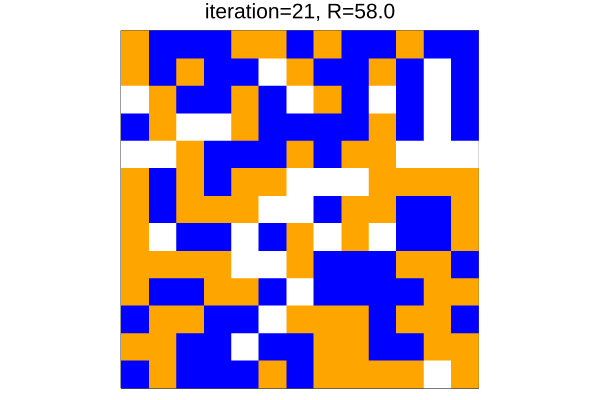

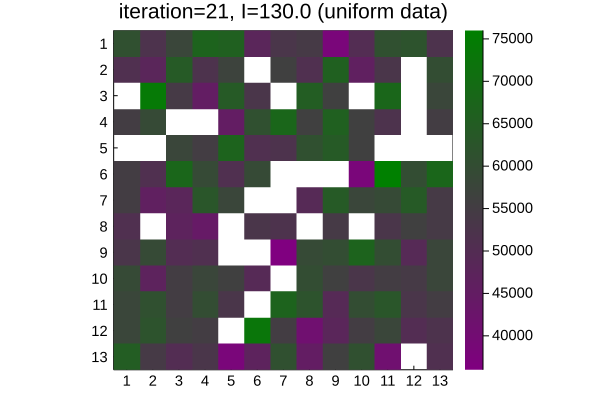

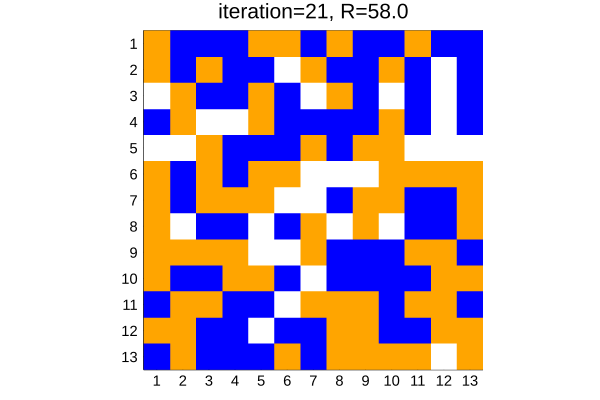

21


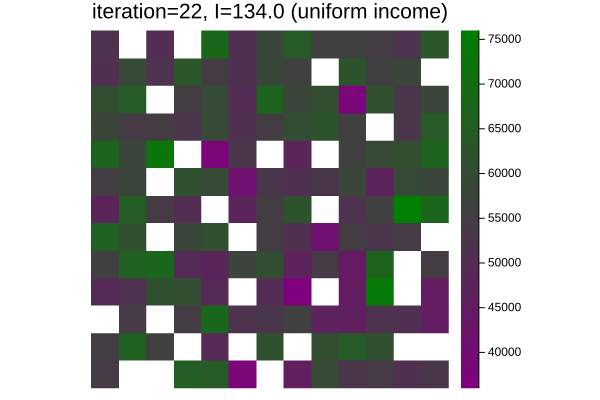

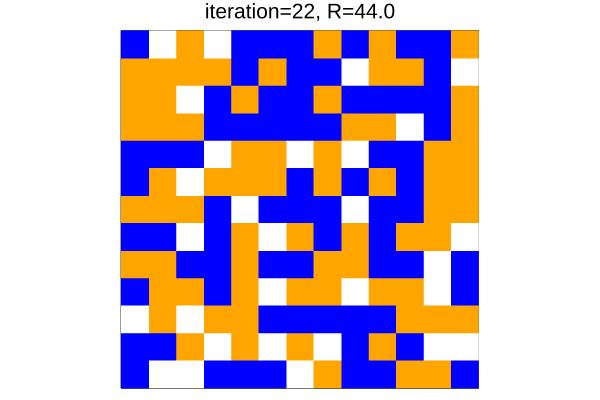

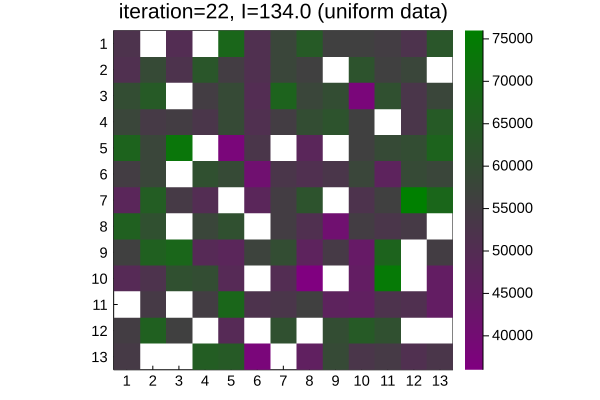

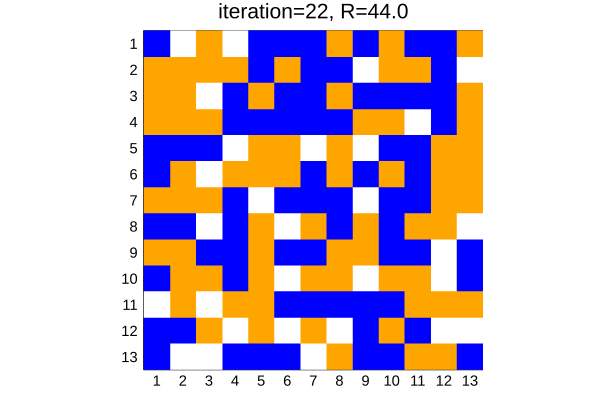

22


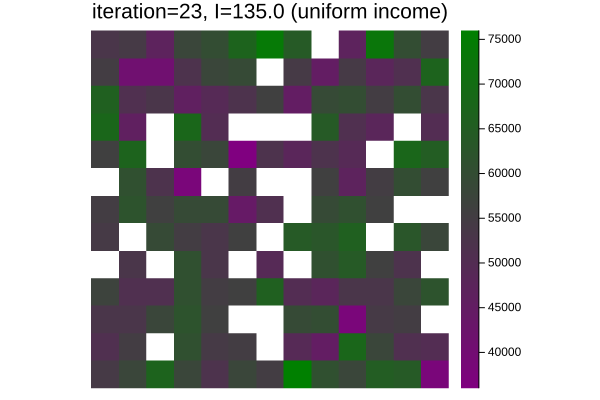

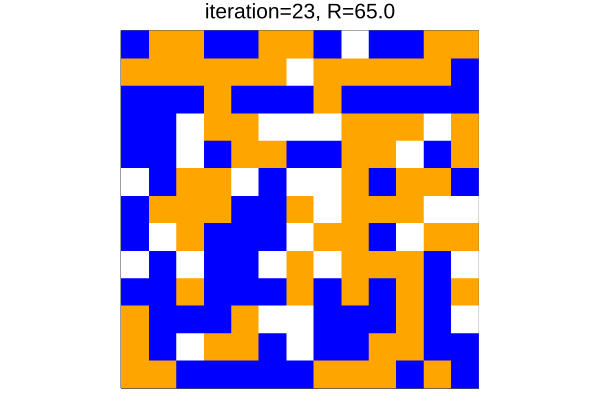

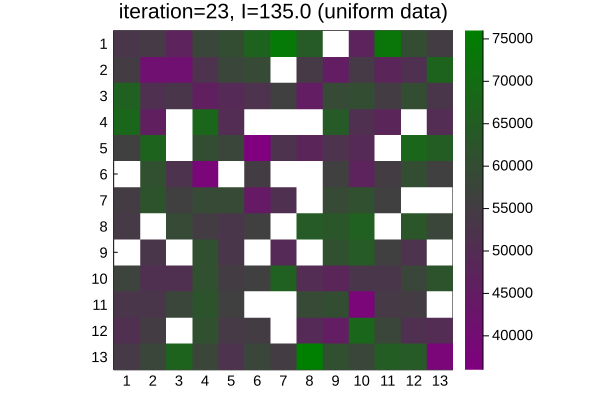

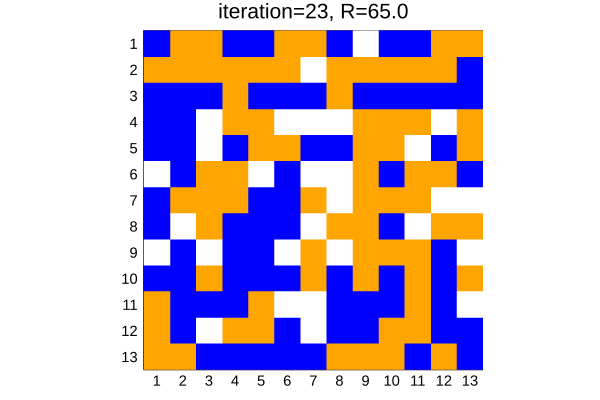

23


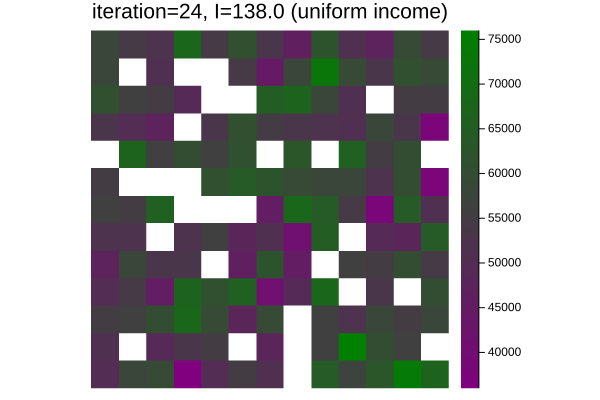

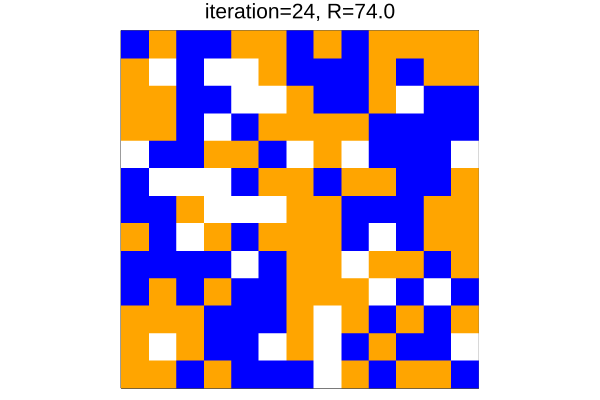

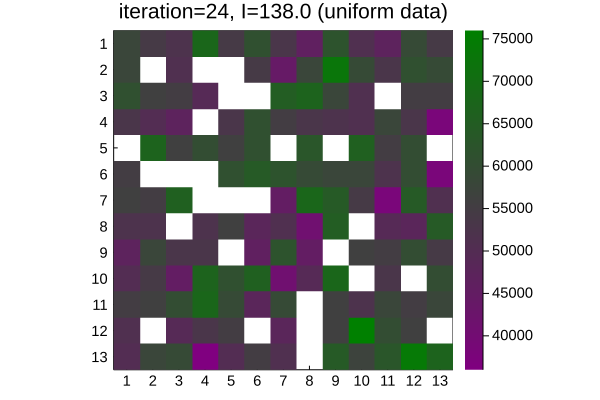

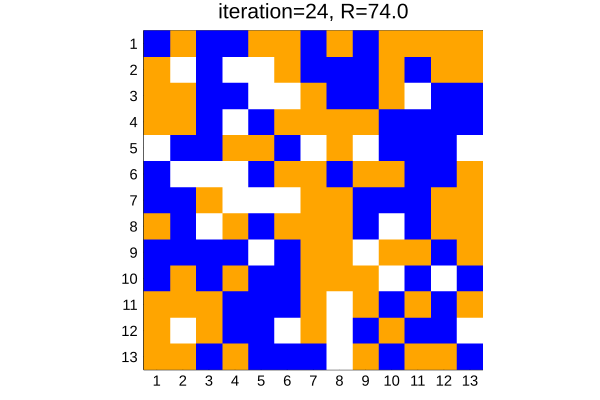

24


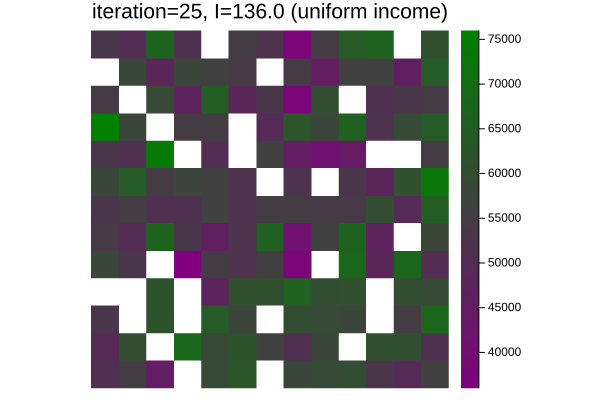

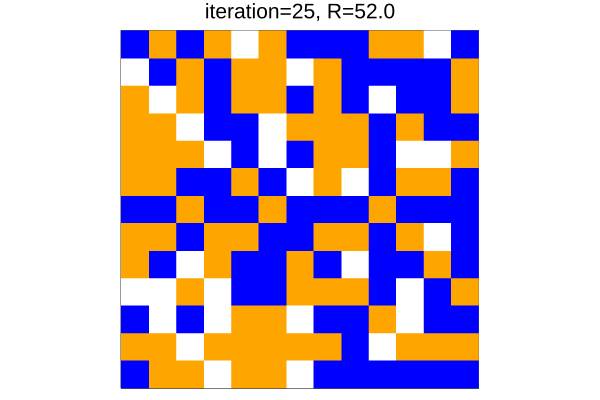

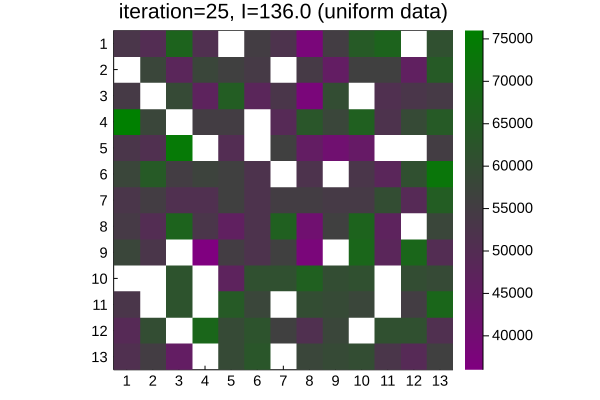

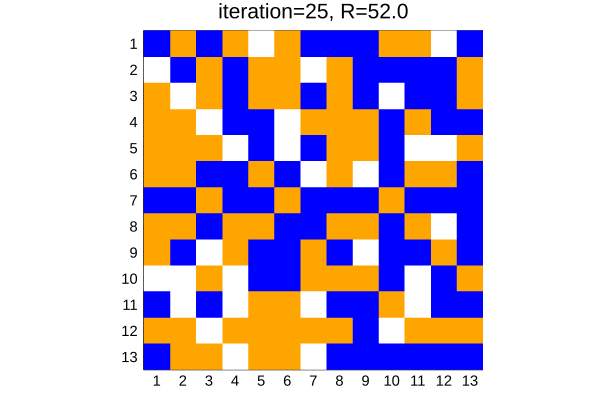

25


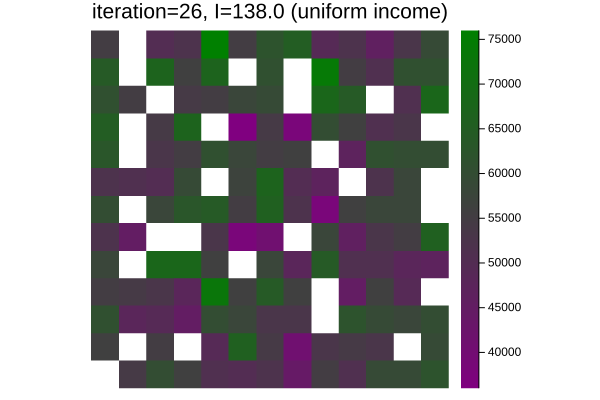

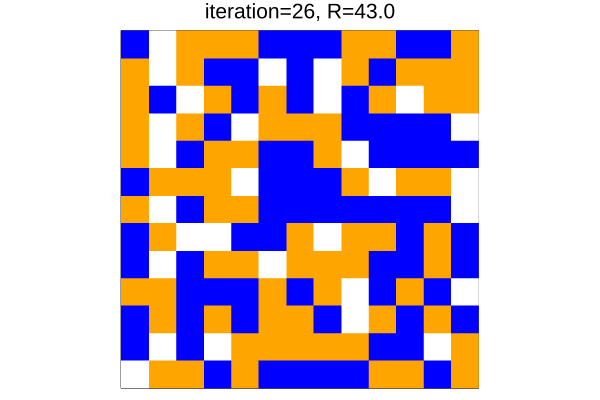

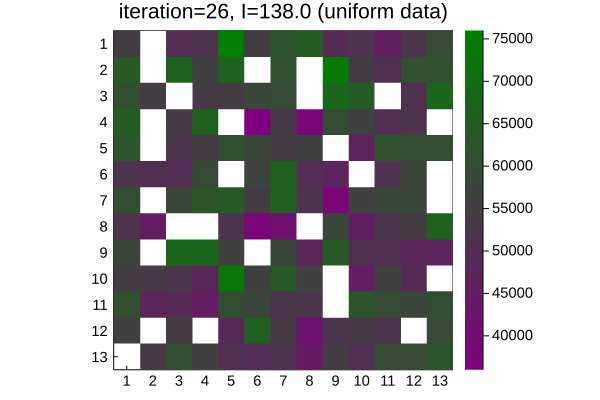

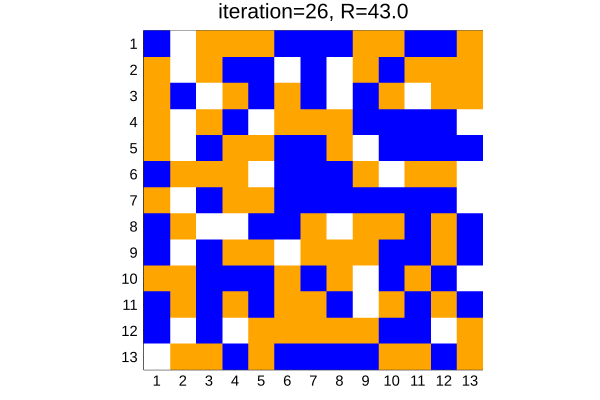

26


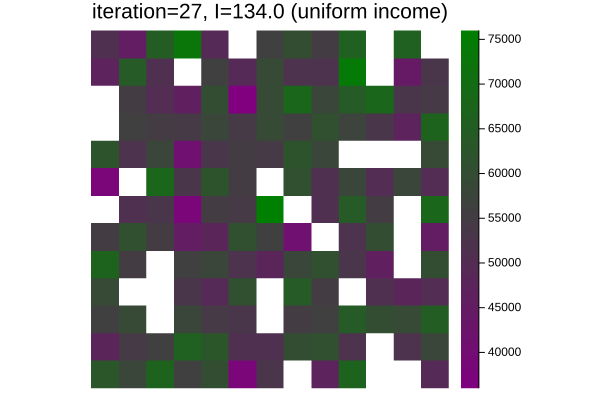

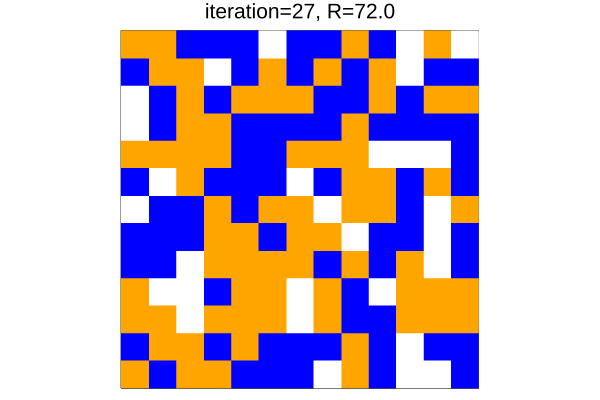

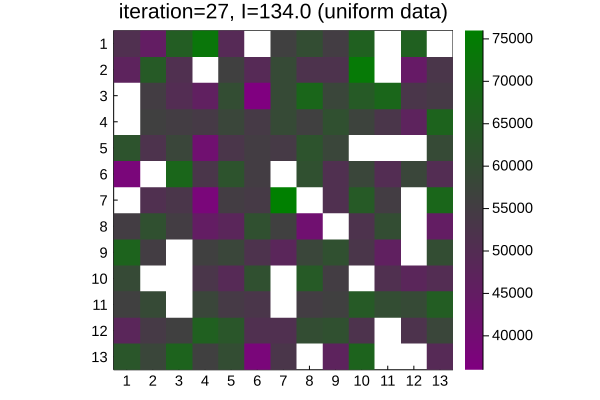

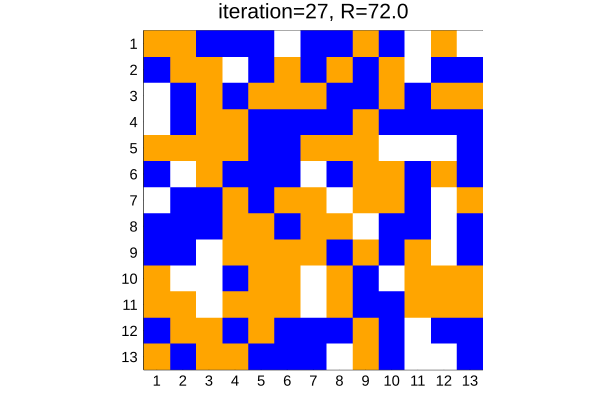

27


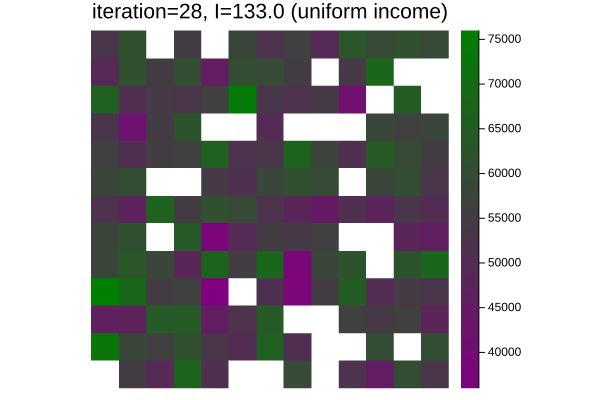

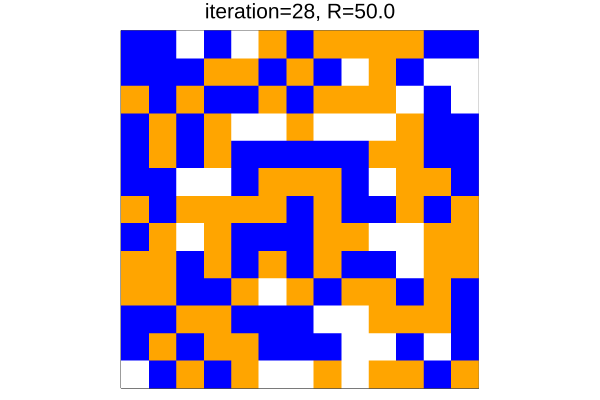

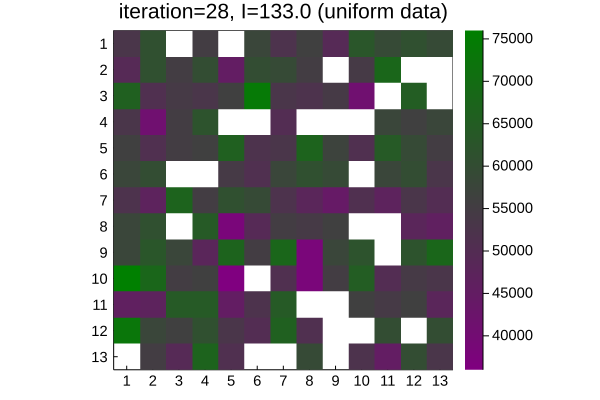

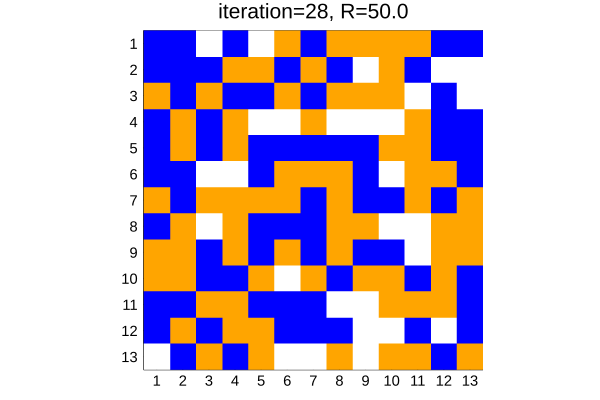

28


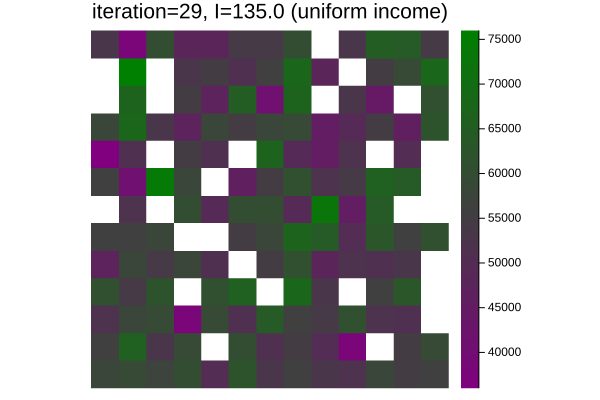

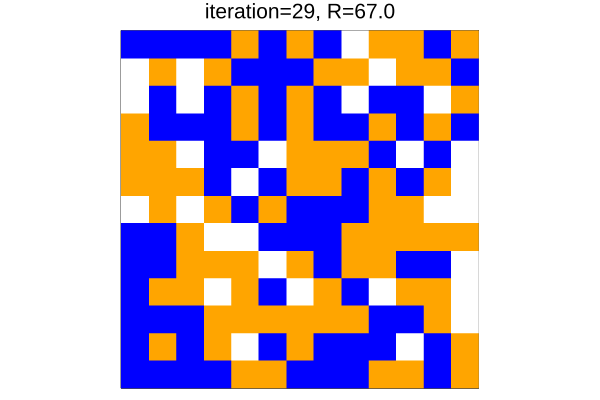

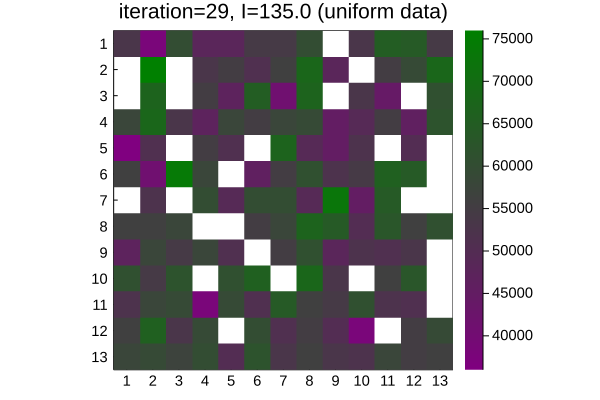

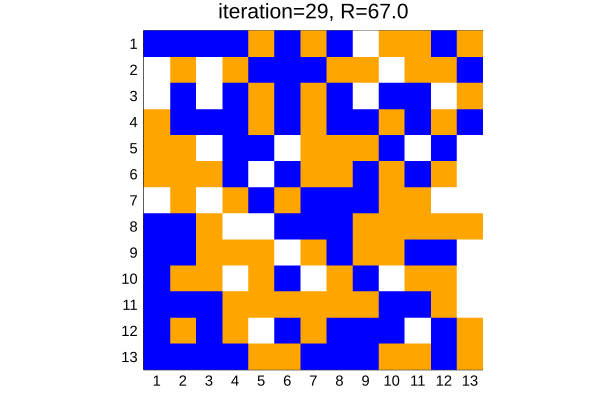

29


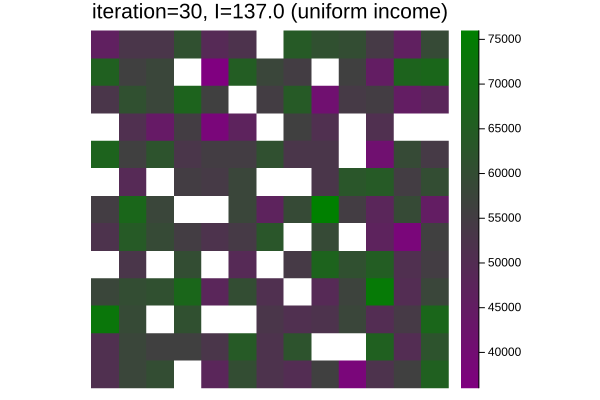

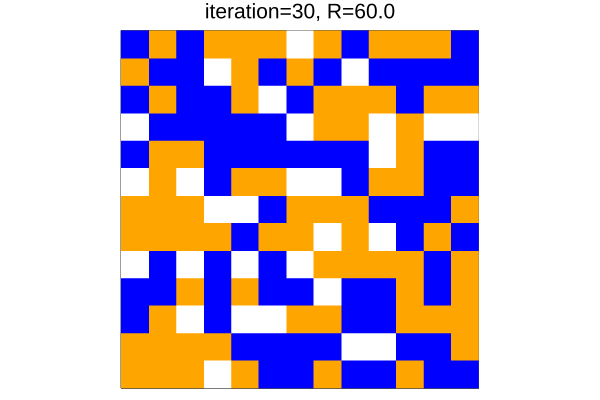

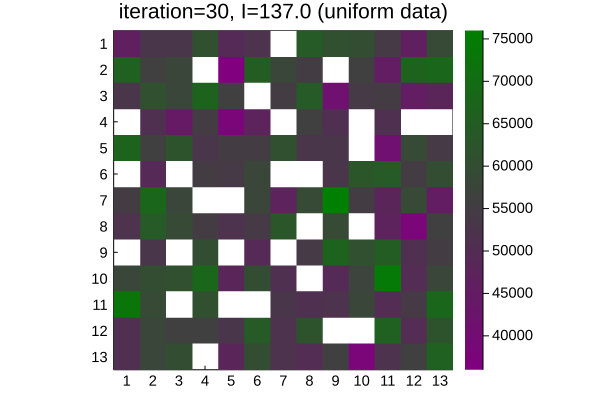

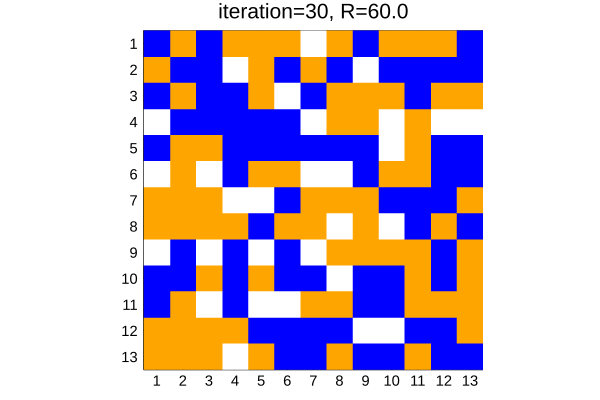

30


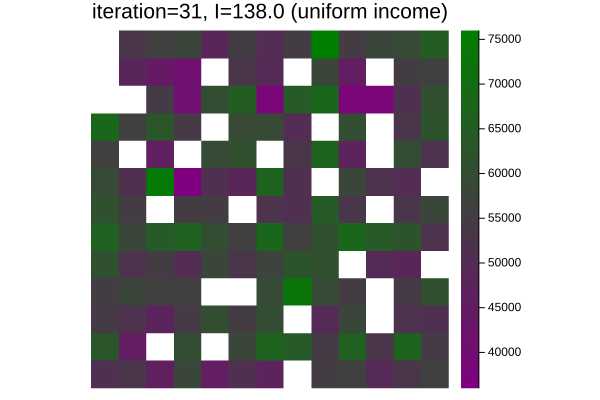

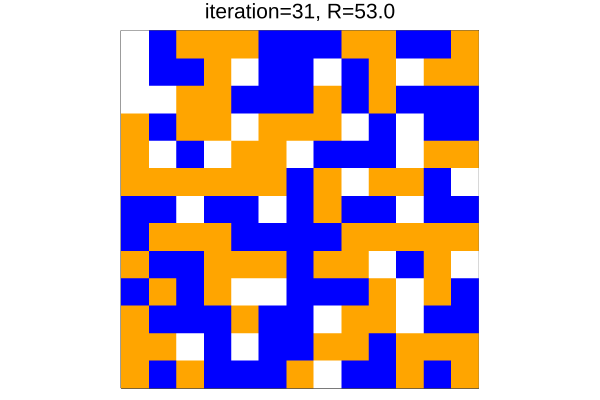

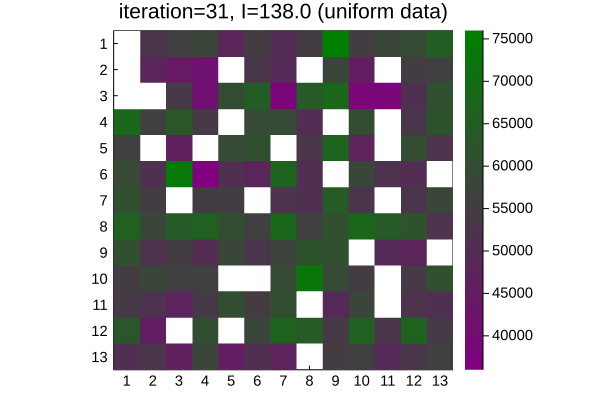

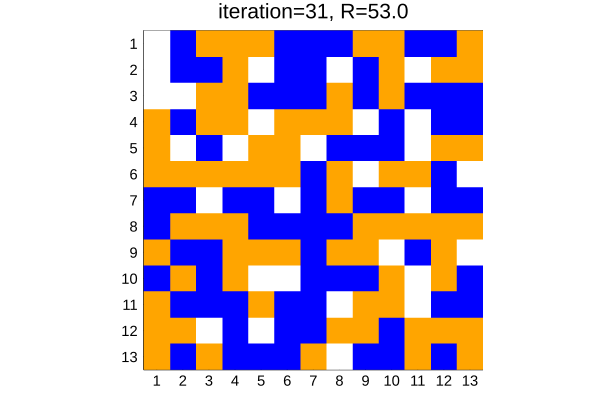

31


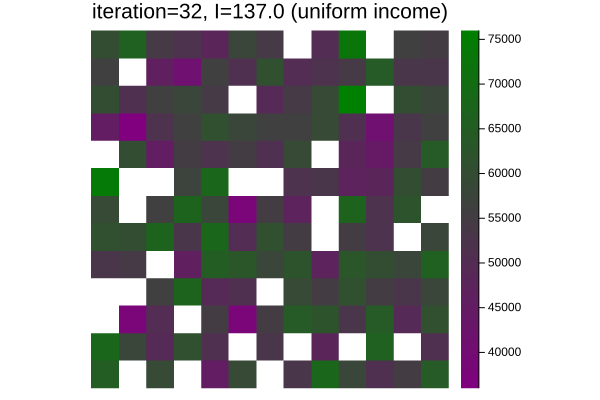

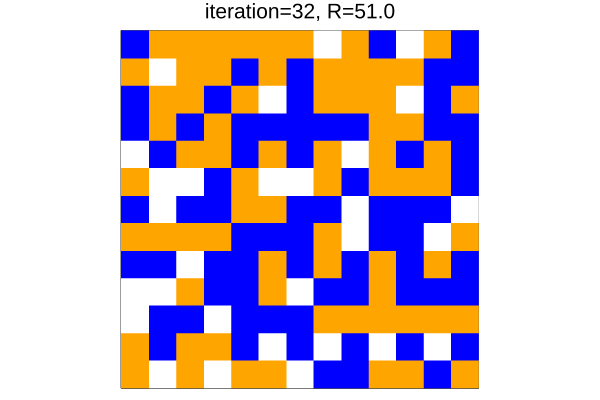

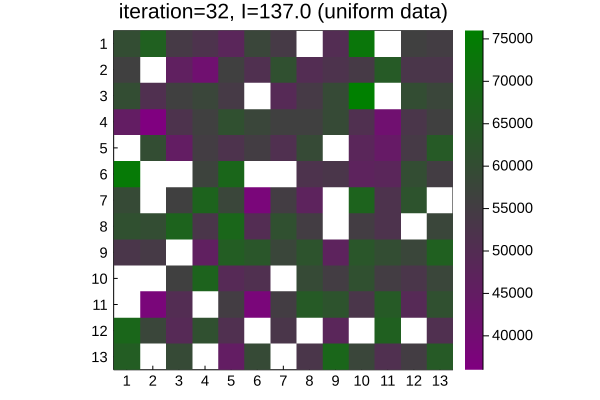

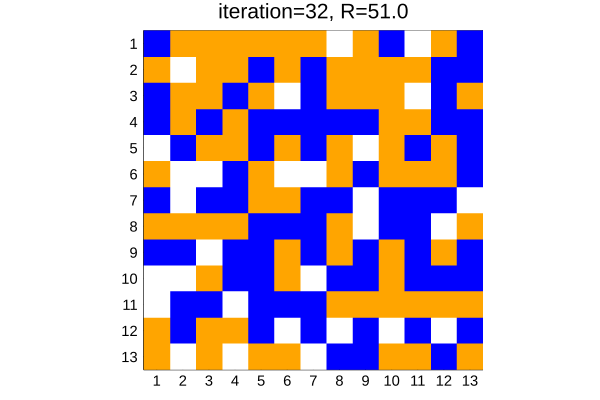

32


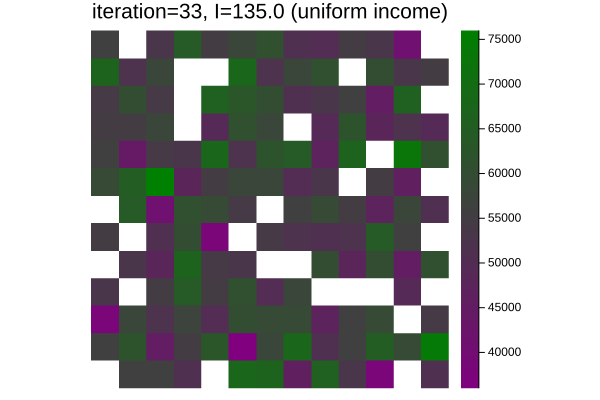

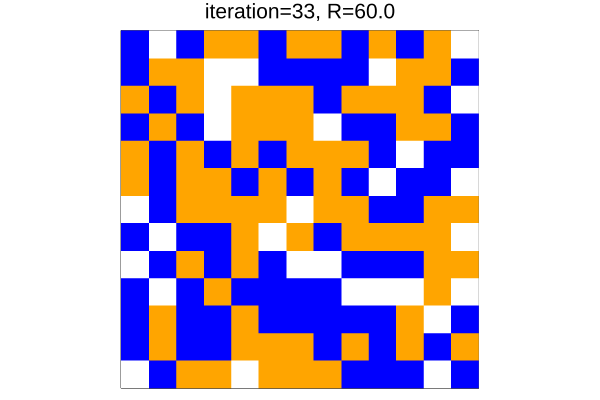

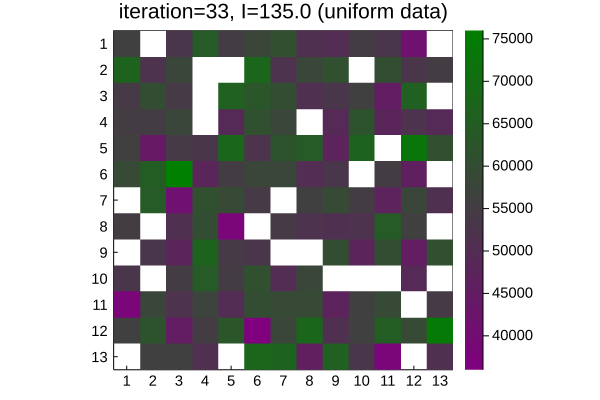

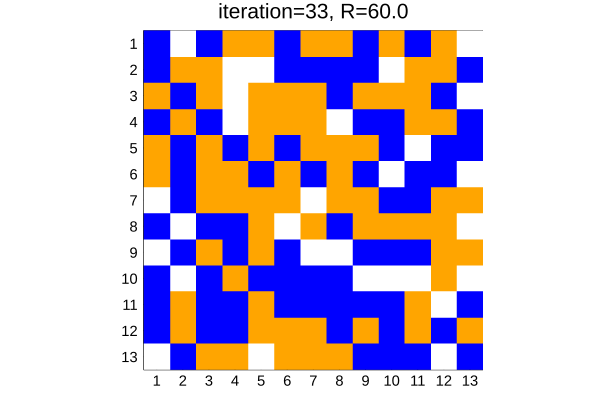

33


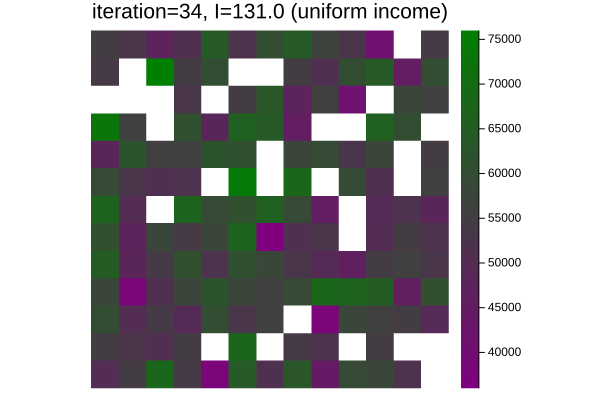

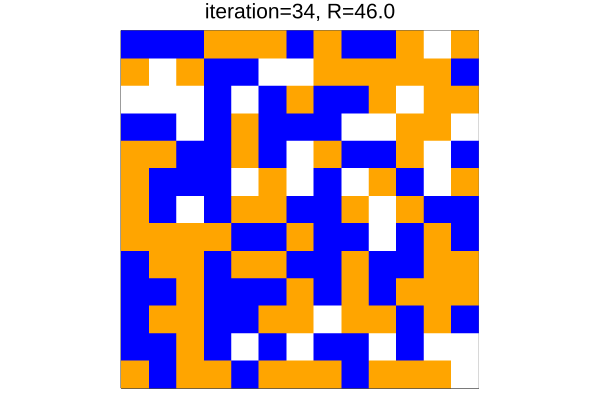

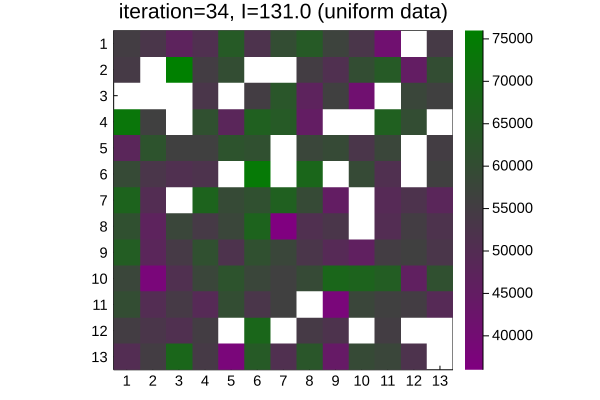

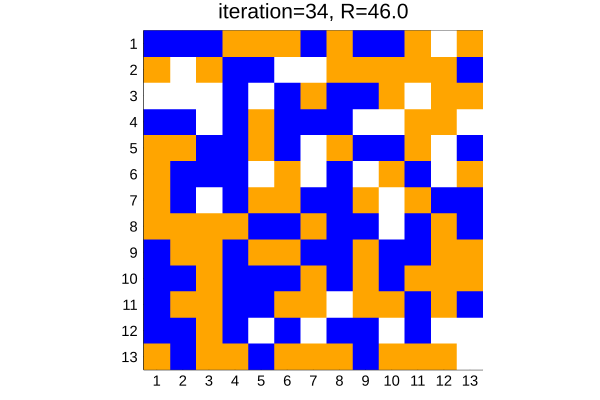

34


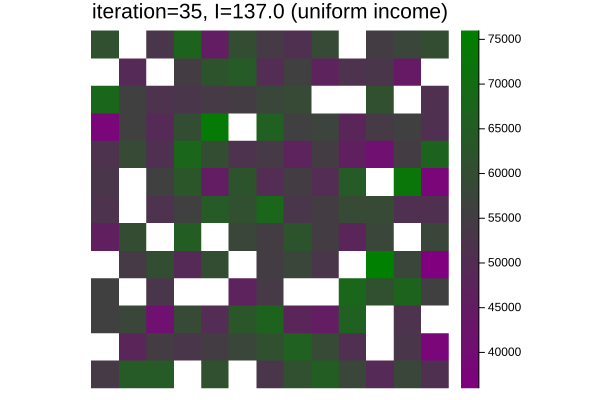

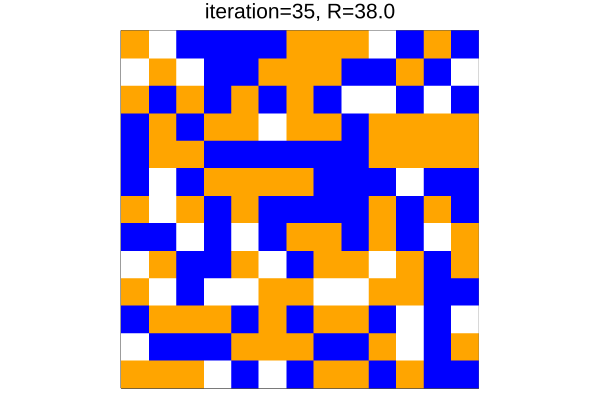

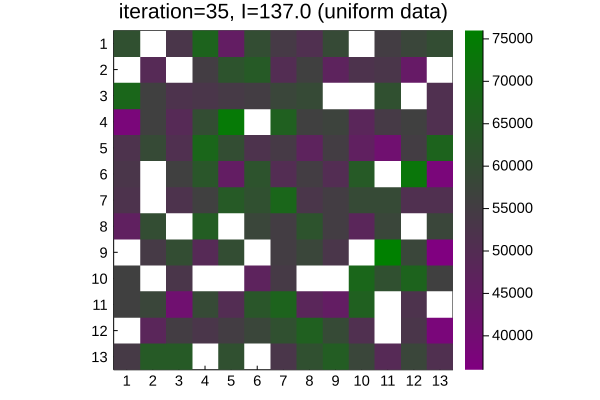

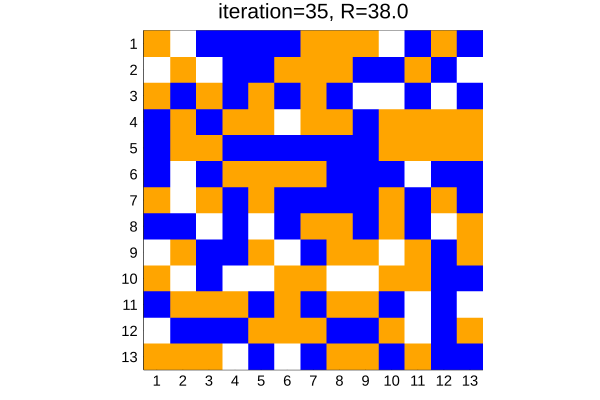

35


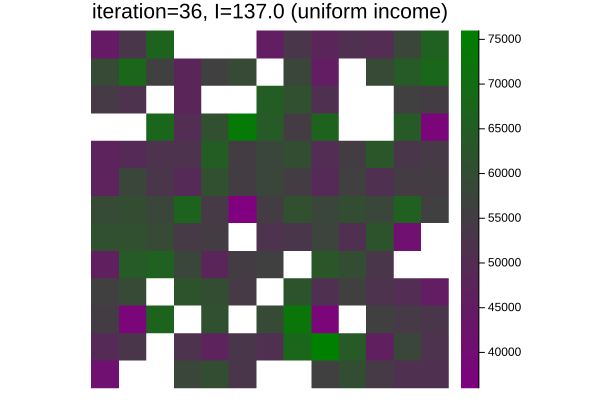

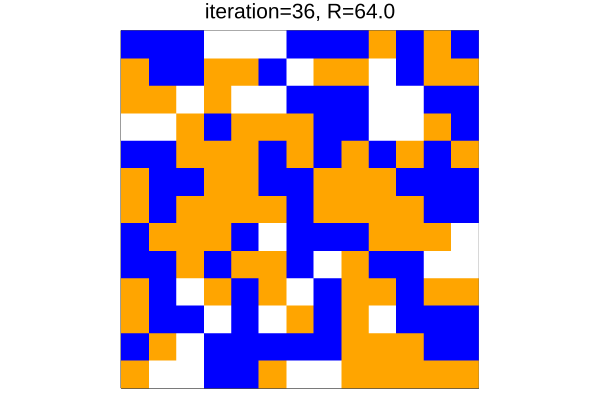

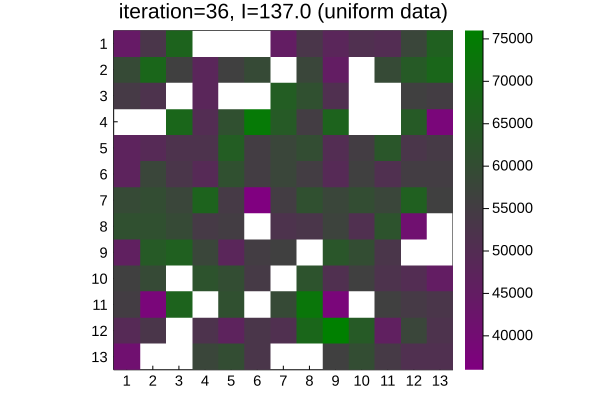

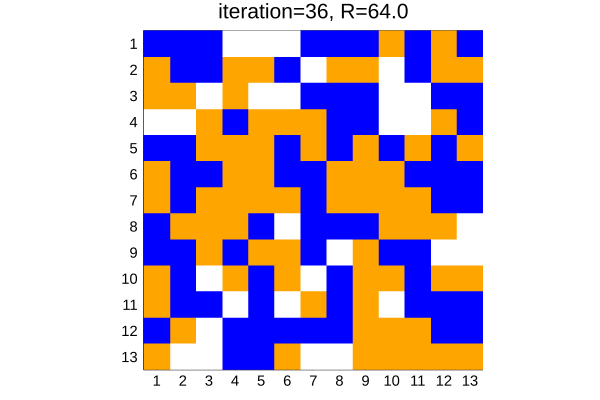

36


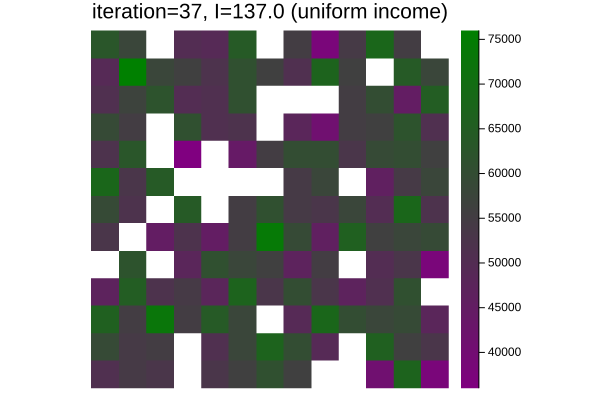

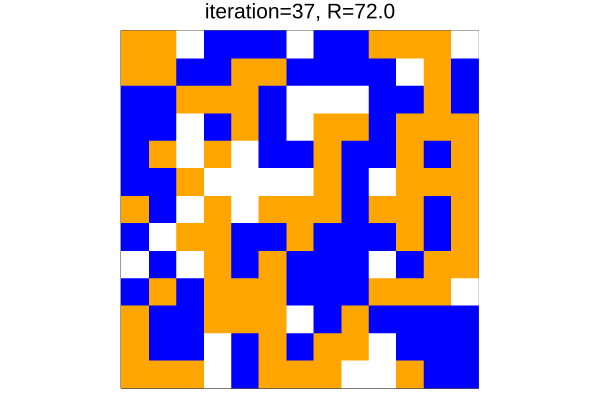

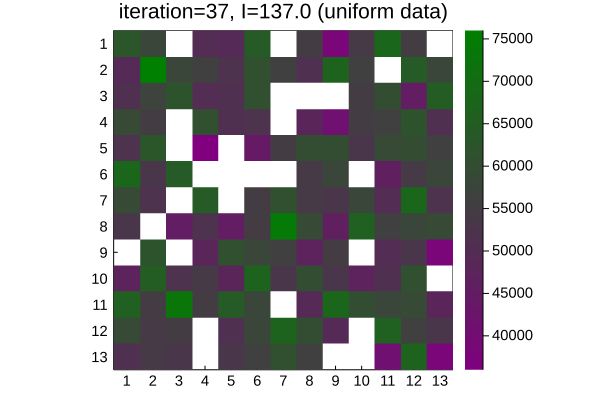

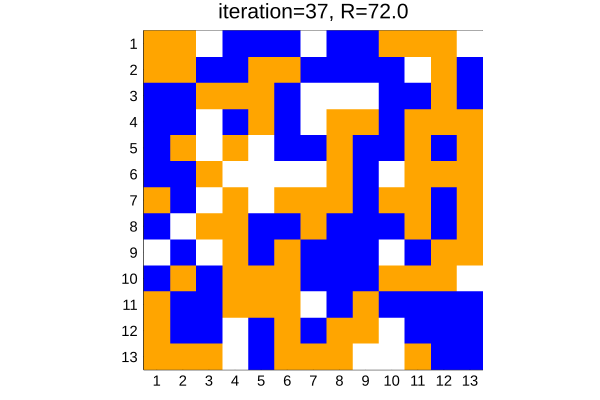

37


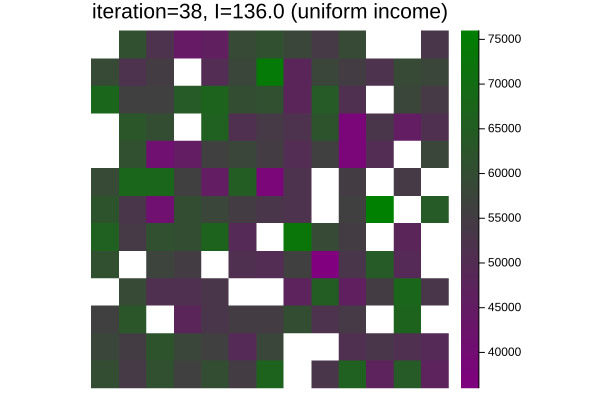

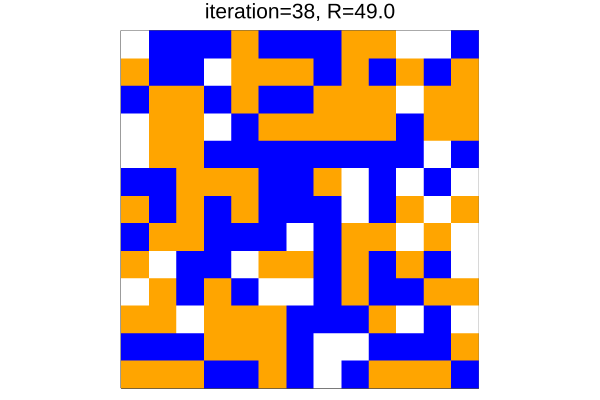

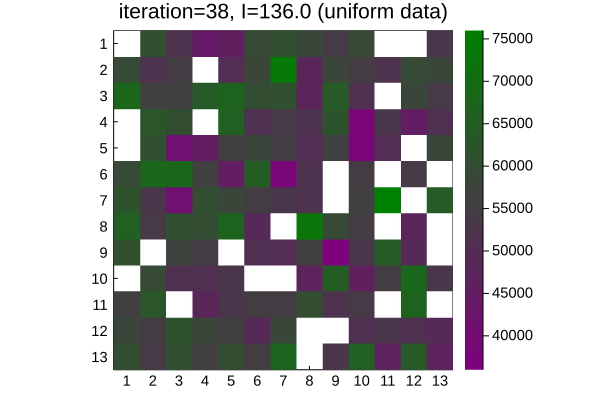

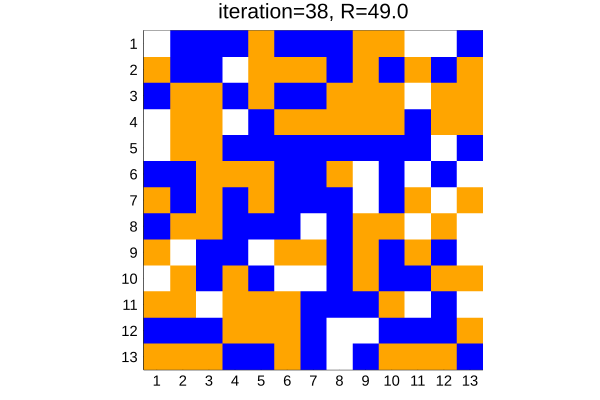

38


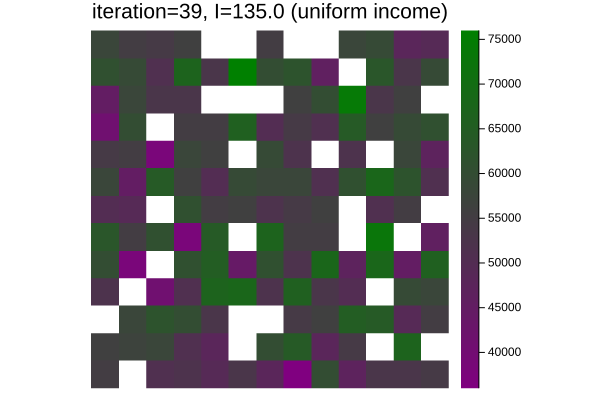

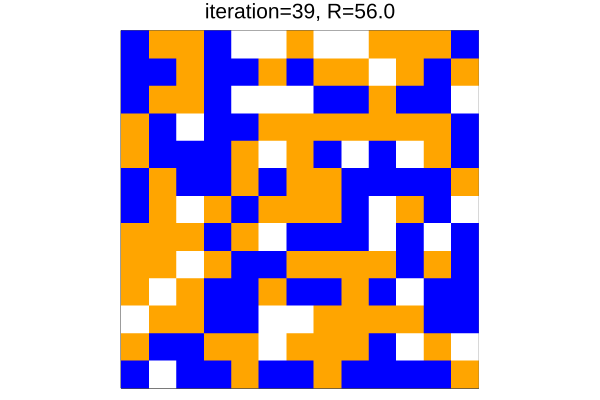

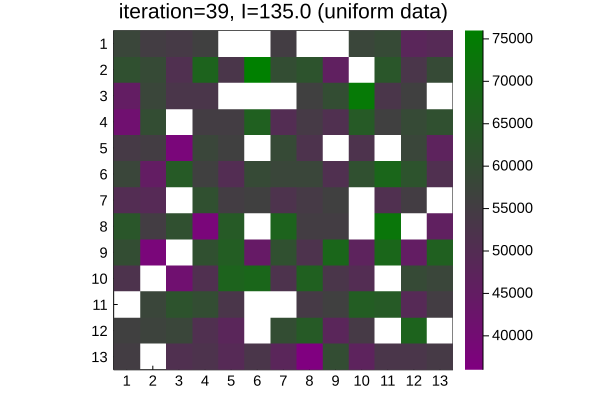

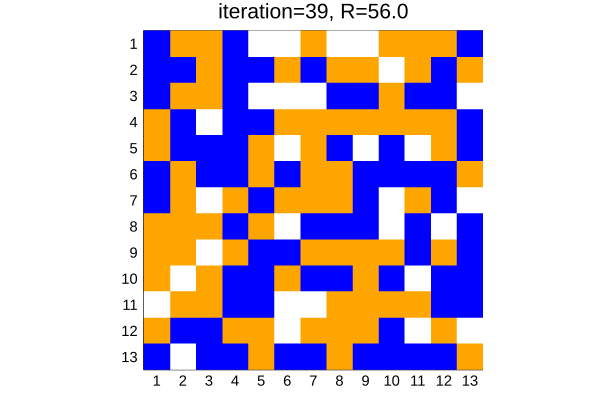

39


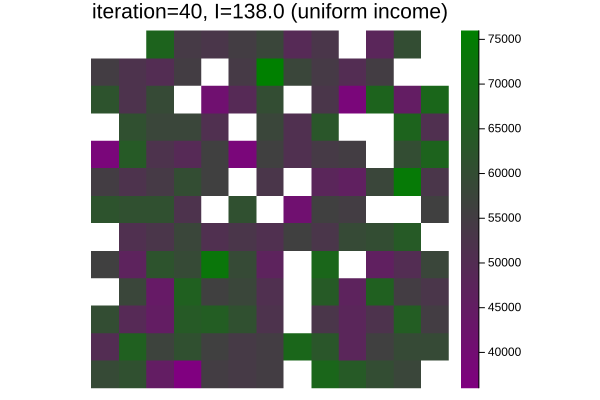

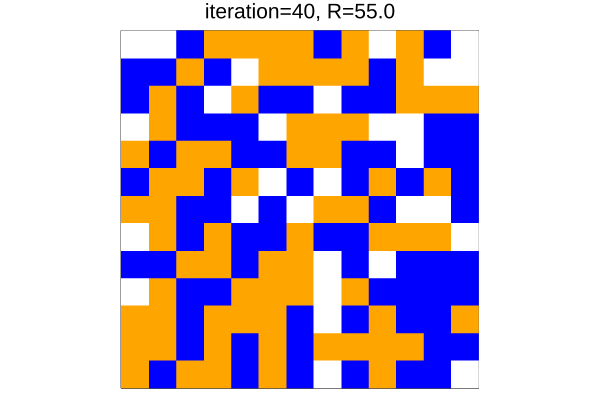

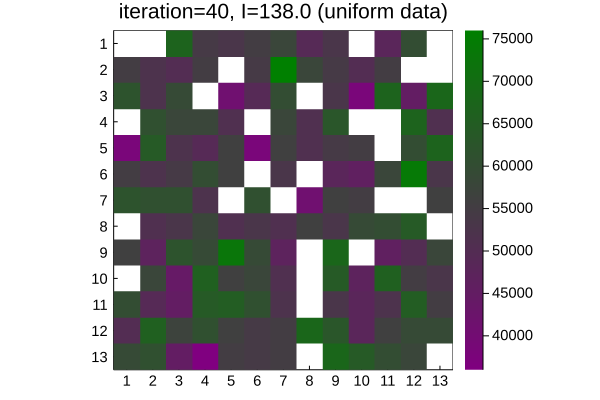

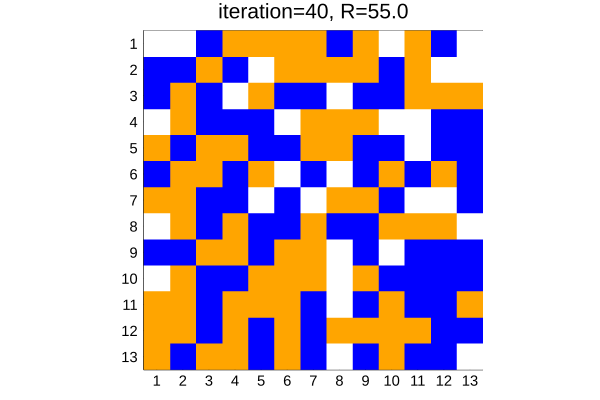

40
139.0
130.0


In [332]:
#simulate movement with no dynamics (random moves) 
#and track both the macrostates variables 
#UNIFORM DATA
traceR_uni_single = zeros(TT)
traceI_uni_single = zeros(TT)
moneyGrid = make_uniform_sampled_finance_grid() 
trace2Duniform = [] #stores the tuples of the trace 2D coordinates
for tt in 1:TT     
    println(tt)
    if(tt==1)
        moneyGrid = make_uniform_sampled_finance_grid()  
    else
        moneyGrid =  move_cells_for_wealth_NoDynamics(moneyGrid) #make_random_finance_grid()  
    end        
    traceR_uni_single[tt] = grid_satisfaction(moneyGrid[:,:,1])
    traceI_uni_single[tt] = financial_grid_deviation(moneyGrid) 
    
    if(tt==1)
        trace2Duniform = (traceR_uni_single[tt],traceI_uni_single[tt])
    else
        trace2Duniform = vcat(trace2Duniform,[(traceR_uni_single[tt],traceI_uni_single[tt])])
    end  
    
    gridTmp = deepcopy(moneyGrid[:,:,2])
    inds = findall(moneyGrid[:,:,1] .== 0)    
    gridTmp[inds] .= NaN   
   
    h = heatmap(gridTmp,
        title="iteration=$(tt), I=$(round(traceI_uni_single[tt],digits=2)) (uniform income)",
        showaxis=false,xticks=false,yticks=false,yaxis=:flip,aspect_ratio=1.0,
        framestyle=:box,xlims=(0.5,GRID_SIZE+0.5),legend=true,
        c=ColorGradient([:purple,:green]))    
   
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots3/I_time$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots3/I_time$(tt).pdf"))
    
    h = gridHeatMap(moneyGrid[:,:,1],"iteration=$(tt), R=$(traceR_uni_single[tt])",
        false)
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots3/R_time$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots3/R_time$(tt).pdf"))
    
    #now put the x and y ticks on the cell positions for the sake of it
    h = heatmap(gridTmp,
        title="iteration=$(tt), I=$(round(traceI_uni_single[tt],digits=2)) (uniform data)",
        showaxis=true,xticks=1:GRID_STEP:GRID_SIZE,yticks=1:GRID_STEP:GRID_SIZE,
        yaxis=:flip,aspect_ratio=1.0,xtickfont=10,ytickfont=10,
        framestyle=:box,xlims=(0.5,GRID_SIZE+0.5),legend=true, grid=false,   
        c=ColorGradient([:purple,:green])) 
    
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots3/I_timeB$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots3/I_timeB$(tt).pdf"))
    
    h = gridHeatMap(moneyGrid[:,:,1],"iteration=$(tt), R=$(traceR_uni_single[tt])",
        true)
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots3/R_timeB$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots3/R_timeB$(tt).pdf"))
end
println(maximum(traceI_uni_single))
println(minimum(traceI_uni_single))

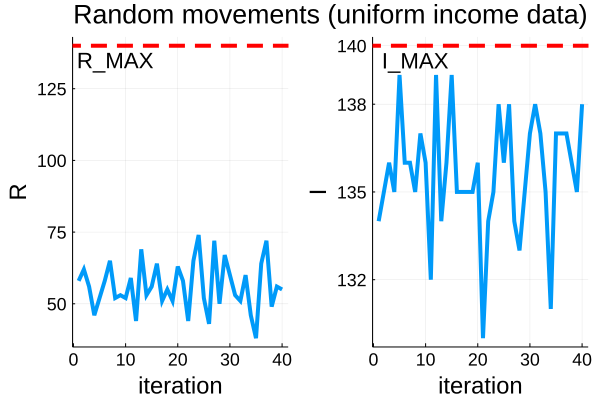

GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT


In [333]:
#plot the trces for both the spatial and the UNIFORM DATA

plt1 = plot(traceR_uni_single,linewidth=4,#title="random moves",
    xlabel="iteration",leg=false,ylabel="R",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 135 , text("R_MAX",15))

p2 = plot(traceI_uni_single,linewidth=4,#title="random moves",
    xlabel="iteration",
    leg=false,ylabel="I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 139.5 , text("I_MAX",15))

#pboth = plot(plt1,p2)
title = plot(title = "Random movements (uniform income data)", grid = false,titlefont=TITLEFONTSIZE,
    showaxis = false, bottom_margin = -50Plots.px)
pboth = plot(title, plt1, p2, layout = @layout([A{0.05h}; [B C]]))
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())


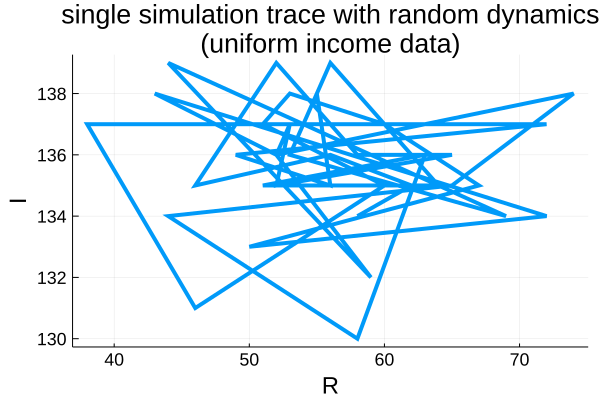

In [334]:
#plot the trajectory of the 2D for UNIFORM DATA INCOME
plt = plot(traceR_uni_single,traceI_uni_single,line=:path,linewidth=4,
    title="single simulation trace with random dynamics \n (uniform income data)",
    xlabel="R",leg=false,ylabel="I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

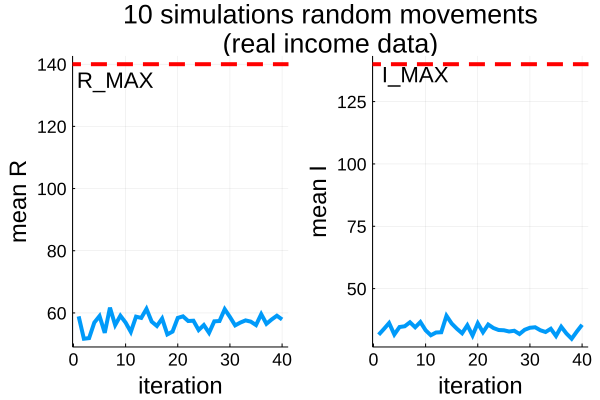

GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT


In [335]:
#mean and variance of the no dynamics trajectory REAL INCOME DATA
simulationRvals = zeros(TT,MM)
simulationIvals = zeros(TT,MM)
for mm in 1:MM       
    traceR = zeros(TT)
    traceI = zeros(TT)
    for tt in 1:TT 
        if(tt==1)
            moneyGrid = make_random_finance_grid()  
        else
            moneyGrid =  move_cells_for_wealth_NoDynamics(moneyGrid) #make_random_finance_grid()  
        end    
        traceR[tt] = grid_satisfaction(moneyGrid[:,:,1])
        traceI[tt] = financial_grid_deviation(moneyGrid)   
    end
    simulationRvals[:,mm] = traceR[:]
    simulationIvals[:,mm] = traceI[:]
end

meanTraceR = mean(simulationRvals,dims=2)
meanTraceI = mean(simulationIvals,dims=2)

plt1 = plot(meanTraceR,linewidth=4,#title="random moves",
    xlabel="iteration",leg=false,ylabel="mean R",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 135 , text("R_MAX",15))

plt2 = plot(meanTraceI,linewidth=4,#title="random moves",
    xlabel="iteration",
    leg=false,ylabel="mean I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 136 , text("I_MAX",15))

#pboth = plot(plt1,p2)
title = plot(title = "$(MM) simulations random movements \n (real income data)", grid = false,titlefont=TITLEFONTSIZE,
    showaxis = false, bottom_margin = -50Plots.px)
pboth = plot(title, plt1, plt2, layout = @layout([A{0.05h}; [B C]]))
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())


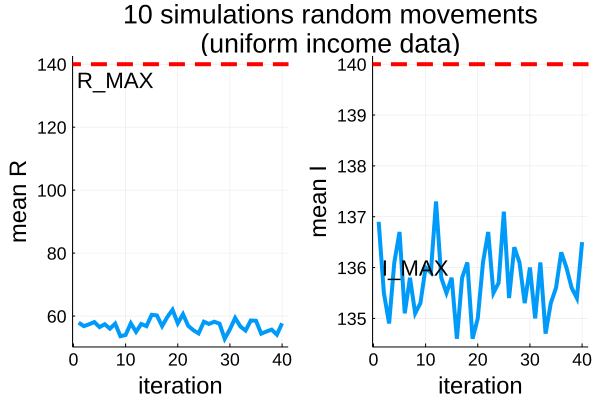

GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT


In [336]:
#mean and variance of the no dynamics trajectory UNIFORM INCOME DATA
simulationRvals_uniform_multi = zeros(TT,MM)
simulationIvals_uniform_multi = zeros(TT,MM)
for mm in 1:MM       
    traceR = zeros(TT)
    traceI = zeros(TT)
    for tt in 1:TT 
        if(tt==1)
            moneyGrid = make_uniform_sampled_finance_grid()  
        else
            moneyGrid =  move_cells_for_wealth_NoDynamics(moneyGrid) #make_random_finance_grid()  
        end    
        traceR[tt] = grid_satisfaction(moneyGrid[:,:,1])
        traceI[tt] = financial_grid_deviation(moneyGrid)   
    end
    simulationRvals_uniform_multi[:,mm] = traceR[:]
    simulationIvals_uniform_multi[:,mm] = traceI[:]
end
   
meanTraceR = mean(simulationRvals_uniform_multi,dims=2)
meanTraceI = mean(simulationIvals_uniform_multi,dims=2)

plt1 = plot(meanTraceR,linewidth=4,#title="random moves",
    xlabel="iteration",leg=false,ylabel="mean R",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 135 , text("R_MAX",15))

plt2 = plot(meanTraceI,linewidth=4,#title="random moves",
    xlabel="iteration",
    leg=false,ylabel="mean I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 136 , text("I_MAX",15))

#pboth = plot(plt1,p2)
title = plot(title = "$(MM) simulations random movements \n (uniform income data)", grid = false,titlefont=TITLEFONTSIZE,
    showaxis = false, bottom_margin = -50Plots.px)
pboth = plot(title, plt1, plt2, layout = @layout([A{0.05h}; [B C]]))
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())


In [337]:
########################################################!!!
#SCHELLING DYNAMICS WITH INCOME DATA BUT NO INCOME DYNAMICS
########################################################!!!

In [338]:
TT

40

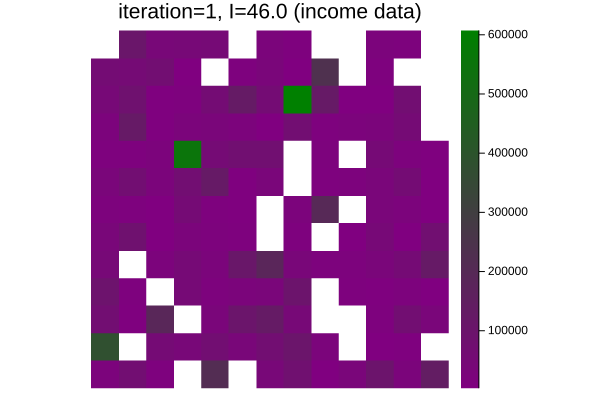

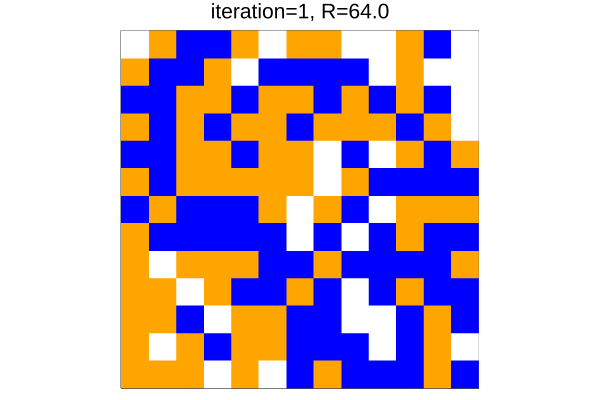

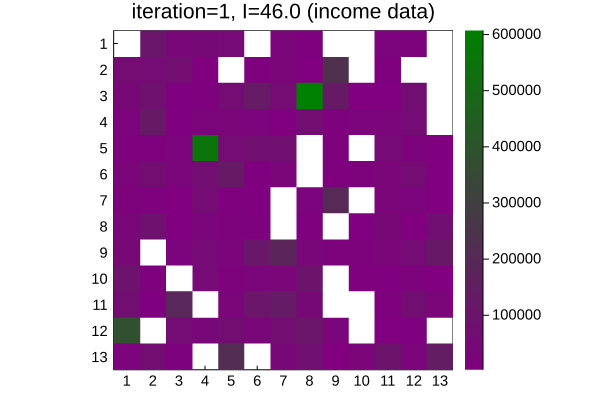

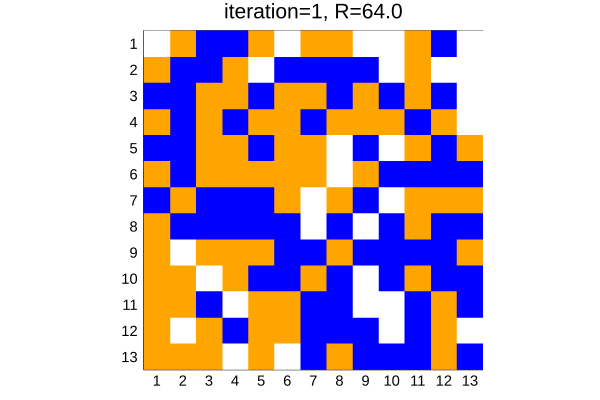

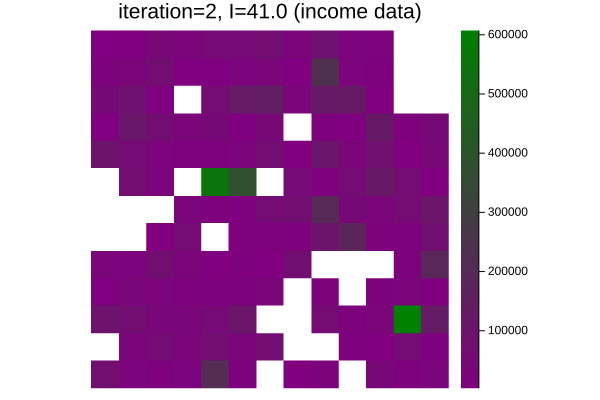

...

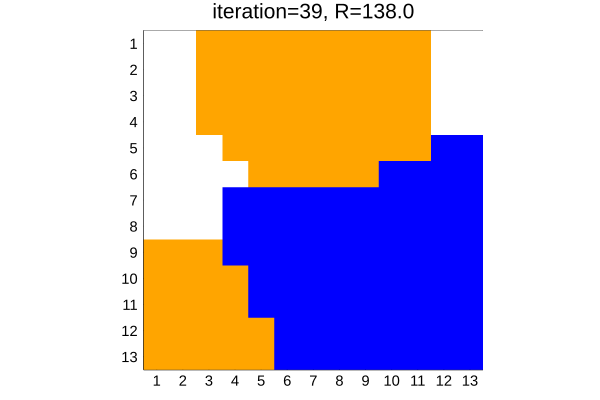

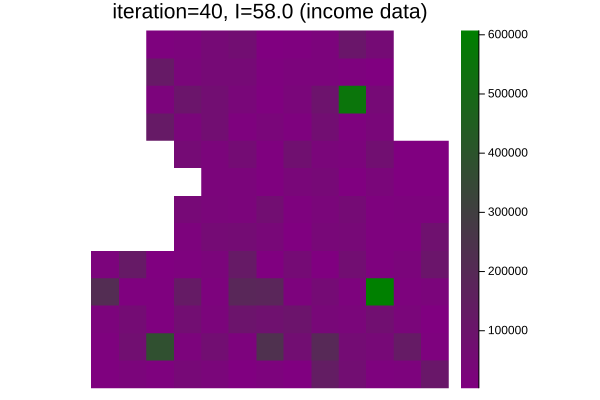

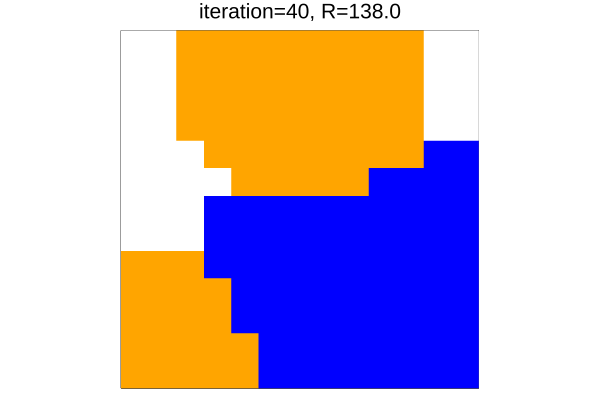

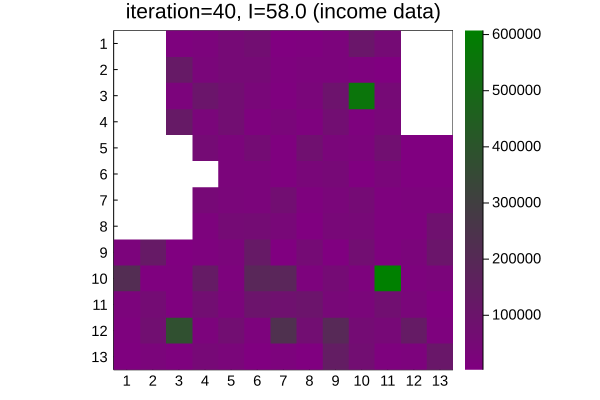

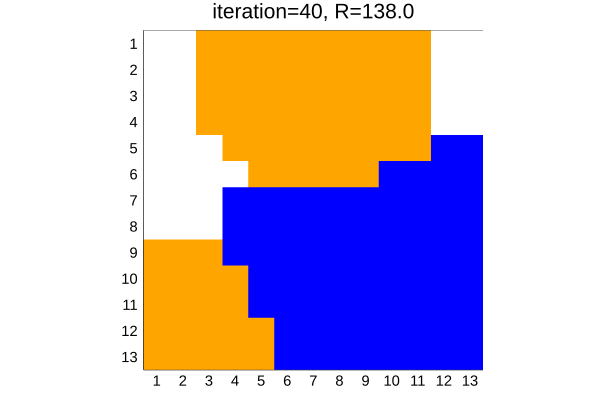

In [339]:
#simulate only label movements with no income dynamics
#and track both the macrostates variables 
#REAL INCOME DATA
traceR_real_single = zeros(TT)
traceI_real_single = zeros(TT)
moneyGrid = make_random_finance_grid() 
trace2D = [] #stores the tuples of the trace 2D coordinates
for tt in 1:TT
    if(tt==1)
        #make_random_finance_grid()  
        moneyGrid = make_random_finance_grid()  
    else
        #now make the cells 'move' but not change their income
        #moneyGrid =  move_cells_for_wealth_NoDynamics(moneyGrid) 
        moneyGrid = move_cells_for_SchellingDynamics_NoWealthDynamics(moneyGrid)
    end
    #get the homogeneity satisfaction for the spatial arrangements
    traceR_real_single[tt] = grid_satisfaction(moneyGrid[:,:,1])
    #get the financial component of the grid's homogeneity satisfaction 
    traceI_real_single[tt] = financial_grid_deviation(moneyGrid)
    
    if(tt==1)
        trace2D = (traceR_real_single[tt],traceI_real_single[tt])
    else
        trace2D = vcat(trace2D,[(traceR_real_single[tt],traceI_real_single[tt])])
    end  
    
    gridTmp = deepcopy(moneyGrid[:,:,2])
    inds = findall(gridTmp .== 0)    
    gridTmp[inds] .= NaN #so the values do not affect the scale of the legend
    h = heatmap(gridTmp,
        title="iteration=$(tt), I=$(round(traceI_real_single[tt],digits=2)) (income data)",
        showaxis=false,xticks=false,yticks=false,yaxis=:flip,aspect_ratio=1.0,
        framestyle=:box,xlims=(0.5,GRID_SIZE+0.5),legend=true,
        c=ColorGradient([:purple,:green]))   
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots4/I_time$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots4/I_time$(tt).pdf"))
    
    h = gridHeatMap(moneyGrid[:,:,1],"iteration=$(tt), R=$(traceR_real_single[tt])",
        false)
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots4/R_time$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots4/R_time$(tt).pdf"))
    
    #now put the x and y ticks on the cell positions for the sake of it
    h = heatmap(gridTmp,
        title="iteration=$(tt), I=$(round(traceI_real_single[tt],digits=2)) (income data)",
        showaxis=true,xticks=1:GRID_STEP:GRID_SIZE,yticks=1:GRID_STEP:GRID_SIZE,
        yaxis=:flip,aspect_ratio=1.0,xtickfont=10,ytickfont=10,
        framestyle=:box,xlims=(0.5,GRID_SIZE+0.5),legend=true, grid=false,   
        c=ColorGradient([:purple,:green])) 
    
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots4/I_timeB$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots4/I_timeB$(tt).pdf"))
    
    h = gridHeatMap(moneyGrid[:,:,1],"iteration=$(tt), R=$(traceR_real_single[tt])",
        true)
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots4/R_timeB$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots4/R_timeB$(tt).pdf"))
end


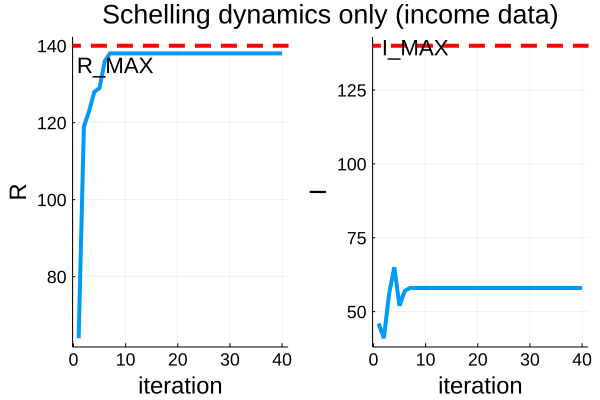

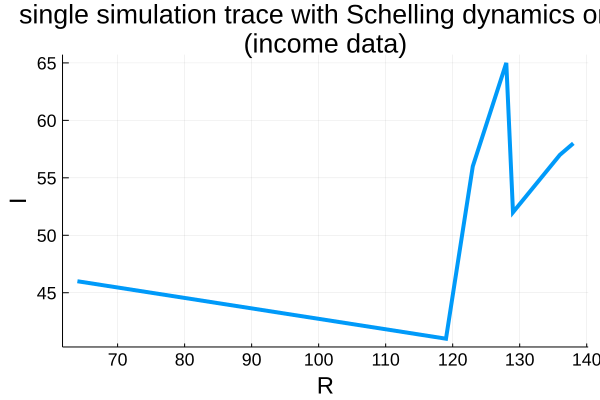

GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT


In [340]:
plt1 = plot(traceR_real_single,linewidth=4,#title="random moves",
    xlabel="iteration",leg=false,ylabel="R",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 135 , text("R_MAX",15))

p2 = plot(traceI_real_single,linewidth=4,#title="random moves",
    xlabel="iteration",
    leg=false,ylabel="I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 139.5 , text("I_MAX",15))

#pboth = plot(plt1,p2)
title = plot(title = "Schelling dynamics only (income data)", grid = false,titlefont=TITLEFONTSIZE,
    showaxis = false, bottom_margin = -50Plots.px)
pboth = plot(title, plt1, p2, layout = @layout([A{0.05h}; [B C]]))
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())

#plot the trajectory of the 2D for UNIFORM DATA INCOME
plt = plot(traceR_real_single,traceI_real_single,line=:path,linewidth=4,
    title="single simulation trace with Schelling dynamics only \n (income data)",
    xlabel="R",leg=false,ylabel="I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

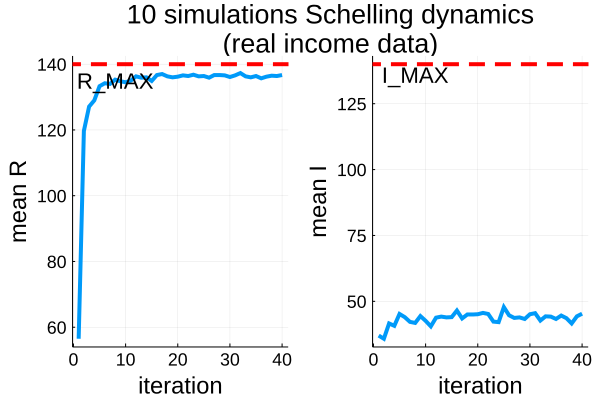

GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT


In [341]:
#mean and variance of the no dynamics trajectory REAL INCOME DATA
simulationRvals = zeros(TT,MM)
simulationIvals = zeros(TT,MM)
for mm in 1:MM       
    traceR = zeros(TT)
    traceI = zeros(TT)
    for tt in 1:TT 
        if(tt==1)
            moneyGrid = make_random_finance_grid()  
        else
             #now make the cells 'move' but not change their income
             #moneyGrid =  move_cells_for_wealth_NoDynamics(moneyGrid) 
             moneyGrid = move_cells_for_SchellingDynamics_NoWealthDynamics(moneyGrid)
        end    
        traceR[tt] = grid_satisfaction(moneyGrid[:,:,1])
        traceI[tt] = financial_grid_deviation(moneyGrid)   
    end
    simulationRvals[:,mm] = traceR[:]
    simulationIvals[:,mm] = traceI[:]
end

meanTraceR = mean(simulationRvals,dims=2)
meanTraceI = mean(simulationIvals,dims=2)

plt1 = plot(meanTraceR,linewidth=4,#title="random moves",
    xlabel="iteration",leg=false,ylabel="mean R",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 135 , text("R_MAX",15))

plt2 = plot(meanTraceI,linewidth=4,#title="random moves",
    xlabel="iteration",
    leg=false,ylabel="mean I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 136 , text("I_MAX",15))

#pboth = plot(plt1,p2)
title = plot(title = "$(MM) simulations Schelling dynamics \n (real income data)", 
    grid = false,titlefont=TITLEFONTSIZE,
    showaxis = false, bottom_margin = -50Plots.px)
pboth = plot(title, plt1, plt2, layout = @layout([A{0.05h}; [B C]]))
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())
#XXX

In [342]:
#NOW FOR THE UNIFORM GRID AND SCHELLING DYNAMICS

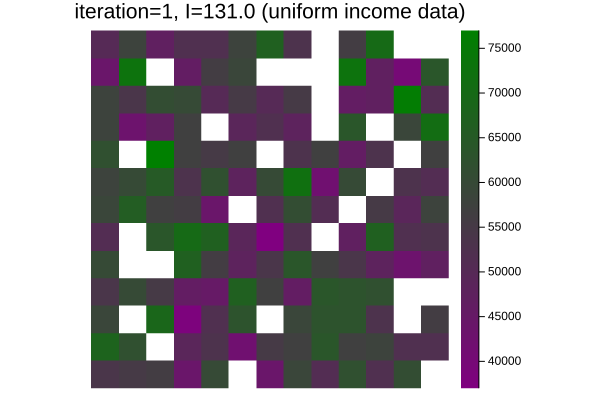

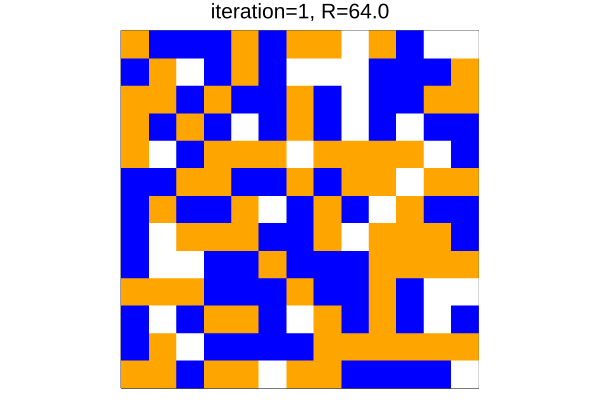

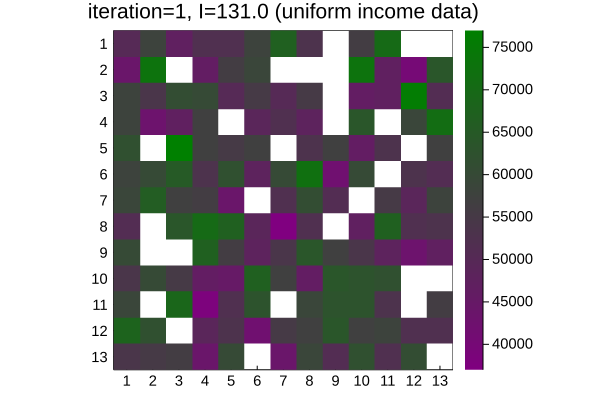

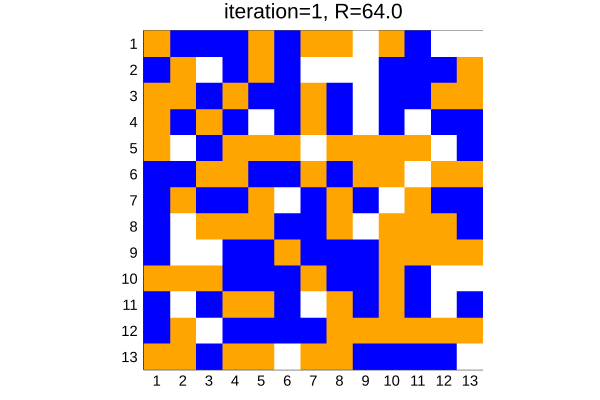

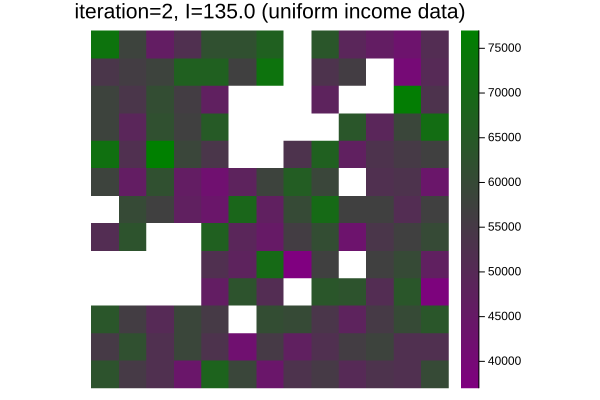

...

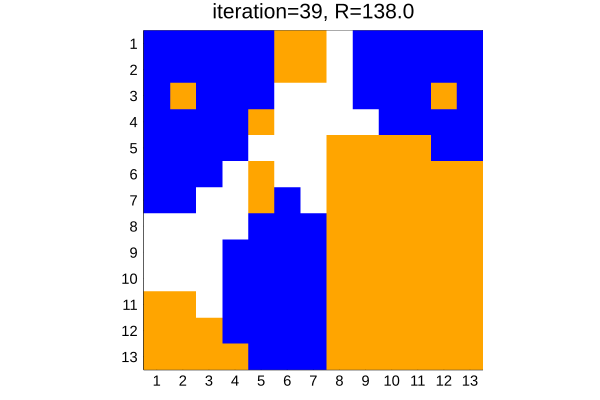

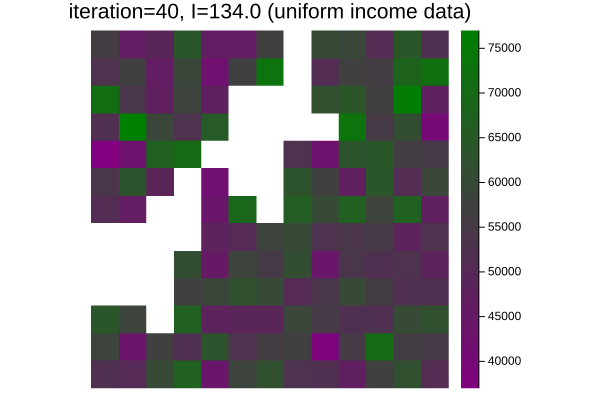

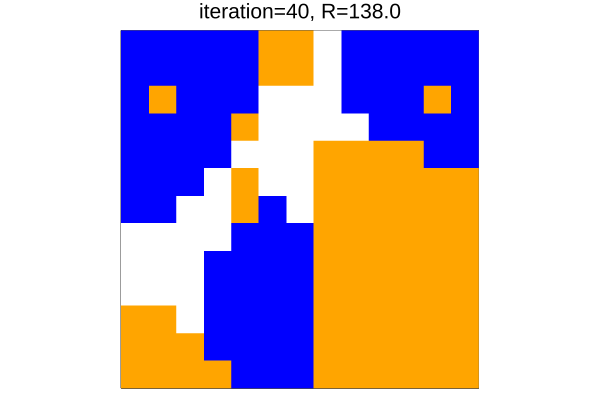

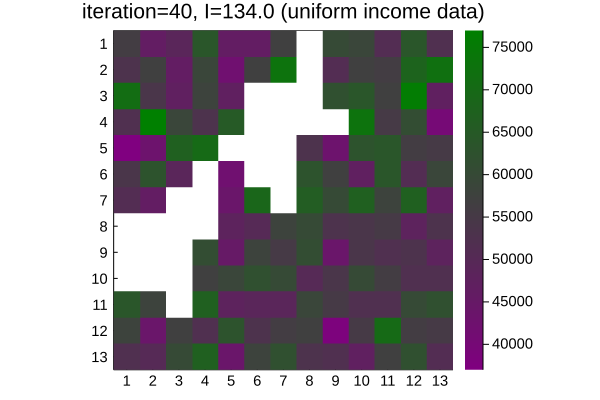

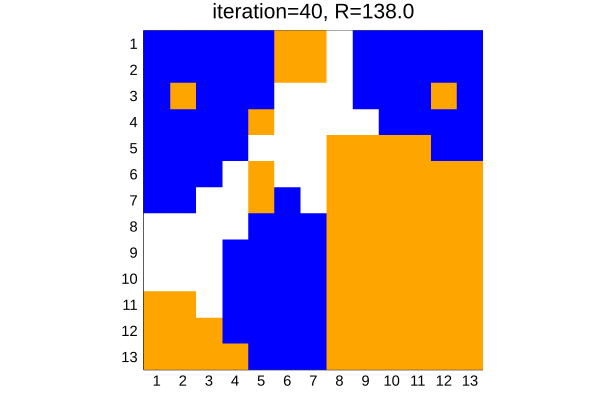

In [343]:
#simulate only label movements with no income dynamics
#and track both the macrostates variables 
#REAL INCOME DATA
traceR_uni_single = zeros(TT)
traceI_uni_single = zeros(TT)
moneyGrid = make_uniform_sampled_finance_grid() 
trace2D = [] #stores the tuples of the trace 2D coordinates
for tt in 1:TT
    if(tt==1)
        #make_random_finance_grid()  
        moneyGrid = make_uniform_sampled_finance_grid()  
    else
        #now make the cells 'move' but not change their income
        #moneyGrid =  move_cells_for_wealth_NoDynamics(moneyGrid) 
        moneyGrid = move_cells_for_SchellingDynamics_NoWealthDynamics(moneyGrid)
    end
    #get the homogeneity satisfaction for the spatial arrangements
    traceR_uni_single[tt] = grid_satisfaction(moneyGrid[:,:,1])
    #get the financial component of the grid's homogeneity satisfaction 
    traceI_uni_single[tt] = financial_grid_deviation(moneyGrid)
    
    if(tt==1)
        trace2D = (traceR_uni_single[tt],traceI_uni_single[tt])
    else
        trace2D = vcat(trace2D,[(traceR_uni_single[tt],traceI_uni_single[tt])])
    end  
    
    gridTmp = deepcopy(moneyGrid[:,:,2])
    inds = findall(gridTmp .== 0)    
    gridTmp[inds] .= NaN #so the values do not affect the scale of the legend
    h = heatmap(gridTmp,
        title="iteration=$(tt), I=$(round(traceI_uni_single[tt],digits=2)) (uniform income data)",
        showaxis=false,xticks=false,yticks=false,yaxis=:flip,aspect_ratio=1.0,
        framestyle=:box,xlims=(0.5,GRID_SIZE+0.5),legend=true,
        c=ColorGradient([:purple,:green]))   
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots4/I_time$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots4/I_time$(tt).pdf"))
    
    h = gridHeatMap(moneyGrid[:,:,1],"iteration=$(tt), R=$(traceR_real_single[tt])",
        false)
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots4/R_time$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots4/R_time$(tt).pdf"))
    
    #now put the x and y ticks on the cell positions for the sake of it
    h = heatmap(gridTmp,
        title="iteration=$(tt), I=$(round(traceI_uni_single[tt],digits=2)) (uniform income data)",
        showaxis=true,xticks=1:GRID_STEP:GRID_SIZE,yticks=1:GRID_STEP:GRID_SIZE,
        yaxis=:flip,aspect_ratio=1.0,xtickfont=10,ytickfont=10,
        framestyle=:box,xlims=(0.5,GRID_SIZE+0.5),legend=true, grid=false,   
        c=ColorGradient([:purple,:green])) 
    
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots4/I_timeB$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots4/I_timeB$(tt).pdf"))
    
    h = gridHeatMap(moneyGrid[:,:,1],"iteration=$(tt), R=$(traceR_real_single[tt])",
        true)
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots4/R_timeB$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots4/R_timeB$(tt).pdf"))
end

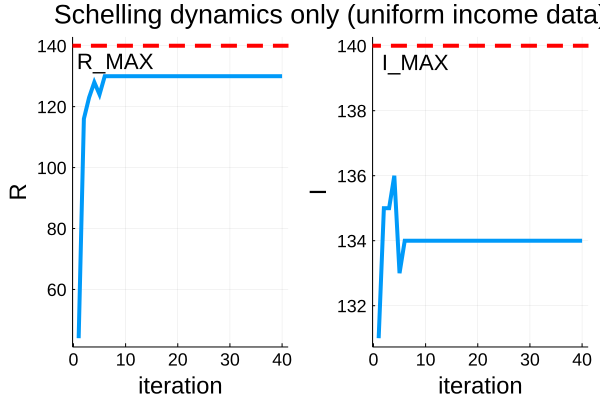

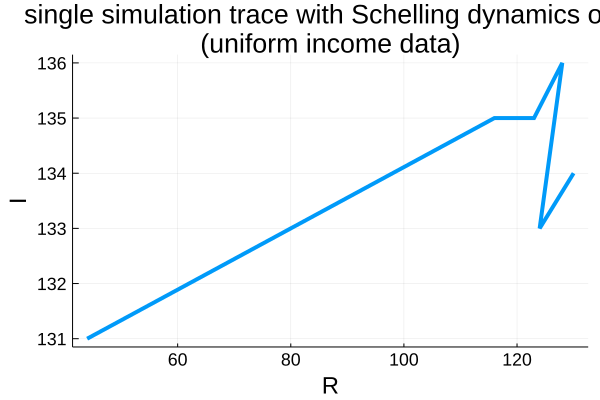

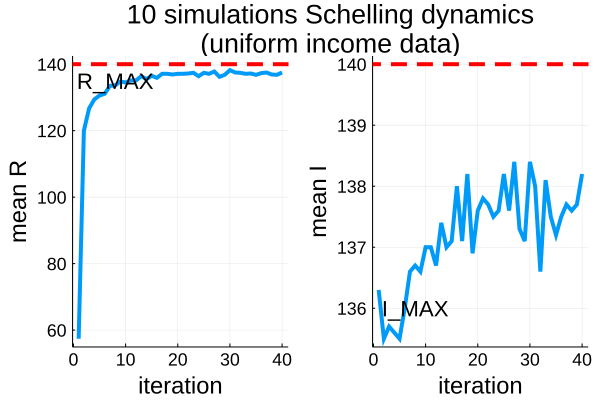

GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT


In [344]:
plt1 = plot(traceR_uni_single,linewidth=4,#title="random moves",
    xlabel="iteration",leg=false,ylabel="R",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 135 , text("R_MAX",15))

p2 = plot(traceI_uni_single,linewidth=4,#title="random moves",
    xlabel="iteration",
    leg=false,ylabel="I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 139.5 , text("I_MAX",15))

#pboth = plot(plt1,p2)
title = plot(title = "Schelling dynamics only (uniform income data)", grid = false,titlefont=TITLEFONTSIZE,
    showaxis = false, bottom_margin = -50Plots.px)
pboth = plot(title, plt1, p2, layout = @layout([A{0.05h}; [B C]]))
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())

#plot the trajectory of the 2D for UNIFORM DATA INCOME
plt = plot(traceR_uni_single,traceI_uni_single,line=:path,linewidth=4,
    title="single simulation trace with Schelling dynamics only \n (uniform income data)",
    xlabel="R",leg=false,ylabel="I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#mean and variance of the no dynamics trajectory REAL INCOME DATA
simulationRvals = zeros(TT,MM)
simulationIvals = zeros(TT,MM)
for mm in 1:MM       
    traceR = zeros(TT)
    traceI = zeros(TT)
    for tt in 1:TT 
        if(tt==1)
            moneyGrid = make_uniform_sampled_finance_grid()  
        else
             #now make the cells 'move' but not change their income
             #moneyGrid =  move_cells_for_wealth_NoDynamics(moneyGrid) 
             moneyGrid = move_cells_for_SchellingDynamics_NoWealthDynamics(moneyGrid)
        end    
        traceR[tt] = grid_satisfaction(moneyGrid[:,:,1])
        traceI[tt] = financial_grid_deviation(moneyGrid)   
    end
    simulationRvals[:,mm] = traceR[:]
    simulationIvals[:,mm] = traceI[:]
end

meanTraceR = mean(simulationRvals,dims=2)
meanTraceI = mean(simulationIvals,dims=2)

plt1 = plot(meanTraceR,linewidth=4,#title="random moves",
    xlabel="iteration",leg=false,ylabel="mean R",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 135 , text("R_MAX",15))

plt2 = plot(meanTraceI,linewidth=4,#title="random moves",
    xlabel="iteration",
    leg=false,ylabel="mean I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 136 , text("I_MAX",15))

#pboth = plot(plt1,p2)
title = plot(title = "$(MM) simulations Schelling dynamics \n (uniform income data)", 
    grid = false,titlefont=TITLEFONTSIZE,
    showaxis = false, bottom_margin = -50Plots.px)
pboth = plot(title, plt1, plt2, layout = @layout([A{0.05h}; [B C]]))
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())


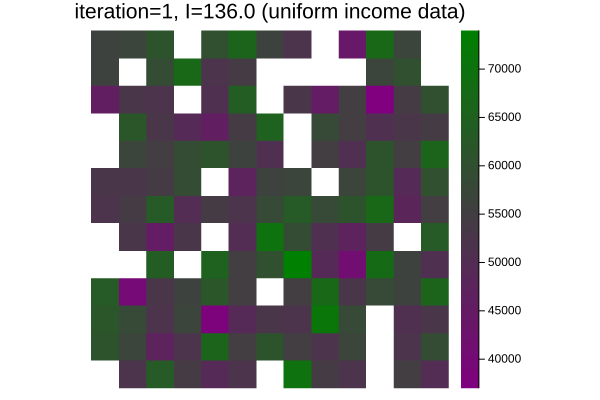

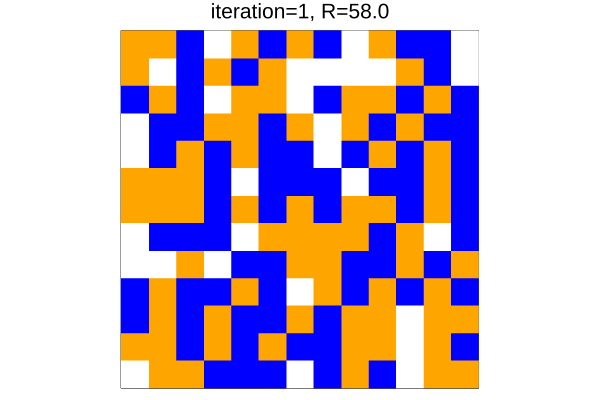

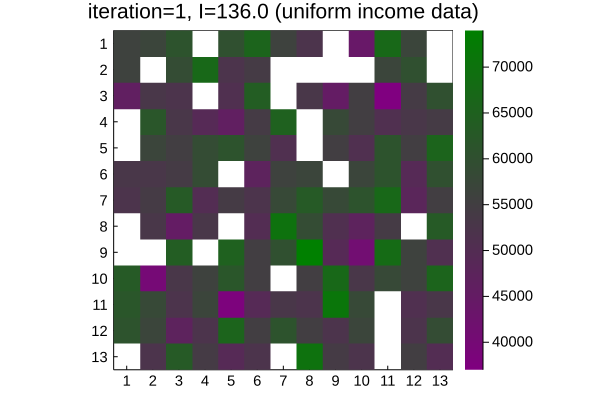

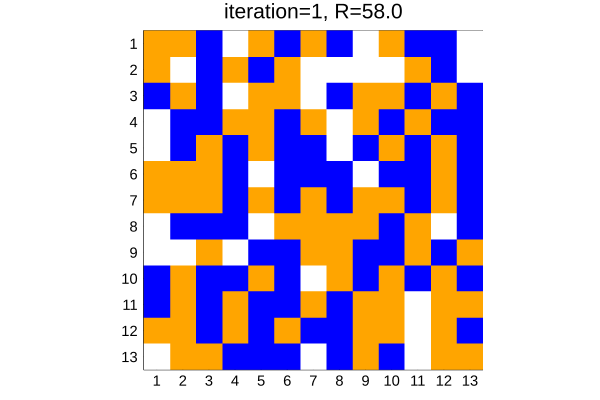

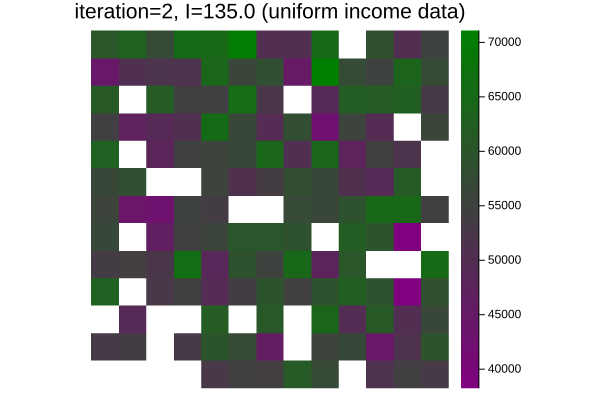

...

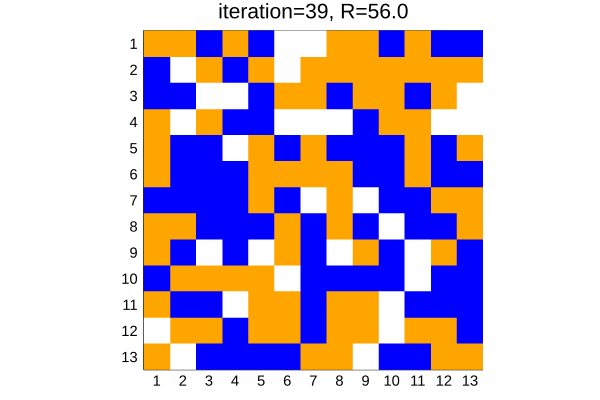

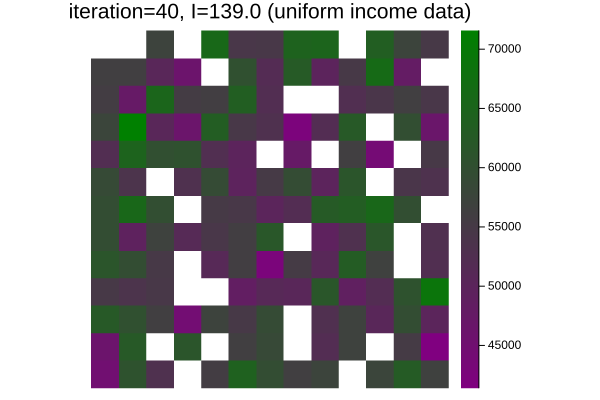

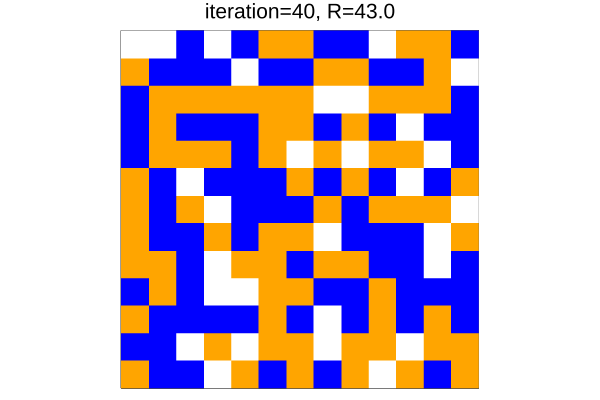

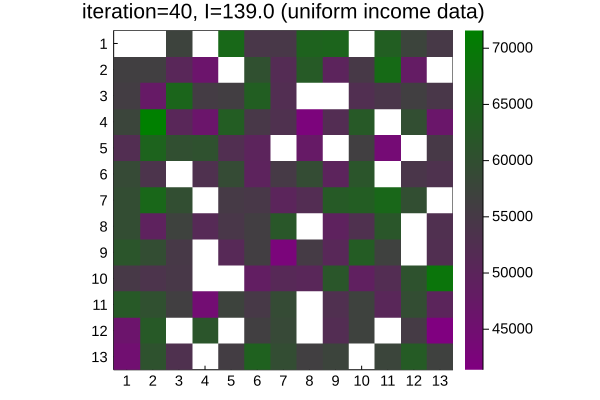

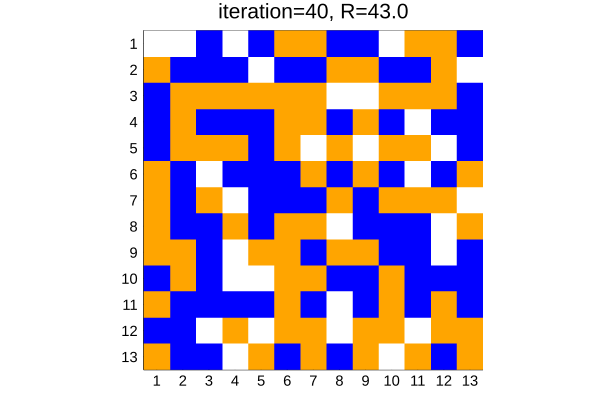

In [345]:
#simulate only label movements with only income dynamics
#and track both the macrostates variables
#UNIFORM INCOME DATA
traceR_uni_single = zeros(TT)
traceI_uni_single = zeros(TT)
moneyGrid = make_uniform_sampled_finance_grid() 
trace2D = [] #stores the tuples of the trace 2D coordinates
for tt in 1:TT
    if(tt==1)
        #make_random_finance_grid()  
        moneyGrid = make_uniform_sampled_finance_grid()  
    else
        #now make the cells 'move' but not change their income
        #moneyGrid =  move_cells_for_wealth_NoDynamics(moneyGrid) 
        #moneyGrid = move_cells_for_SchellingDynamics_NoWealthDynamics(moneyGrid)
        moneyGrid = move_cells_for_wealth_DynamicsOnly(moneyGrid) 
    end
    #get the homogeneity satisfaction for the spatial arrangements
    traceR_uni_single[tt] = grid_satisfaction(moneyGrid[:,:,1])
    #get the financial component of the grid's homogeneity satisfaction 
    traceI_uni_single[tt] = financial_grid_deviation(moneyGrid)
    
    if(tt==1)
        trace2D = (traceR_uni_single[tt],traceI_uni_single[tt])
    else
        trace2D = vcat(trace2D,[(traceR_uni_single[tt],traceI_uni_single[tt])])
    end  
    
    gridTmp = deepcopy(moneyGrid[:,:,2])
    inds = findall(gridTmp .== 0)    
    gridTmp[inds] .= NaN #so the values do not affect the scale of the legend
    h = heatmap(gridTmp,
        title="iteration=$(tt), I=$(round(traceI_uni_single[tt],digits=2)) (uniform income data)",
        showaxis=false,xticks=false,yticks=false,yaxis=:flip,aspect_ratio=1.0,
        framestyle=:box,xlims=(0.5,GRID_SIZE+0.5),legend=true,
        c=ColorGradient([:purple,:green]))   
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots5/I_time$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots5/I_time$(tt).pdf"))
    
    h = gridHeatMap(moneyGrid[:,:,1],"iteration=$(tt), R=$(traceR_uni_single[tt])",
        false)
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots5/R_time$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots5/R_time$(tt).pdf"))
    
    #now put the x and y ticks on the cell positions for the sake of it
    h = heatmap(gridTmp,
        title="iteration=$(tt), I=$(round(traceI_uni_single[tt],digits=2)) (uniform income data)",
        showaxis=true,xticks=1:GRID_STEP:GRID_SIZE,yticks=1:GRID_STEP:GRID_SIZE,
        yaxis=:flip,aspect_ratio=1.0,xtickfont=10,ytickfont=10,
        framestyle=:box,xlims=(0.5,GRID_SIZE+0.5),legend=true, grid=false,   
        c=ColorGradient([:purple,:green])) 
    
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots5/I_timeB$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots5/I_timeB$(tt).pdf"))
    
    h = gridHeatMap(moneyGrid[:,:,1],"iteration=$(tt), R=$(traceR_uni_single[tt])",
        true)
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots5/R_timeB$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots5/R_timeB$(tt).pdf"))
end

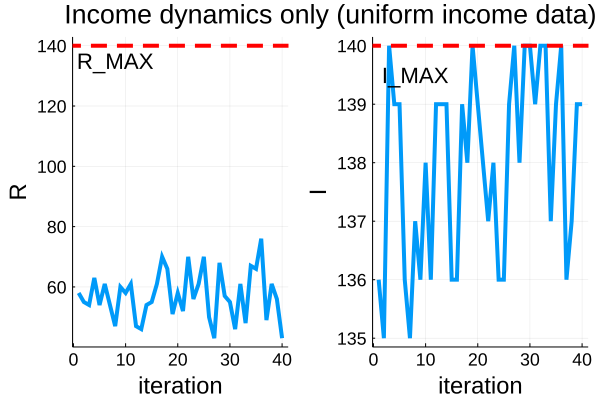

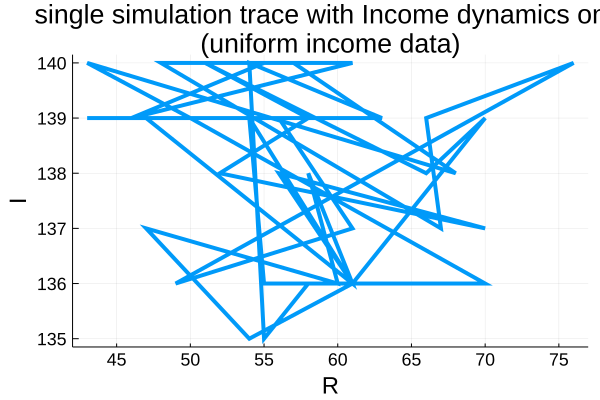

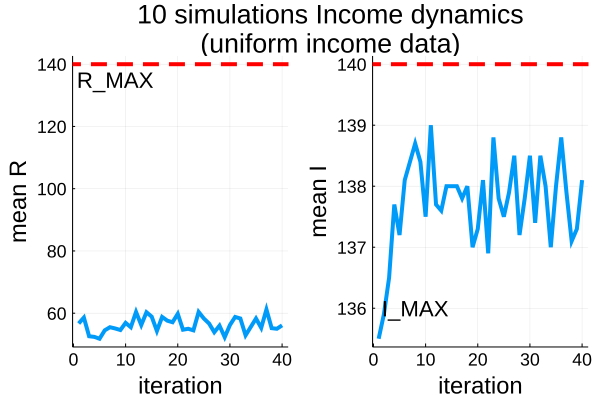

GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT


In [346]:
plt1 = plot(traceR_uni_single,linewidth=4,#title="random moves",
    xlabel="iteration",leg=false,ylabel="R",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 135 , text("R_MAX",15))

p2 = plot(traceI_uni_single,linewidth=4,#title="random moves",
    xlabel="iteration",
    leg=false,ylabel="I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 139.5 , text("I_MAX",15))

#pboth = plot(plt1,p2)
title = plot(title = "Income dynamics only (uniform income data)", grid = false,titlefont=TITLEFONTSIZE,
    showaxis = false, bottom_margin = -50Plots.px)
pboth = plot(title, plt1, p2, layout = @layout([A{0.05h}; [B C]]))
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())

#plot the trajectory of the 2D for UNIFORM DATA INCOME
plt = plot(traceR_uni_single,traceI_uni_single,line=:path,linewidth=4,
    title="single simulation trace with Income dynamics only \n (uniform income data)",
    xlabel="R",leg=false,ylabel="I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#mean and variance of the no dynamics trajectory REAL INCOME DATA
simulationRvals = zeros(TT,MM)
simulationIvals = zeros(TT,MM)
for mm in 1:MM       
    traceR = zeros(TT)
    traceI = zeros(TT)
    for tt in 1:TT 
        if(tt==1)
            moneyGrid = make_uniform_sampled_finance_grid()  
        else
             #now make the cells 'move' but not change their income
             #moneyGrid =  move_cells_for_wealth_NoDynamics(moneyGrid) 
             #moneyGrid = move_cells_for_SchellingDynamics_NoWealthDynamics(moneyGrid)
             moneyGrid = move_cells_for_wealth_DynamicsOnly(moneyGrid)
        end    
        traceR[tt] = grid_satisfaction(moneyGrid[:,:,1])
        traceI[tt] = financial_grid_deviation(moneyGrid)   
    end
    simulationRvals[:,mm] = traceR[:]
    simulationIvals[:,mm] = traceI[:]
end

meanTraceR = mean(simulationRvals,dims=2)
meanTraceI = mean(simulationIvals,dims=2)

plt1 = plot(meanTraceR,linewidth=4,#title="random moves",
    xlabel="iteration",leg=false,ylabel="mean R",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 135 , text("R_MAX",15))

plt2 = plot(meanTraceI,linewidth=4,#title="random moves",
    xlabel="iteration",
    leg=false,ylabel="mean I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 136 , text("I_MAX",15))

#pboth = plot(plt1,p2)
title = plot(title = "$(MM) simulations Income dynamics \n (uniform income data)", 
    grid = false,titlefont=TITLEFONTSIZE,
    showaxis = false, bottom_margin = -50Plots.px)
pboth = plot(title, plt1, plt2, layout = @layout([A{0.05h}; [B C]]))
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())

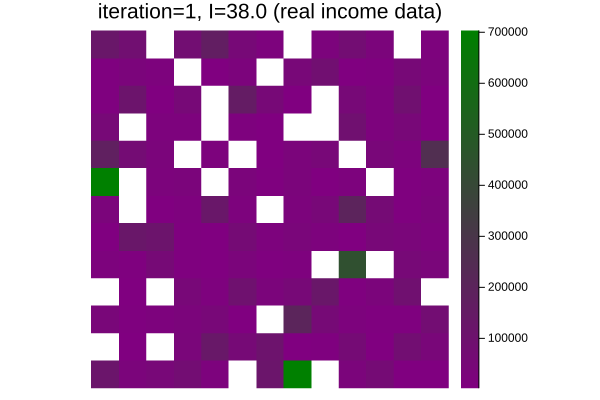

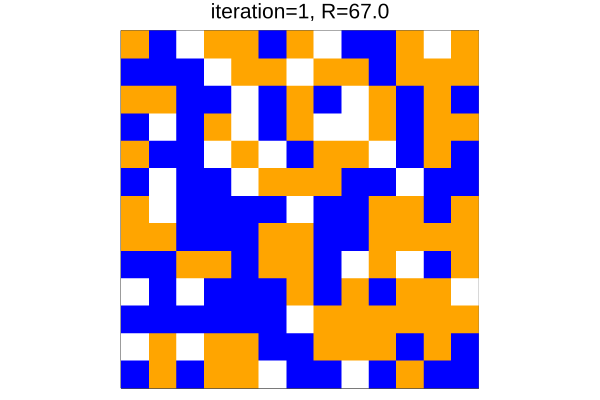

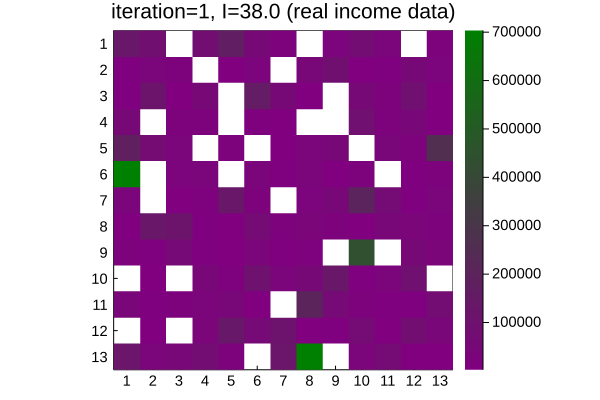

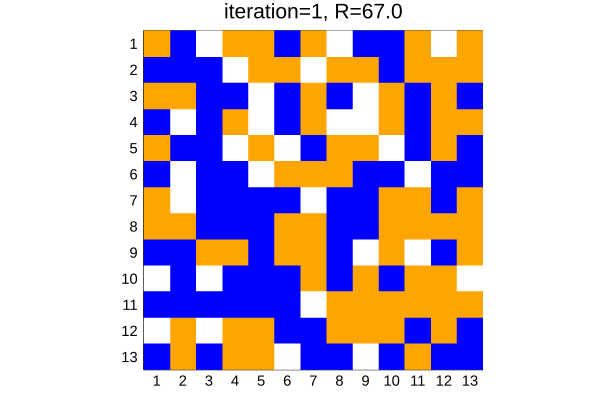

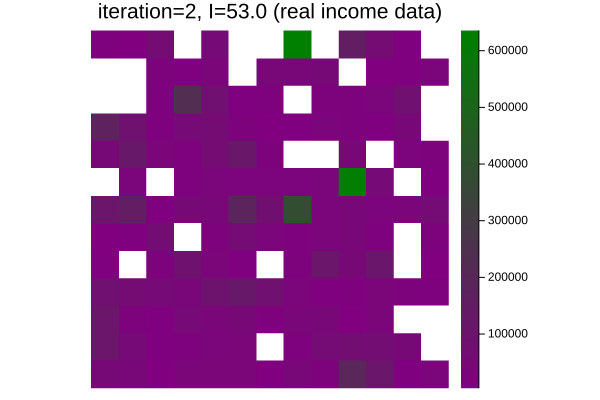

...

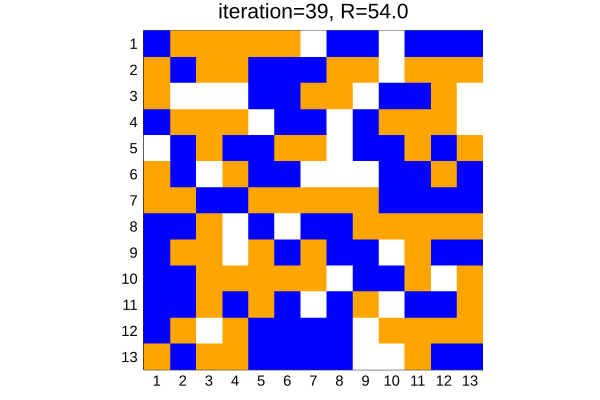

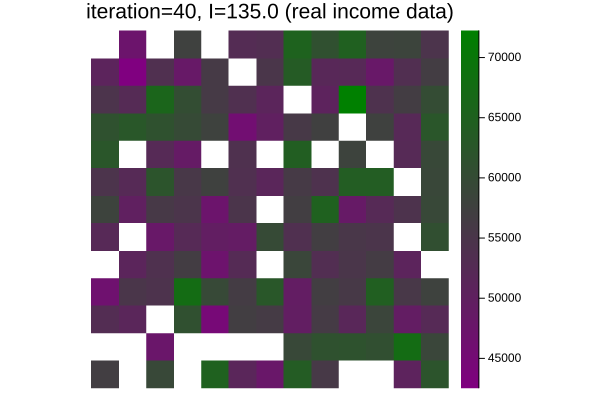

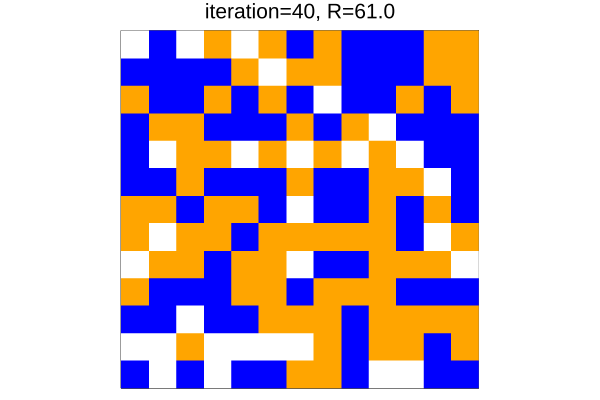

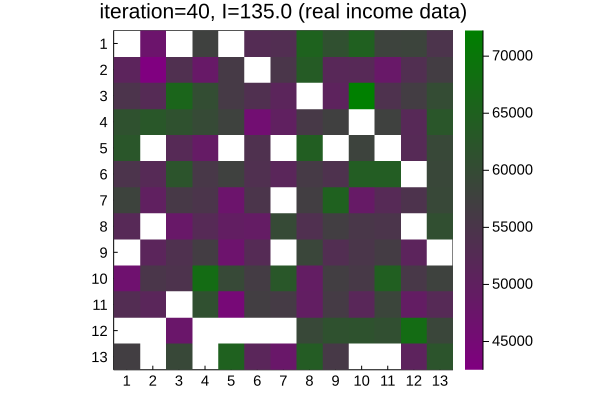

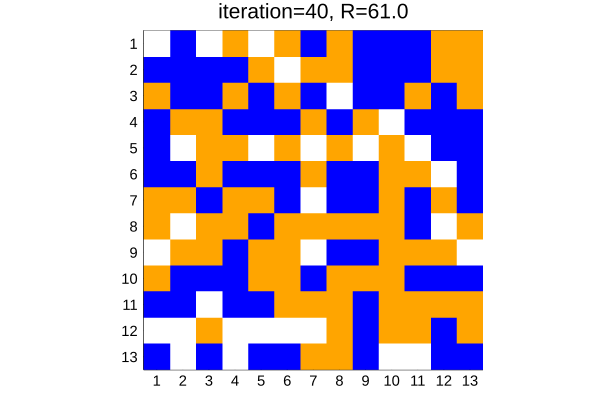

In [347]:
#simulate only label movements with only income dynamics
#and track both the macrostates variables 
#REAL INCOME DATA
traceR_real_single = zeros(TT)
traceI_real_single = zeros(TT)
moneyGrid = make_random_finance_grid()  
trace2D = [] #stores the tuples of the trace 2D coordinates
for tt in 1:TT
    if(tt==1)
        #make_random_finance_grid()  
        moneyGrid = make_random_finance_grid()
    else
        #now make the cells 'move' but not change their income
        #moneyGrid =  move_cells_for_wealth_NoDynamics(moneyGrid) 
        #moneyGrid = move_cells_for_SchellingDynamics_NoWealthDynamics(moneyGrid)
        moneyGrid = move_cells_for_wealth_DynamicsOnly(moneyGrid) 
    end
    #get the homogeneity satisfaction for the spatial arrangements
    traceR_real_single[tt] = grid_satisfaction(moneyGrid[:,:,1])
    #get the financial component of the grid's homogeneity satisfaction 
    traceI_real_single[tt] = financial_grid_deviation(moneyGrid)
    
    if(tt==1)
        trace2D = (traceR_real_single[tt],traceI_real_single[tt])
    else
        trace2D = vcat(trace2D,[(traceR_real_single[tt],traceI_real_single[tt])])
    end  
    
    gridTmp = deepcopy(moneyGrid[:,:,2])
    inds = findall(gridTmp .== 0)    
    gridTmp[inds] .= NaN #so the values do not affect the scale of the legend
    h = heatmap(gridTmp,
        title="iteration=$(tt), I=$(round(traceI_real_single[tt],digits=2)) (real income data)",
        showaxis=false,xticks=false,yticks=false,yaxis=:flip,aspect_ratio=1.0,
        framestyle=:box,xlims=(0.5,GRID_SIZE+0.5),legend=true,
        c=ColorGradient([:purple,:green]))   
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots6/I_time$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots6/I_time$(tt).pdf"))
    
    h = gridHeatMap(moneyGrid[:,:,1],"iteration=$(tt), R=$(traceR_real_single[tt])",
        false)
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots6/R_time$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots6/R_time$(tt).pdf"))
    
    #now put the x and y ticks on the cell positions for the sake of it
    h = heatmap(gridTmp,
        title="iteration=$(tt), I=$(round(traceI_real_single[tt],digits=2)) (real income data)",
        showaxis=true,xticks=1:GRID_STEP:GRID_SIZE,yticks=1:GRID_STEP:GRID_SIZE,
        yaxis=:flip,aspect_ratio=1.0,xtickfont=10,ytickfont=10,
        framestyle=:box,xlims=(0.5,GRID_SIZE+0.5),legend=true, grid=false,   
        c=ColorGradient([:purple,:green])) 
    
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots6/I_timeB$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots6/I_timeB$(tt).pdf"))
    
    h = gridHeatMap(moneyGrid[:,:,1],"iteration=$(tt), R=$(traceR_real_single[tt])",
        true)
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots6/R_timeB$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots6/R_timeB$(tt).pdf"))
end

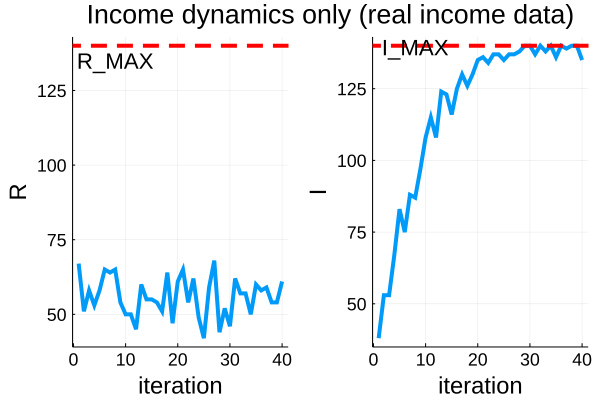

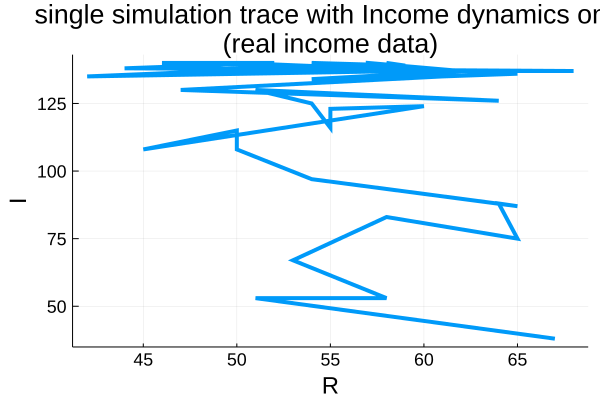

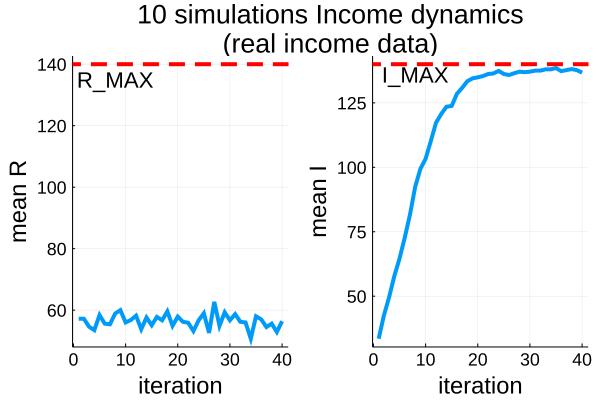

GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT


In [348]:
plt1 = plot(traceR_real_single,linewidth=4,#title="random moves",
    xlabel="iteration",leg=false,ylabel="R",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 135 , text("R_MAX",15))

p2 = plot(traceI_real_single,linewidth=4,#title="random moves",
    xlabel="iteration",
    leg=false,ylabel="I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 139.5 , text("I_MAX",15))

#pboth = plot(plt1,p2)
title = plot(title = "Income dynamics only (real income data)", grid = false,titlefont=TITLEFONTSIZE,
    showaxis = false, bottom_margin = -50Plots.px)
pboth = plot(title, plt1, p2, layout = @layout([A{0.05h}; [B C]]))
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())

#plot the trajectory of the 2D for UNIFORM DATA INCOME
plt = plot(traceR_real_single,traceI_real_single,line=:path,linewidth=4,
    title="single simulation trace with Income dynamics only \n (real income data)",
    xlabel="R",leg=false,ylabel="I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#mean and variance of the no dynamics trajectory REAL INCOME DATA
simulationRvals = zeros(TT,MM)
simulationIvals = zeros(TT,MM)
for mm in 1:MM       
    traceR = zeros(TT)
    traceI = zeros(TT)
    for tt in 1:TT 
        if(tt==1)
            moneyGrid = make_random_finance_grid()  
        else
             #now make the cells 'move' but not change their income
             #moneyGrid =  move_cells_for_wealth_NoDynamics(moneyGrid) 
             #moneyGrid = move_cells_for_SchellingDynamics_NoWealthDynamics(moneyGrid)
             moneyGrid = move_cells_for_wealth_DynamicsOnly(moneyGrid)
        end    
        traceR[tt] = grid_satisfaction(moneyGrid[:,:,1])
        traceI[tt] = financial_grid_deviation(moneyGrid)   
    end
    simulationRvals[:,mm] = traceR[:]
    simulationIvals[:,mm] = traceI[:]
end

meanTraceR = mean(simulationRvals,dims=2)
meanTraceI = mean(simulationIvals,dims=2)

plt1 = plot(meanTraceR,linewidth=4,#title="random moves",
    xlabel="iteration",leg=false,ylabel="mean R",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 135 , text("R_MAX",15))

plt2 = plot(meanTraceI,linewidth=4,#title="random moves",
    xlabel="iteration",
    leg=false,ylabel="mean I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 136 , text("I_MAX",15))

#pboth = plot(plt1,p2)
title = plot(title = "$(MM) simulations Income dynamics \n (real income data)", 
    grid = false,titlefont=TITLEFONTSIZE,
    showaxis = false, bottom_margin = -50Plots.px)
pboth = plot(title, plt1, plt2, layout = @layout([A{0.05h}; [B C]]))
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())

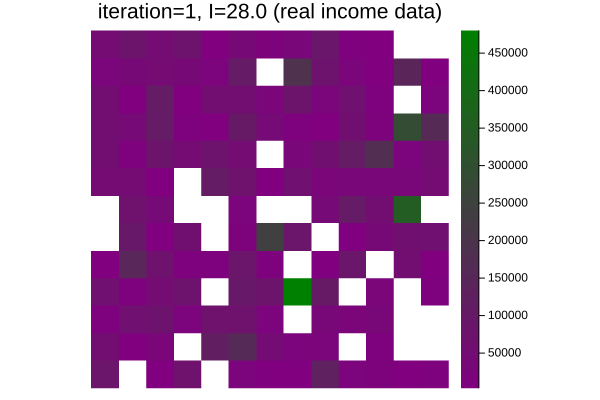

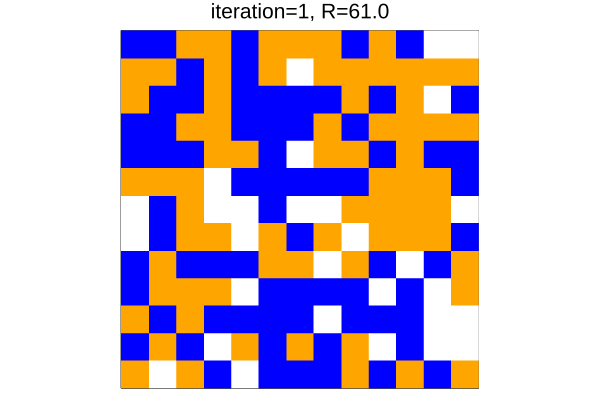

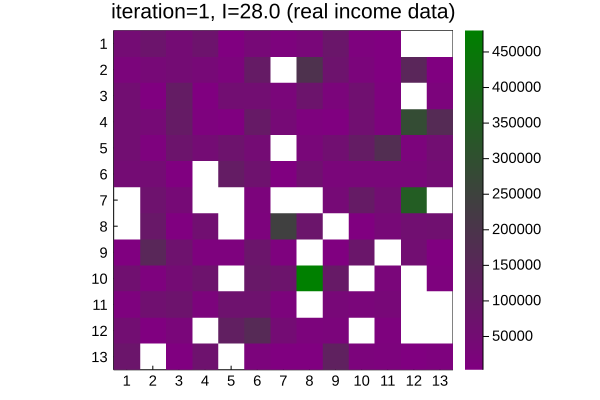

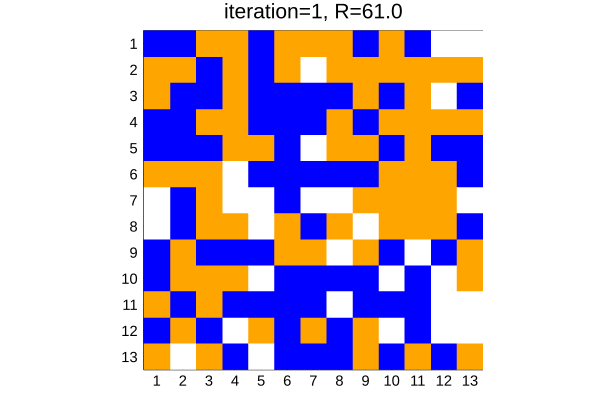

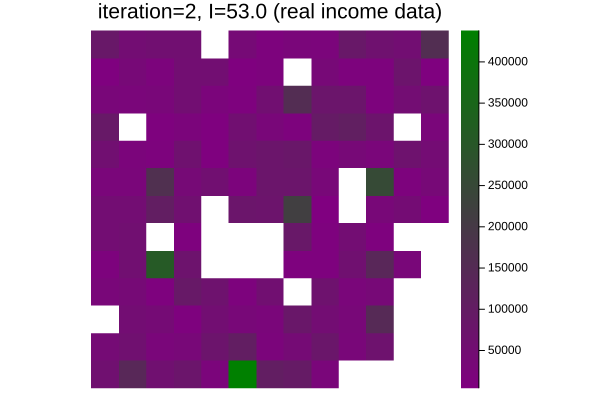

...

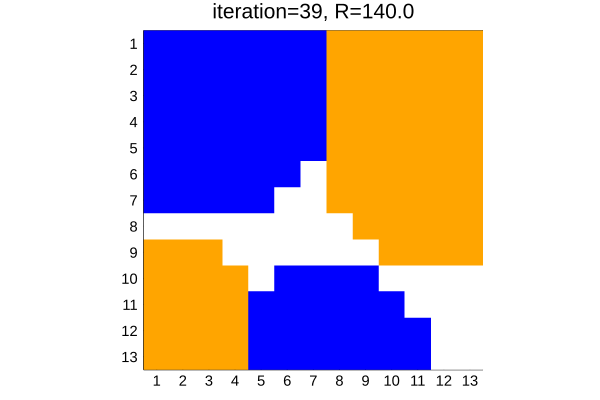

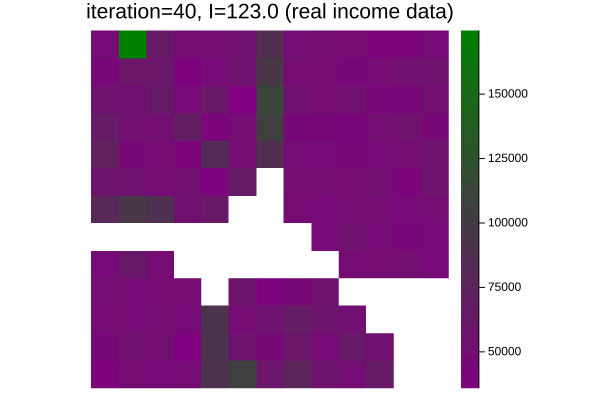

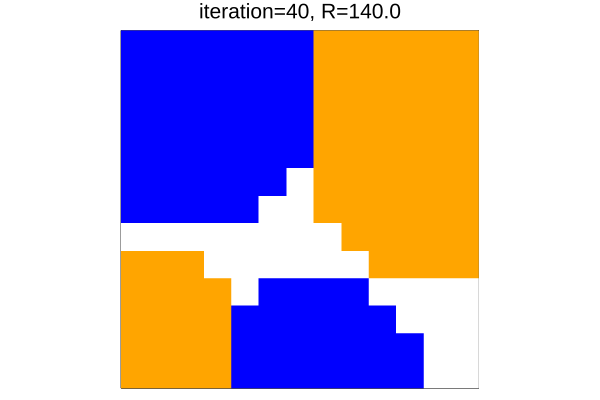

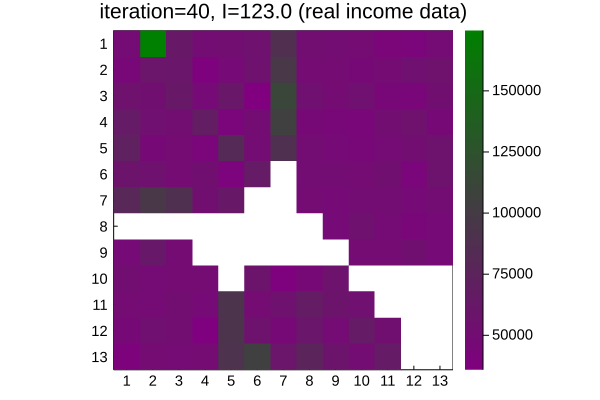

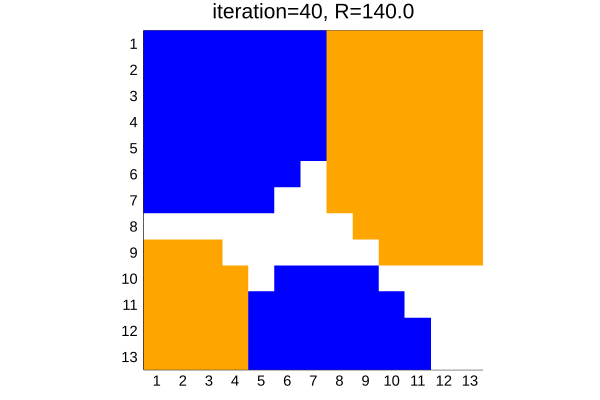

In [349]:
#SCHELLING AND INCOME DYNAMICS
#and track both the macrostates variables 
#REAL INCOME DATA
traceR_real_single = zeros(TT)
traceI_real_single = zeros(TT)
moneyGrid = make_random_finance_grid()  
trace2D = [] #stores the tuples of the trace 2D coordinates
for tt in 1:TT
    if(tt==1)
        #make_random_finance_grid()  
        moneyGrid = make_random_finance_grid()
    else
        #now make the cells 'move' but not change their income
        #moneyGrid =  move_cells_for_wealth_NoDynamics(moneyGrid) 
        #moneyGrid = move_cells_for_SchellingDynamics_NoWealthDynamics(moneyGrid)
        #moneyGrid = move_cells_for_wealth_DynamicsOnly(moneyGrid) 
        moneyGrid = move_cells_for_SchellingDynamics_AND_WealthDynamics(moneyGrid)
    end
    #get the homogeneity satisfaction for the spatial arrangements
    traceR_real_single[tt] = grid_satisfaction(moneyGrid[:,:,1])
    #get the financial component of the grid's homogeneity satisfaction 
    traceI_real_single[tt] = financial_grid_deviation(moneyGrid)
    
    if(tt==1)
        trace2D = (traceR_real_single[tt],traceI_real_single[tt])
    else
        trace2D = vcat(trace2D,[(traceR_real_single[tt],traceI_real_single[tt])])
    end  
    
    gridTmp = deepcopy(moneyGrid[:,:,2])
    inds = findall(gridTmp .== 0)    
    gridTmp[inds] .= NaN #so the values do not affect the scale of the legend
    h = heatmap(gridTmp,
        title="iteration=$(tt), I=$(round(traceI_real_single[tt],digits=2)) (real income data)",
        showaxis=false,xticks=false,yticks=false,yaxis=:flip,aspect_ratio=1.0,
        framestyle=:box,xlims=(0.5,GRID_SIZE+0.5),legend=true,
        c=ColorGradient([:purple,:green]))   
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots7/I_time$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots7/I_time$(tt).pdf"))
    
    h = gridHeatMap(moneyGrid[:,:,1],"iteration=$(tt), R=$(traceR_real_single[tt])",
        false)
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots7/R_time$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots7/R_time$(tt).pdf"))
    
    #now put the x and y ticks on the cell positions for the sake of it
    h = heatmap(gridTmp,
        title="iteration=$(tt), I=$(round(traceI_real_single[tt],digits=2)) (real income data)",
        showaxis=true,xticks=1:GRID_STEP:GRID_SIZE,yticks=1:GRID_STEP:GRID_SIZE,
        yaxis=:flip,aspect_ratio=1.0,xtickfont=10,ytickfont=10,
        framestyle=:box,xlims=(0.5,GRID_SIZE+0.5),legend=true, grid=false,   
        c=ColorGradient([:purple,:green])) 
    
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots7/I_timeB$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots7/I_timeB$(tt).pdf"))
    
    h = gridHeatMap(moneyGrid[:,:,1],"iteration=$(tt), R=$(traceR_real_single[tt])",
        true)
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots7/R_timeB$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots7/R_timeB$(tt).pdf"))
end

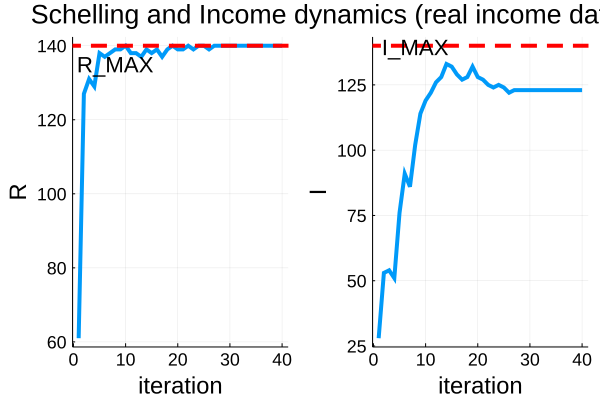

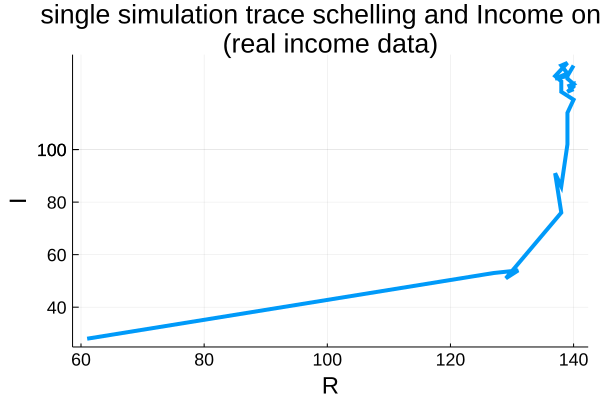

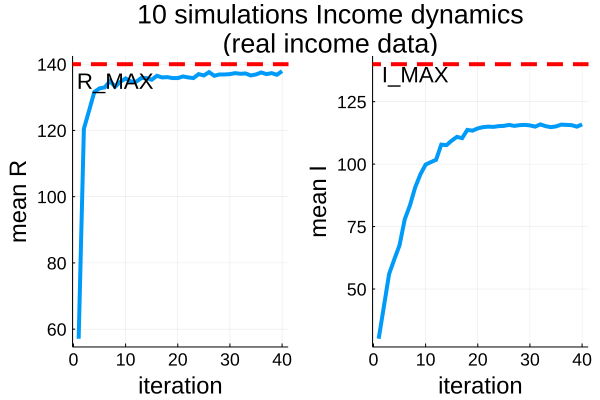

GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT


In [350]:
plt1 = plot(traceR_real_single,linewidth=4,#title="random moves",
    xlabel="iteration",leg=false,ylabel="R",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 135 , text("R_MAX",15))

p2 = plot(traceI_real_single,linewidth=4,#title="random moves",
    xlabel="iteration",
    leg=false,ylabel="I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 139.5 , text("I_MAX",15))

#pboth = plot(plt1,p2)
title = plot(title = "Schelling and Income dynamics (real income data)", grid = false,titlefont=TITLEFONTSIZE,
    showaxis = false, bottom_margin = -50Plots.px)
pboth = plot(title, plt1, p2, layout = @layout([A{0.05h}; [B C]]))
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())

#plot the trajectory of the 2D for UNIFORM DATA INCOME
plt = plot(traceR_real_single,traceI_real_single,line=:path,linewidth=4,
    title="single simulation trace schelling and Income only \n (real income data)",
    xlabel="R",leg=false,ylabel="I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#mean and variance of the no dynamics trajectory REAL INCOME DATA
simulationRvals = zeros(TT,MM)
simulationIvals = zeros(TT,MM)
for mm in 1:MM       
    traceR = zeros(TT)
    traceI = zeros(TT)
    for tt in 1:TT 
        if(tt==1)
            moneyGrid = make_random_finance_grid()  
        else
             #now make the cells 'move' but not change their income
             #moneyGrid =  move_cells_for_wealth_NoDynamics(moneyGrid) 
             #moneyGrid = move_cells_for_SchellingDynamics_NoWealthDynamics(moneyGrid)
             #moneyGrid = move_cells_for_wealth_DynamicsOnly(moneyGrid)
             moneyGrid = move_cells_for_SchellingDynamics_AND_WealthDynamics(moneyGrid)
        end    
        traceR[tt] = grid_satisfaction(moneyGrid[:,:,1])
        traceI[tt] = financial_grid_deviation(moneyGrid)   
    end
    simulationRvals[:,mm] = traceR[:]
    simulationIvals[:,mm] = traceI[:]
end

meanTraceR = mean(simulationRvals,dims=2)
meanTraceI = mean(simulationIvals,dims=2)

plt1 = plot(meanTraceR,linewidth=4,#title="random moves",
    xlabel="iteration",leg=false,ylabel="mean R",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 135 , text("R_MAX",15))

plt2 = plot(meanTraceI,linewidth=4,#title="random moves",
    xlabel="iteration",
    leg=false,ylabel="mean I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 136 , text("I_MAX",15))

#pboth = plot(plt1,p2)
title = plot(title = "$(MM) simulations Income dynamics \n (real income data)", 
    grid = false,titlefont=TITLEFONTSIZE,
    showaxis = false, bottom_margin = -50Plots.px)
pboth = plot(title, plt1, plt2, layout = @layout([A{0.05h}; [B C]]))
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())

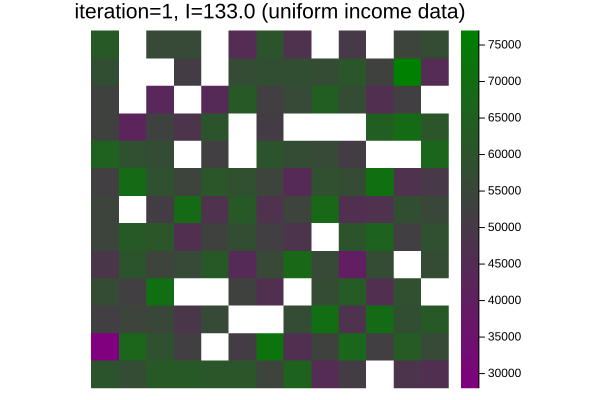

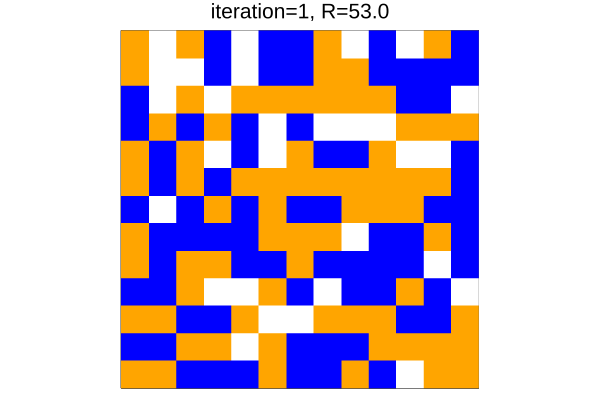

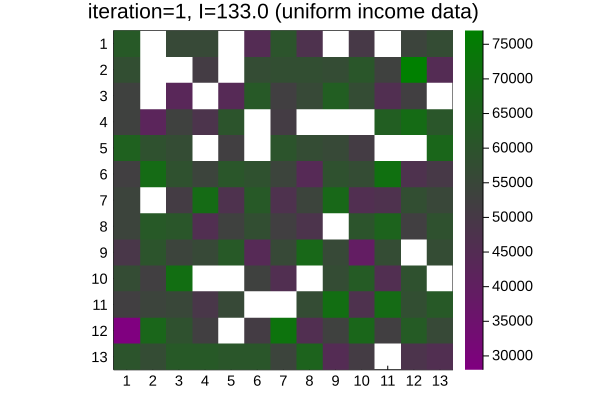

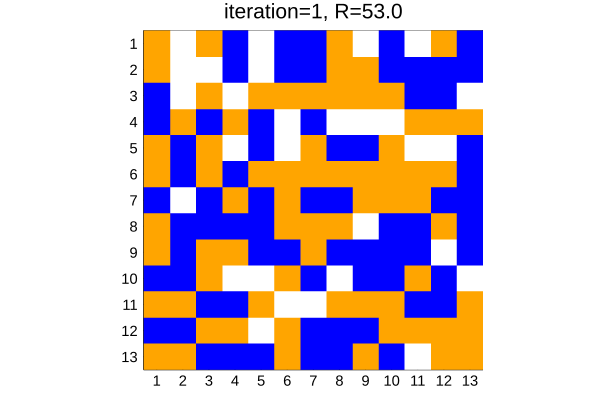

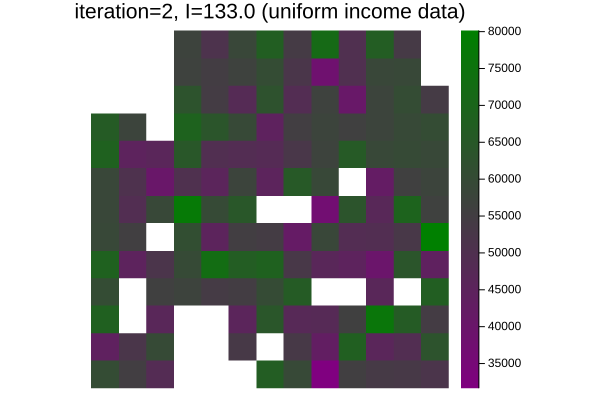

...

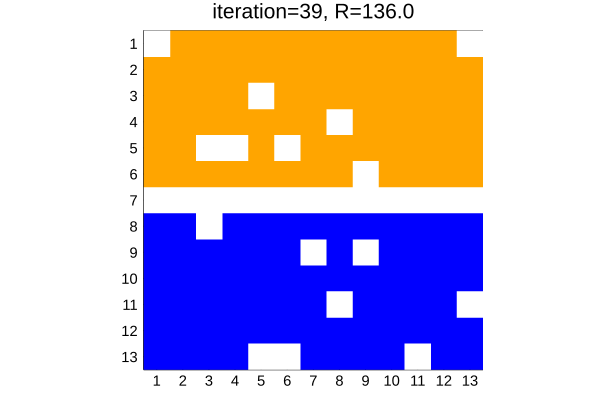

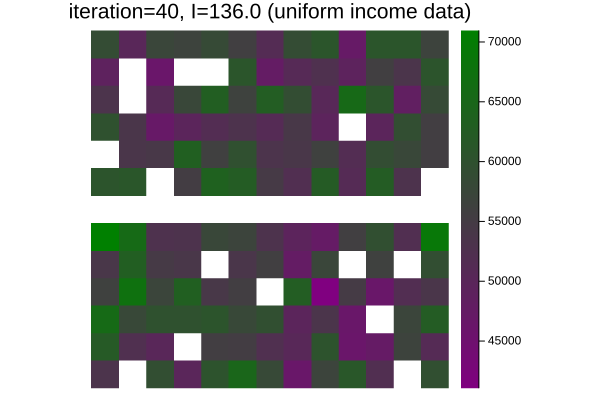

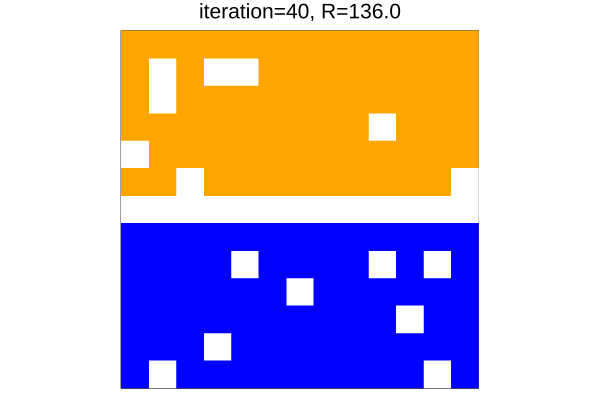

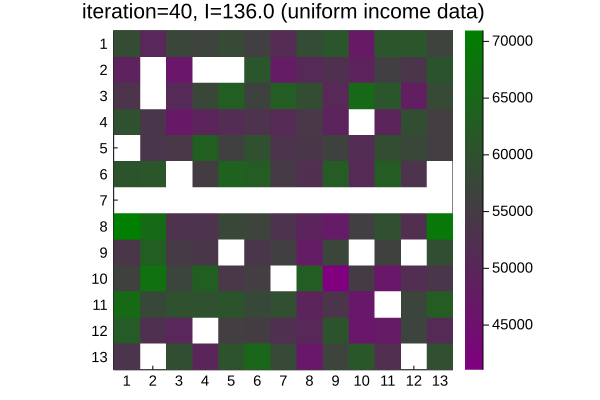

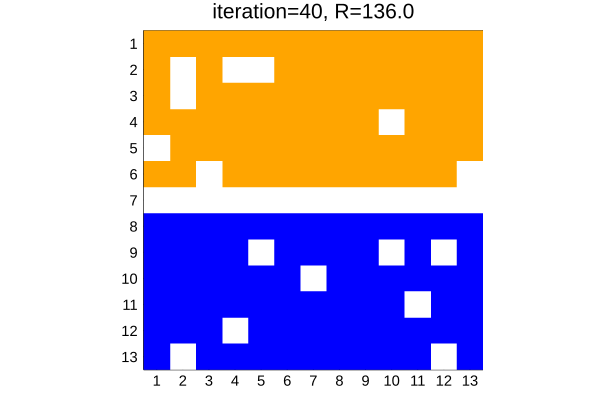

In [351]:
#SCHELLING AND INCOME DYNAMICS
#and track both the macrostates variables 
#UNIFORM INCOME DATA
traceR_uni_single = zeros(TT)
traceI_uni_single = zeros(TT)
moneyGrid = make_uniform_sampled_finance_grid() 
trace2D = [] #stores the tuples of the trace 2D coordinates
for tt in 1:TT
    if(tt==1)
        #make_random_finance_grid()  
        moneyGrid = make_uniform_sampled_finance_grid()  
    else
        #now make the cells 'move' but not change their income
        #moneyGrid =  move_cells_for_wealth_NoDynamics(moneyGrid) 
        #moneyGrid = move_cells_for_SchellingDynamics_NoWealthDynamics(moneyGrid)
        #moneyGrid = move_cells_for_wealth_DynamicsOnly(moneyGrid) 
        moneyGrid = move_cells_for_SchellingDynamics_AND_WealthDynamics(moneyGrid)
    end
    #get the homogeneity satisfaction for the spatial arrangements
    traceR_uni_single[tt] = grid_satisfaction(moneyGrid[:,:,1])
    #get the financial component of the grid's homogeneity satisfaction 
    traceI_uni_single[tt] = financial_grid_deviation(moneyGrid)
    
    if(tt==1)
        trace2D = (traceR_uni_single[tt],traceI_uni_single[tt])
    else
        trace2D = vcat(trace2D,[(traceR_uni_single[tt],traceI_uni_single[tt])])
    end  
    
    gridTmp = deepcopy(moneyGrid[:,:,2])
    inds = findall(gridTmp .== 0)    
    gridTmp[inds] .= NaN #so the values do not affect the scale of the legend
    h = heatmap(gridTmp,
        title="iteration=$(tt), I=$(round(traceI_uni_single[tt],digits=2)) (uniform income data)",
        showaxis=false,xticks=false,yticks=false,yaxis=:flip,aspect_ratio=1.0,
        framestyle=:box,xlims=(0.5,GRID_SIZE+0.5),legend=true,
        c=ColorGradient([:purple,:green]))   
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots8/I_time$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots8/I_time$(tt).pdf"))
    
    h = gridHeatMap(moneyGrid[:,:,1],"iteration=$(tt), R=$(traceR_uni_single[tt])",
        false)
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots8/R_time$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots8/R_time$(tt).pdf"))
    
    #now put the x and y ticks on the cell positions for the sake of it
    h = heatmap(gridTmp,
        title="iteration=$(tt), I=$(round(traceI_uni_single[tt],digits=2)) (uniform income data)",
        showaxis=true,xticks=1:GRID_STEP:GRID_SIZE,yticks=1:GRID_STEP:GRID_SIZE,
        yaxis=:flip,aspect_ratio=1.0,xtickfont=10,ytickfont=10,
        framestyle=:box,xlims=(0.5,GRID_SIZE+0.5),legend=true, grid=false,   
        c=ColorGradient([:purple,:green])) 
    
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots8/I_timeB$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots8/I_timeB$(tt).pdf"))
    
    h = gridHeatMap(moneyGrid[:,:,1],"iteration=$(tt), R=$(traceR_uni_single[tt])",
        true)
    display(h)    
    savefig(h,string(PLOT_DIR,"/simulationSnapShots8/R_timeB$(tt).png"))
    savefig(h,string(PLOT_DIR,"/simulationSnapShots8/R_timeB$(tt).pdf"))
end



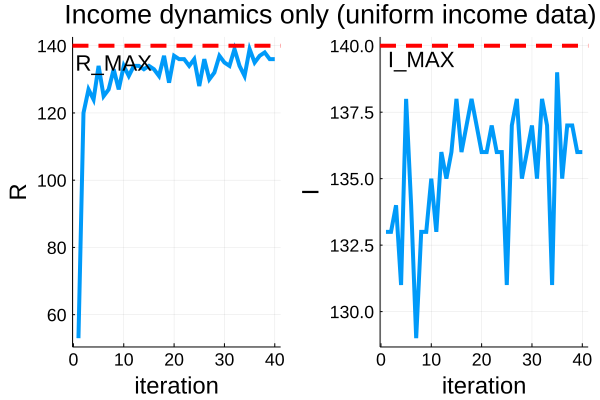

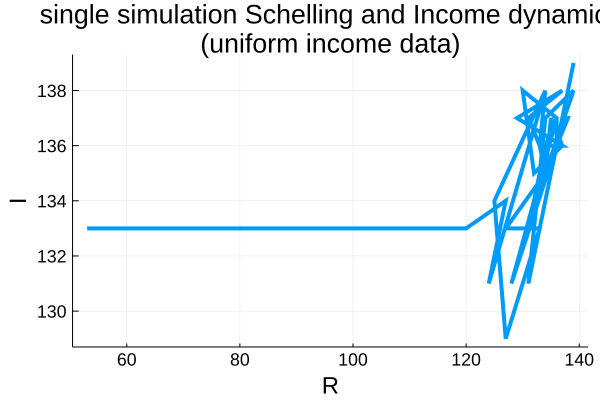

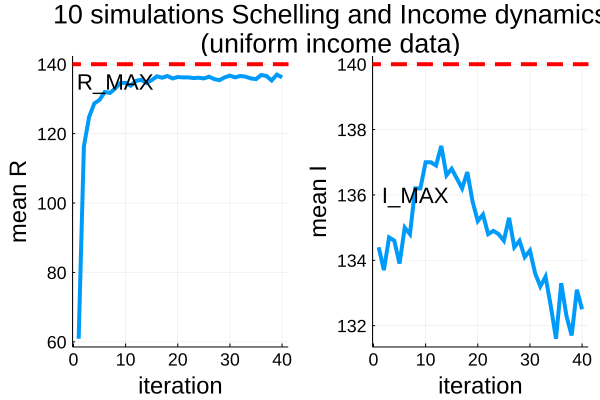

GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT


In [352]:
plt1 = plot(traceR_uni_single,linewidth=4,#title="random moves",
    xlabel="iteration",leg=false,ylabel="R",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 135 , text("R_MAX",15))

p2 = plot(traceI_uni_single,linewidth=4,#title="random moves",
    xlabel="iteration",
    leg=false,ylabel="I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 139.5 , text("I_MAX",15))

#pboth = plot(plt1,p2)
title = plot(title = "Income dynamics only (uniform income data)", grid = false,titlefont=TITLEFONTSIZE,
    showaxis = false, bottom_margin = -50Plots.px)
pboth = plot(title, plt1, p2, layout = @layout([A{0.05h}; [B C]]))
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())

#plot the trajectory of the 2D for UNIFORM DATA INCOME
plt = plot(traceR_uni_single,traceI_uni_single,line=:path,linewidth=4,
    title="single simulation Schelling and Income dynamics  \n (uniform income data)",
    xlabel="R",leg=false,ylabel="I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#mean and variance of the no dynamics trajectory REAL INCOME DATA
simulationRvals = zeros(TT,MM)
simulationIvals = zeros(TT,MM)
for mm in 1:MM       
    traceR = zeros(TT)
    traceI = zeros(TT)
    for tt in 1:TT 
        if(tt==1)
            moneyGrid = make_uniform_sampled_finance_grid()  
        else
             #now make the cells 'move' but not change their income
             #moneyGrid =  move_cells_for_wealth_NoDynamics(moneyGrid) 
             #moneyGrid = move_cells_for_SchellingDynamics_NoWealthDynamics(moneyGrid)
             #moneyGrid = move_cells_for_wealth_DynamicsOnly(moneyGrid)
             moneyGrid = move_cells_for_SchellingDynamics_AND_WealthDynamics(moneyGrid)
        end    
        traceR[tt] = grid_satisfaction(moneyGrid[:,:,1])
        traceI[tt] = financial_grid_deviation(moneyGrid)   
    end
    simulationRvals[:,mm] = traceR[:]
    simulationIvals[:,mm] = traceI[:]
end

meanTraceR = mean(simulationRvals,dims=2)
meanTraceI = mean(simulationIvals,dims=2)

plt1 = plot(meanTraceR,linewidth=4,#title="random moves",
    xlabel="iteration",leg=false,ylabel="mean R",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 135 , text("R_MAX",15))

plt2 = plot(meanTraceI,linewidth=4,#title="random moves",
    xlabel="iteration",
    leg=false,ylabel="mean I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
annotate!(8, 136 , text("I_MAX",15))

#pboth = plot(plt1,p2)
title = plot(title = "$(MM) simulations Schelling and Income dynamics \n (uniform income data)", 
    grid = false,titlefont=TITLEFONTSIZE,
    showaxis = false, bottom_margin = -50Plots.px)
pboth = plot(title, plt1, plt2, layout = @layout([A{0.05h}; [B C]]))
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())



In [353]:
###################
#NOW THE 2D MODEL!!
###################

In [354]:
#2D SAMPLE FROM THE GENERATOR TO PRODUCE THE DISTRIBUTION FOR NO DYNAMICS 
#FROM UNIFORM DATA
#finding the DENSITY OF THE MACROSTATES
UNIFORM_SAMPLE_NUM_2D
traceR_2d = []
traceI_2d = []
counts_2D_init_uniform = ones(R_MAX,R_MAX)

for tt in 1:UNIFORM_SAMPLE_NUM_2D            
    moneyGrid = make_uniform_sampled_finance_grid()      
    append!(traceR_2d, Int(grid_satisfaction(moneyGrid[:,:,1])) )
    append!(traceI_2d, Int(round(financial_grid_deviation(moneyGrid))))    
    counts_2D_init_uniform[traceI_2d[end],traceR_2d[end]] += 1    
end
traceI_2d = Int.(traceI_2d)
traceR_2d = Int.(traceR_2d);
println(sum(counts_2D_init_uniform))
counts_2D_init_uniformNorm = counts_2D_init_uniform ./ sum(counts_2D_init_uniform);

19700.0


In [355]:
sum(counts_2D_init_uniformNorm)

1.0000000000000009

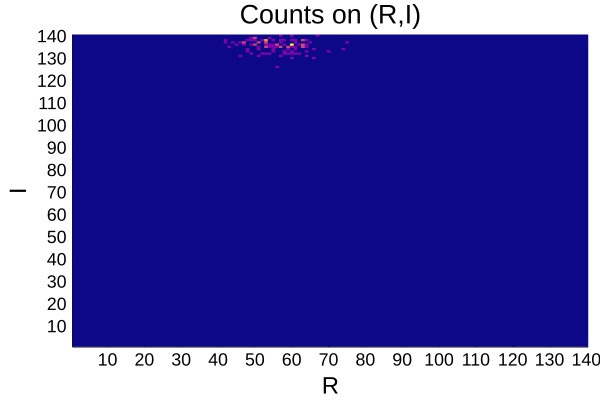

In [356]:
incomeTicks = string.(collect(10:10:size(counts_2D_init_uniform)[1]))
h = heatmap(counts_2D_init_uniform,
    title="Counts on (R,I)",
        showaxis=true,
        xlabel="R",ylabel="I",fc=:plasma,
        xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,
        titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE,
        xticks=10:10:R_MAX,leg=false,
        yticks=10:10:R_MAX)
display(h)  
savefig(h,newFigNameString())
savefig(h,newFigNameString_PDF())

#yticks=(yt,yt2 .* "!"),#(collect(minimum(traceI) : 10000 : maximum(traceI))),

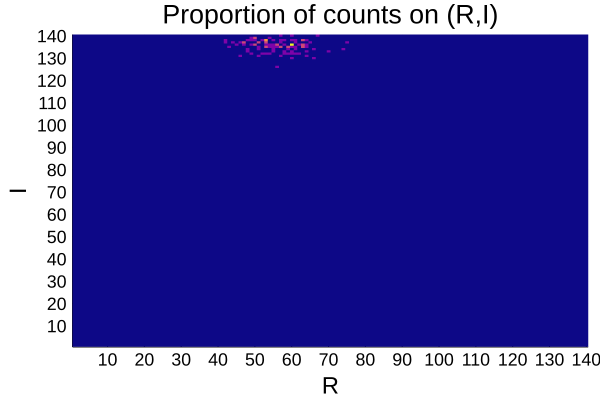

1.0000000000000009


In [357]:
println(sum(counts_2D_init_uniformNorm))
h = heatmap(counts_2D_init_uniformNorm,
    title="Proportion of counts on (R,I)",
        showaxis=true,#    yticks=(yt,yt2 .* "!"),#(collect(minimum(traceI) : 10000 : maximum(traceI))),
        xlabel="R",ylabel="I",fc=:plasma,#xlims=(0.5,xrange+0.5),
        xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE,
        xticks=10:10:R_MAX,leg=false,
        yticks=((10:10:size(counts_2D_init_uniform)[1]),incomeTicks))
display(h)  
savefig(h,newFigNameString())
savefig(h,newFigNameString_PDF())

In [358]:
CELLS_SPACE_SIZE_2D == -1

false

In [359]:
#################
#DENSITY 2D OMEGA from the proportions on the positions and the total count size
sampleOmega_I_R = BigFloat.( BigFloat.(counts_2D_init_uniformNorm) .* 
                                     BigFloat.(CELLS_SPACE_SIZE_2D) );

println( (maximum(sampleOmega_I_R) == minimum(sampleOmega_I_R)))

false


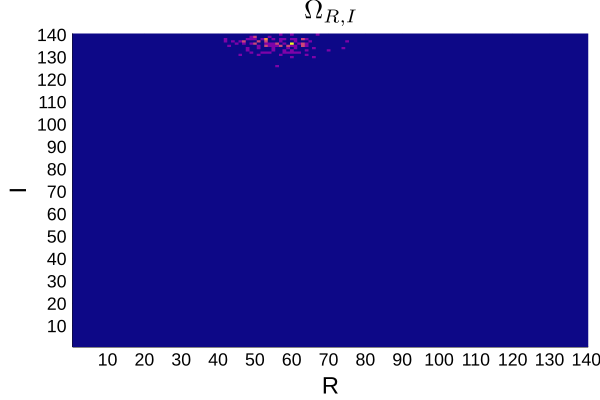

In [360]:
#plot the OMEGA DENSITY ACROSS THE MACROSTATES
h = heatmap(sampleOmega_I_R,
    title=L"\Omega_{R,I}",
        showaxis=true,#    yticks=(yt,yt2 .* "!"),#(collect(minimum(traceI) : 10000 : maximum(traceI))),
        xlabel="R",ylabel="I",fc=:plasma,#xlims=(0.5,xrange+0.5),
        xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE,
        xticks=10:10:R_MAX,leg=false,
        yticks=((10:10:size(counts_2D_init_uniform)[1]),incomeTicks))
display(h)  
savefig(h,newFigNameString())
savefig(h,newFigNameString_PDF())

In [361]:
##################################################################
#ENTROPY VALUES ACROSS THE 2D SPACE FROM THE DENSITIES IN OMEGA!!!
##################################################################

In [362]:
#return the entropy value for the 2D spatial arrangement 
#that has I and R as the macrostate indices
function S_entropy_values_from_IandR(I,R)
    return BigFloat( BigFloat(K_B) * BigFloat(log(sampleOmega_I_R[I,R])) )
end

S_entropy_values_from_IandR (generic function with 1 method)

In [363]:
entropyVals_I_R = BigFloat.(zeros(size(sampleOmega_I_R)[1],size(sampleOmega_I_R)[2]))

for i in 1:size(sampleOmega_I_R)[1]
    for r in 1:size(sampleOmega_I_R)[2]        
        entropyVals_I_R[i,r] = S_entropy_values_from_IandR(i,r)
    end
end

println( (maximum(entropyVals_I_R) == minimum(entropyVals_I_R)))

false


In [364]:
#helper function for the contour plot production
entropyLookUp(R,I) = entropyVals_I_R[I,R]

entropyLookUp (generic function with 1 method)

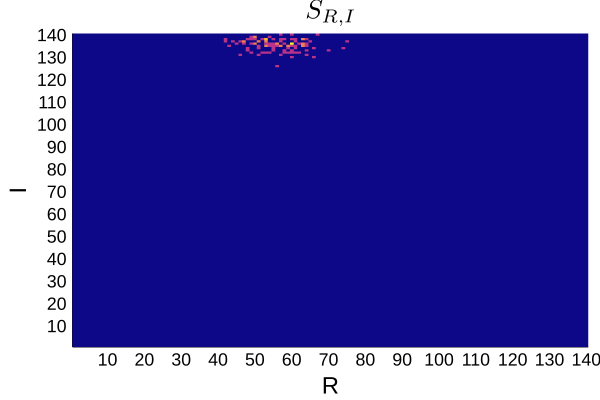

In [365]:
#plot the ENTROPY VALUES for the coordinates (R,I) and cover the heatmap
h = heatmap(entropyVals_I_R,
    title=L"S_{R,I}",
        showaxis=true,#    yticks=(yt,yt2 .* "!"),#(collect(minimum(traceI) : 10000 : maximum(traceI))),
        xlabel="R",ylabel="I",fc=:plasma,#xlims=(0.5,xrange+0.5),
        xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE,
        xticks=10:10:R_MAX,leg=false,
        yticks=((10:10:size(counts_2D_init_uniform)[1]),incomeTicks))
display(h)  
savefig(h,newFigNameString())
savefig(h,newFigNameString_PDF())

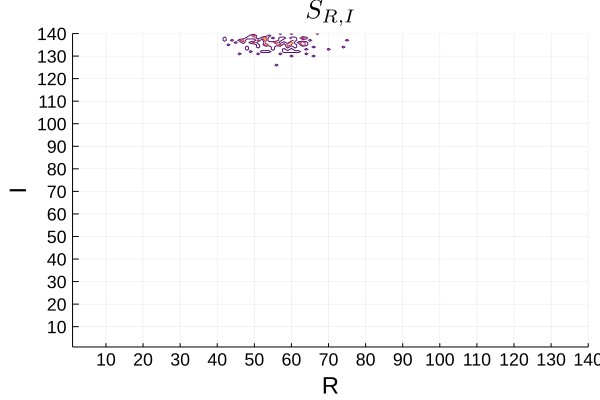

In [366]:
#Uniform income data distribution sample entropy contour plot
xx=collect(1:R_MAX)
yy=collect(1:R_MAX)
plt = contour(xx,yy,entropyLookUp(xx,yy),levels=3,title=L"S_{R,I}",
    xlabel="R",ylabel="I",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE,leg=false,
    xticks=10:10:R_MAX,
    yticks=(10:10:size(entropyVals_I_R)[1],incomeTicks))
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

In [367]:
function plot_R_I_independentTraces(traceR,traceI;annRx=8,annIx=8,annRy=135,
                    annIy=139,title="Random movements (uniform income data)")
    
    plt1 = plot(traceR,linewidth=3,#title="random moves",
    xlabel="iteration",leg=false,ylabel="R",
    xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
    guidefont=GUIDEFONTSIZE)
    hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
    annotate!(annRx, annRy, text("R_MAX",15))

    p2 = plot(traceI,linewidth=3,#title="random moves",
        xlabel="iteration",
        leg=false,ylabel="I",
        xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,titlefont=TITLEFONTSIZE,
        guidefont=GUIDEFONTSIZE)
    hline!([R_MAX],line=(4,:dash),leg=false,color=:red)
    annotate!(annIx, annIy, text("I_MAX",15))

    #pboth = plot(plt1,p2)
    title = plot(title=title, grid = false,titlefont=TITLEFONTSIZE,
        showaxis = false, bottom_margin = -50Plots.px)
    pboth = plot(title, plt1, p2, layout = @layout([A{0.05h}; [B C]]))
    return pboth
end

plot_R_I_independentTraces (generic function with 1 method)

In [368]:
function plotTrace_R_I_oncontour(traceR,traceI;
    title="Single simulation on entropy contours \n (uniform income allocation)")
    cc = get_color_palette(:auto, plot_color(:white), 17)[1]   
    xx=collect(1:R_MAX)
    yy=collect(1:R_MAX)
    plt = contour(xx,yy,entropyLookUp(xx,yy),levels=3,
        title=title,
        xlabel="R",ylabel="I",xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,
        titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE,leg=false,
        xticks=10:10:R_MAX, yticks=10:10:R_MAX)
    plot!(traceR,traceI,line=:path,linewidth=2,color=cc)
    scatter!([traceR[1]],[traceI[1]], color=cc,markersize = 10)
    return plt
end

plotTrace_R_I_oncontour (generic function with 1 method)

In [369]:
function plotTrace_R_I_oncontour_multi(traceR,traceI;
    title="Multiple simulations traces over entropy contours \n (uniform income allocation)")
    cc = get_color_palette(:auto, plot_color(:white), 17)[1]   
    xx=collect(1:R_MAX)
    yy=collect(1:R_MAX)
    plt = contour(xx,yy,entropyLookUp(xx,yy),levels=3,
        title=title,
        xlabel="R",ylabel="I",xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,
        titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE,leg=false,
        xticks=10:10:R_MAX, yticks=10:10:R_MAX)
    for col in 1:size(traceR)[2]
        plot!(traceR[:,col],traceI[:,col],line=:path,linewidth=2,color=cc)
        scatter!([traceR[1,col]],[traceI[1,col]],
            color=cc,markersize = 10)
    end
    return plt
end

plotTrace_R_I_oncontour_multi (generic function with 1 method)

In [413]:
#find the entropy of a trace given the datastructure visualized in the heatmap 
#entropyVals_I_R is the data structure for the 2D look up
function traceEntropyFrom2D_sim(traceR,traceI)
    traceI = Int.(traceI)
    traceR = Int.(traceR)
    #entropy_trace_uni_single = [entropyVals_I_R[traceI_uni_single_inds[x],traceR_uni_single_inds[x]] for x in 1:length(traceR_uni_single_inds)]
    tempVals = zeros(length(traceR))
    for row in 1:length(traceR)
        tempVals[row] = entropyVals_I_R[Int(traceI[row]),
                                     Int(traceR[row])]    
    end
    #scale = 10e16
    entropy_trace_scaled = scale .* tempVals 
    #println( entropy_trace_scaled )
    plt = plot(entropy_trace_scaled,linewidth=4,xlabel="iteration",#title="single simulation random movements \n (scaled by $(scale))",
        leg=false,ylabel=L"S_{RI}",#ylim=[round.(minimum(entropy_trace_scaled))-2,round.(maximum(entropy_trace_scaled))+2],
        xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,
        titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
    #yticks=([minimum(entropy_trace_uni_single_min_sub),maximum(entropy_trace_uni_single_min_sub)],[eLabels[1],eLabels[2]]) )
    
end

traceEntropyFrom2D_sim (generic function with 1 method)

In [371]:
#find the entropy of a trace given the datastructure visualized in the heatmap 
#entropyVals_I_R is the data structure for the 2D look up
function traceEntropyFrom2D_simMultiple(tracesR,tracesI)
    tracesI = Int.(tracesI)
    tracesR = Int.(tracesR)
    #entropy_trace_uni_single = [entropyVals_I_R[traceI_uni_single_inds[x],traceR_uni_single_inds[x]] for x in 1:length(traceR_uni_single_inds)]
    entropySimVals = zeros(size(tracesR)[1],size(tracesR)[2])
    
    for col in 1:size(tracesR)[2]
        for row in 1:size(tracesR)[1]
            entropySimVals[row,col] = entropyVals_I_R[Int(tracesI[row,col]),
                                         Int(tracesR[row,col])]    
        end
    end
    #scale = 10e16
    entropy_traces_scaled = scale .* entropySimVals 
    #println( entropy_trace_scaled )
    plt = plot(entropy_traces_scaled,linewidth=4,xlabel="iteration",
        title="Multiple simulations with random movements \n (scaled by $(scale))",
        leg=false,ylabel=L"S_{RI}",#ylim=[round.(minimum(entropy_traces_scaled))-2,round.(maximum(entropy_traces_scaled))+2],
        xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,
        titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
    #yticks=([minimum(entropy_trace_uni_single_min_sub),maximum(entropy_trace_uni_single_min_sub)],[eLabels[1],eLabels[2]]) )
    #plot!(plt,minimum(entropy_traces_scaled,dims=2))
    return plt
end

traceEntropyFrom2D_simMultiple (generic function with 1 method)

In [372]:
#find the entropy of a trace given the datastructure visualized in the heatmap 
#entropyVals_I_R is the data structure for the 2D look up
function traceEntropyFrom2D_simMultiple_UsesTheMean(tracesR,tracesI)
    tracesI = Int.(round.(mean(tracesI,dims=2)))
    tracesR = Int.(round.(mean(tracesR,dims=2)))
    entropySimVals = [entropyVals_I_R[tracesI[x],tracesR[x]] for x in 1:length(tracesR)]
    #entropySimVals = zeros(size(tracesR)[1])
    
    #for row in 1:size(tracesR)[1]
    #    entropySimVals[row] = entropyLookUp(Int(tracesI[row]),
    #                                 Int(tracesR[row]))    
    #end    
    #scale = 10e16
    entropy_traces_scaled = scale .* entropySimVals 
    plt = plot(entropy_traces_scaled,linewidth=4,xlabel="iteration",
        title="Mean of simulations with random movements \n (scaled by $(scale))",
        leg=false,ylabel=L"S_{RI}",#ylim=[round.(minimum(entropy_traces_scaled))-0,round.(maximum(entropy_traces_scaled))+0],
        xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,
        titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
    #yticks=([minimum(entropy_trace_uni_single_min_sub),maximum(entropy_trace_uni_single_min_sub)],[eLabels[1],eLabels[2]]) )
    return plt
end

traceEntropyFrom2D_simMultiple_UsesTheMean (generic function with 1 method)

In [373]:
#find the entropy of a trace given the datastructure visualized in the heatmap 
#entropyVals_I_R is the data structure for the 2D look up
function traceEntropyFrom2D_simMultipleMaxMin(tracesR,tracesI)
    tracesI = Int.(tracesI)
    tracesR = Int.(tracesR)
    #entropy_trace_uni_single = [entropyVals_I_R[traceI_uni_single_inds[x],traceR_uni_single_inds[x]] for x in 1:length(traceR_uni_single_inds)]
    entropySimVals = zeros(size(tracesR)[1],size(tracesR)[2])
    
    for col in 1:size(tracesR)[2]
        for row in 1:size(tracesR)[1]
            entropySimVals[row,col] = entropyVals_I_R[Int(tracesI[row,col]),
                                         Int(tracesR[row,col])]    
        end
    end
    #scale = 10e16
    entropy_traces_scaled = scale .* entropySimVals 
    #println( entropy_trace_scaled )
    plt = plot([maximum(entropy_traces_scaled,dims=2) minimum(entropy_traces_scaled,dims=2)],
            linewidth=4,xlabel="iteration",
        title="Max and Min of simulations with random movements \n (scaled by $(scale))",
        leg=false,ylabel=L"S_{RI}",#ylim=[round.(minimum(entropy_traces_scaled))-2,round.(maximum(entropy_traces_scaled))+2],
        xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,
        titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE)
    #yticks=([minimum(entropy_trace_uni_single_min_sub),maximum(entropy_trace_uni_single_min_sub)],[eLabels[1],eLabels[2]]) )
    #plot!(plt,minimum(entropy_traces_scaled,dims=2))
    return plt
end

traceEntropyFrom2D_simMultipleMaxMin (generic function with 1 method)

In [374]:
##################################################################
#NOW THE 2D SIMULATIONS USING THE ENTROPY VALUES TO GET A TRACE!!!
##################################################################

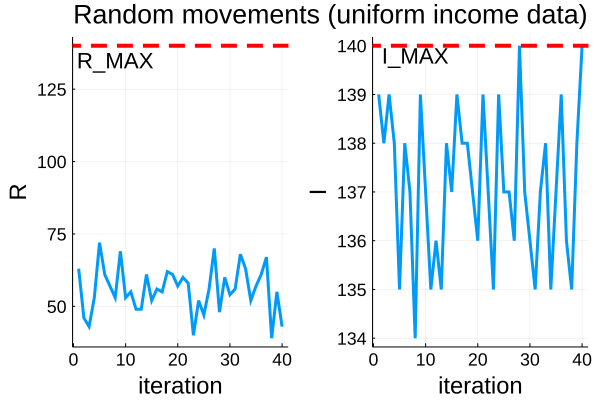

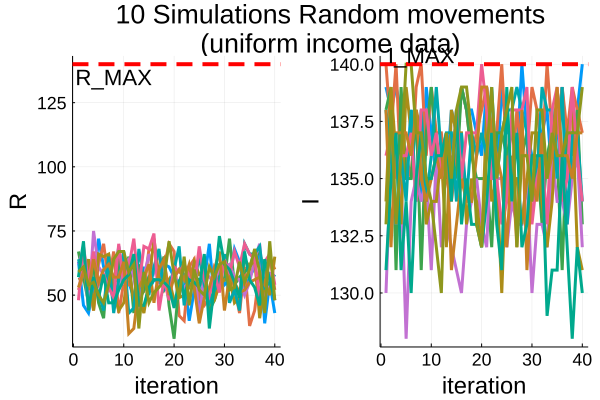

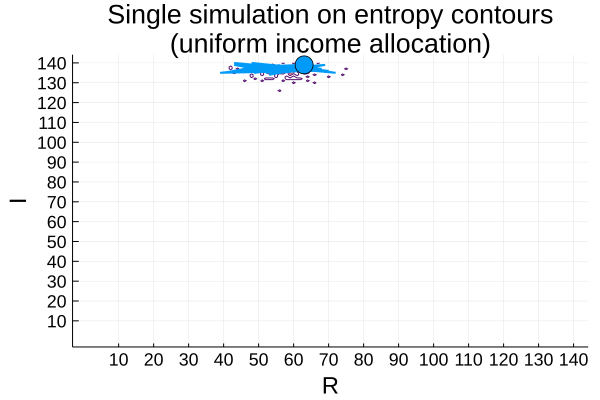

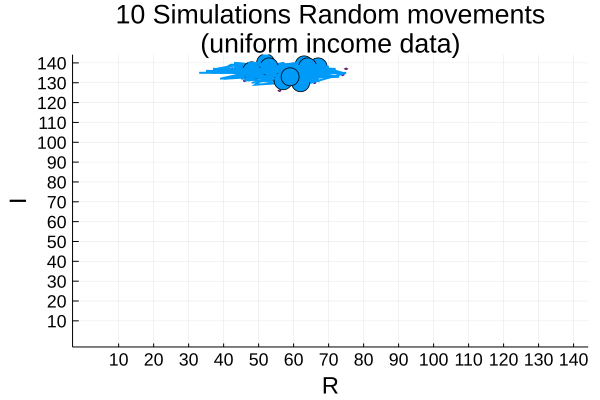

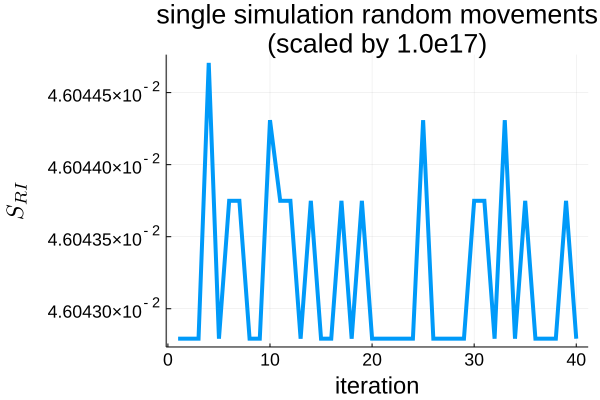

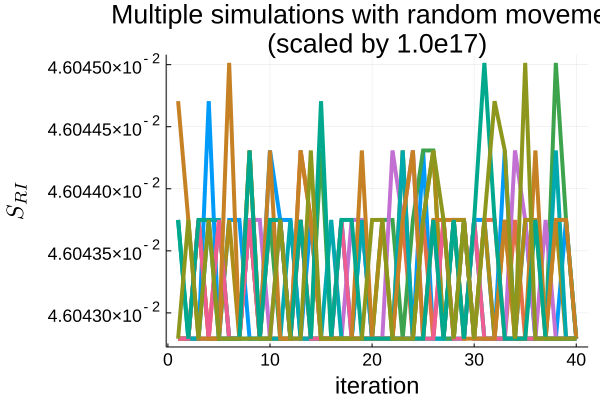

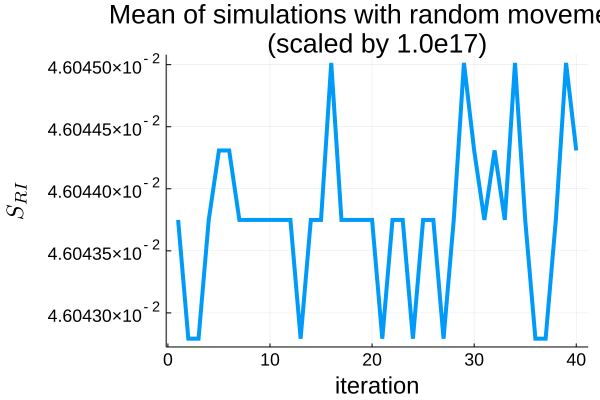

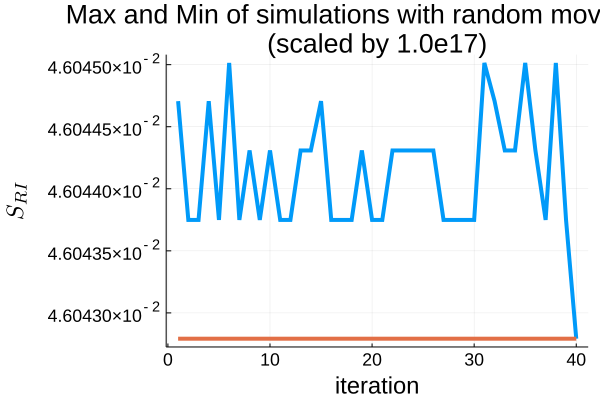

GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT


In [375]:
#UNIFORM DATA
#Plots.jl displays in 'plot', the columns as the separate lines (by default)
#so if there are 25 different simulation of 15 samples each, the rows must be 15 and 
#25 for the column number
simulationRvals_uniform_multi = zeros(TT,MM)
simulationIvals_uniform_multi = zeros(TT,MM)
for mm in 1:MM       
    traceR = zeros(TT)
    traceI = zeros(TT)
    for tt in 1:TT 
        if(tt==1)
            moneyGrid = make_uniform_sampled_finance_grid()  
        else
            moneyGrid =  move_cells_for_wealth_NoDynamics(moneyGrid) #make_random_finance_grid()  
        end    
        traceR[tt] = grid_satisfaction(moneyGrid[:,:,1])
        traceI[tt] = financial_grid_deviation(moneyGrid)   
    end
    simulationRvals_uniform_multi[:,mm] = traceR[:]
    simulationIvals_uniform_multi[:,mm] = traceI[:]
end
   
#plot a single example trace
traceR_uni_single = simulationRvals_uniform_multi[:,1]
traceI_uni_single = simulationIvals_uniform_multi[:,1]
pboth = plot_R_I_independentTraces(traceR_uni_single,traceI_uni_single;annIy=139.8)
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())
#plot the multiple example traces
pboth = plot_R_I_independentTraces(simulationRvals_uniform_multi,
                                      simulationIvals_uniform_multi;annIy=140.40,
                title="$(MM) Simulations Random movements \n (uniform income data)")
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())

plt = plotTrace_R_I_oncontour(traceR_uni_single,traceI_uni_single)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

plt = plotTrace_R_I_oncontour_multi(simulationRvals_uniform_multi,
                                simulationIvals_uniform_multi,
                title="$(MM) Simulations Random movements \n (uniform income data)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE SINGLE SIMULATION
plt = traceEntropyFrom2D_sim(traceR_uni_single,traceI_uni_single)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultiple(simulationRvals_uniform_multi,
    simulationIvals_uniform_multi)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE MEAN OF MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultiple_UsesTheMean(simulationRvals_uniform_multi,
    simulationIvals_uniform_multi)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE MEAN OF MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultipleMaxMin(simulationRvals_uniform_multi,
    simulationIvals_uniform_multi)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


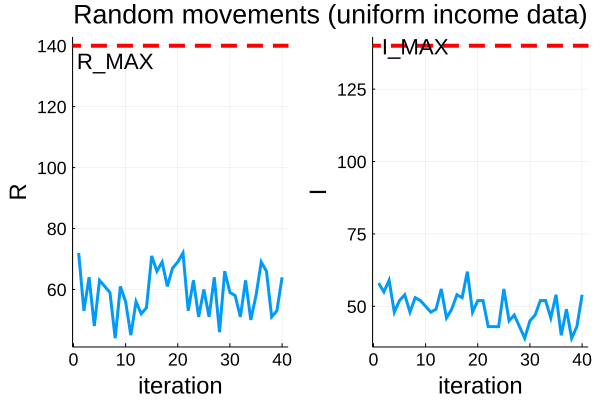

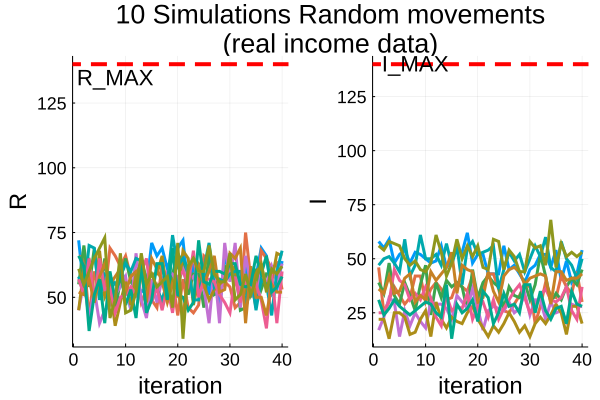

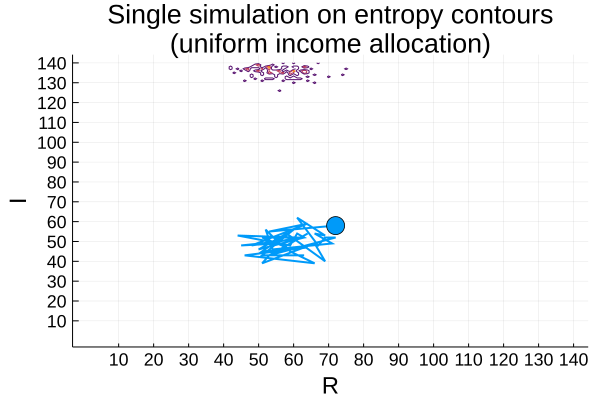

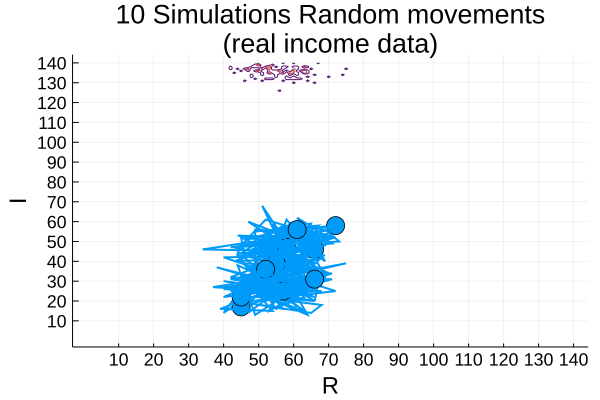

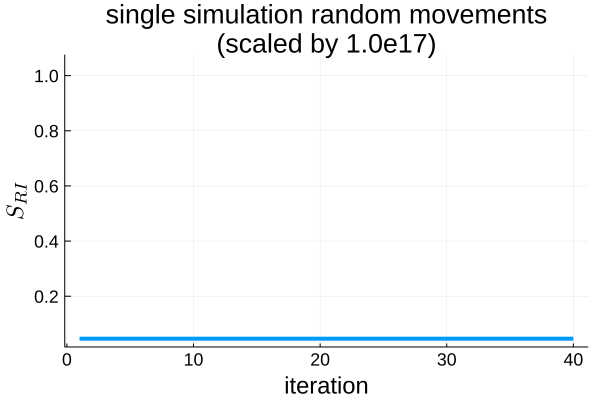

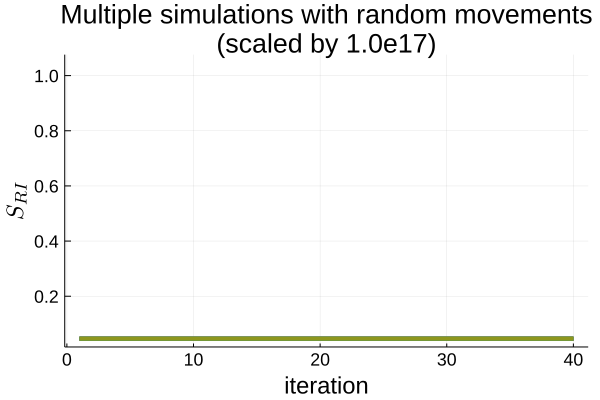

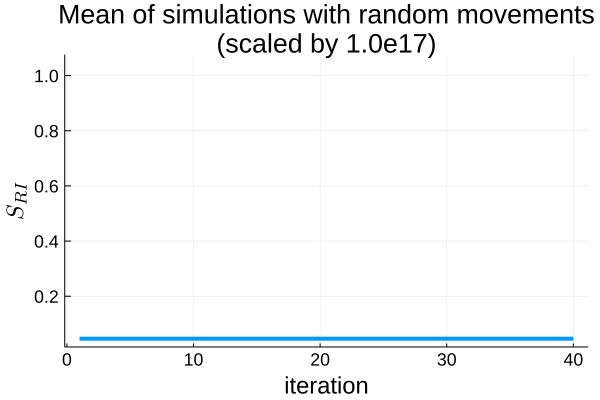

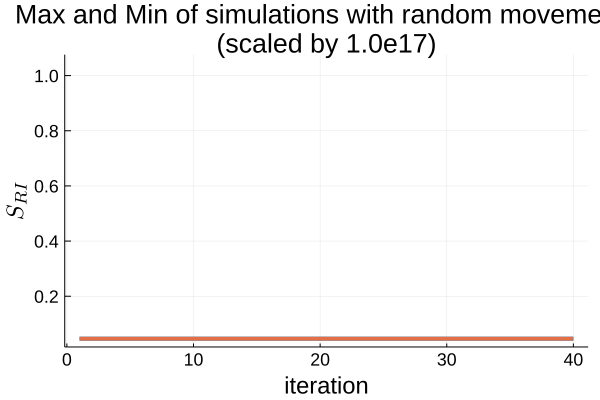

GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT


In [376]:
#INCOME DATA
#Plots.jl displays in 'plot', the columns as the separate lines (by default)
#so if there are 25 different simulation of 15 samples each, the rows must be 15 and 
#25 for the column number
simulationRvals_income_multi = zeros(TT,MM)
simulationIvals_income_multi = zeros(TT,MM)
for mm in 1:MM       
    traceR = zeros(TT)
    traceI = zeros(TT)
    for tt in 1:TT 
        if(tt==1)             
            moneyGrid = make_random_finance_grid()
        else
            moneyGrid =  move_cells_for_wealth_NoDynamics(moneyGrid) #make_random_finance_grid()  
        end    
        traceR[tt] = grid_satisfaction(moneyGrid[:,:,1])
        traceI[tt] = financial_grid_deviation(moneyGrid)   
    end
    simulationRvals_income_multi[:,mm] = traceR[:]
    simulationIvals_income_multi[:,mm] = traceI[:]
end
   
#plot a single example trace
traceR_income_single = simulationRvals_income_multi[:,1]
traceI_income_single = simulationIvals_income_multi[:,1]
pboth = plot_R_I_independentTraces(traceR_income_single,traceI_income_single;annIy=139.8)
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())
#plot the multiple example traces
pboth = plot_R_I_independentTraces(simulationRvals_income_multi,
                                      simulationIvals_income_multi;annIy=140.40,
                title="$(MM) Simulations Random movements \n (real income data)")
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())

plt = plotTrace_R_I_oncontour(traceR_income_single,traceI_income_single)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

plt = plotTrace_R_I_oncontour_multi(simulationRvals_income_multi,
                                simulationIvals_income_multi,
                title="$(MM) Simulations Random movements \n (real income data)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE SINGLE SIMULATION
plt = traceEntropyFrom2D_sim(traceR_income_single,traceI_income_single)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultiple(simulationRvals_income_multi,
    simulationIvals_income_multi)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE MEAN OF MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultiple_UsesTheMean(simulationRvals_income_multi,
    simulationIvals_income_multi)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())



#ENTROPY TRACE OF THE MEAN OF MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultipleMaxMin(simulationRvals_income_multi,
    simulationIvals_income_multi)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


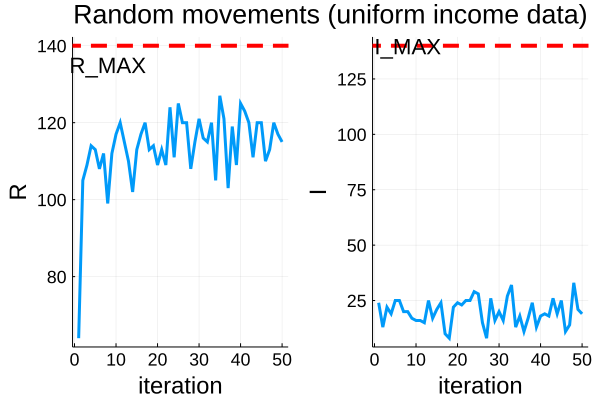

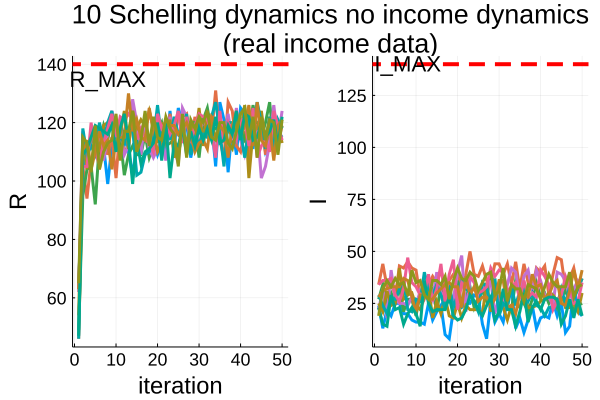

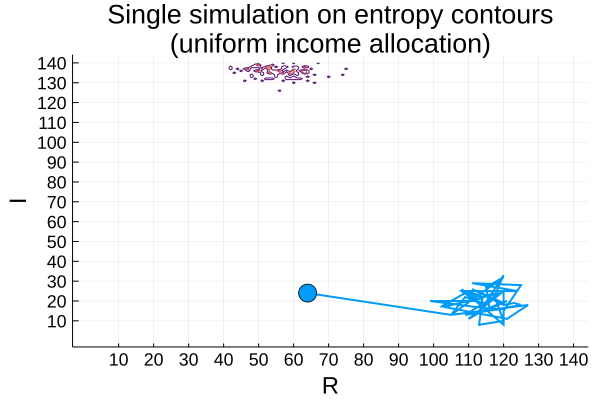

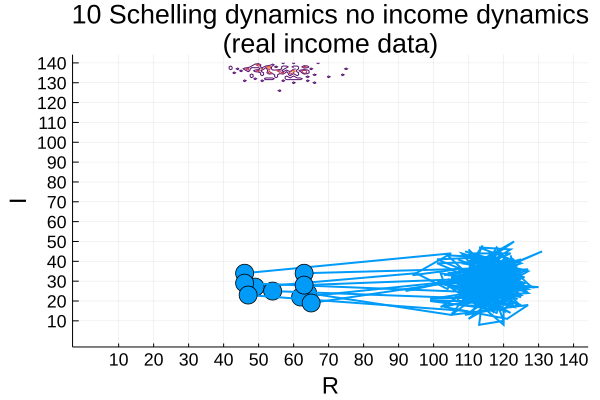

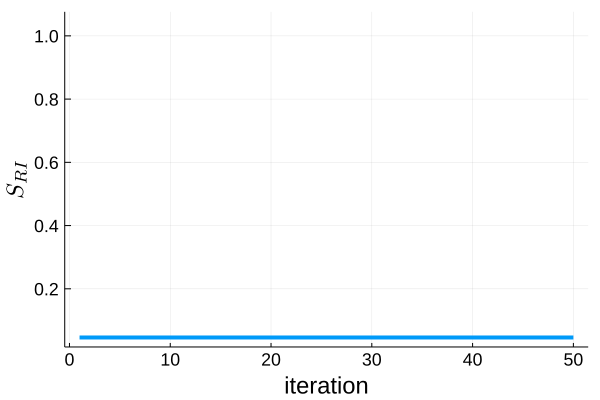

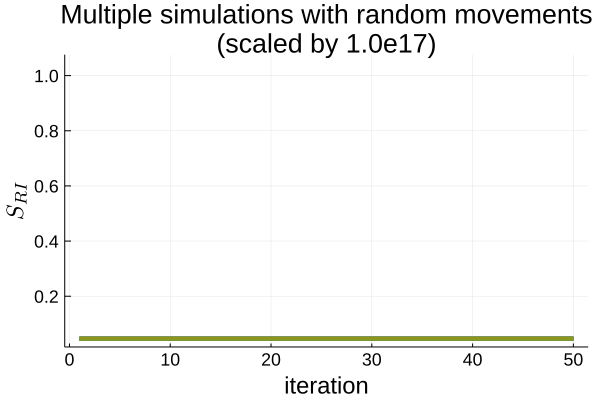

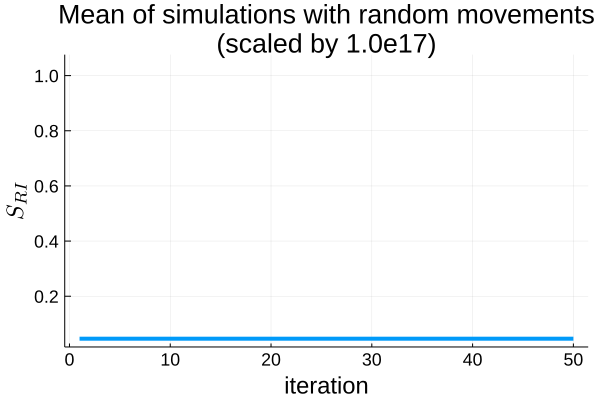

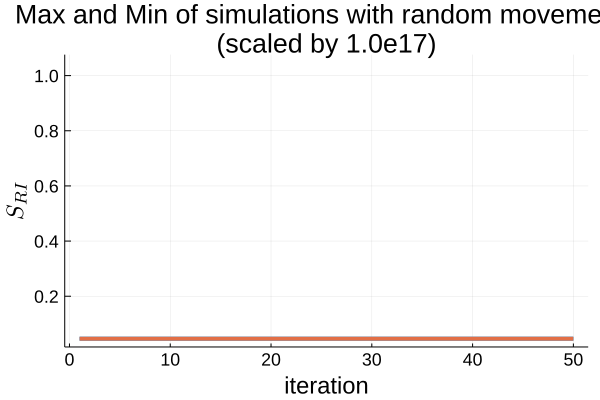

GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT


In [433]:
#SCHELLING DYNAMICS AND INCOME DATA
#Plots.jl displays in 'plot', the columns as the separate lines (by default)
#so if there are 25 different simulation of 15 samples each, the rows must be 15 and 
#25 for the column number
simulationRvals_income_multi = zeros(TT,MM)
simulationIvals_income_multi = zeros(TT,MM)
for mm in 1:MM       
    traceR = zeros(TT)
    traceI = zeros(TT)
    for tt in 1:TT 
        if(tt==1)             
            moneyGrid = make_random_finance_grid()
        else
            #move_cells_for_wealth_NoDynamics(moneyGrid) #make_random_finance_grid()  
            moneyGrid =   move_cells_for_SchellingDynamics_NoWealthDynamics(moneyGrid)            
        end    
        traceR[tt] = grid_satisfaction(moneyGrid[:,:,1])
        traceI[tt] = financial_grid_deviation(moneyGrid)   
    end
    simulationRvals_income_multi[:,mm] = traceR[:]
    simulationIvals_income_multi[:,mm] = traceI[:]
end
   
#plot a single example trace
traceR_income_single = simulationRvals_income_multi[:,1]
traceI_income_single = simulationIvals_income_multi[:,1]
pboth = plot_R_I_independentTraces(traceR_income_single,traceI_income_single;annIy=139.8)
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())
#plot the multiple example traces
pboth = plot_R_I_independentTraces(simulationRvals_income_multi,
                                      simulationIvals_income_multi;annIy=140.40,
                title="$(MM) Schelling dynamics no income dynamics \n (real income data)")
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())

plt = plotTrace_R_I_oncontour(traceR_income_single,traceI_income_single)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

plt = plotTrace_R_I_oncontour_multi(simulationRvals_income_multi,
                                simulationIvals_income_multi,
                title="$(MM) Schelling dynamics no income dynamics \n (real income data)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE SINGLE SIMULATION
plt = traceEntropyFrom2D_sim(traceR_income_single,traceI_income_single)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultiple(simulationRvals_income_multi,
    simulationIvals_income_multi)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE MEAN OF MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultiple_UsesTheMean(simulationRvals_income_multi,
    simulationIvals_income_multi)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())



#ENTROPY TRACE OF THE MEAN OF MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultipleMaxMin(simulationRvals_income_multi,
    simulationIvals_income_multi)
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


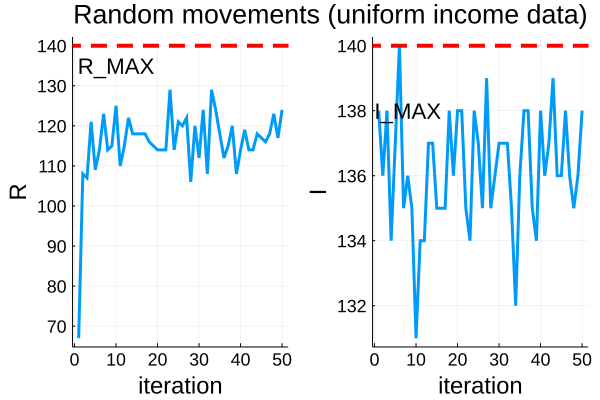

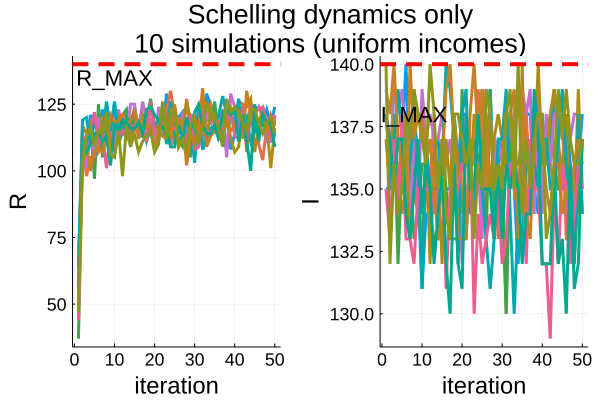

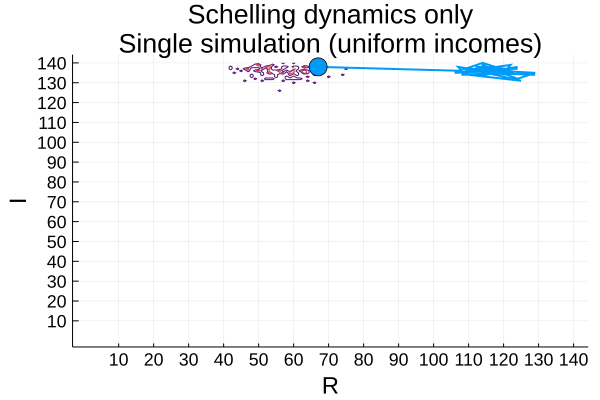

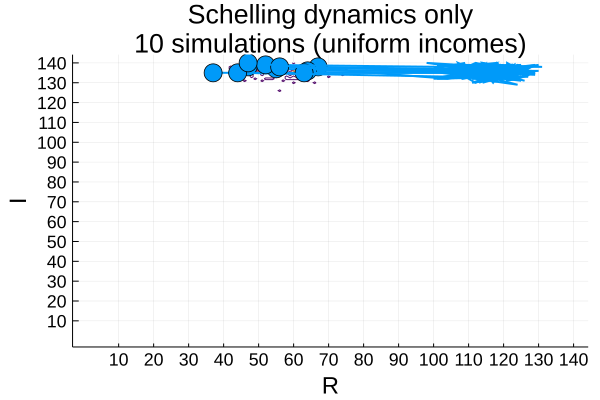

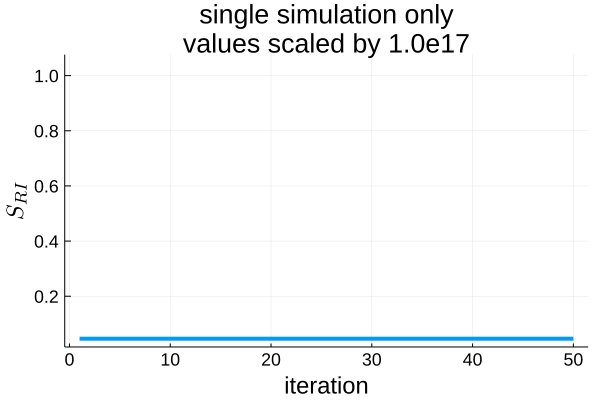

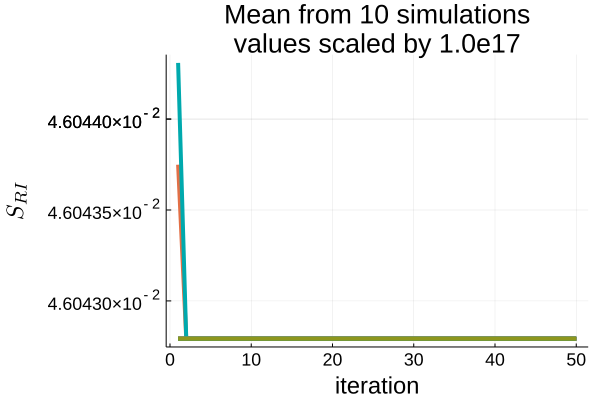

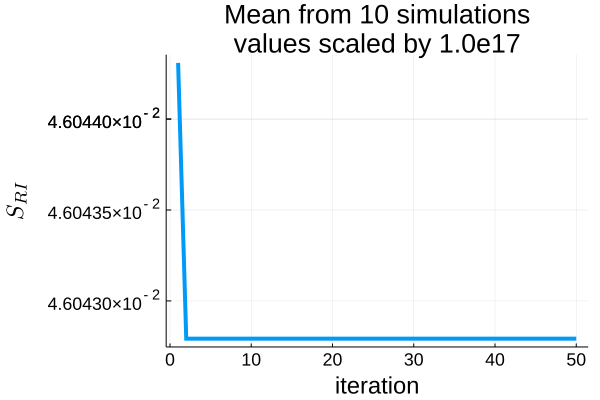

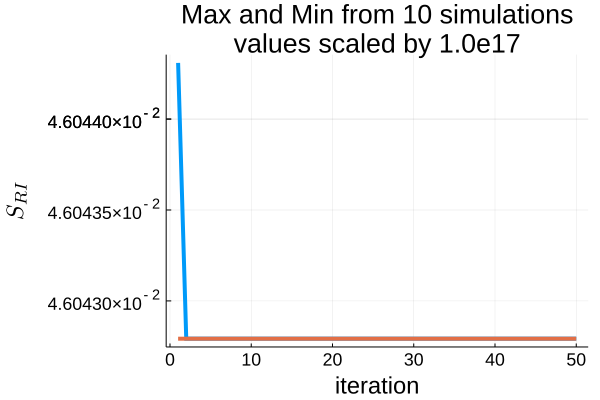

GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT


In [435]:
#SCHELLING DYNAMICS AND INCOME DATA
#Plots.jl displays in 'plot', the columns as the separate lines (by default)
#so if there are 25 different simulation of 15 samples each, the rows must be 15 and 
#25 for the column number
simulationRvals_income_multi = zeros(TT,MM)
simulationIvals_income_multi = zeros(TT,MM)
for mm in 1:MM       
    traceR = zeros(TT)
    traceI = zeros(TT)
    for tt in 1:TT 
        if(tt==1)             
            moneyGrid = make_uniform_sampled_finance_grid()
        else
            #move_cells_for_wealth_NoDynamics(moneyGrid) #make_random_finance_grid()  
            moneyGrid =   move_cells_for_SchellingDynamics_NoWealthDynamics(moneyGrid)            
        end    
        traceR[tt] = grid_satisfaction(moneyGrid[:,:,1])
        traceI[tt] = financial_grid_deviation(moneyGrid)   
    end
    simulationRvals_income_multi[:,mm] = traceR[:]
    simulationIvals_income_multi[:,mm] = traceI[:]
end
   
#plot a single example trace
traceR_income_single = simulationRvals_income_multi[:,1]
traceI_income_single = simulationIvals_income_multi[:,1]
pboth = plot_R_I_independentTraces(traceR_income_single,traceI_income_single;annRx=10,annIy=138.0)
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())
#plot the multiple example traces
pboth = plot_R_I_independentTraces(simulationRvals_income_multi,
                                      simulationIvals_income_multi;annIy=138.0,annRx=10,
                title="Schelling dynamics only \n $(MM) simulations (uniform incomes)")
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())

plt = plotTrace_R_I_oncontour(traceR_income_single,traceI_income_single)
title!(plt,"Schelling dynamics only \n Single simulation (uniform incomes)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

plt = plotTrace_R_I_oncontour_multi(simulationRvals_income_multi,
                                simulationIvals_income_multi,
                title="Schelling dynamics only \n $(MM) simulations (uniform incomes)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE SINGLE SIMULATION
plt = traceEntropyFrom2D_sim(traceR_income_single,traceI_income_single)
title!(plt,"single simulation only \n values scaled by $(scale)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultiple(simulationRvals_income_multi,
    simulationIvals_income_multi)
title!(plt,"Mean from $(MM) simulations \n values scaled by $(scale)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE MEAN OF MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultiple_UsesTheMean(simulationRvals_income_multi,
    simulationIvals_income_multi)
title!(plt,"Mean from $(MM) simulations \n values scaled by $(scale)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE MEAN OF MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultipleMaxMin(simulationRvals_income_multi,
    simulationIvals_income_multi)
title!(plt,"Max and Min from $(MM) simulations \n values scaled by $(scale)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


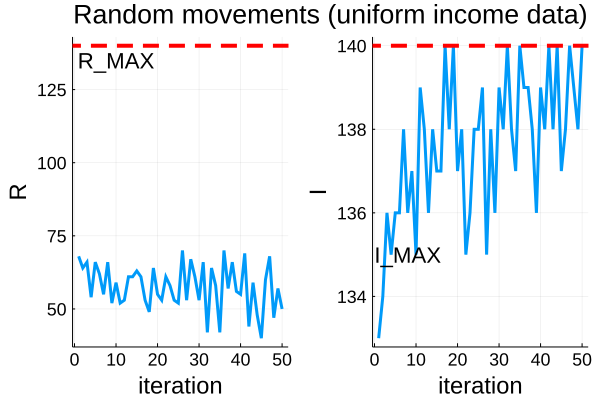

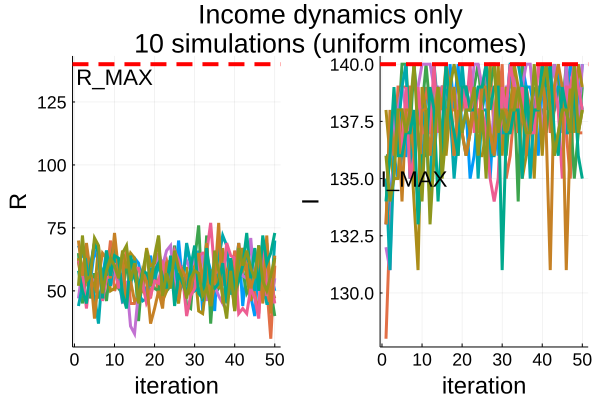

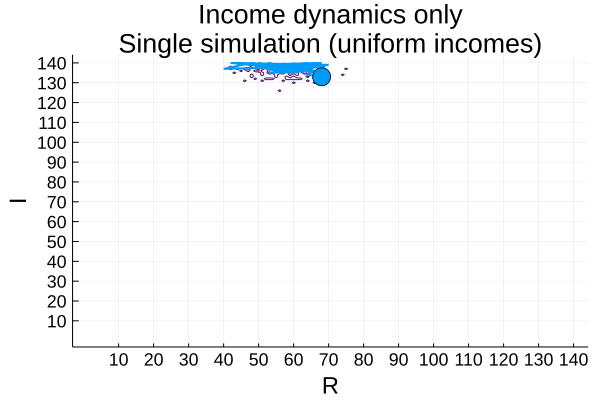

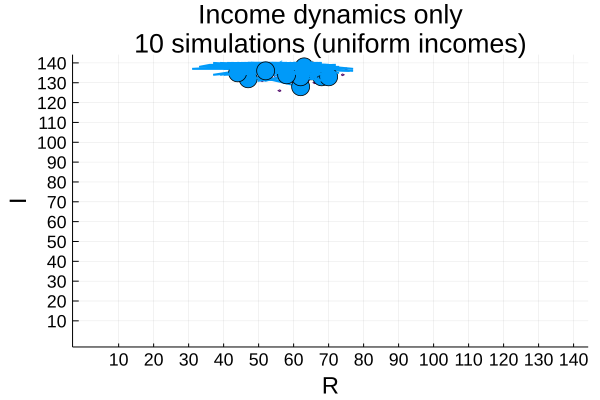

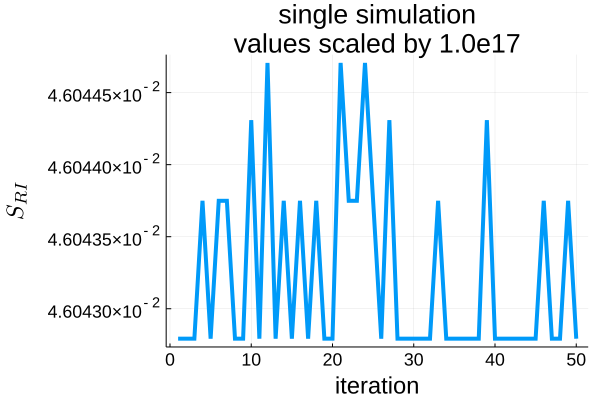

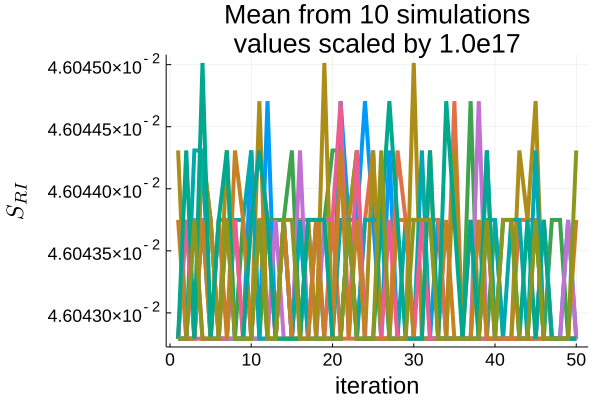

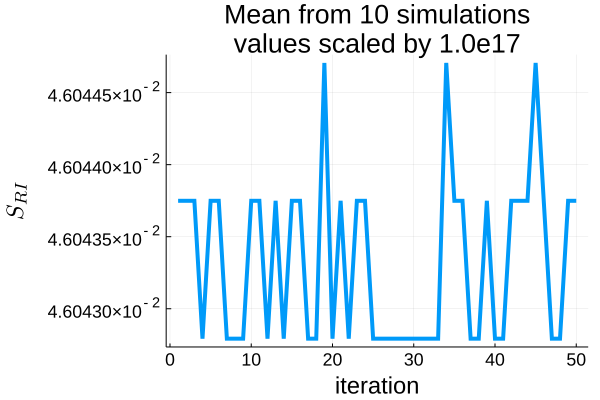

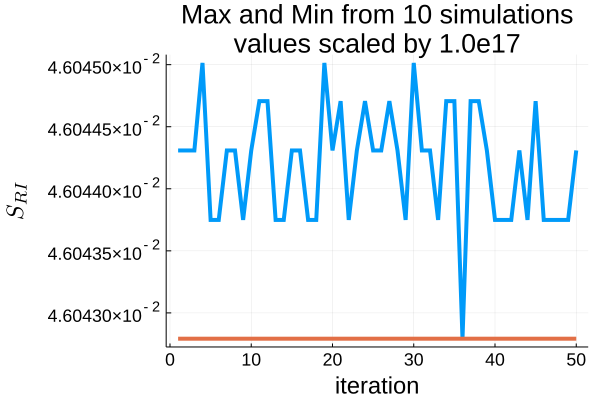

GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT


In [431]:
#INCOME DYNAMICS ONLY AND INCOME DATA
#Plots.jl displays in 'plot', the columns as the separate lines (by default)
#so if there are 25 different simulation of 15 samples each, the rows must be 15 and 
#25 for the column number
simulationRvals_income_multi = zeros(TT,MM)
simulationIvals_income_multi = zeros(TT,MM)
for mm in 1:MM       
    traceR = zeros(TT)
    traceI = zeros(TT)
    for tt in 1:TT 
        if(tt==1)             
            moneyGrid = make_uniform_sampled_finance_grid()
        else
            #move_cells_for_wealth_NoDynamics(moneyGrid) #make_random_finance_grid()  
            #moneyGrid =   move_cells_for_SchellingDynamics_NoWealthDynamics(moneyGrid)            
            moneyGrid = move_cells_for_wealth_DynamicsOnly(moneyGrid) 
        end    
        traceR[tt] = grid_satisfaction(moneyGrid[:,:,1])
        traceI[tt] = financial_grid_deviation(moneyGrid)   
    end
    simulationRvals_income_multi[:,mm] = traceR[:]
    simulationIvals_income_multi[:,mm] = traceI[:]
end
   
#plot a single example trace
traceR_income_single = simulationRvals_income_multi[:,1]
traceI_income_single = simulationIvals_income_multi[:,1]
pboth = plot_R_I_independentTraces(traceR_income_single,traceI_income_single;annRx=10,annIy=135.0)
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())
#plot the multiple example traces
pboth = plot_R_I_independentTraces(simulationRvals_income_multi,
                                      simulationIvals_income_multi;annIy=135.0,annRx=10,
                title="Income dynamics only \n $(MM) simulations (uniform incomes)")
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())

plt = plotTrace_R_I_oncontour(traceR_income_single,traceI_income_single)
title!(plt,"Income dynamics only \n Single simulation (uniform incomes)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

plt = plotTrace_R_I_oncontour_multi(simulationRvals_income_multi,
                                simulationIvals_income_multi,
                title="Income dynamics only \n $(MM) simulations (uniform incomes)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE SINGLE SIMULATION
plt = traceEntropyFrom2D_sim(traceR_income_single,traceI_income_single)
title!(plt,"single simulation \n values scaled by $(scale)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultiple(simulationRvals_income_multi,
    simulationIvals_income_multi)
title!(plt,"Mean from $(MM) simulations \n values scaled by $(scale)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE MEAN OF MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultiple_UsesTheMean(simulationRvals_income_multi,
    simulationIvals_income_multi)
title!(plt,"Mean from $(MM) simulations \n values scaled by $(scale)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE MEAN OF MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultipleMaxMin(simulationRvals_income_multi,
    simulationIvals_income_multi)
title!(plt,"Max and Min from $(MM) simulations \n values scaled by $(scale)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


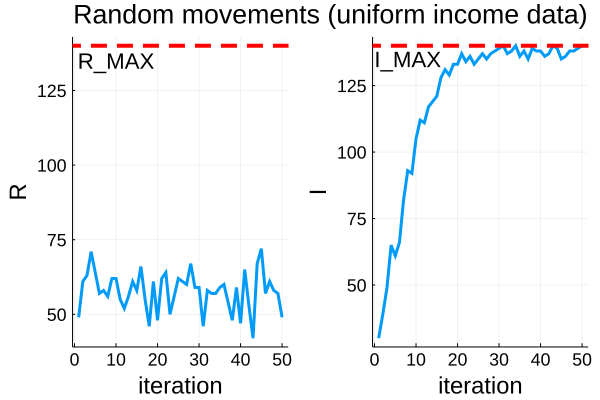

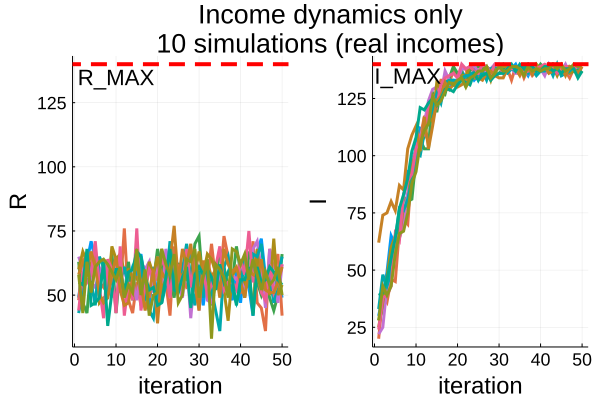

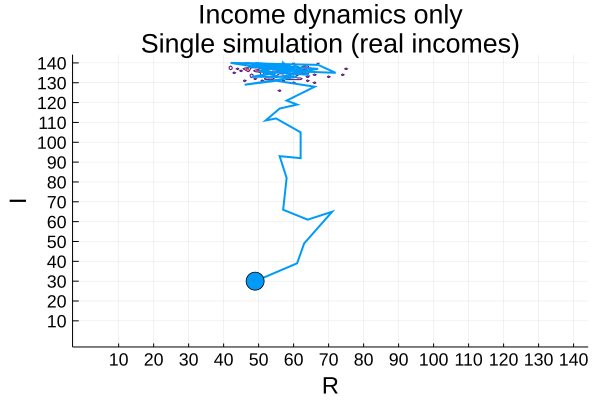

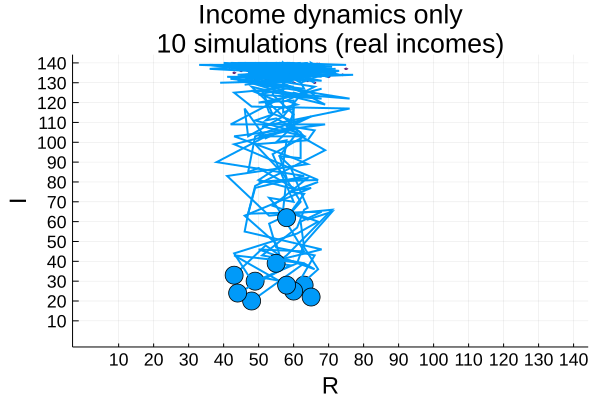

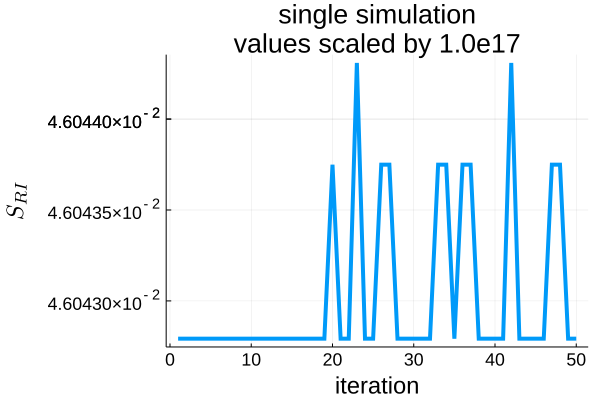

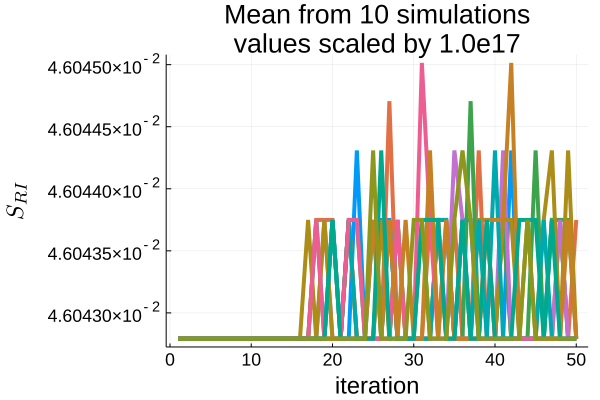

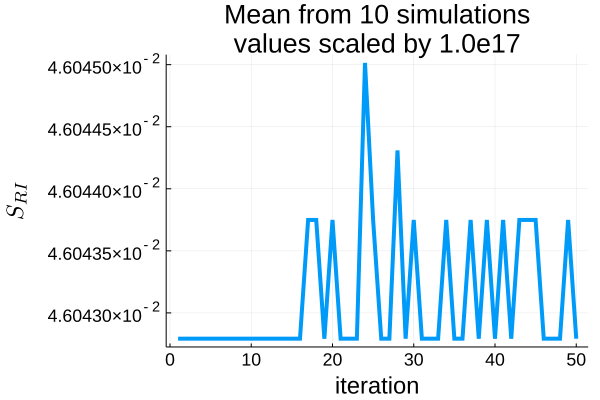

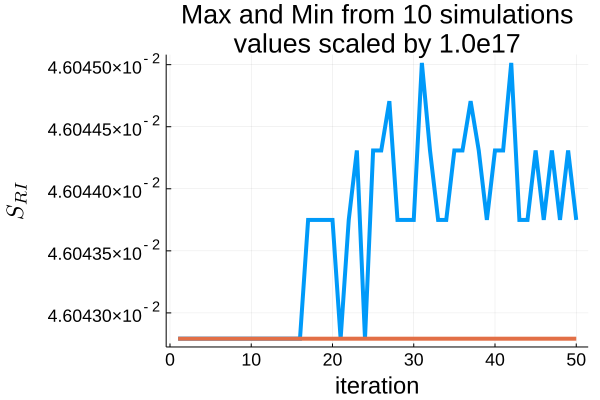

GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT


In [430]:
#INCOME DYNAMICS ONLY AND INCOME DATA
#Plots.jl displays in 'plot', the columns as the separate lines (by default)
#so if there are 25 different simulation of 15 samples each, the rows must be 15 and 
#25 for the column number
simulationRvals_income_multi = zeros(TT,MM)
simulationIvals_income_multi = zeros(TT,MM)
for mm in 1:MM       
    traceR = zeros(TT)
    traceI = zeros(TT)
    for tt in 1:TT 
        if(tt==1)             
            moneyGrid = make_random_finance_grid()
        else
            #move_cells_for_wealth_NoDynamics(moneyGrid) #make_random_finance_grid()  
            #moneyGrid =   move_cells_for_SchellingDynamics_NoWealthDynamics(moneyGrid)            
            moneyGrid = move_cells_for_wealth_DynamicsOnly(moneyGrid) 
        end    
        traceR[tt] = grid_satisfaction(moneyGrid[:,:,1])
        traceI[tt] = financial_grid_deviation(moneyGrid)   
    end
    simulationRvals_income_multi[:,mm] = traceR[:]
    simulationIvals_income_multi[:,mm] = traceI[:]
end
   
#plot a single example trace
traceR_income_single = simulationRvals_income_multi[:,1]
traceI_income_single = simulationIvals_income_multi[:,1]
pboth = plot_R_I_independentTraces(traceR_income_single,traceI_income_single;annRx=10,annIy=135.0)
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())
#plot the multiple example traces
pboth = plot_R_I_independentTraces(simulationRvals_income_multi,
                                      simulationIvals_income_multi;annIy=135.0,annRx=10,
                title="Income dynamics only \n $(MM) simulations (real incomes)")
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())

plt = plotTrace_R_I_oncontour(traceR_income_single,traceI_income_single)
title!(plt,"Income dynamics only \n Single simulation (real incomes)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

plt = plotTrace_R_I_oncontour_multi(simulationRvals_income_multi,
                                simulationIvals_income_multi,
                title="Income dynamics only \n $(MM) simulations (real incomes)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE SINGLE SIMULATION
plt = traceEntropyFrom2D_sim(traceR_income_single,traceI_income_single)
title!(plt,"single simulation \n values scaled by $(scale)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultiple(simulationRvals_income_multi,
    simulationIvals_income_multi)
title!(plt,"Mean from $(MM) simulations \n values scaled by $(scale)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE MEAN OF MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultiple_UsesTheMean(simulationRvals_income_multi,
    simulationIvals_income_multi)
title!(plt,"Mean from $(MM) simulations \n values scaled by $(scale)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE MEAN OF MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultipleMaxMin(simulationRvals_income_multi,
    simulationIvals_income_multi)
title!(plt,"Max and Min from $(MM) simulations \n values scaled by $(scale)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


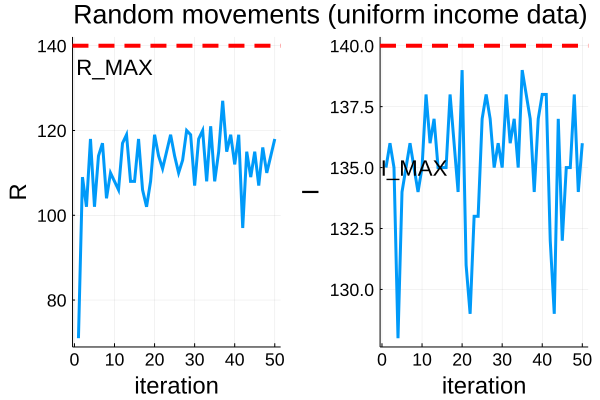

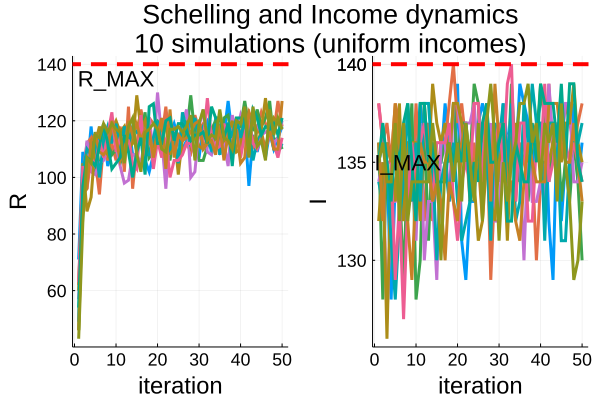

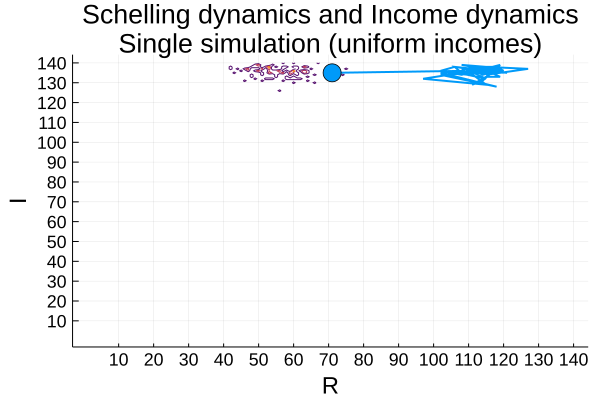

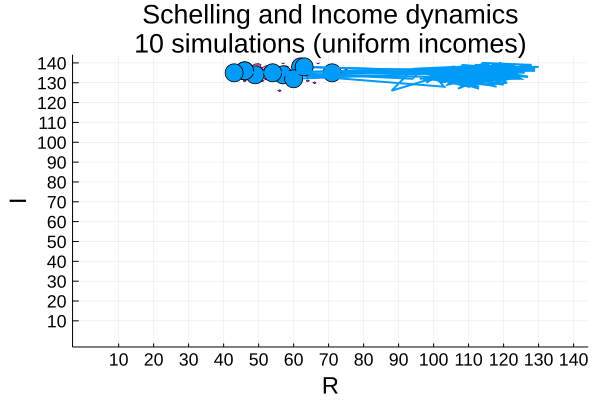

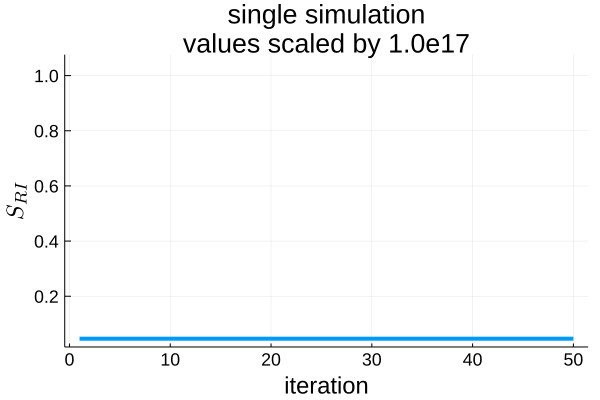

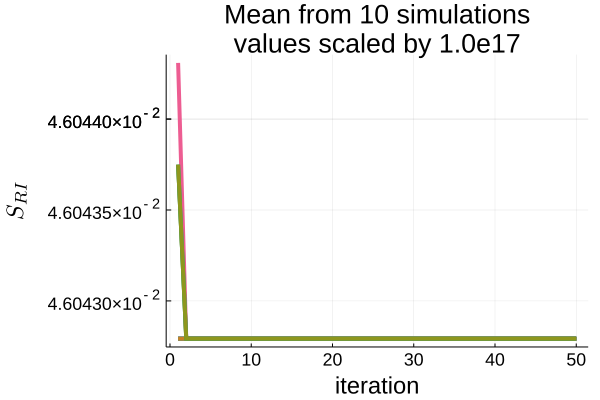

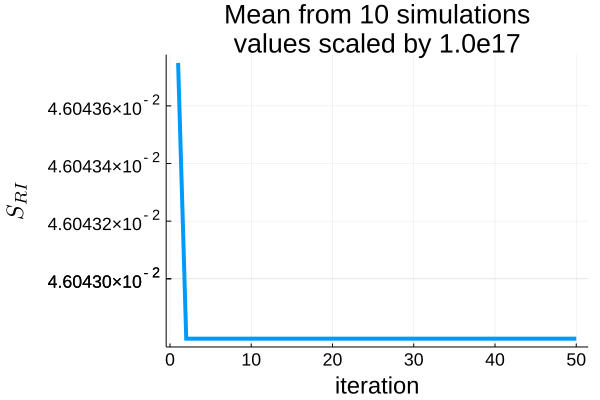

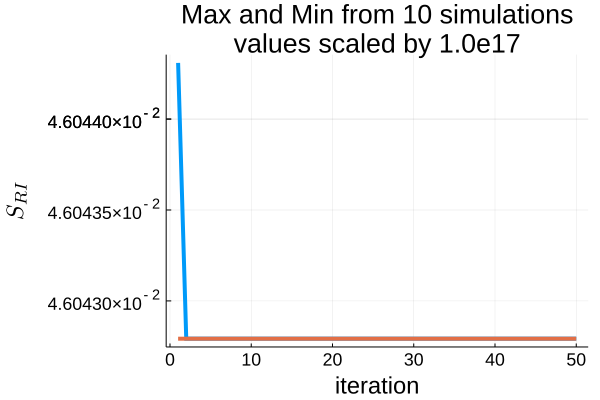

GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT


In [428]:
#SCHELLING DYNAMICS AND INCOME DYNAMICS UNIFORM DATA
#Plots.jl displays in 'plot', the columns as the separate lines (by default)
#so if there are 25 different simulation of 15 samples each, the rows must be 15 and 
#25 for the column number
simulationRvals_income_multi = zeros(TT,MM)
simulationIvals_income_multi = zeros(TT,MM)
for mm in 1:MM       
    traceR = zeros(TT)
    traceI = zeros(TT)
    for tt in 1:TT 
        if(tt==1)             
            moneyGrid = make_uniform_sampled_finance_grid()
        else
           
            moneyGrid = move_cells_for_SchellingDynamics_AND_WealthDynamics(moneyGrid)
        end    
        traceR[tt] = grid_satisfaction(moneyGrid[:,:,1])
        traceI[tt] = financial_grid_deviation(moneyGrid)   
    end
    simulationRvals_income_multi[:,mm] = traceR[:]
    simulationIvals_income_multi[:,mm] = traceI[:]
end
   
#plot a single example trace
traceR_income_single = simulationRvals_income_multi[:,1]
traceI_income_single = simulationIvals_income_multi[:,1]
pboth = plot_R_I_independentTraces(traceR_income_single,traceI_income_single;annRx=10,annIy=135.0)
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())
#plot the multiple example traces
pboth = plot_R_I_independentTraces(simulationRvals_income_multi,
                                      simulationIvals_income_multi;annIy=135.0,annRx=10,
                title="Schelling and Income dynamics \n $(MM) simulations (uniform incomes)")
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())

plt = plotTrace_R_I_oncontour(traceR_income_single,traceI_income_single)
title!(plt,"Schelling dynamics and Income dynamics \n Single simulation (uniform incomes)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

plt = plotTrace_R_I_oncontour_multi(simulationRvals_income_multi,
                                simulationIvals_income_multi,
                title="Schelling and Income dynamics \n $(MM) simulations (uniform incomes)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE SINGLE SIMULATION
plt = traceEntropyFrom2D_sim(traceR_income_single,traceI_income_single)
title!(plt,"single simulation \n values scaled by $(scale)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultiple(simulationRvals_income_multi,
    simulationIvals_income_multi)
title!(plt,"Mean from $(MM) simulations \n values scaled by $(scale)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE MEAN OF MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultiple_UsesTheMean(simulationRvals_income_multi,
    simulationIvals_income_multi)
title!(plt,"Mean from $(MM) simulations \n values scaled by $(scale)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE MEAN OF MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultipleMaxMin(simulationRvals_income_multi,
    simulationIvals_income_multi)
title!(plt,"Max and Min from $(MM) simulations \n values scaled by $(scale)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


In [382]:
function move_cells_Ronly(grid)    #XXX
    newGrid = deepcopy(grid)
    nonZeroCells = findall(newGrid[:,:,1] .!= 0)
    nonZeroCells2 = shuffle(nonZeroCells)

    satisfiedNonZeroCells = [is_cell_satisfied(newGrid[:,:,1],nzc[1],nzc[2]) for nzc in nonZeroCells2] 
    satisfiedInds = findall(satisfiedNonZeroCells .== 1)
    deleteat!(nonZeroCells2,satisfiedInds) 

    for nzc in nonZeroCells2
        isCellSatisfied = is_cell_satisfied(newGrid[:,:,1],nzc[1],nzc[2]) 
        if(isCellSatisfied != 1)
            emptyCells = findall(newGrid[:,:,1] .== 0)
            emptyCells2 = shuffle(emptyCells)
            #find an empty cell nzc could move to
            moved = false
            for ec in emptyCells2 
                wouldCellBeSatisfied = would_cell_be_satisfied(newGrid[:,:,1],ec[1],ec[2],newGrid[nzc[1],nzc[2],1])
                if(wouldCellBeSatisfied == 1 || (rand() <= moveRegardlessPROB )) 
                    #move the label on the spatial (swap with the empty cell label)
                    newGrid[ec[1],ec[2],1] = newGrid[nzc[1],nzc[2],1]
                    newGrid[nzc[1],nzc[2],1] = 0  
                    #move the income data with that of the cell
                    newGrid[ec[1],ec[2],2] = newGrid[nzc[1],nzc[2],2]
                    newGrid[nzc[1],nzc[2],2] = 0  
                    #no longer try to move it
                    moved = true
                    break
                end 
            end  
        end 
    end 
    return newGrid
end
#RANDOM MOVEMENT NO SHELLING, ONLY WEALTH RADIATION DYNAMICS
function move_cells_Ionly(grid)        
    nonZeroCells = findall(grid[:,:,1] .!= 0)
    nonZeroCells2 = shuffle(nonZeroCells)            
    for nzc in nonZeroCells2 
        emptyCells = findall(grid[:,:,1] .== 0)
        emptyCells2 = shuffle(emptyCells)
        ec = emptyCells2[1]
       
        grid[ec[1],ec[2],1] = grid[nzc[1],nzc[2],1]
        grid[nzc[1],nzc[2],1] = 0                        
        grid[ec[1],ec[2],2] = grid[nzc[1],nzc[2],2]
        grid[nzc[1],nzc[2],2] = 0 
        
        #RADIATE THE FINANCE randomly on the surroundings of the 'ec' which was empty but now nzc (nonzero)                
        grid = cell_surround_radiate_financialRandomUniformNew2(grid,ec[1],ec[2])                 
    end          
    return grid
end

function move_cells_BOTH(grid)    #XXX
    newGrid = deepcopy(grid)
    nonZeroCells = findall(newGrid[:,:,1] .!= 0)
    nonZeroCells2 = shuffle(nonZeroCells)

    satisfiedNonZeroCells = [is_cell_satisfied(newGrid[:,:,1],nzc[1],nzc[2]) for nzc in nonZeroCells2] 
    satisfiedInds = findall(satisfiedNonZeroCells .== 1)
    #deleteat!(nonZeroCells2,satisfiedInds) 

    for nzc in nonZeroCells2
        isCellSatisfied = is_cell_satisfied(newGrid[:,:,1],nzc[1],nzc[2]) 
        if(isCellSatisfied != 1)
            emptyCells = findall(newGrid[:,:,1] .== 0)
            emptyCells2 = shuffle(emptyCells)
            #find an empty cell nzc could move to
            
            for ec in emptyCells2 
                wouldCellBeSatisfied = would_cell_be_satisfied(newGrid[:,:,1],ec[1],ec[2],newGrid[nzc[1],nzc[2],1])
                if(wouldCellBeSatisfied == 1 || (rand() <= moveRegardlessPROB )) 
                    #move the label on the spatial (swap with the empty cell label)
                    newGrid[ec[1],ec[2],1] = newGrid[nzc[1],nzc[2],1]
                    newGrid[nzc[1],nzc[2],1] = 0  
                    #move the income data with that of the cell
                    newGrid[ec[1],ec[2],2] = newGrid[nzc[1],nzc[2],2]
                    newGrid[nzc[1],nzc[2],2] = 0  
                    #RADIATE THE FINANCE randomly on the surroundings of the 'ec' which was empty but now nzc (nonzero)                
                    newGrid = cell_surround_radiate_financialRandomUniformNew2(newGrid,ec[1],ec[2])       
                    break
                end 
            end  
        end 
    end 
    return newGrid
end

move_cells_BOTH (generic function with 1 method)

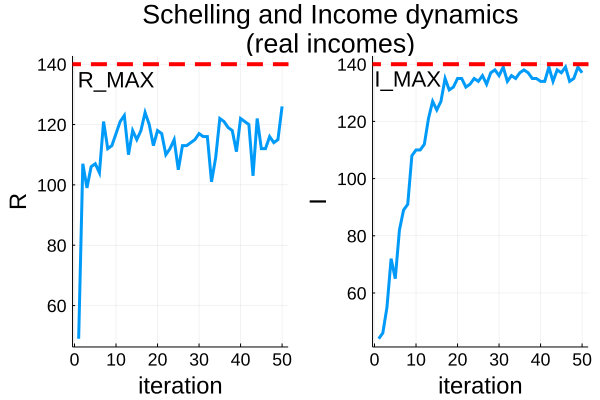

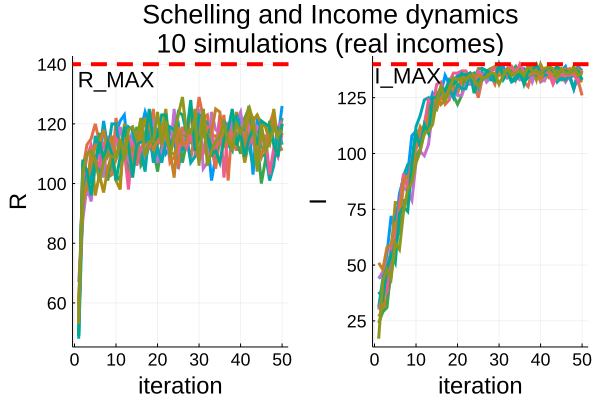

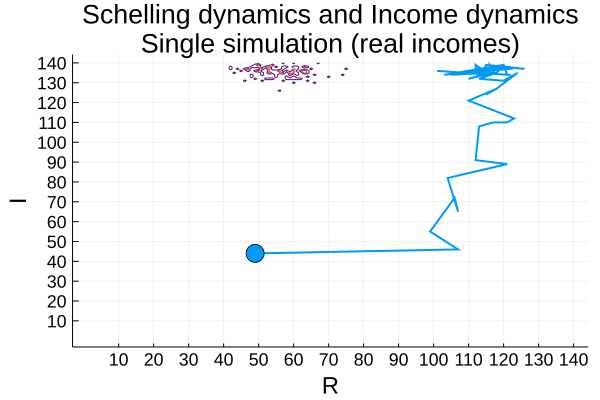

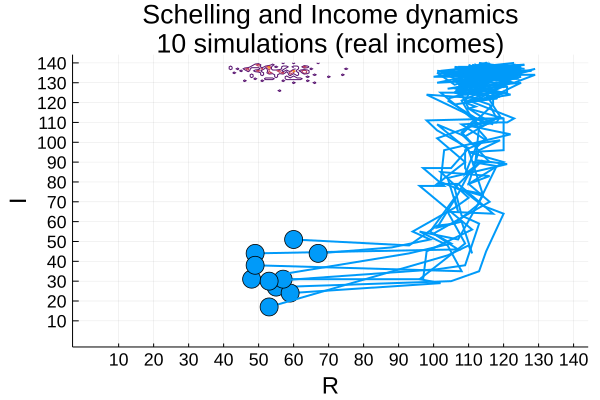

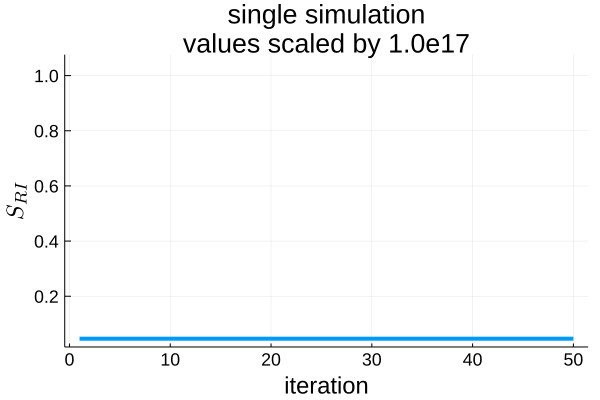

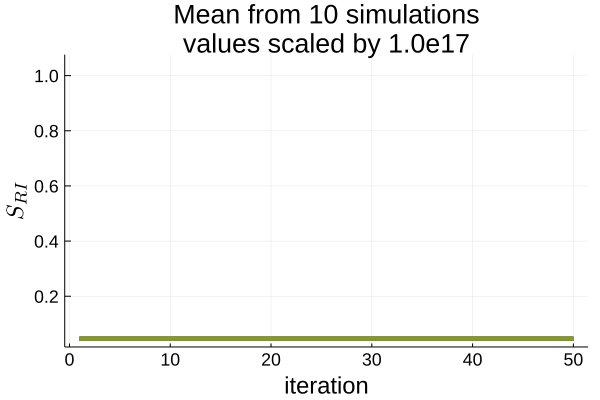

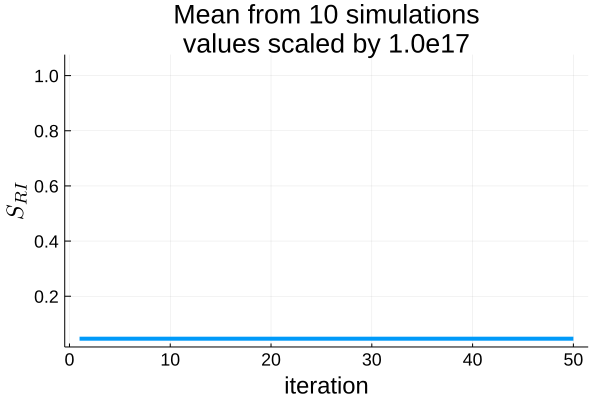

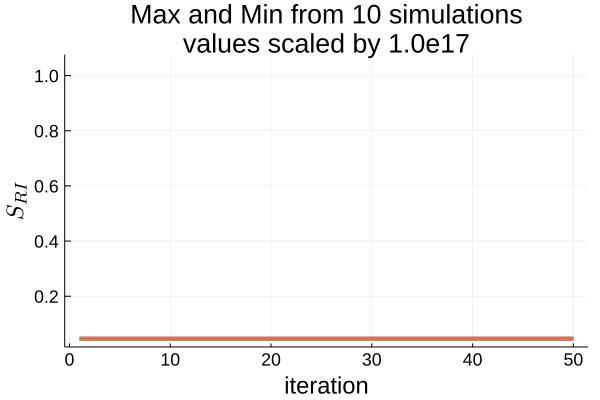

GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT


In [438]:
#SCHELLING DYNAMICS AND INCOME DYNAMICS REAL DATA
#Plots.jl displays in 'plot', the columns as the separate lines (by default)
#so if there are 25 different simulation of 15 samples each, the rows must be 15 and 
#25 for the column number
TT=50
simulationRvals_income_multi = zeros(TT,MM)
simulationIvals_income_multi = zeros(TT,MM)
for mm in 1:MM       
    traceR = zeros(TT)
    traceI = zeros(TT)
    for tt in 1:TT 
        if(tt==1)             
            moneyGrid = make_random_finance_grid()
        else
            
            moneyGrid = move_cells_for_SchellingDynamics_AND_WealthDynamics(moneyGrid)
                        
        end    
        traceR[tt] = grid_satisfaction(moneyGrid[:,:,1])
        traceI[tt] = financial_grid_deviation(moneyGrid)   
    end
    simulationRvals_income_multi[:,mm] = traceR[:]
    simulationIvals_income_multi[:,mm] = traceI[:]
end
   
#plot a single example trace
traceR_income_single = simulationRvals_income_multi[:,1]
traceI_income_single = simulationIvals_income_multi[:,1]
pboth = plot_R_I_independentTraces(traceR_income_single,traceI_income_single;annRx=10,annIy=135.0,
                 title="Schelling and Income dynamics \n (real incomes)")

display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())
#plot the multiple example traces
pboth = plot_R_I_independentTraces(simulationRvals_income_multi,
                                      simulationIvals_income_multi;annIy=135.0,annRx=10,
                title="Schelling and Income dynamics \n $(MM) simulations (real incomes)")
display(pboth)
savefig(pboth,newFigNameString())
savefig(pboth,newFigNameString_PDF())

plt = plotTrace_R_I_oncontour(traceR_income_single,traceI_income_single)
title!(plt,"Schelling dynamics and Income dynamics \n Single simulation (real incomes)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

plt = plotTrace_R_I_oncontour_multi(simulationRvals_income_multi,
                                simulationIvals_income_multi,
                title="Schelling and Income dynamics \n $(MM) simulations (real incomes)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE SINGLE SIMULATION
plt = traceEntropyFrom2D_sim(traceR_income_single,traceI_income_single)
title!(plt,"single simulation \n values scaled by $(scale)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultiple(simulationRvals_income_multi,
    simulationIvals_income_multi)
title!(plt,"Mean from $(MM) simulations \n values scaled by $(scale)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE MEAN OF MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultiple_UsesTheMean(simulationRvals_income_multi,
    simulationIvals_income_multi)
title!(plt,"Mean from $(MM) simulations \n values scaled by $(scale)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


#ENTROPY TRACE OF THE MEAN OF MULTIPLE SIMULATIONS
plt=traceEntropyFrom2D_simMultipleMaxMin(simulationRvals_income_multi,
    simulationIvals_income_multi)
title!(plt,"Max and Min from $(MM) simulations \n values scaled by $(scale)")
display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())


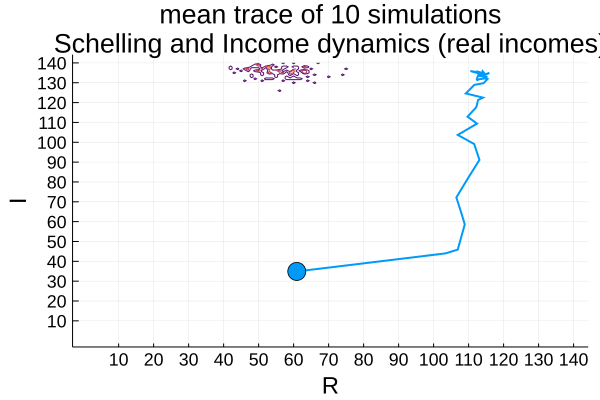

In [418]:
TTnew = TT
MMnew = MM
simulationRvals_income_multi = zeros(TTnew,MMnew)
simulationIvals_income_multi = zeros(TTnew,MMnew)
for mm in 1:MMnew       
    traceR = zeros(TTnew)
    traceI = zeros(TTnew)
    for tt in 1:TTnew 
        if(tt==1)             
            moneyGrid = make_random_finance_grid()
        else
            
            moneyGrid = move_cells_for_SchellingDynamics_AND_WealthDynamics(moneyGrid)
            #move_cells_for_wealth_NoDynamics(moneyGrid) #make_random_finance_grid()
                        
        end    
        traceR[tt] = grid_satisfaction(moneyGrid[:,:,1])
        traceI[tt] = financial_grid_deviation(moneyGrid)   
    end
    simulationRvals_income_multi[:,mm] = traceR[:]
    simulationIvals_income_multi[:,mm] = traceI[:]
end
   
RmeanVals = mean(simulationRvals_income_multi,dims=2);
RmeanIals = mean(simulationIvals_income_multi,dims=2);

title="mean trace of $(MMnew) simulations \n Schelling and Income dynamics (real incomes)"
cc = get_color_palette(:auto, plot_color(:white), 17)[1]   
xx=collect(1:R_MAX)
yy=collect(1:R_MAX)
plt = contour(xx,yy,entropyLookUp(xx,yy),levels=3,
    title=title,
    xlabel="R",ylabel="I",xtickfont=TICKFONTSIZE,ytickfont=TICKFONTSIZE,
    titlefont=TITLEFONTSIZE,guidefont=GUIDEFONTSIZE,leg=false,
    xticks=10:10:R_MAX, yticks=10:10:R_MAX)
plot!(RmeanVals,RmeanIals,line=:path,linewidth=2,color=cc)
scatter!([RmeanVals[1]],[RmeanIals[1]], color=cc,markersize = 10)

display(plt)
savefig(plt,newFigNameString())
savefig(plt,newFigNameString_PDF())

In [386]:
#-----------------THE END-------------------#